# GEO-Bench Zero-Shot Baselines

## Libraries

In [ ]:
%%capture
# Install geobench to access data
!pip install geobench

In [ ]:
%%capture
# geobench uses older versions of numpy and pandas
# Necessary to re-install these two before importing libraries
!pip uninstall -y pandas numpy
!pip install "numpy<2.0.0" "pandas<2.0.0,>=1.5.3"

> **Note**: need to <u>restart runtime session</u> before running the following cell!

In [ ]:
# Load libraries
import geobench
import numpy as np
import pandas as pd
import os
from matplotlib import pyplot as plt
import seaborn as sns
from PIL import Image
import random

import h5py
import json
import pickle
from pathlib import Path

from tqdm import tqdm
import torch
import gc

from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
from sklearn.metrics import roc_curve, auc
import plotly.express as px
import plotly.graph_objects as go
from sklearn.preprocessing import label_binarize

from sklearn.metrics import average_precision_score
from sklearn.metrics import label_ranking_loss
from sklearn.metrics import f1_score

# Ignore warning
import warnings
warnings.filterwarnings('ignore')

In [ ]:
# Mount the google drive
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## Utility functions

In [ ]:
def normalize(img):

    ''' Normalize images for display -> all values in [0, 1]. '''

    return (img - np.min(img)) / (np.max(img) - np.min(img))


def add_top_predictions_with_batches_standard(input_df, model, preprocess, device, labels, bands, output_path, tokenizer = 'default'):

    ''' Process images from input dataframe, using the specified model and labels.
        - 'bands' is a list of strings identifying the RGB channels for the current dataset
        - 'tokenizer' needs to be specified when not using the standard CLIP '''

    # Set chunk and batch size
    chunk_size = 250
    batch_size = 8

    new_columns = [l.replace(' ', '_') + "_dotprod" for l in labels] + \
                  [l.replace(' ', '_') + "_softmax" for l in labels] + \
                  [l.replace(' ', '_') + "_sigmoid" for l in labels] + \
                  ["pred"]

    # Process images in chunks
    for chunk_start in tqdm(range(0, input_df.shape[0], chunk_size)):
        chunk_df = input_df.iloc[
            chunk_start : chunk_start + chunk_size
        ].copy()

        # Initialize new columns for each chunk
        for col in new_columns:
            chunk_df[col] = ""

        batch = []
        batch_indices = []  # stores row positions within chunk_df

        for index, filename in enumerate(chunk_df["filename"]):
            # index is relative to chunk_df
            try:
                # Compose RGB image
                f = h5py.File(filename)
                r = f[bands[0]][:]    # shape (120, 120)
                g = f[bands[1]][:]    # shape (120, 120)
                b = f[bands[2]][:]    # shape (120, 120)
                rgb_image = np.stack([r, g, b], axis = -1) # shape (120, 120, 3)
                true_color = normalize(rgb_image)

                image = preprocess(Image.fromarray((true_color * 255).astype(np.uint8))).unsqueeze(0).to(device)
                # to represent images with the 3 color channels having integer values (0 to 255)
                # the cast is necessary to make PIL work: uint8 -> unsigned integer (0 to 255)

                # WATCH OUT: hardcoded clip tokenixer here -> change it when the model changes!
                if tokenizer == 'default': # go for standard CLIP tokenizer
                    text = clip.tokenize(['a satellite image of ' + l.lower() for l in labels]).to(device)
                else: # go for model-specific tokenizer
                    text = tokenizer(['a satellite image of ' + l.lower() for l in labels]).to(device)

                batch.append(image)
                batch_indices.append(index)  # store relative index

                # Process batch if full
                if len(batch) == batch_size:
                    with torch.no_grad():
                        batch_images = torch.cat(batch, dim=0)
                        image_features = model.encode_image(batch_images)
                        text_features = model.encode_text(text)

                    image_features /= image_features.norm(dim=-1, keepdim=True)
                    text_features /= text_features.norm(dim=-1, keepdim=True)

                    for i, img_feats in enumerate(image_features):
                        similarity = img_feats @ text_features.T # normalized dot product -> cosine similarity
                        softmax = (100.0 * img_feats @ text_features.T).softmax(dim=-1)
                        sigmoid = (img_feats @ text_features.T).sigmoid()
                        for j, label in enumerate(labels):
                            chunk_df.iloc[
                                batch_indices[i], chunk_df.columns.get_loc(new_columns[j])
                            ] = similarity[j].item()
                            chunk_df.iloc[
                                batch_indices[i], chunk_df.columns.get_loc(new_columns[len(labels) + j]) # 2 + j
                            ] = softmax[j].item()
                            chunk_df.iloc[
                                batch_indices[i], chunk_df.columns.get_loc(new_columns[2 * len(labels) + j]) # 4 + j
                            ] = sigmoid[j].item()
                        chunk_df.iloc[
                            batch_indices[i], chunk_df.columns.get_loc(new_columns[-1])
                        ] = labels[softmax.argmax()] # softmax is chosen for final prediction

                    # Clear memory
                    del batch, batch_images, image_features
                    torch.cuda.empty_cache()
                    gc.collect()
                    batch = []
                    batch_indices = []

            except Exception as e:
                print(f"Error processing image {filename}: {e}")


        # Process remaining images in the batch (if any)
        if batch:
            with torch.no_grad():
                batch_images = torch.cat(batch, dim=0)
                image_features = model.encode_image(batch_images)
                text_features = model.encode_text(text)

            image_features /= image_features.norm(dim=-1, keepdim=True)
            text_features /= text_features.norm(dim=-1, keepdim=True)

            for i, img_feats in enumerate(image_features):
                similarity = img_feats @ text_features.T # normalized dot product -> cosine similarity
                softmax = (100.0 * img_feats @ text_features.T).softmax(dim=-1)
                sigmoid = (img_feats @ text_features.T).sigmoid()
                for j, label in enumerate(labels):
                    chunk_df.iloc[
                        batch_indices[i], chunk_df.columns.get_loc(new_columns[j])
                    ] = similarity[j].item()
                    chunk_df.iloc[
                        batch_indices[i], chunk_df.columns.get_loc(new_columns[len(labels) + j])
                    ] = softmax[j].item()
                    chunk_df.iloc[
                        batch_indices[i], chunk_df.columns.get_loc(new_columns[2 * len(labels) + j])
                    ] = sigmoid[j].item()
                chunk_df.iloc[
                    batch_indices[i], chunk_df.columns.get_loc(new_columns[-1])
                ] = labels[softmax.argmax()]  # softmax is chosen for final prediction

            del batch, batch_images, image_features
            torch.cuda.empty_cache()
            gc.collect()

        # Append results to CSV
        chunk_df.to_csv(
            f"{output_path}",
            mode = "a",
            index = False,
            header = (chunk_start == 0),
        )

        del chunk_df
        gc.collect()

    return


def add_top_predictions_with_batches_forestnet(input_df, model, preprocess, device, labels, bands, output_path, tokenizer = 'default'):

    ''' Modified version of add_top_predictions_with_batches_standard() for the ForestNet dataset.
        The parameters don't change, but the RGB bands names are dynamically extracted for
        each image as they are different in the original files. '''

    # Set chunk and batch size
    chunk_size = 250
    batch_size = 8

    new_columns = [l.replace(' ', '_') + "_dotprod" for l in labels] + \
                  [l.replace(' ', '_') + "_softmax" for l in labels] + \
                  [l.replace(' ', '_') + "_sigmoid" for l in labels] + \
                  ["pred"]

    # Process images in chunks
    for chunk_start in tqdm(range(0, input_df.shape[0], chunk_size)):
        chunk_df = input_df.iloc[
            chunk_start : chunk_start + chunk_size
        ].copy()

        # Initialize new columns for each chunk
        for col in new_columns:
            chunk_df[col] = ""

        batch = []
        batch_indices = []  # stores row positions within chunk_df

        for index, filename in enumerate(chunk_df["filename"]):
            # index is relative to chunk_df
            try:
                # Compose RGB image
                f = h5py.File(filename)
                r = f[[i for i in f.keys() if bands[0] in i][0]][:] # shape (n, n)
                g = f[[i for i in f.keys() if bands[1] in i][0]][:] # shape (n, n)
                b = f[[i for i in f.keys() if bands[2] in i][0]][:] # shape (n, n)
                rgb_image = np.stack([r, g, b], axis = -1) # shape (n, n, 3)
                true_color = normalize(rgb_image)

                image = preprocess(Image.fromarray((true_color * 255).astype(np.uint8))).unsqueeze(0).to(device)

                # default == using standard CLIP
                if tokenizer == 'default':
                    text = clip.tokenize(['a satellite image of ' + l for l in labels]).to(device)
                else:
                    text = tokenizer(['a satellite image of ' + l for l in labels]).to(device)

                batch.append(image)
                batch_indices.append(index)  # store relative index

                # Process batch if full
                if len(batch) == batch_size:
                    with torch.no_grad():
                        batch_images = torch.cat(batch, dim=0)
                        image_features = model.encode_image(batch_images)
                        text_features = model.encode_text(text)

                    image_features /= image_features.norm(dim=-1, keepdim=True)
                    text_features /= text_features.norm(dim=-1, keepdim=True)

                    for i, img_feats in enumerate(image_features):
                        similarity = img_feats @ text_features.T # normalized dot product -> cosine similarity
                        softmax = (100.0 * img_feats @ text_features.T).softmax(dim=-1)
                        sigmoid = (img_feats @ text_features.T).sigmoid()
                        for j, label in enumerate(labels):
                            chunk_df.iloc[
                                batch_indices[i], chunk_df.columns.get_loc(new_columns[j])
                            ] = similarity[j].item()
                            chunk_df.iloc[
                                batch_indices[i], chunk_df.columns.get_loc(new_columns[len(labels) + j]) # 2 + j
                            ] = softmax[j].item()
                            chunk_df.iloc[
                                batch_indices[i], chunk_df.columns.get_loc(new_columns[2 * len(labels) + j]) # 4 + j
                            ] = sigmoid[j].item()
                        chunk_df.iloc[
                            batch_indices[i], chunk_df.columns.get_loc(new_columns[-1])
                        ] = labels[softmax.argmax()] # softmax is chosen for final prediction

                    # Clear memory
                    del batch, batch_images, image_features
                    torch.cuda.empty_cache()
                    gc.collect()
                    batch = []
                    batch_indices = []

            except Exception as e:
                print(f"Error processing image {filename}: {e}")


        # Process remaining images in the batch (if any)
        if batch:
            with torch.no_grad():
                batch_images = torch.cat(batch, dim=0)
                image_features = model.encode_image(batch_images)
                text_features = model.encode_text(text)

            image_features /= image_features.norm(dim=-1, keepdim=True)
            text_features /= text_features.norm(dim=-1, keepdim=True)

            for i, img_feats in enumerate(image_features):
                similarity = img_feats @ text_features.T # normalized dot product -> cosine similarity
                softmax = (100.0 * img_feats @ text_features.T).softmax(dim=-1)
                sigmoid = (img_feats @ text_features.T).sigmoid()
                for j, label in enumerate(labels):
                    chunk_df.iloc[
                        batch_indices[i], chunk_df.columns.get_loc(new_columns[j])
                    ] = similarity[j].item()
                    chunk_df.iloc[
                        batch_indices[i], chunk_df.columns.get_loc(new_columns[len(labels) + j])
                    ] = softmax[j].item()
                    chunk_df.iloc[
                        batch_indices[i], chunk_df.columns.get_loc(new_columns[2 * len(labels) + j])
                    ] = sigmoid[j].item()
                chunk_df.iloc[
                    batch_indices[i], chunk_df.columns.get_loc(new_columns[-1])
                ] = labels[softmax.argmax()] # softmax is chosen for final prediction

            del batch, batch_images, image_features
            torch.cuda.empty_cache()
            gc.collect()

        # Append results to CSV
        chunk_df.to_csv(
            f"{output_path}",
            mode = "a",
            index = False,
            header = (chunk_start == 0),
        )

        del chunk_df
        gc.collect()

    return


def add_top_predictions_with_batches_RemoteCLIP(input_df, model, preprocess, device, labels, bands, output_path, tokenizer = 'default'):

    ''' Process images from the specified directory, using the specified model and labels.
        - 'labels' is the set of labels associated to the dataset in use
        - 'bands' is a list of strings identifying the RGB channels. '''

    # Set chunk and batch size
    chunk_size = 250
    batch_size = 8

    new_columns = [l.replace(' ', '_') + "_dotprod" for l in labels] + \
                  [l.replace(' ', '_') + "_softmax" for l in labels] + \
                  [l.replace(' ', '_') + "_sigmoid" for l in labels] + \
                  ["pred"]

    # Process images in chunks
    for chunk_start in tqdm(range(0, input_df.shape[0], chunk_size)):
        chunk_df = input_df.iloc[
            chunk_start : chunk_start + chunk_size
        ].copy()

        # Initialize new columns for each chunk
        for col in new_columns:
            chunk_df[col] = ""

        batch = []
        batch_indices = []  # stores row positions within chunk_df

        for index, filename in enumerate(chunk_df["filename"]):
            # index is relative to chunk_df
            try:
                # Compose RGB image
                f = h5py.File(filename)
                r = f[bands[0]][:]    # shape (120, 120)
                g = f[bands[1]][:]    # shape (120, 120)
                b = f[bands[2]][:]    # shape (120, 120)
                rgb_image = np.stack([r, g, b], axis = -1) # shape (120, 120, 3)
                true_color = normalize(rgb_image)

                image = preprocess(Image.fromarray((true_color * 255).astype(np.uint8))).unsqueeze(0).to(device)

                # default == using standard CLIP
                if tokenizer == 'default': # go for standard CLIP tokenizer
                    text = clip.tokenize(['a satellite image of ' + l.lower() for l in labels]).to(device)
                else: # go for model-specific tokenizer
                    text = tokenizer(['a satellite image of ' + l.lower() for l in labels]).to(device)

                batch.append(image)
                batch_indices.append(index)  # store relative index

                # Process batch if full
                if len(batch) == batch_size:
                    with torch.no_grad(), torch.cuda.amp.autocast():
                        batch_images = torch.cat(batch, dim=0)
                        image_features = model.encode_image(batch_images)
                        text_features = model.encode_text(text)

                    image_features /= image_features.norm(dim=-1, keepdim=True)
                    text_features /= text_features.norm(dim=-1, keepdim=True)

                    for i, img_feats in enumerate(image_features):
                        similarity = img_feats @ text_features.T # normalized dot product -> cosine similarity
                        softmax = (100.0 * img_feats @ text_features.T).softmax(dim=-1)
                        sigmoid = (img_feats @ text_features.T).sigmoid()
                        for j, label in enumerate(labels):
                            chunk_df.iloc[
                                batch_indices[i], chunk_df.columns.get_loc(new_columns[j])
                            ] = similarity[j].item()
                            chunk_df.iloc[
                                batch_indices[i], chunk_df.columns.get_loc(new_columns[len(labels) + j]) # 2 + j
                            ] = softmax[j].item()
                            chunk_df.iloc[
                                batch_indices[i], chunk_df.columns.get_loc(new_columns[2 * len(labels) + j]) # 4 + j
                            ] = sigmoid[j].item()
                        chunk_df.iloc[
                            batch_indices[i], chunk_df.columns.get_loc(new_columns[-1])
                        ] = labels[similarity.argmax()]  # softmax is chosen for final prediction

                    # Clear memory
                    del batch, batch_images, image_features
                    torch.cuda.empty_cache()
                    gc.collect()
                    batch = []
                    batch_indices = []

            except Exception as e:
                print(f"Error processing image {filename}: {e}")


        # Process remaining images in the batch (if any)
        if batch:
            with torch.no_grad(), torch.cuda.amp.autocast():
                batch_images = torch.cat(batch, dim=0)
                image_features = model.encode_image(batch_images)
                text_features = model.encode_text(text)

            image_features /= image_features.norm(dim=-1, keepdim=True)
            text_features /= text_features.norm(dim=-1, keepdim=True)

            for i, img_feats in enumerate(image_features):
                similarity = img_feats @ text_features.T # normalized dot product -> cosine similarity
                softmax = (100.0 * img_feats @ text_features.T).softmax(dim=-1)
                sigmoid = (img_feats @ text_features.T).sigmoid()
                for j, label in enumerate(labels):
                    chunk_df.iloc[
                        batch_indices[i], chunk_df.columns.get_loc(new_columns[j])
                    ] = similarity[j].item()
                    chunk_df.iloc[
                        batch_indices[i], chunk_df.columns.get_loc(new_columns[len(labels) + j])
                    ] = softmax[j].item()
                    chunk_df.iloc[
                        batch_indices[i], chunk_df.columns.get_loc(new_columns[2 * len(labels) + j])
                    ] = sigmoid[j].item()
                chunk_df.iloc[
                    batch_indices[i], chunk_df.columns.get_loc(new_columns[-1])
                ] = labels[softmax.argmax()]  # softmax is chosen for final prediction

            del batch, batch_images, image_features
            torch.cuda.empty_cache()
            gc.collect()

        # Append results to CSV
        chunk_df.to_csv(
            f"{output_path}",
            mode = "a",
            index = False,
            header = (chunk_start == 0),
        )

        del chunk_df
        gc.collect()

    return


def add_top_predictions_with_batches_forestnet_RemoteCLIP(input_df, model, preprocess, device, labels, bands, output_path, tokenizer = 'default'):

    ''' Process images from the specified directory, using the specified model and labels.
        - 'labels' is the set of labels associated to the dataset in use
        - 'bands' is a list of strings identifying the RGB channels '''

    # Set chunk and batch size
    chunk_size = 250
    batch_size = 8

    new_columns = [l.replace(' ', '_') + "_dotprod" for l in labels] + \
                  [l.replace(' ', '_') + "_softmax" for l in labels] + \
                  [l.replace(' ', '_') + "_sigmoid" for l in labels] + \
                  ["pred"]

    # Process images in chunks
    for chunk_start in tqdm(range(0, input_df.shape[0], chunk_size)):
        chunk_df = input_df.iloc[
            chunk_start : chunk_start + chunk_size
        ].copy()

        # Initialize new columns for each chunk
        for col in new_columns:
            chunk_df[col] = ""

        batch = []
        batch_indices = []  # stores row positions within chunk_df

        for index, filename in enumerate(chunk_df["filename"]):
            # index is relative to chunk_df
            try:
                # Compose RGB image
                f = h5py.File(filename)
                r = f[[i for i in f.keys() if bands[0] in i][0]][:]    # shape (n, n)
                g = f[[i for i in f.keys() if bands[1] in i][0]][:]    # shape (n, n)
                b = f[[i for i in f.keys() if bands[2] in i][0]][:]    # shape (n, n)
                rgb_image = np.stack([r, g, b], axis = -1) # shape (n, n, 3)
                true_color = normalize(rgb_image)

                image = preprocess(Image.fromarray((true_color * 255).astype(np.uint8))).unsqueeze(0).to(device)

                # WATCH OUT: hardcoded clip tokenixer here -> change it when the model changes!
                if tokenizer == 'default':
                    text = clip.tokenize(['a satellite image of ' + l.lower() for l in labels]).to(device)
                else:
                    text = tokenizer(['a satellite image of ' + l.lower() for l in labels]).to(device)

                batch.append(image)
                batch_indices.append(index)  # store relative index

                # Process batch if full
                if len(batch) == batch_size:
                    with torch.no_grad(), torch.cuda.amp.autocast():
                        batch_images = torch.cat(batch, dim=0)
                        image_features = model.encode_image(batch_images)
                        text_features = model.encode_text(text)

                    image_features /= image_features.norm(dim=-1, keepdim=True)
                    text_features /= text_features.norm(dim=-1, keepdim=True)

                    for i, img_feats in enumerate(image_features):
                        similarity = img_feats @ text_features.T # normalized dot product -> cosine similarity
                        softmax = (100.0 * img_feats @ text_features.T).softmax(dim=-1)
                        sigmoid = (img_feats @ text_features.T).sigmoid()
                        for j, label in enumerate(labels):
                            chunk_df.iloc[
                                batch_indices[i], chunk_df.columns.get_loc(new_columns[j])
                            ] = similarity[j].item()
                            chunk_df.iloc[
                                batch_indices[i], chunk_df.columns.get_loc(new_columns[len(labels) + j]) # 2 + j
                            ] = softmax[j].item()
                            chunk_df.iloc[
                                batch_indices[i], chunk_df.columns.get_loc(new_columns[2 * len(labels) + j]) # 4 + j
                            ] = sigmoid[j].item()
                        chunk_df.iloc[
                            batch_indices[i], chunk_df.columns.get_loc(new_columns[-1])
                        ] = labels[softmax.argmax()]  # softmax is chosen for final prediction

                    # Clear memory
                    del batch, batch_images, image_features
                    torch.cuda.empty_cache()
                    gc.collect()
                    batch = []
                    batch_indices = []

            except Exception as e:
                print(f"Error processing image {filename}: {e}")


        # Process remaining images in the batch (if any)
        if batch:
            with torch.no_grad(), torch.cuda.amp.autocast():
                batch_images = torch.cat(batch, dim=0)
                image_features = model.encode_image(batch_images)
                text_features = model.encode_text(text)

            image_features /= image_features.norm(dim=-1, keepdim=True)
            text_features /= text_features.norm(dim=-1, keepdim=True)

            for i, img_feats in enumerate(image_features):
                similarity = img_feats @ text_features.T # normalized dot product -> cosine similarity
                softmax = (100.0 * img_feats @ text_features.T).softmax(dim=-1)
                sigmoid = (img_feats @ text_features.T).sigmoid()
                for j, label in enumerate(labels):
                    chunk_df.iloc[
                        batch_indices[i], chunk_df.columns.get_loc(new_columns[j])
                    ] = similarity[j].item()
                    chunk_df.iloc[
                        batch_indices[i], chunk_df.columns.get_loc(new_columns[len(labels) + j])
                    ] = softmax[j].item()
                    chunk_df.iloc[
                        batch_indices[i], chunk_df.columns.get_loc(new_columns[2 * len(labels) + j])
                    ] = sigmoid[j].item()
                chunk_df.iloc[
                    batch_indices[i], chunk_df.columns.get_loc(new_columns[-1])
                ] = labels[softmax.argmax()]  # softmax is chosen for final prediction

            del batch, batch_images, image_features
            torch.cuda.empty_cache()
            gc.collect()

        chunk_df.to_csv(
            f"{output_path}",
            mode = "a",
            index = False,
            header = (chunk_start == 0),
        )

        del chunk_df
        gc.collect()

    return


def add_top_predictions_with_batches_multilabel(input_df, model, preprocess, device, labels, bands, output_path, tokenizer = 'default'):

    ''' Process images from input dataframe, using the specified model and labels.
        - 'bands' is a list of strings identifying the RGB channels for the current dataset
        - 'tokenizer' needs to be specified when not using the standard CLIP '''

    # Set chunk and batch size
    chunk_size = 250
    batch_size = 8

    new_columns = [l.replace(' ', '_') + "_dotprod" for l in labels] + \
                  [l.replace(' ', '_') + "_softmax" for l in labels] + \
                  [l.replace(' ', '_') + "_sigmoid" for l in labels] + \
                  ["preds"] + ["pred_binary_vector"]

    # Process images in chunks
    for chunk_start in tqdm(range(0, input_df.shape[0], chunk_size)):
        chunk_df = input_df.iloc[
            chunk_start : chunk_start + chunk_size
        ].copy()

        # Initialize new columns for each chunk
        for col in new_columns:
            chunk_df[col] = ""

        batch = []
        batch_indices = []  # stores row positions within chunk_df

        for index, filename in enumerate(chunk_df["filename"]):
            # index is relative to chunk_df
            try:
                # Compose RGB image
                f = h5py.File(filename)
                r = f[bands[0]][:]    # shape (120, 120)
                g = f[bands[1]][:]    # shape (120, 120)
                b = f[bands[2]][:]    # shape (120, 120)
                rgb_image = np.stack([r, g, b], axis = -1) # shape (120, 120, 3)
                true_color = normalize(rgb_image)

                image = preprocess(Image.fromarray((true_color * 255).astype(np.uint8))).unsqueeze(0).to(device)

                # WATCH OUT: hardcoded clip tokenixer here -> change it when the model changes!
                if tokenizer == 'default': # go for standard CLIP tokenizer
                    text = clip.tokenize(['a satellite image of ' + l.lower() for l in labels]).to(device)
                else: # go for model-specific tokenizer
                    text = tokenizer(['a satellite image of ' + l.lower() for l in labels]).to(device)

                batch.append(image)
                batch_indices.append(index)  # store relative index

                # Process batch if full
                if len(batch) == batch_size:
                    with torch.no_grad():
                        batch_images = torch.cat(batch, dim=0)
                        image_features = model.encode_image(batch_images)
                        text_features = model.encode_text(text)

                    image_features /= image_features.norm(dim=-1, keepdim=True)
                    text_features /= text_features.norm(dim=-1, keepdim=True)

                    for i, img_feats in enumerate(image_features):
                        similarity = img_feats @ text_features.T # normalized dot product -> cosine similarity
                        softmax = (100.0 * img_feats @ text_features.T).softmax(dim=-1)
                        sigmoid = (img_feats @ text_features.T).sigmoid()
                        for j, label in enumerate(labels):
                            chunk_df.iloc[
                                batch_indices[i], chunk_df.columns.get_loc(new_columns[j])
                            ] = similarity[j].item()
                            chunk_df.iloc[
                                batch_indices[i], chunk_df.columns.get_loc(new_columns[len(labels) + j]) # 2 + j
                            ] = softmax[j].item()
                            chunk_df.iloc[
                                batch_indices[i], chunk_df.columns.get_loc(new_columns[2 * len(labels) + j]) # 4 + j
                            ] = sigmoid[j].item()
                        # predicted labels
                        labels_idx = [idx for idx, x in enumerate(sigmoid) if x > 0.5]
                        class_labels = [labels[idx] for idx in labels_idx]
                        chunk_df.iat[
                            batch_indices[i], chunk_df.columns.get_loc(new_columns[-2])
                        ] = class_labels
                        # predicted binary vector
                        pred_binary_vector = [1 if x > 0.5 else 0 for x in sigmoid.tolist()]
                        chunk_df.iat[
                            batch_indices[i], chunk_df.columns.get_loc(new_columns[-1])
                        ] = pred_binary_vector

                    # Clear memory
                    del batch, batch_images, image_features
                    torch.cuda.empty_cache()
                    gc.collect()
                    batch = []
                    batch_indices = []

            except Exception as e:
                print(f"Error processing image {filename}: {e}")


        # Process remaining images in the batch (if any)
        if batch:
            with torch.no_grad():
                batch_images = torch.cat(batch, dim=0)
                image_features = model.encode_image(batch_images)
                text_features = model.encode_text(text)

            image_features /= image_features.norm(dim=-1, keepdim=True)
            text_features /= text_features.norm(dim=-1, keepdim=True)

            for i, img_feats in enumerate(image_features):
                similarity = img_feats @ text_features.T # normalized dot product -> cosine similarity
                softmax = (100.0 * img_feats @ text_features.T).softmax(dim=-1)
                sigmoid = (img_feats @ text_features.T).sigmoid()
                for j, label in enumerate(labels):
                    chunk_df.iloc[
                        batch_indices[i], chunk_df.columns.get_loc(new_columns[j])
                    ] = similarity[j].item()
                    chunk_df.iloc[
                        batch_indices[i], chunk_df.columns.get_loc(new_columns[len(labels) + j])
                    ] = softmax[j].item()
                    chunk_df.iloc[
                        batch_indices[i], chunk_df.columns.get_loc(new_columns[2 * len(labels) + j])
                    ] = sigmoid[j].item()
                # predicted labels
                labels_idx = [i for i, x in enumerate(sigmoid) if x > 0.5]
                class_labels = [labels[i] for i in labels_idx]
                chunk_df.iat[
                    batch_indices[i], chunk_df.columns.get_loc(new_columns[-2]) # 'preds' column
                ] = class_labels
                # predicted binary vector
                pred_binary_vector = [1 if x > 0.5 else 0 for x in sigmoid.tolist()]
                chunk_df.iat[
                    batch_indices[i], chunk_df.columns.get_loc(new_columns[-1]) # 'pred_binary_vector' column
                ] = pred_binary_vector

            del batch, batch_images, image_features
            torch.cuda.empty_cache()
            gc.collect()

        # Append results to CSV
        chunk_df.to_csv(
            f"{output_path}",
            mode = "a",
            index = False,
            header = (chunk_start == 0),
        )

        del chunk_df
        gc.collect()

    return


def plot_random_images(images_path, seed, rgb_bands, true_labels, labels = False):

    ''' Plot 15 sample images from the dataset on a grid. '''

    images = [path for path in os.listdir(images_path) if '.hdf5' in path]

    random.seed(seed)
    random_images = random.sample(images, 15)

    fig, axes = plt.subplots(3, 5, figsize = (17, 10))
    axes = axes.flatten()
    for i, image_id in enumerate(random_images):
        filename = os.path.join(images_path, image_id)
        with h5py.File(filename, 'r') as f:
            r = f[rgb_bands[0]][:]
            g = f[rgb_bands[1]][:]
            b = f[rgb_bands[2]][:]
            true_color = np.stack([r, g, b], axis=-1)
        true_color = normalize(true_color)
        axes[i].imshow(true_color)
        axes[i].set_title(image_id)
        axes[i].axis("off")
        if labels: # NOT for multilabel, only multiclass
            axes[i].text(0.05, -0.1, true_labels[labels[image_id]], transform = axes[i].transAxes,
                         ha = 'left', va = 'bottom', fontsize = 8, wrap = True)
    plt.suptitle("Sample images\n", fontsize = 20)
    plt.tight_layout()
    plt.show()

    return


def plot_images_of_one_label(df, label, rgb_bands = ['04 - Red', '03 - Green', '02 - Blue'], seed = None):

    ''' Visualizing all images belonging to specific label.
        - rgb_bands have the default name unless specified differently '''

    images = df[df.label == label].image_id.tolist()

    if seed:
        random.seed(seed)
    random_images = random.sample(images, 15)

    fig, axes = plt.subplots(3, 5, figsize = (17, 10))
    axes = axes.flatten()
    for i, image_id in enumerate(random_images):
        filename = os.path.join(images_path, image_id + '.hdf5')
        with h5py.File(filename, 'r') as f:
            r = f[rgb_bands[0]][:]
            g = f[rgb_bands[1]][:]
            b = f[rgb_bands[2]][:]
            true_color = np.stack([r, g, b], axis=-1)
        true_color = normalize(true_color)
        axes[i].imshow(true_color)
        axes[i].set_title(image_id)
        axes[i].axis("off")
        # if labels: # NOT for multilabel, only multiclass
        #     axes[i].text(0.05, -0.1, true_labels[labels[image_id]], transform = axes[i].transAxes,
        #                   ha = 'left', va = 'bottom', fontsize = 8, wrap = True)
    plt.suptitle(f"Sample images with label '{label}'\n", fontsize = 20)
    plt.tight_layout()
    plt.show()
    return


def plot_images_of_one_label_forestnet(df, label, rgb_bands = ['04 - Red', '03 - Green', '02 - Blue'], seed = None):

    ''' Visualizing all images belonging to specific label.
        - rgb_bands have the default name unless specified differently '''

    images = df[df.label == label].image_id.tolist()

    if seed:
        random.seed(seed)
    num_samples = min(len(images), 15)
    random_images = random.sample(images, num_samples)

    fig, axes = plt.subplots(3, 5, figsize = (17, 10))
    axes = axes.flatten()
    for i, image_id in enumerate(random_images):
        filename = os.path.join(images_path, image_id + '.hdf5')
        with h5py.File(filename, 'r') as f:
            r = f[[i for i in f.keys() if rgb_bands[0] in i][0]][:] # shape (n, n)
            g = f[[i for i in f.keys() if rgb_bands[1] in i][0]][:] # shape (n, n)
            b = f[[i for i in f.keys() if rgb_bands[2] in i][0]][:] # shape (n, n)
        true_color = np.stack([r, g, b], axis=-1)
        true_color = normalize(true_color)
        axes[i].imshow(true_color)
        axes[i].set_title(image_id)
        axes[i].axis("off")
        # if labels: # NOT for multilabel, only multiclass
        #     axes[i].text(0.05, -0.1, true_labels[labels[image_id]], transform = axes[i].transAxes,
        #                   ha = 'left', va = 'bottom', fontsize = 8, wrap = True)

    # Hide unused subplots
    for j in range(num_samples, 15):
         axes[j].axis("off")

    plt.suptitle(f"Sample images with label '{label}'\n", fontsize = 20)
    plt.tight_layout()
    plt.show()
    return


def plot_images_multilabel(images_path, seed, image_labels, multilabels, rgb_bands = ["04 - Red", "03 - Green", "02 - Blue"]):

    ''' Plot 3 images from the dataset with attached multi-labels. '''

    images = [img for img in os.listdir(images_path) if '.hdf5' in img]

    random.seed(seed)
    random_images = random.sample(images, 9)

    fig, axes = plt.subplots(3, 3, figsize = (15, 15))
    axes = axes.flatten()
    for i, image_id in enumerate(random_images):
        filename = os.path.join(images_path, image_id)
        img_labels = image_labels[image_id[:-5]]

        with h5py.File(filename, "r") as f:
            r = f[rgb_bands[0]][:]
            g = f[rgb_bands[1]][:]
            b = f[rgb_bands[2]][:]
            true_color = np.stack([r, g, b], axis=-1)
        true_color = normalize(true_color)

        # construct labels
        labels = [label.replace(',', '\n') for boolean, label in zip(img_labels, multilabels) if boolean]
        label_text = "\n".join(f"- {l}" for l in labels)
        label_text = "Labels:\n" + label_text

        # plot image
        axes[i].imshow(true_color)
        axes[i].set_title(image_id)
        axes[i].axis("off")
        # add labels below image using figtext
        axes[i].text(0.05, -0.3, label_text, transform = axes[i].transAxes,
                ha = 'left', va = 'bottom', fontsize = 9, wrap = True)
        # the following shows the text for the overall figure instead of specific subplots
        #plt.figtext(0.05, -0.15, label_text, wrap = True, horizontalalignment = 'left', fontsize = 8)

    plt.suptitle("Sample images with labels\n", fontsize = 20)
    plt.tight_layout()
    plt.show()

    return


def classification_report_and_cm(y_true, y_pred, labels):

    ''' Function to print classification report and plot confusion matrix. '''

    print("\nClassification Report:\n")
    print(classification_report(y_true, y_pred, digits = 4))

    accuracy = accuracy_score(y_true, y_pred)
    print(f"\nAccuracy: {accuracy:.4f}")

    print("\nConfusion matrix:\n")
    cm = confusion_matrix(y_true, y_pred)
    print(cm)
    print()
    # plot confusion matrix
    cm_df = pd.DataFrame(cm, index = labels, columns = labels)
    fig = px.imshow(
        cm_df,
        text_auto=True,
        color_continuous_scale='greens',
        title="Confusion Matrix",
        labels=dict(x="Predicted label", y="True label", color="Count"),
    )
    fig.update_layout(
        xaxis_title="Predicted label",
        yaxis_title="True label",
        font=dict(size=14)
    )
    fig.show()
    return

def plot_auc(y_true, y_scores):

    ''' Function to plot AUC curve. '''

    fpr, tpr, thresholds = roc_curve(y_true, y_scores)
    roc_auc = auc(fpr, tpr)

    fig = go.Figure()
    fig.add_trace(go.Scatter(x=fpr, y=tpr, mode='lines', name=f'AUC = {roc_auc:.4f}'))
    fig.add_trace(go.Scatter(x=[0, 1], y=[0, 1], mode='lines', name='Random', line=dict(dash='dash')))
    fig.update_layout(title='ROC Curve', xaxis_title='False Positive Rate', yaxis_title='True Positive Rate')
    fig.show()
    return


def classification_report_and_cm_multiclass(y_true, y_pred, labels):

    ''' Multiclass alternative for classification report and cm function. '''

    print("\nClassification Report:\n")
    print(classification_report(y_true, y_pred, digits = 4))

    accuracy = accuracy_score(y_true, y_pred)
    print(f"\nAccuracy: {accuracy:.4f}")

    print("\nConfusion matrix:\n")
    cm = confusion_matrix(y_true, y_pred, labels = labels)
    print(cm)
    print('\n')

    # plot confusion matrix
    cm_df = pd.DataFrame(cm, index = labels, columns = labels)
    fig = px.imshow(
        cm_df,
        text_auto=True,
        color_continuous_scale='greens',
        title="Confusion Matrix",
        labels=dict(x="Predicted label", y="True label", color="Count"),
    )
    fig.update_layout(
        xaxis_title="Predicted label",
        yaxis_title="True label",
        font=dict(size=14)
    )
    fig.update_xaxes(tickfont=dict(size=10))
    fig.update_yaxes(tickfont=dict(size=10))
    fig.show()
    return


def plot_auc_multiclass(y_true, y_scores, labels):

    ''' Multiclass version of the plot auc function. '''

    # Initialize the figure
    fig = go.Figure()

    # Plot ROC curve for each class
    # Initialize the figure
    fig = go.Figure()

    # Plot ROC curve for each class
    for i, label in enumerate(labels):
        fpr, tpr, thresholds = roc_curve(y_true[:, i], y_scores[:, i])
        roc_auc = auc(fpr, tpr)

        fig.add_trace(go.Scatter(x=fpr, y=tpr, mode='lines', name=f'{label} (AUC = {roc_auc:.3f})'))

    # Add diagonal random line
    fig.add_trace(go.Scatter(x=[0, 1],
                            y=[0, 1],
                            mode='lines',
                            name='Random',
                            line=dict(dash='dash')))

    # Update layout
    fig.update_layout(
        title='ROC Curves for multi-class classification',
        xaxis_title='False Positive Rate',
        yaxis_title='True Positive Rate',
        showlegend=True
    )

    fig.show()
    return


def compute_recall_at_k(df, k):

    ''' Function to iterate a df's wors and compute recall@k. '''

    recalls = []

    for _, row in df.iterrows():

        # Extract indices of true labels
        true_indices = row.ground_truth_binary_vector.strip('[]').split(',')
        true_indices = [int(label.strip("' ")) for label in true_indices]
        true_indices = np.nonzero(true_indices)[0]

        # Extract indices of top k predictions (ranked by similarity == dotprod)
        preds = np.array([row[col] for col in df.columns if col.endswith('_dotprod')])
        topk_indices = preds.argsort()[::-1][:k]

        # Computing recall
        num_correct = len(set(true_indices) & set(topk_indices))
        recall = num_correct / len(true_indices) if len(true_indices) > 0 else 0

        recalls.append(recall)

    return np.mean(recalls)


def compute_precision_at_k(df, k):

    ''' Function to iterate a df's wors and compute precision@k. '''

    precisions = []

    for _, row in df.iterrows():

        # Extract indices of true labels
        true_indices = row.ground_truth_binary_vector.strip('[]').split(',')
        true_indices = [int(label.strip("' ")) for label in true_indices]
        true_indices = np.nonzero(true_indices)[0]

        # Extract indices of top k predictions (ranked by similarity == dotprod)
        preds = np.array([row[col] for col in df.columns if col.endswith('_dotprod')])
        topk_indices = preds.argsort()[::-1][:k]

        # Computing precision
        num_correct = len(set(true_indices) & set(topk_indices))
        precision = num_correct / k if k > 0 else 0

        precisions.append(precision)

    return np.mean(precisions)

## Loading the data

Getting path to the image folders and counting items:

In [ ]:
# Setting data path
data_path = "/content/drive/MyDrive/Thesis CLIP4EO/GEO-Bench classification data/"

In [ ]:
data_folders = [d for d in os.listdir(data_path) if os.path.isdir(os.path.join(data_path, d))]
data_folders

['m-eurosat',
 'm-bigearthnet',
 'm-brick-kiln',
 'm-forestnet',
 'm-pv4ger',
 'm-so2sat']

In [ ]:
# Checking datasets dimension
for data_folder in data_folders:
    # dataset
    print("Dataset:", data_folder)
    # number of images
    print("Size:", len(os.listdir(os.path.join(data_path + data_folder))))
    # train, valid and test partition (default)
    with open(os.path.join(data_path, data_folder, 'default_partition.json'), 'r') as file:
        data = json.load(file)
        print(list(data.keys()))
        print(len(data['train']), len(data['valid']), len(data['test']))
    # metadata files
    print("Metadata:", len([f for f in os.listdir(os.path.join(data_path + data_folder)) if '.hdf5' not in f]), "files")
    print()

Dataset: m-eurosat
Size: 4012
['train', 'valid', 'test']
2000 1000 1000
Metadata: 12 files

Dataset: m-bigearthnet
Size: 22013
['train', 'valid', 'test']
20000 1000 1000
Metadata: 13 files

Dataset: m-brick-kiln
Size: 17074
['train', 'valid', 'test']
15063 999 999
Metadata: 13 files

Dataset: m-forestnet
Size: 8459
['train', 'valid', 'test']
6464 989 993
Metadata: 13 files

Dataset: m-pv4ger
Size: 13825
['train', 'valid', 'test']
11814 999 999
Metadata: 13 files

Dataset: m-so2sat
Size: 21976
['train', 'valid', 'test']
19992 986 986
Metadata: 12 files



## Classification tasks

In this notebook we use the GEO-Bench collection of classification datasets to baseline the performances of the CLIP model. The benchmark comprises $6$ datasets, each of which is associated to a slightly different classification task, including:

- **Binary classification:** deals with two classes (yes/no, 0/1, true/false, presence of an element/absence of an element);
- **Multiclass classification:** involves distinguishing among more than two <u>mutually exclusive classes</u> (e.g., categorizing into different types of animals or different colors or different land cover);
- **Multilabel classification:** assigns multiple labels to an instance, allowing it to belong to more than one category simultaneously (e.g., assigning multiple tags to a blog post or assigning multiple genres to a movie or assigning multiple relevant captions to an image).

Since the CLIP model works with embeddings and similarity measures, that can eventually get transformed into probabilities, we need to decide how to use this behaviour to get the needed output in each case:
- **Binary classification** (m-brick-kiln, m-pv4ger) $\to$ apply softmax $+$ take the most probable label
- **Multiclass classification** (m-forestnet) $\to$ apply softmax $+$ take the top 1 probable label
- **Multilabel classification** (m-bigearthnet) $\to$ apply sigmoid singularly to every label $+$ transform the probs $< 0.5$ in $0$ and the probs $\ge 0.5$ in $1$ $+$ obtain binary vector of predictions

## Building test datasets

### 1) m-brick-kiln  

For a contextualization of this dataset and its purpose, see also: https://sustainlab-group.github.io/sustainbench/docs/datasets/sdg13/brick_kiln.html

In [ ]:
# Set images path and select sample image
images_folder = 'm-brick-kiln'
images_path = os.path.join(data_path, images_folder)
image_id = os.listdir(images_path)[0] # .hdf5 file
filename = os.path.join(images_path, image_id) # path to .hdf5 file

# Check the content of a .hdf5 file
f = h5py.File(filename, 'r')
print(type(f))
print(len(f.keys()), 'bands available')
list(f.keys())

<class 'h5py._hl.files.File'>
13 bands available


['01 - Coastal aerosol',
 '02 - Blue',
 '03 - Green',
 '04 - Red',
 '05 - Vegetation Red Edge',
 '06 - Vegetation Red Edge',
 '07 - Vegetation Red Edge',
 '08 - NIR',
 '08A - Vegetation Red Edge',
 '09 - Water vapour',
 '10 - SWIR - Cirrus',
 '11 - SWIR',
 '12 - SWIR']

In [ ]:

# A h5py dataset is very similar to NumPy arrays, but allows for optimized storage
print(f['01 - Coastal aerosol'])
# A h5py dataset has the following attributes
print('shape:', f['01 - Coastal aerosol'].shape)
print('size:', f['01 - Coastal aerosol'].size)
print('ndim:', f['01 - Coastal aerosol'].ndim)
print('dtype:', f['01 - Coastal aerosol'].dtype)
print('nbytes:', f['01 - Coastal aerosol'].nbytes)
f['01 - Coastal aerosol'][0]

<HDF5 dataset "01 - Coastal aerosol": shape (64, 64), type "<f8">
shape: (64, 64)
size: 4096
ndim: 2
dtype: float64
nbytes: 32768


array([740.86956522, 740.86956522, 740.86956522, 740.86956522,
       735.13043478, 735.13043478, 735.13043478, 735.13043478,
       735.13043478, 735.13043478, 764.56521739, 764.56521739,
       764.56521739, 764.56521739, 764.56521739, 764.56521739,
       764.56521739, 789.73913043, 789.73913043, 789.73913043,
       789.73913043, 789.73913043, 789.73913043, 790.04347826,
       790.04347826, 790.04347826, 790.04347826, 790.04347826,
       790.04347826, 790.04347826, 735.26086957, 735.26086957,
       735.26086957, 735.26086957, 735.26086957, 735.26086957,
       666.        , 666.        , 666.        , 666.        ,
       666.        , 666.        , 666.        , 641.73913043,
       641.73913043, 641.73913043, 641.73913043, 641.73913043,
       641.73913043, 649.2173913 , 649.2173913 , 649.2173913 ,
       649.2173913 , 649.2173913 , 649.2173913 , 649.2173913 ,
       653.95652174, 653.95652174, 653.95652174, 653.95652174,
       653.95652174, 653.95652174, 653.95652174, 667.73

- Loading the splits and labels information

In [ ]:
images_folder = 'm-brick-kiln'
images_path = os.path.join(data_path, images_folder)

# Read default partition
with open(os.path.join(images_path, 'default_partition.json'), 'r') as file:
    def_partition = json.load(file)
    print("Splits:")
    print(list(def_partition.keys()))
    print(len(def_partition['train']), len(def_partition['valid']), len(def_partition['test']))

# Read labels
with open(os.path.join(images_path, 'task_specs.pkl'), 'rb') as f:
    task_data = pickle.load(f)
    brickkiln_labels = task_data.label_type.class_names
    print("\nLabels:")
    print(brickkiln_labels)
    # ['not brick kiln', 'brick kiln']

# Read label map
with open(os.path.join(images_path, 'label_map.json'), 'r') as file:
    label_map = json.load(file)
    print("\nLabels proportion:")
    print('0:', len(label_map['0']))
    print('1:', len(label_map['1']))
    # labels == {'0': [id1, id2, ...], '1': [id4, id5, ...]}

# Reverse the label map: image_id -> label
image_to_label_map = {}
for label, image_list in label_map.items():
    for img_id in image_list:
        if label == '0':
            image_to_label_map[img_id] = brickkiln_labels[0]
        elif label == '1':
            image_to_label_map[img_id] = brickkiln_labels[1]

Splits:
['train', 'valid', 'test']
15063 999 999

Labels:
['not brick kiln', 'brick kiln']

Labels proportion:
0: 11326
1: 5735


- Build the TEST dataframe collecting all the information we need for inference



In [ ]:
# Build dataFrame for TEST images
data = []
split = 'test'
for img_id in def_partition[split]:
    label = image_to_label_map.get(img_id, None)  # None in case any image is missing in label_map
    data.append({
        'image_id': img_id,
        'filename': os.path.join(images_path, img_id + '.hdf5'),
        'bands': len(h5py.File(filename, 'r').keys()),
        'split': split,
        'label': label
    })

test_df_brickkiln = pd.DataFrame(data)
test_df_brickkiln.head()

,image_id,filename,bands,split,label
0,examples_36_950,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln
1,examples_79_331,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,not brick kiln
2,examples_29_266,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln
3,examples_20_682,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,not brick kiln
4,examples_63_819,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln


In [ ]:
test_df_brickkiln.label.value_counts()

,label
not brick kiln,663
brick kiln,336


In [ ]:
# Save TEST dataframe to file
# test_df_brickkiln.to_csv('/content/drive/MyDrive/Thesis CLIP4EO/GEO-Bench classification data/test_df_m-brick-kiln.csv',
#                        mode = 'w', index = False, header  = True)

In [ ]:
# Load TEST dataframe from file
test_df_brickkiln = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/GEO-Bench classification data/test_df_m-brick-kiln.csv')
test_df_brickkiln.head()

,image_id,filename,bands,split,label
0,examples_36_950,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln
1,examples_79_331,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,not brick kiln
2,examples_29_266,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln
3,examples_20_682,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,not brick kiln
4,examples_63_819,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln


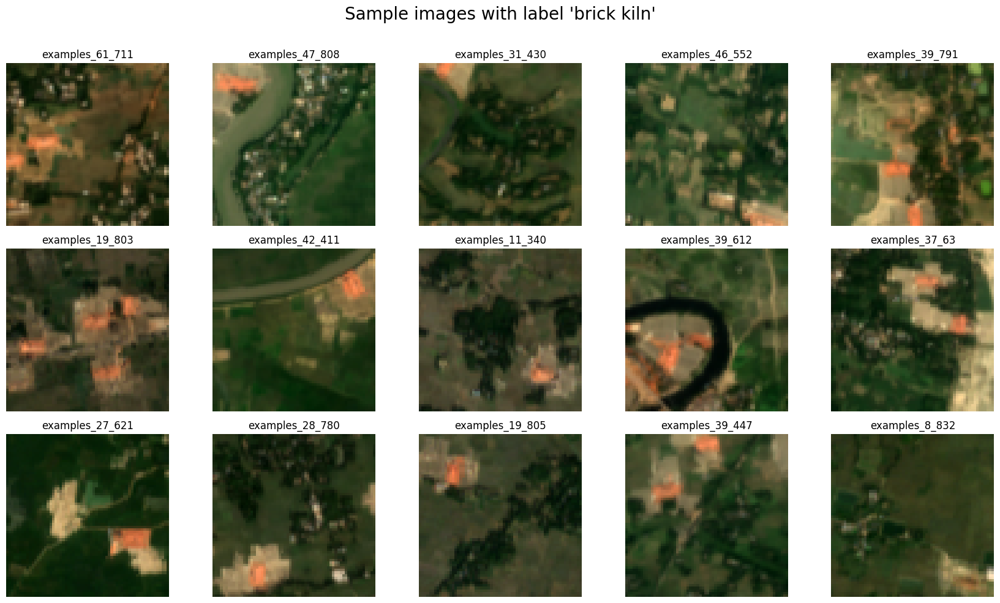

In [ ]:
# Plot sample images from POSITIVE class (brick kiln)
plot_images_of_one_label(test_df_brickkiln, 'brick kiln') # optional seed as third parameter

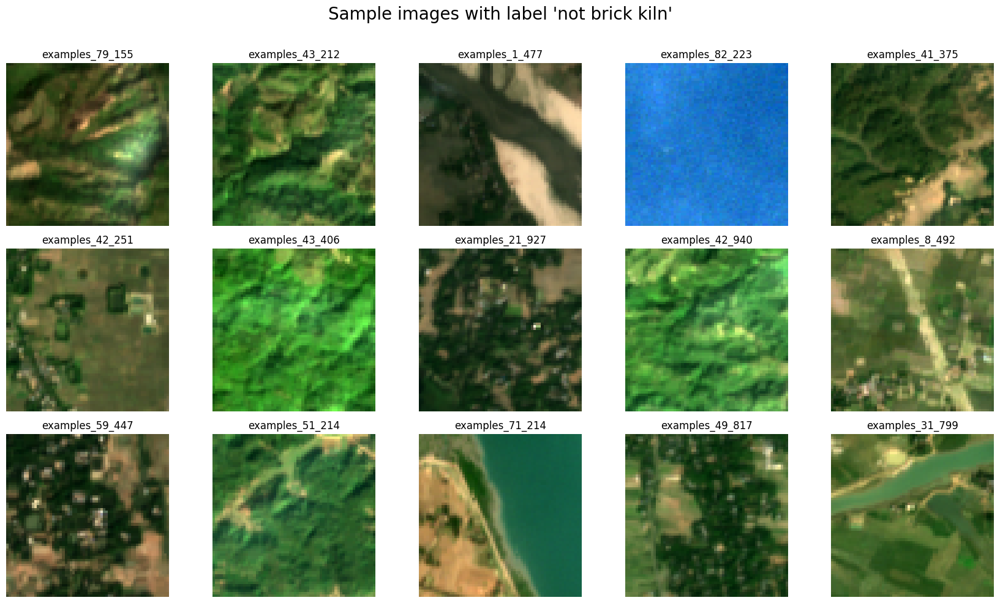

In [ ]:
# Plot sample images from NEGATIVE class (not brick kiln)
plot_images_of_one_label(test_df_brickkiln, 'not brick kiln') # optional seed as third parameter

### 2) m-pv4ger

In [ ]:
# Set images path and select sample image
images_folder = 'm-pv4ger'
images_path = os.path.join(data_path, images_folder)
image_id = os.listdir(images_path)[0] # .hdf5 file
filename = os.path.join(images_path, image_id) # path to .hdf5 file

# Check the content of a .hdf5 file
f = h5py.File(filename, 'r')
print(type(f))
print(len(f.keys()), 'bands available')
list(f.keys())

<class 'h5py._hl.files.File'>
3 bands available


['Blue', 'Green', 'Red']

In [ ]:
# A h5py dataset is very similar to NumPy arrays, but allows for optimized storage
print(f['Green'])
# A h5py dataset has the following attributes
print('shape:', f['Green'].shape)
print('size:', f['Green'].size)
print('ndim:', f['Green'].ndim)
print('dtype:', f['Green'].dtype)
print('nbytes:', f['Green'].nbytes)
f['Green'][0]

<HDF5 dataset "Green": shape (320, 320), type "|u1">
shape: (320, 320)
size: 102400
ndim: 2
dtype: uint8
nbytes: 102400


array([171, 184, 184, 184, 184, 159, 159, 162, 162, 120, 120,  89,  89,
       100, 100, 105,  97, 116, 116, 135, 135, 133, 133, 113, 113, 125,
       125, 118, 118, 108, 108, 133, 133, 133, 133, 104, 104, 100, 100,
       128, 128, 147, 147, 151, 151, 142, 142, 142, 142, 154, 154, 136,
       136, 114, 114, 107, 107, 101, 101,  93,  93, 116, 116, 127, 127,
       129, 129, 142, 142, 148, 148, 125, 125, 115, 115, 117, 117, 112,
       112, 118, 118, 137, 137, 127, 127, 117, 117, 128, 128, 136, 128,
       128, 114, 114, 100, 100, 101, 101, 117, 117, 108, 108, 122, 122,
       115, 115, 130, 130, 124, 124, 131, 131, 128, 128, 130, 130, 124,
       124, 130, 130, 121, 121, 108, 108, 115, 115, 124, 124, 146, 146,
       150, 150, 142, 142, 134, 134, 137, 137, 151, 151, 163, 163, 118,
       118, 107, 107, 108, 108, 123, 123, 148, 148, 141, 141, 122, 122,
       119, 119, 129, 129, 139, 139, 120, 120, 123, 123, 120, 120, 115,
       115, 115, 115, 137, 137, 130, 130, 108, 108, 119, 119, 13

- Loading the splits and labels information



In [ ]:
# Read default partition
with open(os.path.join(data_path, images_folder, 'default_partition.json'), 'r') as file:
    def_partition = json.load(file)
    print("Splits:")
    print(list(def_partition.keys()))
    print(len(def_partition['train']), len(def_partition['valid']), len(def_partition['test']))

# Read labels
with open(os.path.join(images_path, 'task_specs.pkl'), 'rb') as f:
    task_data = pickle.load(f)
    print("\nLabels:")
    pv4ger_labels = task_data.label_type.class_names
    print(pv4ger_labels)
    # ['no solar pv', 'solar pv']

# Read label map
with open(os.path.join(images_path, 'label_map.json'), 'r') as file:
    label_map = json.load(file)
    print("\nLabels proportion:")
    print("0:", len(label_map['0']))
    print("1:", len(label_map['1']))
    # labels == {'0': [id1, id2, ...], '1': [id4, id5, ...]}

# Reverse the label map: image_id -> label
image_to_label_map = {}
for label, image_list in label_map.items():
    for img_id in image_list:
        if label == '0':
            image_to_label_map[img_id] = pv4ger_labels[0]
        elif label == '1':
            image_to_label_map[img_id] = pv4ger_labels[1]

Splits:
['train', 'valid', 'test']
11814 999 999

Labels:
['no solar pv', 'solar pv']

Labels proportion:
0: 11692
1: 2120


- Build the TEST dataframe collecting all the information we need for inference

In [ ]:
# Build dataFrame for TEST images
data = []
for img_id in def_partition['test']:
    label = image_to_label_map.get(img_id, None)  # None in case any image is missing in label_map
    data.append({
        'image_id': img_id,
        'filename': os.path.join(images_path, img_id + '.hdf5'),
        'bands': len(h5py.File(filename, 'r').keys()),
        'split': 'test',
        'label': label
    })

test_df_pv4ger = pd.DataFrame(data)
test_df_pv4ger.head()

,image_id,filename,bands,split,label
0,"7.222180076676272, 50.698836440699615",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv
1,"6.669612320016594, 51.73787665131514",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv
2,"6.339084510786531, 51.22087464650394",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv
3,"8.724089525367726, 51.77399340700887",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv
4,"7.8016608434245205, 52.243655122484405",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv


In [ ]:
test_df_pv4ger.label.value_counts()

,label
no solar pv,846
solar pv,153


In [ ]:
# Save TEST dataframe to file
# test_df_pv4ger.to_csv('/content/drive/MyDrive/Thesis CLIP4EO/GEO-Bench classification data/test_df_m-pv4ger.csv',
#                        mode = 'w', index = False, header  = True)

In [ ]:
# Load TEST dataframe from file
test_df_pv4ger = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/GEO-Bench classification data/test_df_m-pv4ger.csv')
test_df_pv4ger.head()

,image_id,filename,bands,split,label
0,"7.222180076676272, 50.698836440699615",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv
1,"6.669612320016594, 51.73787665131514",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv
2,"6.339084510786531, 51.22087464650394",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv
3,"8.724089525367726, 51.77399340700887",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv
4,"7.8016608434245205, 52.243655122484405",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv


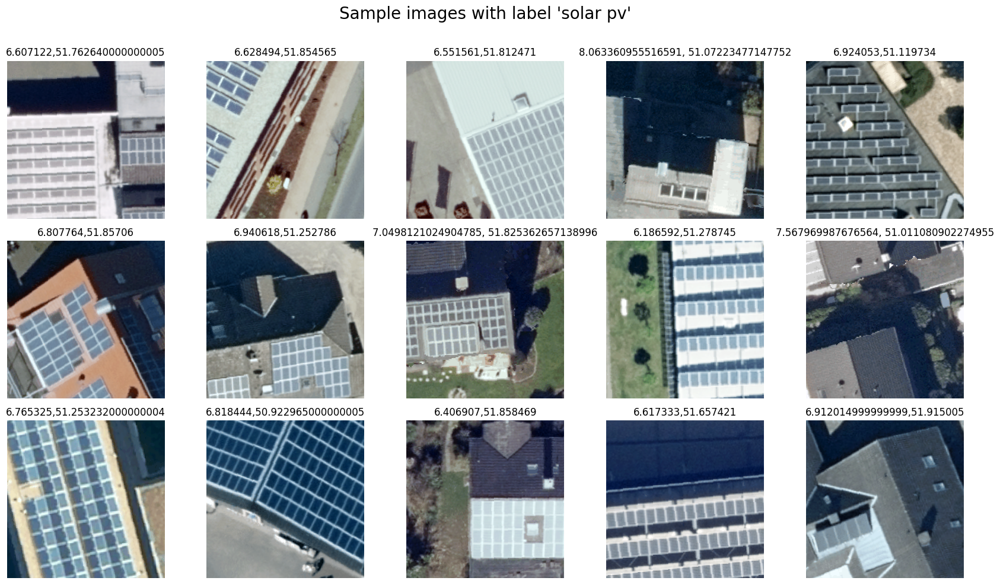

In [ ]:
# Plot sample images from POSITIVE class (solar pv)
plot_images_of_one_label(test_df_pv4ger, 'solar pv', ['Red', 'Green', 'Blue'])

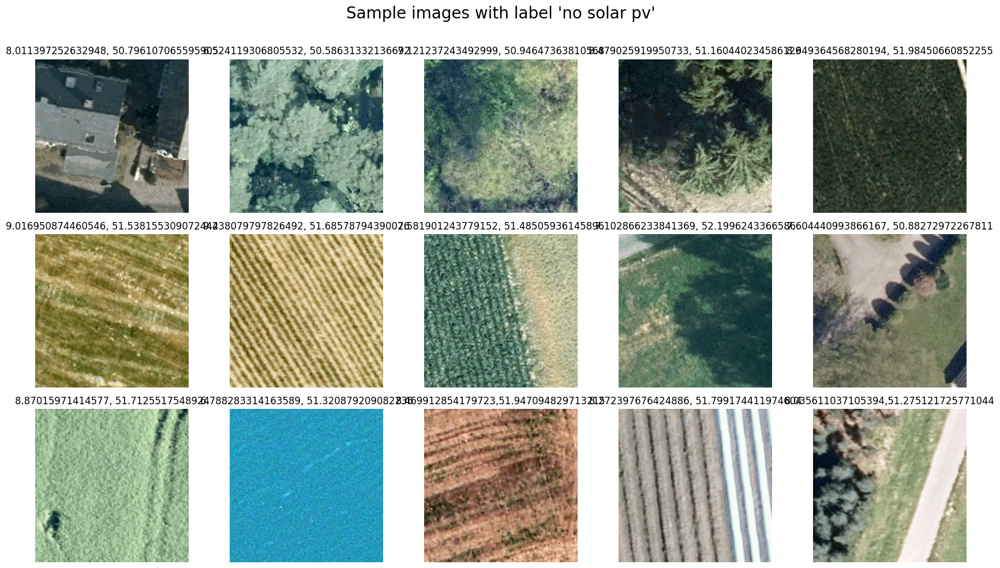

In [ ]:
# Plot sample images from NEGATIVE class (no solar pv)
plot_images_of_one_label(test_df_pv4ger, 'no solar pv', ['Red', 'Green', 'Blue'])

### 3) m-forestnet

In [ ]:
# Set images path and select sample image
images_folder = 'm-forestnet'
images_path = os.path.join(data_path, images_folder)
image_id = os.listdir(images_path)[0] # .hdf5 file
filename = os.path.join(images_path, image_id) # path to .hdf5 file

# Check the content of a .hdf5 file
f = h5py.File(filename, 'r')
print(type(f))
print(len(f.keys()), 'bands available')
list(f.keys())

<class 'h5py._hl.files.File'>
6 bands available


['02 - Blue_2017-01-01',
 '03 - Green_2017-01-01',
 '04 - Red_2017-01-01',
 '05 - NIR_2017-01-01',
 '06 - SWIR1_2017-01-01',
 '07 - SWIR2_2017-01-01']

> **NOTE:** the dates in the dataset names of *every* image <u>are different</u>!!!

In [ ]:
# A h5py dataset is very similar to NumPy arrays, but allows for optimized storage
key = list(f.keys())[0]
print(f[key])
# A h5py dataset has the following attributes
print('shape:', f[key].shape)
print('size:', f[key].size)
print('ndim:', f[key].ndim)
print('dtype:', f[key].dtype)
print('nbytes:', f[key].nbytes)
f[key][0]

<HDF5 dataset "02 - Blue_2017-01-01": shape (332, 332), type "|u1">
shape: (332, 332)
size: 110224
ndim: 2
dtype: uint8
nbytes: 110224


array([ 74,  71,  71,  74,  74,  77,  77,  78,  86,  84,  77,  75,  75,
        76,  76,  74,  74,  74,  76,  74,  74,  73,  73,  73,  74,  76,
        78,  76,  69,  71,  69,  67,  66,  68,  70,  71,  70,  68,  68,
        71,  68,  67,  71,  71,  71,  71,  70,  71,  70,  70,  69,  68,
        69,  69,  71,  70,  71,  70,  70,  70,  69,  68,  71,  68,  70,
        71,  70,  71,  72,  73,  74,  75,  75,  75,  72,  72,  72,  73,
        74,  75,  74,  74,  77,  77,  76,  77,  74,  71,  72,  74,  75,
        75,  74,  67,  68,  69,  70,  69,  69,  69,  69,  68,  69,  71,
        71,  71,  72,  72,  71,  71,  71,  71,  71,  70,  71,  74,  71,
        71,  69,  71,  70,  72,  73,  74,  75,  75,  74,  71,  72,  74,
        72,  71,  72,  72,  72,  72,  73,  72,  71,  71,  71,  74,  76,
        76,  77,  78,  75,  75,  74,  75,  77,  80,  79,  81,  80,  84,
        85,  89,  84,  83,  92, 104,  92,  83,  85,  80,  78,  76,  74,
        74,  73,  71,  74,  74,  75,  74,  73,  76,  79,  78,  7

- Loading splits and labels information

In [ ]:
# Read default partition
with open(os.path.join(data_path, images_folder, 'default_partition.json'), 'r') as file:
    def_partition = json.load(file)
    print("Splits:")
    print(list(def_partition.keys()))
    print(len(def_partition['train']), len(def_partition['valid']), len(def_partition['test']))

# Read labels
with open(os.path.join(images_path, 'task_specs.pkl'), 'rb') as f:
    task_data = pickle.load(f)
    print("\nLabels:")
    forestnet_labels = task_data.label_type.class_names #12
    print('-', task_data.label_type.n_classes, "labels -")
    for l in forestnet_labels:
        print(l)

# Read label map
with open(os.path.join(images_path, 'label_map.json'), 'r') as file:
    label_map = json.load(file)
    print("\nLabels proportion:")
    for k in label_map.keys():
        print(f"{k}:", len(label_map[k]))
    # labels == {'0': [id1, id2, ...], '1': [id4, id5, ...], ..., '11': [id34, id56, ...]}

# Reverse the label map: image_id -> label
image_to_label_map = {}
for label, image_list in label_map.items():
    for img_id in image_list:
        image_to_label_map[img_id] = forestnet_labels[int(label)]

Splits:
['train', 'valid', 'test']
6464 989 993

Labels:
- 12 labels -
Oil palm plantation
Timber plantation
Other large-scale plantations
Grassland shrubland
Small-scale agriculture
Small-scale mixed plantation
Small-scale oil palm plantation
Mining
Fish pond
Logging
Secondary forest
Other

Labels proportion:
0: 1764
1: 1208
2: 618
3: 748
4: 1858
5: 622
6: 428
7: 250
8: 124
9: 200
10: 370
11: 256


- Build the TEST dataframe collecting all the information we need for inference

In [ ]:
# Build dataFrame for TEST images
data = []
for img_id in def_partition['test']:
    label = image_to_label_map.get(img_id, None)  # None in case any image is missing in label_map
    data.append({
        'image_id': img_id,
        'filename': os.path.join(images_path, img_id + '.hdf5'),
        'bands': len(h5py.File(filename, 'r').keys()),
        'split': 'test',
        'label': label
    })

test_df_forestnet = pd.DataFrame(data)
test_df_forestnet.head()

,image_id,filename,bands,split,label
0,-1.358752546215941_113.47632662109709_2014_01_01,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,6,test,Oil palm plantation
1,-0.3909200308691534_116.02049649124226_2015_01_01,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,6,test,Oil palm plantation
2,-1.8806664692642177_111.7221681696664_2013_10_30,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,6,test,Oil palm plantation
3,0.3935898654105616_99.19789981112714_2013_01_01,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,6,test,Oil palm plantation
4,-2.0832762463589005_104.28473205885147_2018_08_05,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,6,test,Grassland shrubland


In [ ]:
test_df_forestnet.label.value_counts()

,label
Small-scale agriculture,219
Oil palm plantation,208
Timber plantation,142
Grassland shrubland,88
Other large-scale plantations,73
Small-scale mixed plantation,73
Small-scale oil palm plantation,50
Secondary forest,43
Other,30
Mining,29


In [ ]:
test_df_forestnet.to_csv('/content/drive/MyDrive/Thesis CLIP4EO/GEO-Bench classification data/test_df_m-forestnet.csv',
                       mode = 'w', index = False, header  = True)

In [ ]:
test_df_forestnet = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/GEO-Bench classification data/test_df_m-forestnet.csv')
test_df_forestnet.head()

,image_id,filename,bands,split,label
0,-1.358752546215941_113.47632662109709_2014_01_01,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,6,test,Oil palm plantation
1,-0.3909200308691534_116.02049649124226_2015_01_01,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,6,test,Oil palm plantation
2,-1.8806664692642177_111.7221681696664_2013_10_30,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,6,test,Oil palm plantation
3,0.3935898654105616_99.19789981112714_2013_01_01,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,6,test,Oil palm plantation
4,-2.0832762463589005_104.28473205885147_2018_08_05,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,6,test,Grassland shrubland


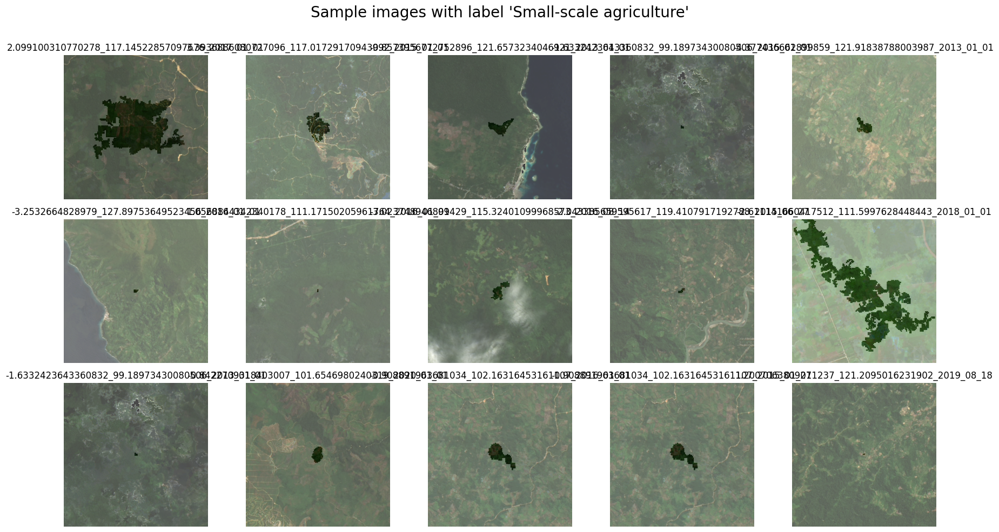

In [ ]:
# Plot sample images from a specific class
plot_images_of_one_label_forestnet(test_df_forestnet, 'Small-scale agriculture')

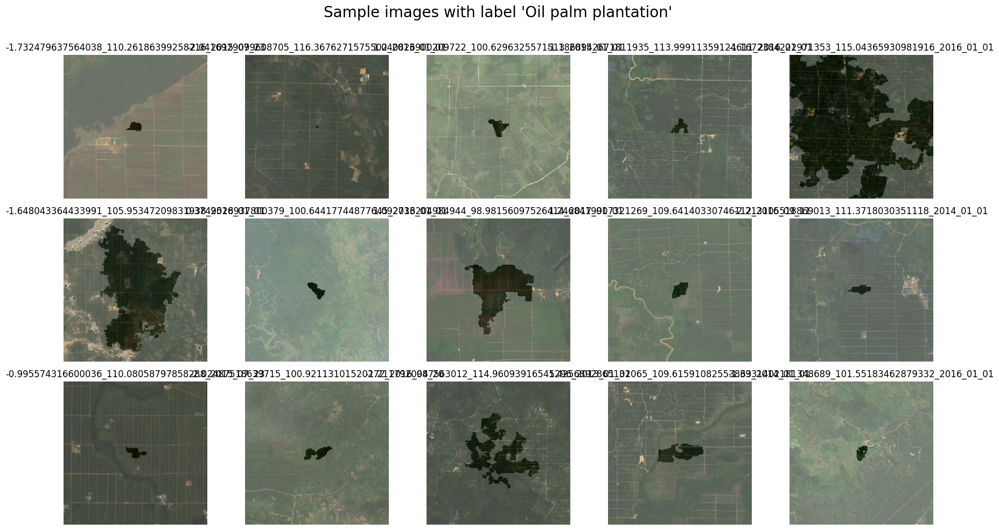

In [ ]:
# Plot sample images from a specific class
plot_images_of_one_label_forestnet(test_df_forestnet, 'Oil palm plantation')

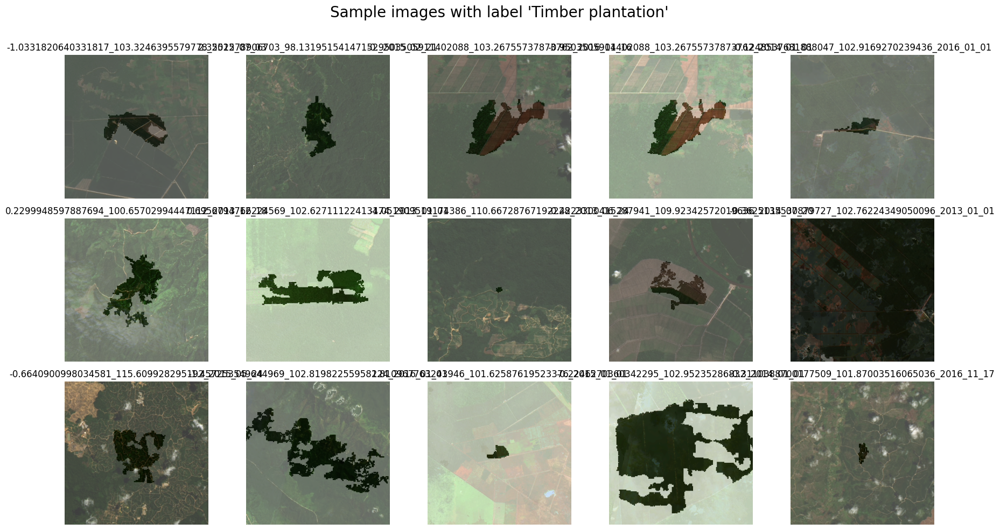

In [ ]:
# Plot sample images from a specific class
plot_images_of_one_label_forestnet(test_df_forestnet, 'Timber plantation')

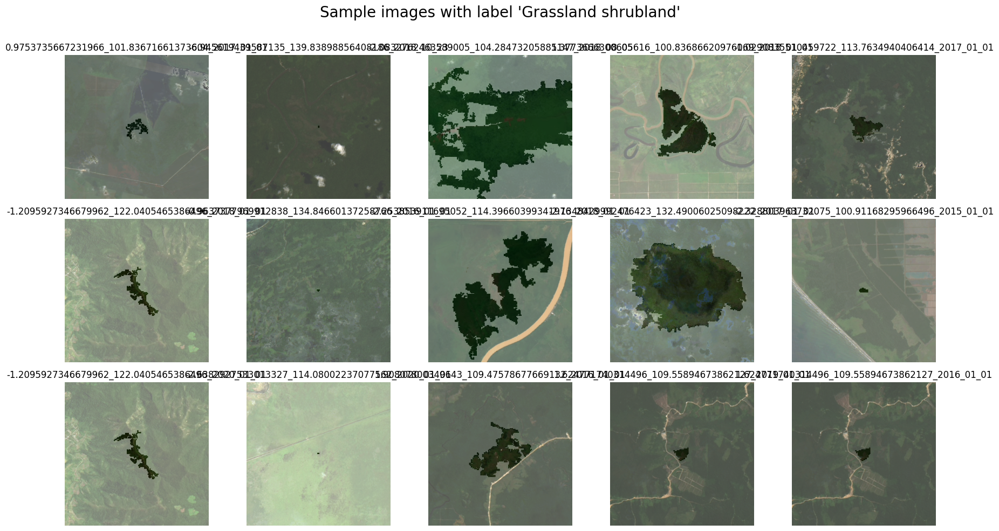

In [ ]:
# Plot sample images from a specific class
plot_images_of_one_label_forestnet(test_df_forestnet, 'Grassland shrubland')

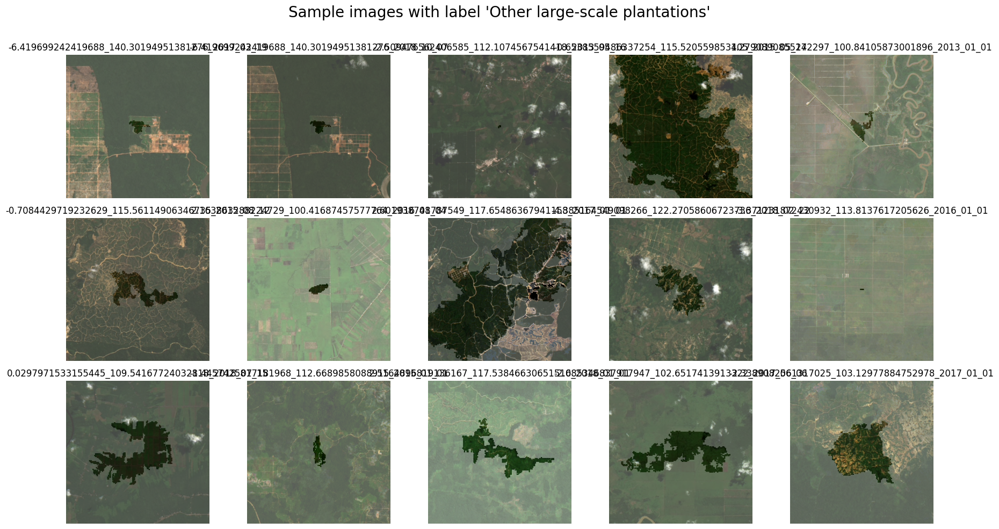

In [ ]:
# Plot sample images from a specific class
plot_images_of_one_label_forestnet(test_df_forestnet, 'Other large-scale plantations')

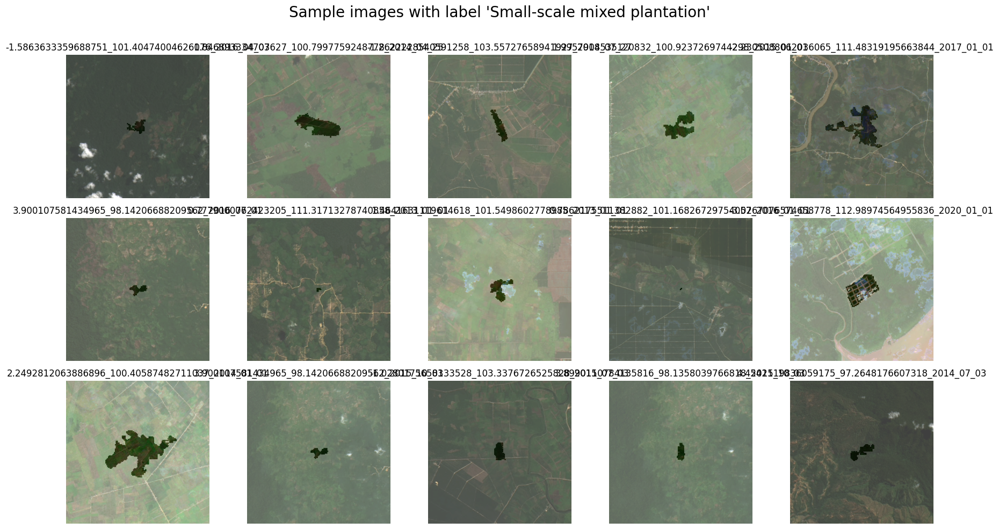

In [ ]:
# Plot sample images from a specific class
plot_images_of_one_label_forestnet(test_df_forestnet, 'Small-scale mixed plantation')

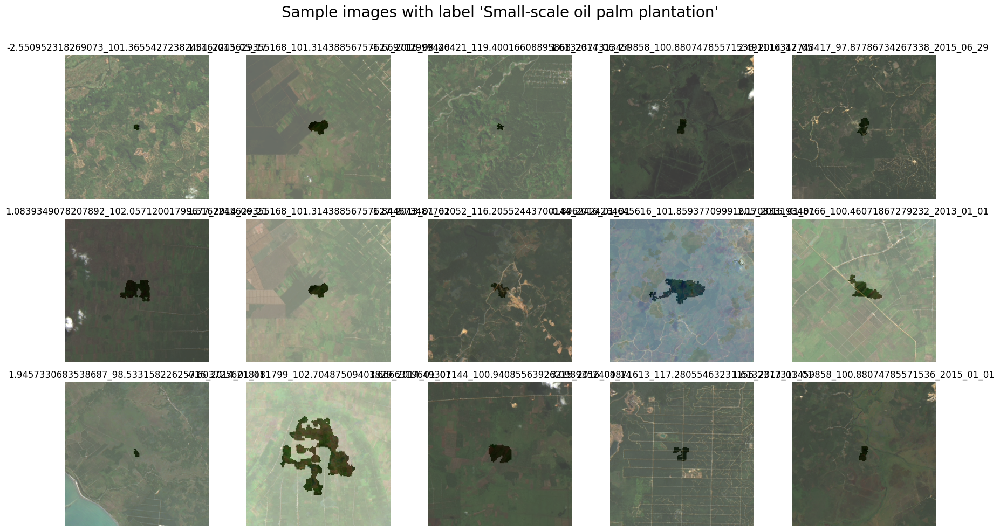

In [ ]:
# Plot sample images from a specific class
plot_images_of_one_label_forestnet(test_df_forestnet, 'Small-scale oil palm plantation')

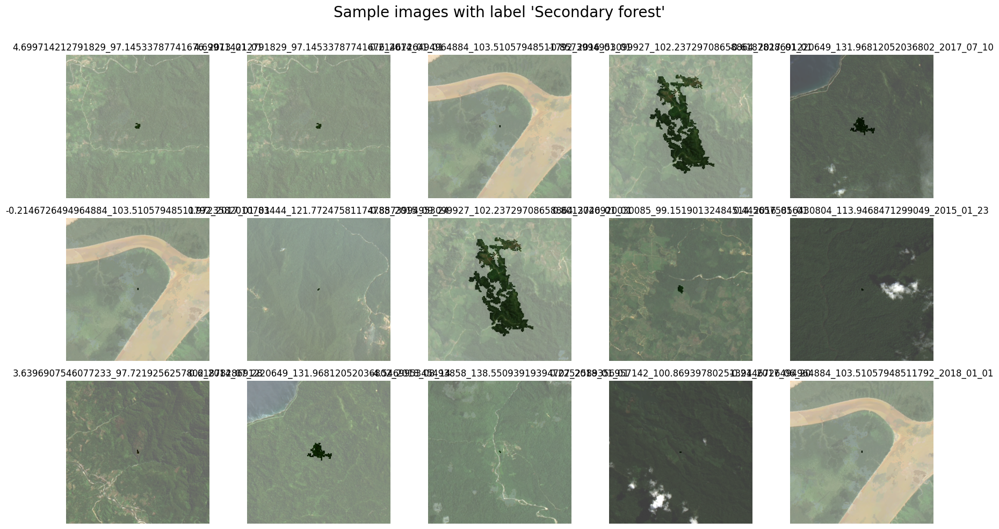

In [ ]:
# Plot sample images from a specific class
plot_images_of_one_label_forestnet(test_df_forestnet, 'Secondary forest')

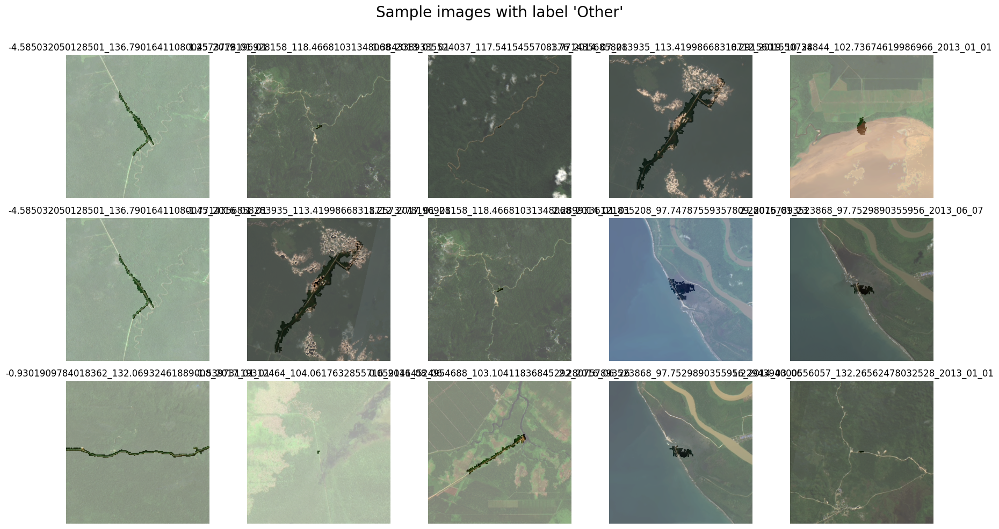

In [ ]:
# Plot sample images from a specific class
plot_images_of_one_label_forestnet(test_df_forestnet, 'Other')

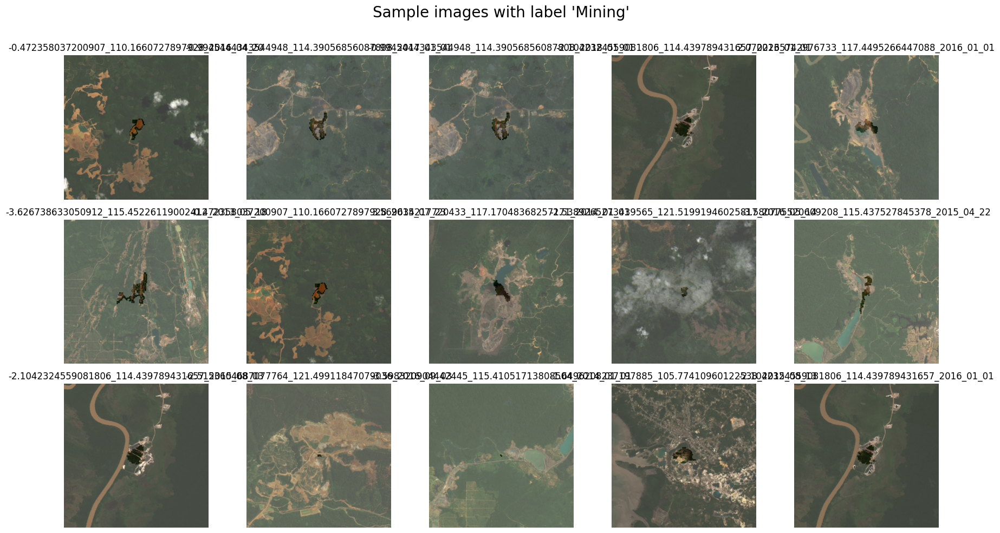

In [ ]:
# Plot sample images from a specific class
plot_images_of_one_label_forestnet(test_df_forestnet, 'Mining')

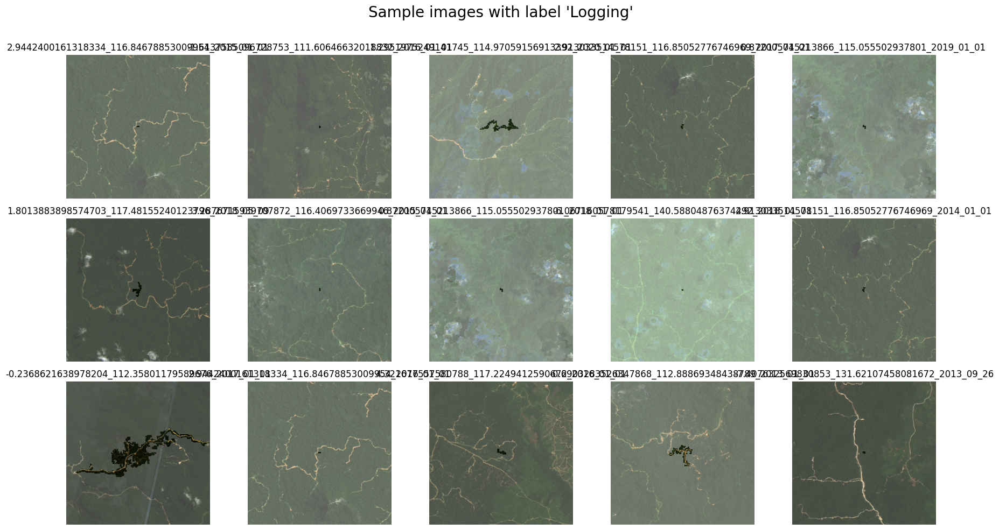

In [ ]:
# Plot sample images from a specific class
plot_images_of_one_label_forestnet(test_df_forestnet, 'Logging')

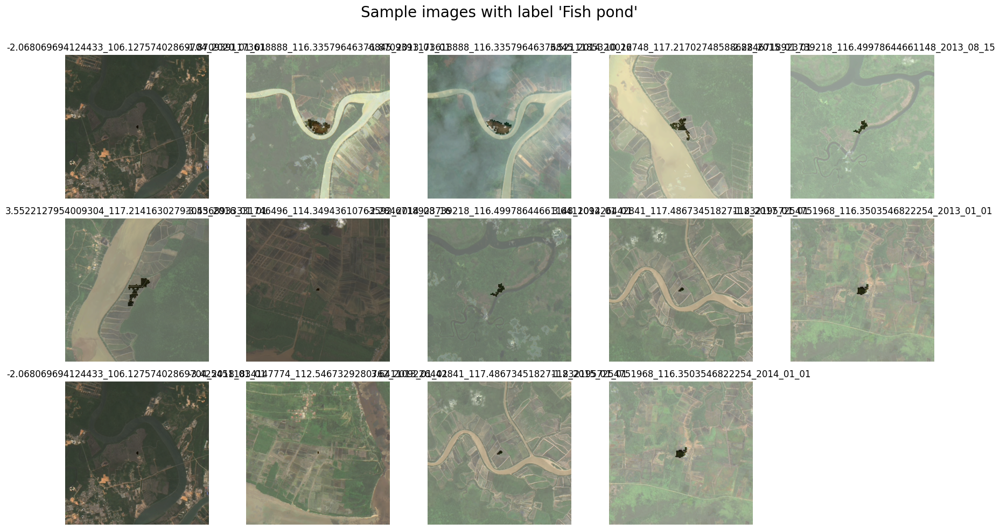

In [ ]:
# Plot sample images from a specific class
plot_images_of_one_label_forestnet(test_df_forestnet, 'Fish pond')

### 4) m-eurosat

In [ ]:
# Set images path and select sample image
images_folder = 'm-eurosat'
images_path = os.path.join(data_path, images_folder)
image_id = os.listdir(images_path)[0] # .hdf5 file
filename = os.path.join(images_path, image_id) # path to .hdf5 file
print(image_id)

# Check the content of a .hdf5 file
f = h5py.File(filename, 'r')
print(type(f))
print(len(f.keys()), 'bands available')
list(f.keys())

id_25673.hdf5
<class 'h5py._hl.files.File'>
13 bands available


['01 - Coastal aerosol',
 '02 - Blue',
 '03 - Green',
 '04 - Red',
 '05 - Vegetation Red Edge',
 '06 - Vegetation Red Edge',
 '07 - Vegetation Red Edge',
 '08 - NIR',
 '08A - Vegetation Red Edge',
 '09 - Water vapour',
 '10 - SWIR - Cirrus',
 '11 - SWIR',
 '12 - SWIR']

In [ ]:
# A h5py dataset is very similar to NumPy arrays, but allows for optimized storage
print(f['01 - Coastal aerosol'])
# A h5py dataset has the following attributes
print('shape:', f['01 - Coastal aerosol'].shape)
print('size:', f['01 - Coastal aerosol'].size)
print('ndim:', f['01 - Coastal aerosol'].ndim)
print('dtype:', f['01 - Coastal aerosol'].dtype)
print('nbytes:', f['01 - Coastal aerosol'].nbytes)
f['01 - Coastal aerosol'][0]

<HDF5 dataset "01 - Coastal aerosol": shape (64, 64), type "<i2">
shape: (64, 64)
size: 4096
ndim: 2
dtype: int16
nbytes: 8192


array([1372, 1372, 1375, 1379, 1385, 1391, 1397, 1403, 1408, 1412, 1414,
       1415, 1414, 1410, 1405, 1398, 1388, 1378, 1367, 1356, 1347, 1339,
       1334, 1331, 1332, 1338, 1347, 1362, 1381, 1404, 1428, 1453, 1476,
       1497, 1515, 1529, 1539, 1545, 1546, 1542, 1534, 1522, 1508, 1493,
       1478, 1464, 1452, 1441, 1433, 1425, 1420, 1415, 1412, 1410, 1409,
       1407, 1405, 1402, 1398, 1393, 1387, 1381, 1375, 1369], dtype=int16)

- Extracting labels with geobench module

In [ ]:
from pathlib import Path

# Show labels associated to first 10 images
for i in range(10):
    image_id = os.listdir(images_path)[i]
    filename = os.path.join(images_path, image_id)
    # need to convert filename from str to Path, or it raises an error
    sample = geobench.load_sample_hdf5(Path(filename), label_only=True)
    label = sample.label
    print(label, type(label))

7 <class 'int'>
7 <class 'int'>
3 <class 'int'>
6 <class 'int'>
0 <class 'int'>
8 <class 'int'>
3 <class 'int'>
9 <class 'int'>
1 <class 'int'>
0 <class 'int'>


> **Note:** <br>
  1. So, it seems that also `m-eurosat` accounts for a multi-class classification task $\to$ softmax to pick the label
  2. The following code cell builds the test input dataframe and extracts the labels for all the images. <br>

- Loading the splits and labels information

In [ ]:
# Read default partition
with open(os.path.join(data_path, images_folder, 'default_partition.json'), 'r') as file:
    def_partition = json.load(file)
    print("\nSplits:")
    print(list(def_partition.keys()))
    print(len(def_partition['train']), len(def_partition['valid']), len(def_partition['test']))

# Read labels
with open(os.path.join(images_path, 'task_specs.pkl'), 'rb') as f:
    task_data = pickle.load(f)
    eurosat_labels = task_data.label_type.class_names
    print("\nLabels:\n")
    print('-', task_data.label_type.n_classes, "labels -")
    for l in eurosat_labels:
        print(l)

print("\nSORTING EUROSAT LABELS...\n")
eurosat_labels.sort()


Splits:
['train', 'valid', 'test']
2000 1000 1000

Labels:

- 10 labels -
Industrial Buildings
Residential Buildings
Annual Crop
Permanent Crop
River
Sea and Lake
Herbaceous Vegetation
Highway
Pasture
Forest

SORTING EUROSAT LABELS...



> **Note:** takes * ~ 15 mins * to run! Load `test_df_eurosat.csv` from file below instead

- Build the TEST dataframe collecting all the information we need for inference

In [ ]:
# Building TEST dataframe ------------------------------------------------------
print("\nTEST set: -------------------------------------------------------------")
data = []
split = 'test'
for img_id in def_partition[split]:
    filename = os.path.join(images_path, img_id + '.hdf5')
    sample = geobench.load_sample_hdf5(Path(filename), label_only = True)
    label = eurosat_labels[int(sample.label)]
    data.append({
        'image_id': img_id,
        'filename': os.path.join(images_path, img_id + '.hdf5'),
        'bands': len(h5py.File(filename, 'r').keys()),
        'split': split,
        'label_idx': int(sample.label),
        'label': label
    })

test_df_eurosat = pd.DataFrame(data)
print(test_df_eurosat.head())


# Building VALIDATION dataframe ------------------------------------------------
print("\nVALIDATION set: -------------------------------------------------------")
data = []
split = 'valid'
for img_id in def_partition[split]:
    filename = os.path.join(images_path, img_id + '.hdf5')
    sample = geobench.load_sample_hdf5(Path(filename), label_only = True)
    label = eurosat_labels[int(sample.label)]
    data.append({
        'image_id': img_id,
        'filename': os.path.join(images_path, img_id + '.hdf5'),
        'bands': len(h5py.File(filename, 'r').keys()),
        'split': split,
        'label_idx': int(sample.label),
        'label': label
    })

valid_df_eurosat = pd.DataFrame(data)
print(valid_df_eurosat.head())

# Building TRAIN dataframe -----------------------------------------------------
print("\nTRAIN set: ------------------------------------------------------------")
data = []
split = 'train'
for img_id in def_partition[split]:
    filename = os.path.join(images_path, img_id + '.hdf5')
    sample = geobench.load_sample_hdf5(Path(filename), label_only = True)
    label = eurosat_labels[int(sample.label)]
    data.append({
        'image_id': img_id,
        'filename': os.path.join(images_path, img_id + '.hdf5'),
        'bands': len(h5py.File(filename, 'r').keys()),
        'split': split,
        'label_idx': int(sample.label),
        'label': label
    })

train_df_eurosat = pd.DataFrame(data)
print(train_df_eurosat.head())


TEST set: -------------------------------------------------------------
   image_id                                           filename  bands split  \
0  id_22869  /content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...     13  test   
1  id_26790  /content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...     13  test   
2  id_24810  /content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...     13  test   
3  id_23442  /content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...     13  test   
4  id_26899  /content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...     13  test   

   label_idx                  label  
0          2  Herbaceous Vegetation  
1          9           Sea and Lake  
2          6         Permanent Crop  
3          3                Highway  
4          9           Sea and Lake  

VALIDATION set: -------------------------------------------------------
   image_id                                           filename  bands  split  \
0  id_18620  /content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...     13  

In [ ]:
test_df_eurosat.to_csv('/content/drive/MyDrive/Thesis CLIP4EO/GEO-Bench classification data/test_df_m-eurosat.csv',
                       mode = 'w', index = False, header  = True)
valid_df_eurosat.to_csv('/content/drive/MyDrive/Thesis CLIP4EO/GEO-Bench classification data/val_df_m-eurosat.csv',
                       mode = 'w', index = False, header  = True)
train_df_eurosat.to_csv('/content/drive/MyDrive/Thesis CLIP4EO/GEO-Bench classification data/train_df_m-eurosat.csv',
                       mode = 'w', index = False, header  = True)

In [ ]:
test_df_eurosat.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 6 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   image_id   1000 non-null   object
 1   filename   1000 non-null   object
 2   bands      1000 non-null   int64 
 3   split      1000 non-null   object
 4   label_idx  1000 non-null   int64 
 5   label      1000 non-null   object
dtypes: int64(2), object(4)
memory usage: 47.0+ KB


In [ ]:
# Save TEST dataframe to file
# test_df_eurosat.to_csv('/content/drive/MyDrive/Thesis CLIP4EO/GEO-Bench classification data/test_df_m-eurosat.csv',
#                        mode = 'w', index = False, header  = True)

In [ ]:
# Load TEST dataframe from file
test_df_eurosat = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/GEO-Bench classification data/test_df_m-eurosat.csv')
test_df_eurosat.head()

,image_id,filename,bands,split,label_idx,label
0,id_22869,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,2,Herbaceous Vegetation
1,id_26790,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,9,Sea and Lake
2,id_24810,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,6,Permanent Crop
3,id_23442,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,3,Highway
4,id_26899,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,9,Sea and Lake


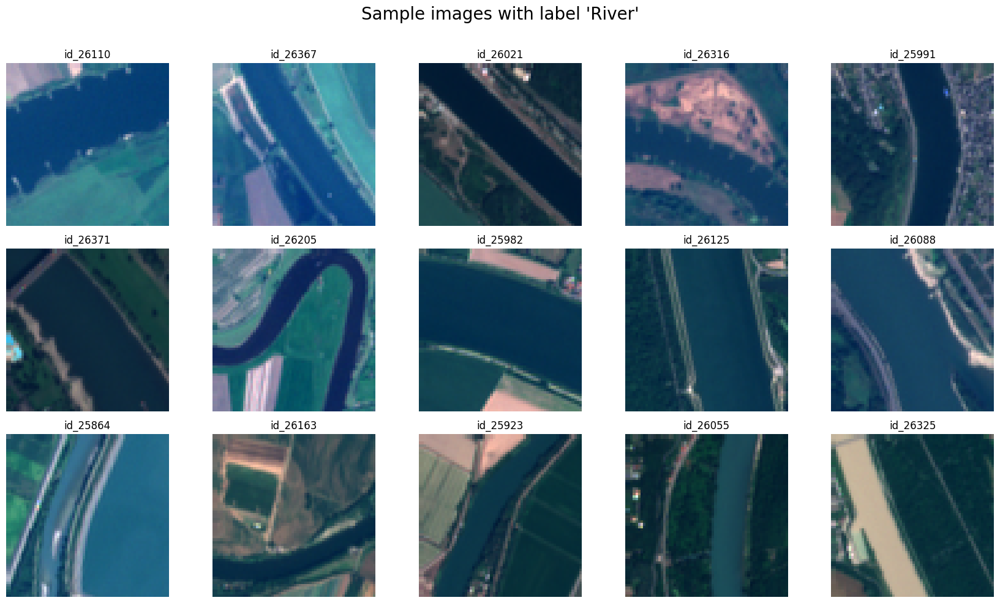

In [ ]:
plot_images_of_one_label(test_df_eurosat, 'River') # -> Industrial Buildings

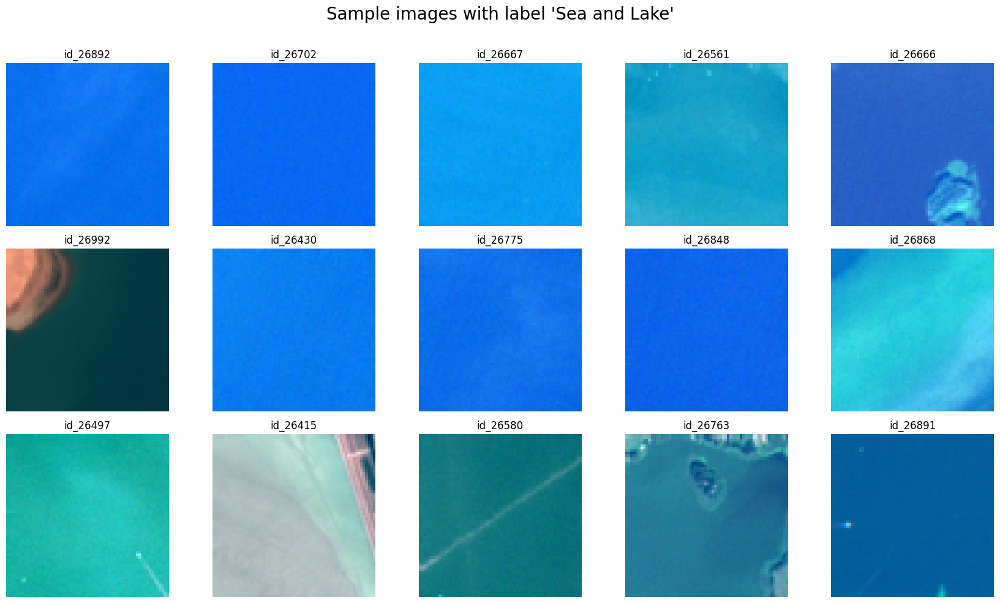

In [ ]:
plot_images_of_one_label(test_df_eurosat, 'Sea and Lake') # -> Pastures

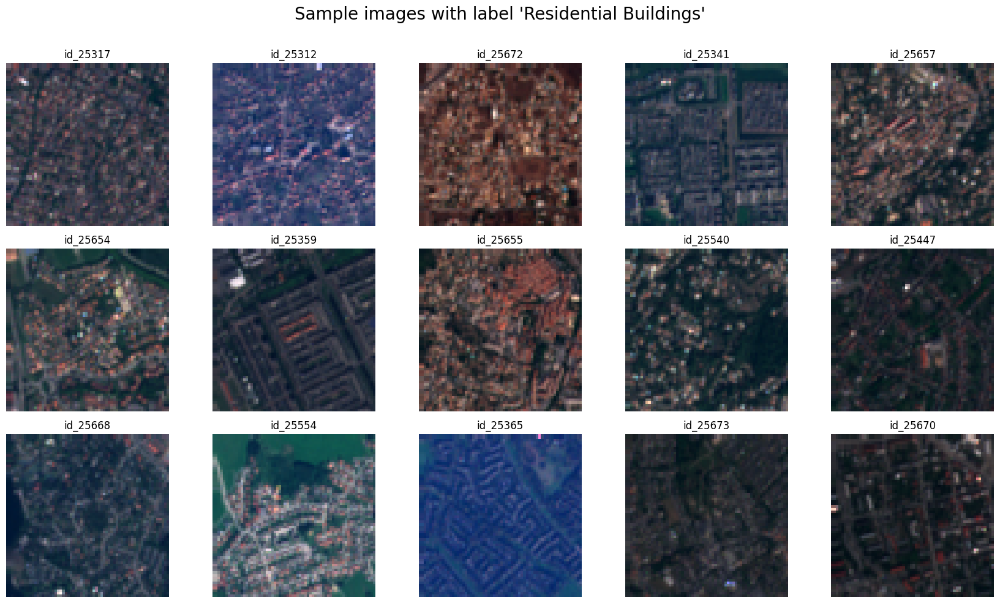

In [ ]:
plot_images_of_one_label(test_df_eurosat, 'Residential Buildings') # -> Forest

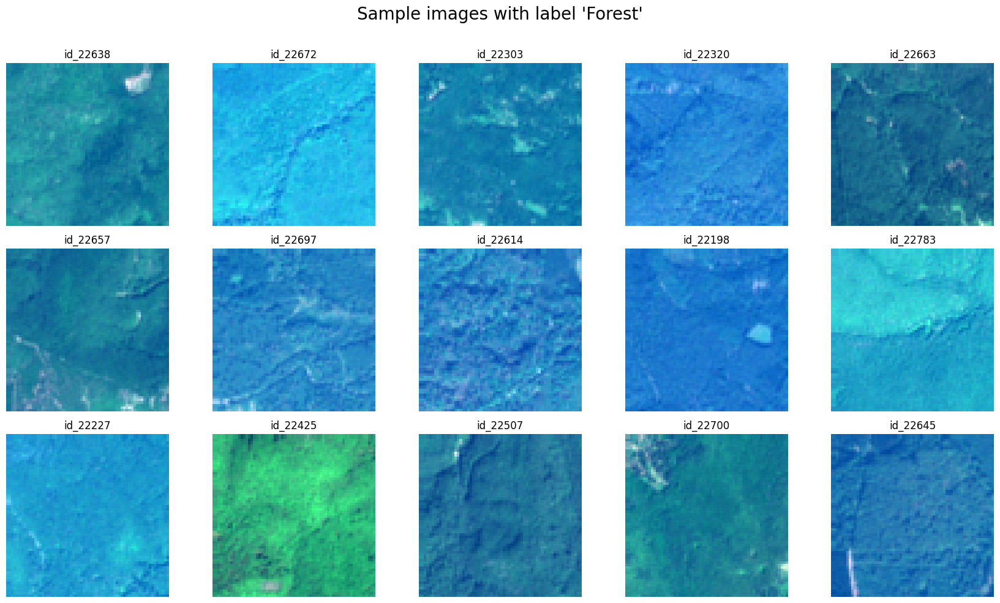

In [ ]:
plot_images_of_one_label(test_df_eurosat, 'Forest') # -> Sea and Lake

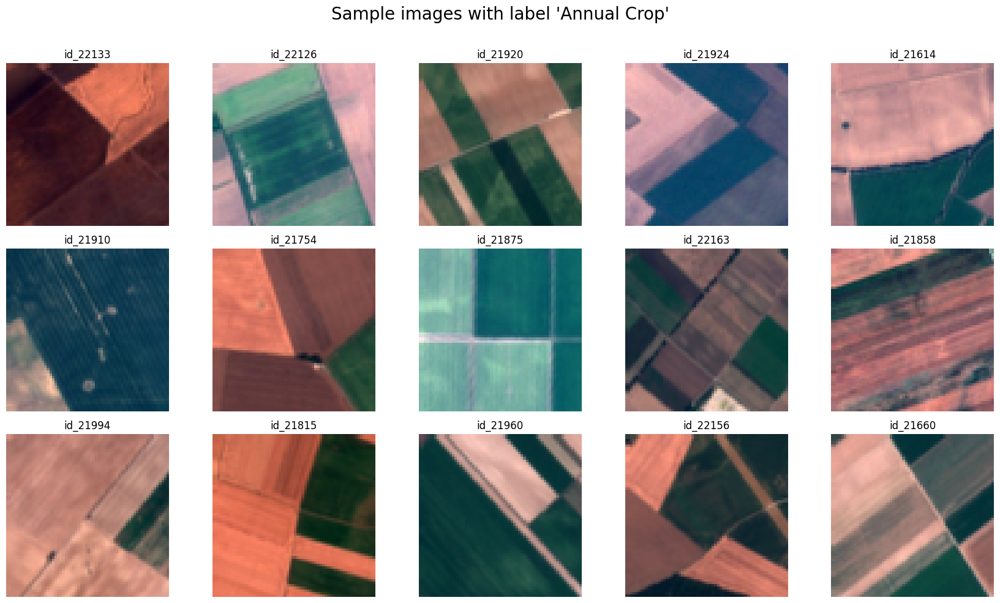

In [ ]:
plot_images_of_one_label(test_df_eurosat, 'Annual Crop') # -> Herbaceous Vegetation

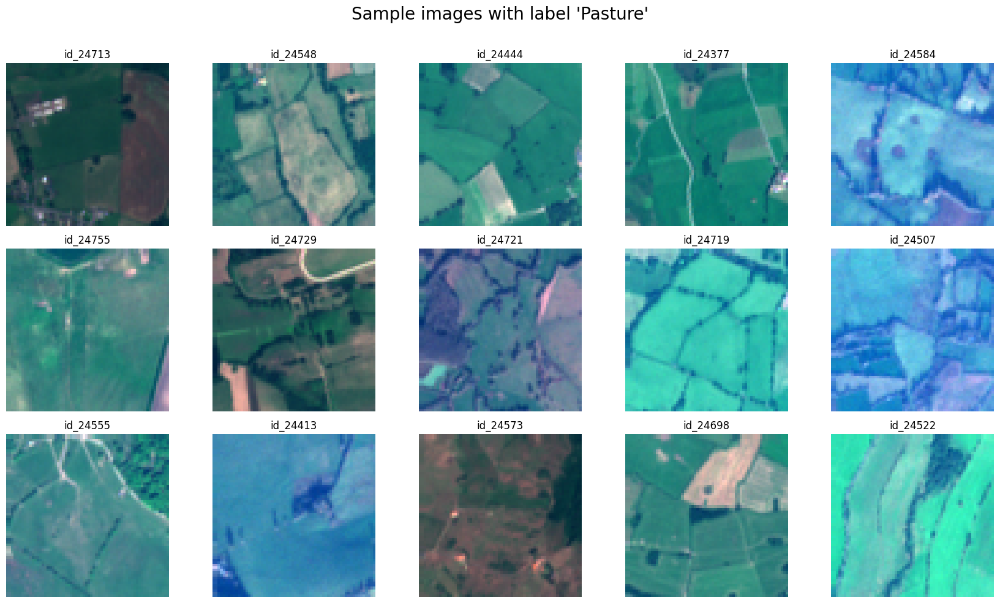

In [ ]:
plot_images_of_one_label(test_df_eurosat, 'Pasture') # -> River

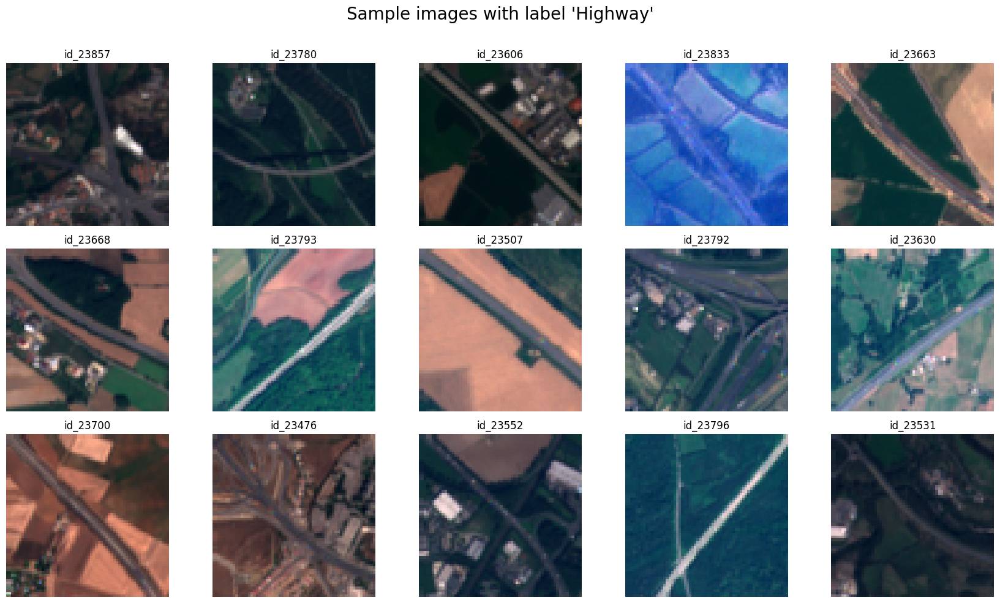

In [ ]:
plot_images_of_one_label(test_df_eurosat, 'Highway')

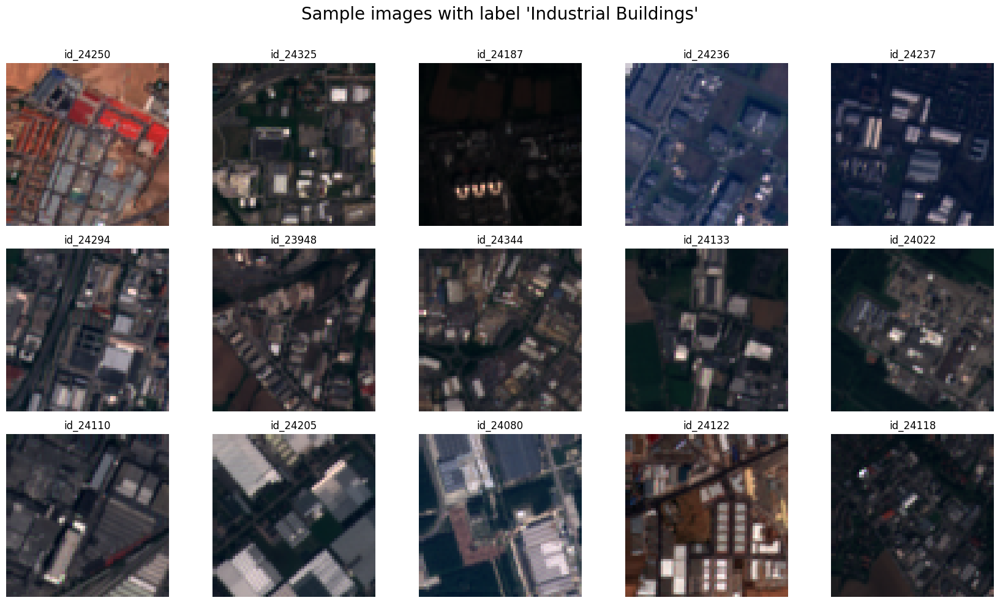

In [ ]:
plot_images_of_one_label(test_df_eurosat, 'Industrial Buildings')

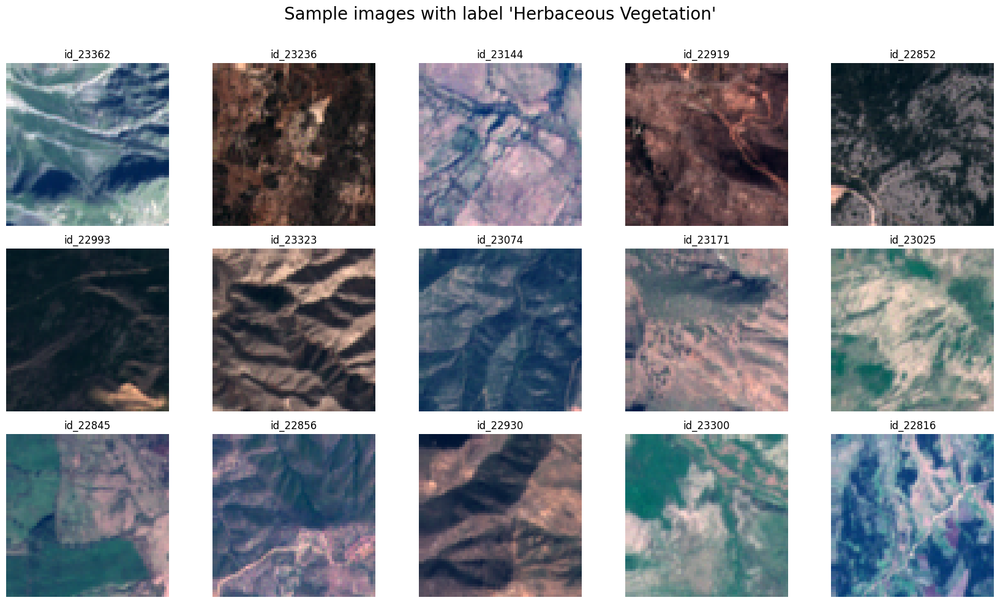

In [ ]:
plot_images_of_one_label(test_df_eurosat, 'Herbaceous Vegetation')

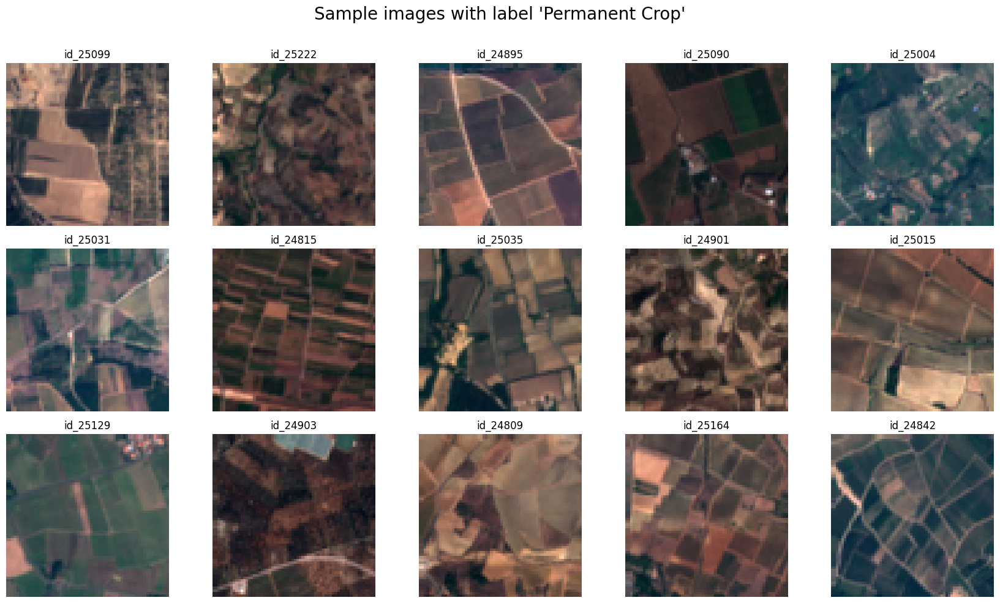

In [ ]:
plot_images_of_one_label(test_df_eurosat, 'Permanent Crop')

### 5) m-so2sat

In [ ]:
# Set images path and select sample image
images_folder = 'm-so2sat'
images_path = os.path.join(data_path, images_folder)
image_id = os.listdir(images_path)[0] # .hdf5 file
filename = os.path.join(images_path, image_id) # path to .hdf5 file
print(image_id)

# Check the content of a .hdf5 file
f = h5py.File(filename, 'r')
print(type(f))
print(len(f.keys()), 'bands available')
list(f.keys())

id_141935.hdf5
<class 'h5py._hl.files.File'>
18 bands available


['01 - VH.Real',
 '02 - Blue',
 '02 - VH.Imaginary',
 '03 - Green',
 '03 - VV.Real',
 '04 - Red',
 '04 - VV.Imaginary',
 '05 - VH.LEE Filtered',
 '05 - Vegetation Red Edge',
 '06 - VV.LEE Filtered',
 '06 - Vegetation Red Edge',
 '07 - VH.LEE Filtered.Real',
 '07 - Vegetation Red Edge',
 '08 - NIR',
 '08 - VV.LEE Filtered.Imaginary',
 '08A - Vegetation Red Edge',
 '11 - SWIR',
 '12 - SWIR']

In [ ]:
# A h5py dataset is very similar to NumPy arrays, but allows for optimized storage
print(f['02 - VH.Imaginary'])
# A h5py dataset has the following attributes
print('shape:', f['02 - VH.Imaginary'].shape)
print('size:', f['02 - VH.Imaginary'].size)
print('ndim:', f['02 - VH.Imaginary'].ndim)
print('dtype:', f['02 - VH.Imaginary'].dtype)
print('nbytes:', f['02 - VH.Imaginary'].nbytes)
f['02 - VH.Imaginary'][0]

<HDF5 dataset "02 - VH.Imaginary": shape (32, 32), type "<f4">
shape: (32, 32)
size: 1024
ndim: 2
dtype: float32
nbytes: 4096


array([-0.04439678, -0.0307361 , -0.0102453 , -0.03415081,  0.06488612,
       -0.05805577,  0.0136601 ,  0.02049002,  0.03756481,  0.11269373,
       -0.10244821, -0.01707463, -0.08878753,  0.0648828 , -0.03756349,
        0.03414842, -0.19123039, -0.07512576,  0.11610273, -0.0102443 ,
        0.03756226,  0.09219771,  0.        ,  0.21854004, -0.030732  ,
        0.13317147,  0.129756  , -0.07512143,  0.02048754, -0.00682915,
       -0.02048733,  0.06146161], dtype=float32)

- Extracting labels using geobench module

In [ ]:
from pathlib import Path

# Show labels associated to first 10 images
for i in range(10):
    image_id = os.listdir(images_path)[i]
    filename = os.path.join(images_path, image_id)
    # need to convert filename from str to Path, or it raises an error
    sample = geobench.load_sample_hdf5(Path(filename), label_only=True)
    label = sample.label
    print(label, type(label))

8 <class 'int'>
9 <class 'int'>
7 <class 'int'>
8 <class 'int'>
10 <class 'int'>
9 <class 'int'>
3 <class 'int'>
4 <class 'int'>
12 <class 'int'>
5 <class 'int'>


> **Note:** from the metadata, we get that this dataset is also suited for multi-class classification with 17 classes.

- Loading splits and label information

In [ ]:
# Read default partition
with open(os.path.join(data_path, images_folder, 'default_partition.json'), 'r') as file:
    def_partition = json.load(file)
    print("\nSplits:")
    print(list(def_partition.keys()))
    print(len(def_partition['train']), len(def_partition['valid']), len(def_partition['test']))

# Read labels
with open(os.path.join(images_path, 'task_specs.pkl'), 'rb') as f:
    task_data = pickle.load(f)
    so2sat_labels = task_data.label_type.class_names
    print("\nLabels:\n")
    print('-', task_data.label_type.n_classes, "labels -")
    for l in so2sat_labels:
        print(l)


Splits:
['train', 'valid', 'test']
19992 986 986

Labels:

- 17 labels -
Compact high rise
Compact mid rise
Compact low rise
Open high rise
Open mid rise
Open low rise
Lightweight low rise
Large low rise
Sparsely built
Heavy industry
Dense trees
Scattered trees
Bush, scrub
Low plants
Bare rock or paved
Bare soil or sand
Water


- Build the TEST dataframe collecting all the information we need for inference

In [ ]:
# Building TEST dataframe ------------------------------------------------------
print("\nTEST set: -------------------------------------------------------------")
data = []
split = 'test'
for img_id in def_partition[split]:
    filename = os.path.join(images_path, img_id + '.hdf5')
    sample = geobench.load_sample_hdf5(Path(filename), label_only = True)
    label = so2sat_labels[int(sample.label)]
    data.append({
        'image_id': img_id,
        'filename': os.path.join(images_path, img_id + '.hdf5'),
        'bands': len(h5py.File(filename, 'r').keys()),
        'split': split,
        'label': int(sample.label),
        'label': label
    })

test_df = pd.DataFrame(data)
print(test_df.head())


# Building VALIDATION dataframe ------------------------------------------------
print("\nVALIDATION set: -------------------------------------------------------")
data = []
split = 'valid'
for img_id in def_partition[split]:
    filename = os.path.join(images_path, img_id + '.hdf5')
    sample = geobench.load_sample_hdf5(Path(filename), label_only = True)
    label = so2sat_labels[int(sample.label)]
    data.append({
        'image_id': img_id,
        'filename': os.path.join(images_path, img_id + '.hdf5'),
        'bands': len(h5py.File(filename, 'r').keys()),
        'split': split,
        'label': int(sample.label),
        'label': label
    })

val_df = pd.DataFrame(data)
print(val_df.head())

# Building TRAIN dataframe -----------------------------------------------------
print("\nTRAIN set: ------------------------------------------------------------")
data = []
split = 'train'
for img_id in def_partition[split]:
    filename = os.path.join(images_path, img_id + '.hdf5')
    sample = geobench.load_sample_hdf5(Path(filename), label_only = True)
    label = so2sat_labels[int(sample.label)]
    data.append({
        'image_id': img_id,
        'filename': os.path.join(images_path, img_id + '.hdf5'),
        'bands': len(h5py.File(filename, 'r').keys()),
        'split': split,
        'label': int(sample.label),
        'label': label
    })

train_df = pd.DataFrame(data)
print(train_df.head())


TEST set: -------------------------------------------------------------
    image_id                                           filename  bands split  \
0  id_388372  /content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...     18  test   
1  id_394258  /content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...     18  test   
2  id_388689  /content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...     18  test   
3  id_400562  /content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...     18  test   
4  id_390823  /content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...     18  test   

             label  
0    Open mid rise  
1      Dense trees  
2      Bush, scrub  
3  Scattered trees  
4   Sparsely built  

VALIDATION set: -------------------------------------------------------
    image_id                                           filename  bands  split  \
0  id_354343  /content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...     18  valid   
1  id_357160  /content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...     18  valid   
2  i

In [ ]:
# Save dataframes to file
test_df.to_csv('/content/drive/MyDrive/Thesis CLIP4EO/GEO-Bench classification data/test_df_m-so2sat.csv',
                       mode = 'w', index = False, header  = True)
val_df.to_csv('/content/drive/MyDrive/Thesis CLIP4EO/GEO-Bench classification data/val_df_m-so2sat.csv',
                       mode = 'w', index = False, header  = True)
train_df.to_csv('/content/drive/MyDrive/Thesis CLIP4EO/GEO-Bench classification data/train_df_m-so2sat.csv',
                       mode = 'w', index = False, header  = True)

In [ ]:
test_df_so2sat.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 986 entries, 0 to 985
Data columns (total 5 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   image_id  986 non-null    object
 1   filename  986 non-null    object
 2   bands     986 non-null    int64 
 3   split     986 non-null    object
 4   label     986 non-null    object
dtypes: int64(1), object(4)
memory usage: 38.6+ KB


In [ ]:
test_df_so2sat.label.value_counts()

,label
Open mid rise,58
Dense trees,58
"Bush, scrub",58
Scattered trees,58
Sparsely built,58
Large low rise,58
Open high rise,58
Open low rise,58
Low plants,58
Bare soil or sand,58


In [ ]:
# Save TEST dataframe to file
# test_df_so2sat.to_csv('/content/drive/MyDrive/Thesis CLIP4EO/GEO-Bench classification data/test_df_m-so2sat.csv',
#                        mode = 'w', index = False, header  = True)

In [ ]:
# Load TEST dataframe from file
test_df_so2sat = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/GEO-Bench classification data/test_df_m-so2sat.csv')
test_df_so2sat.head()

,image_id,filename,bands,split,label
0,id_388372,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,18,test,Open mid rise
1,id_394258,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,18,test,Dense trees
2,id_388689,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,18,test,"Bush, scrub"
3,id_400562,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,18,test,Scattered trees
4,id_390823,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,18,test,Sparsely built


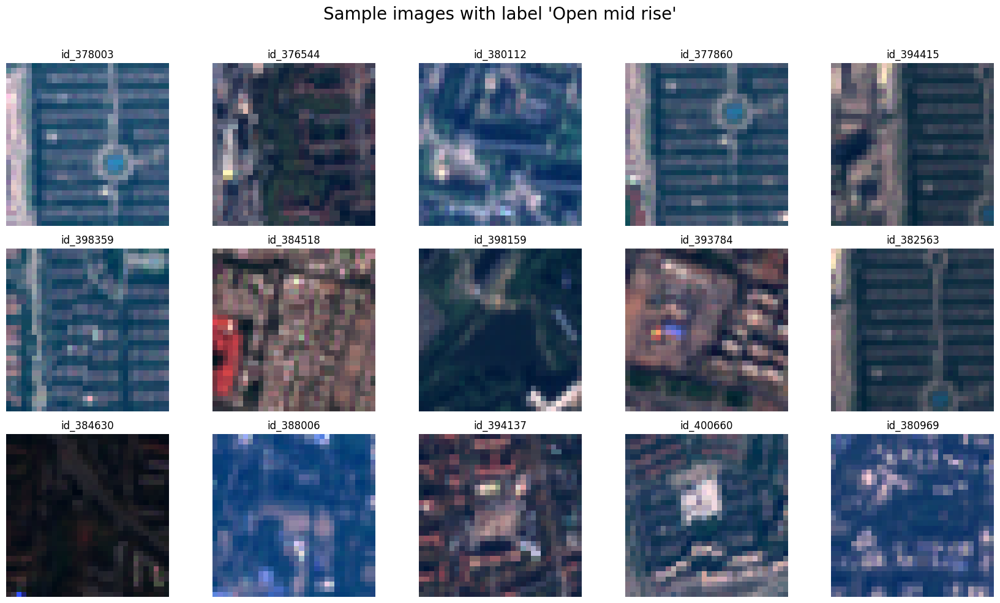

In [ ]:
# Plot sample images from a specific class
plot_images_of_one_label(test_df_so2sat, 'Open mid rise')

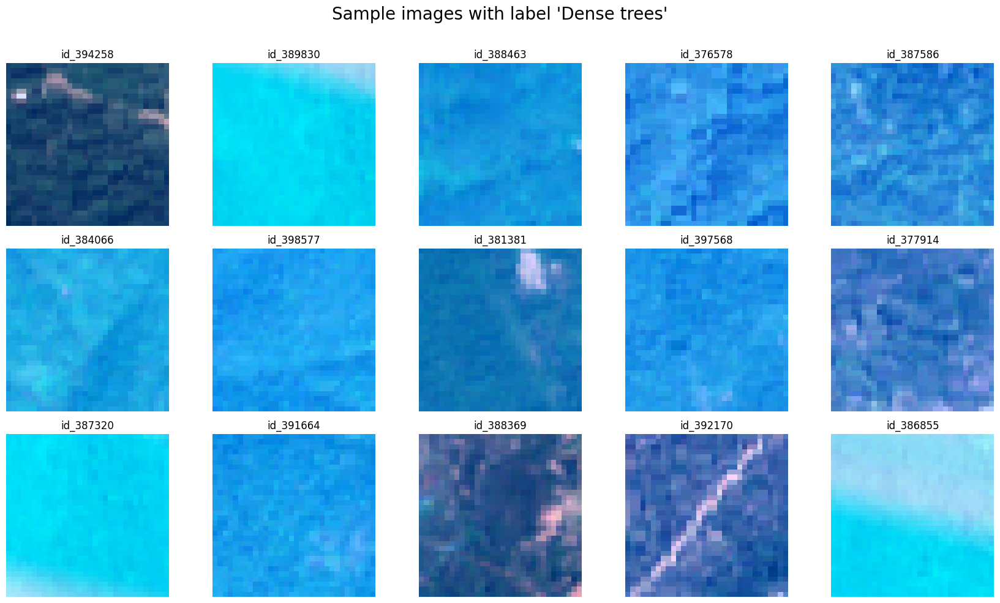

In [ ]:
# Plot sample images from a specific class
plot_images_of_one_label(test_df_so2sat, 'Dense trees')

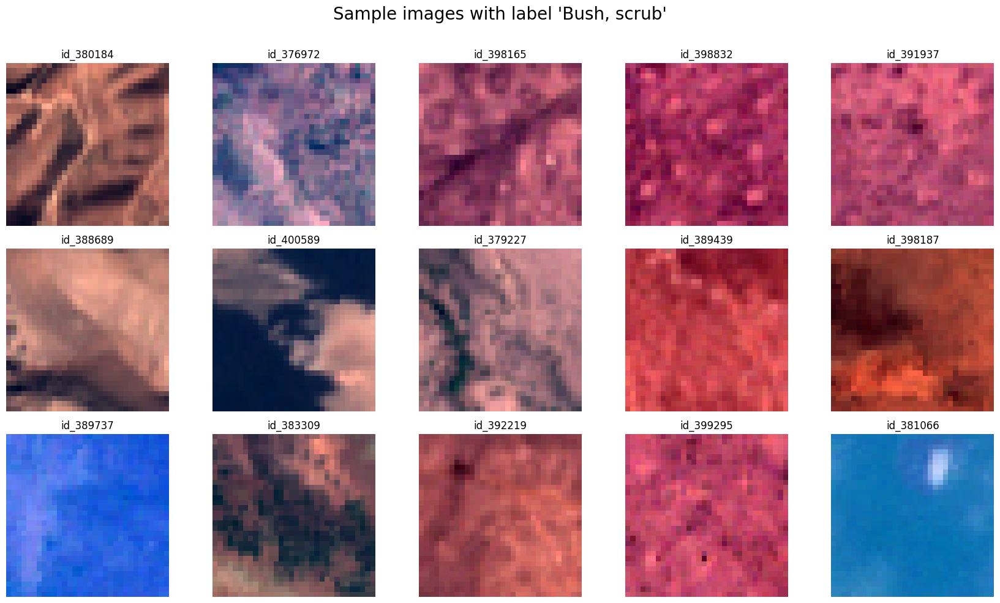

In [ ]:
# Plot sample images from a specific class
plot_images_of_one_label(test_df_so2sat, 'Bush, scrub')

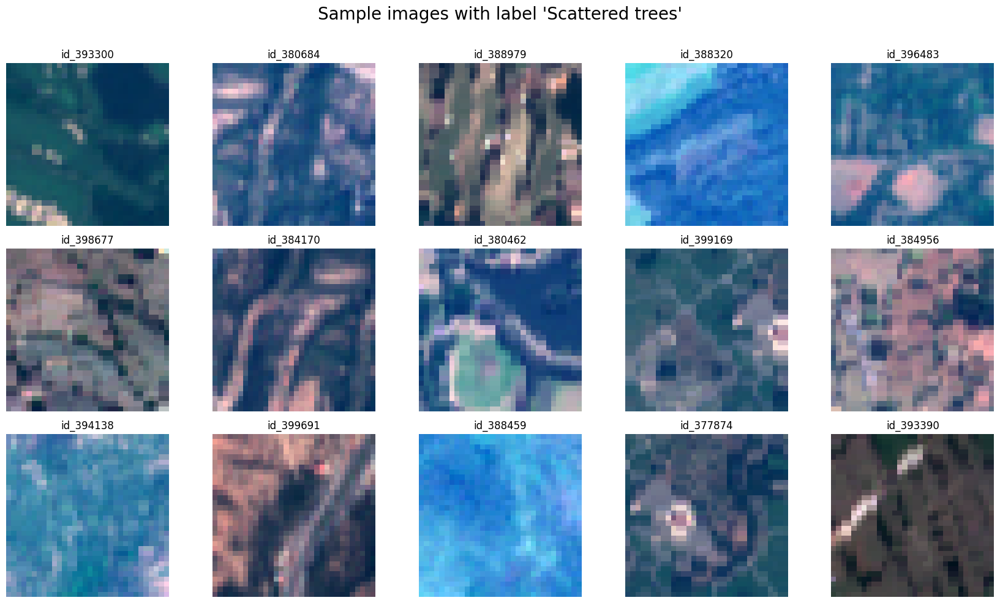

In [ ]:
# Plot sample images from a specific class
plot_images_of_one_label(test_df_so2sat, 'Scattered trees')

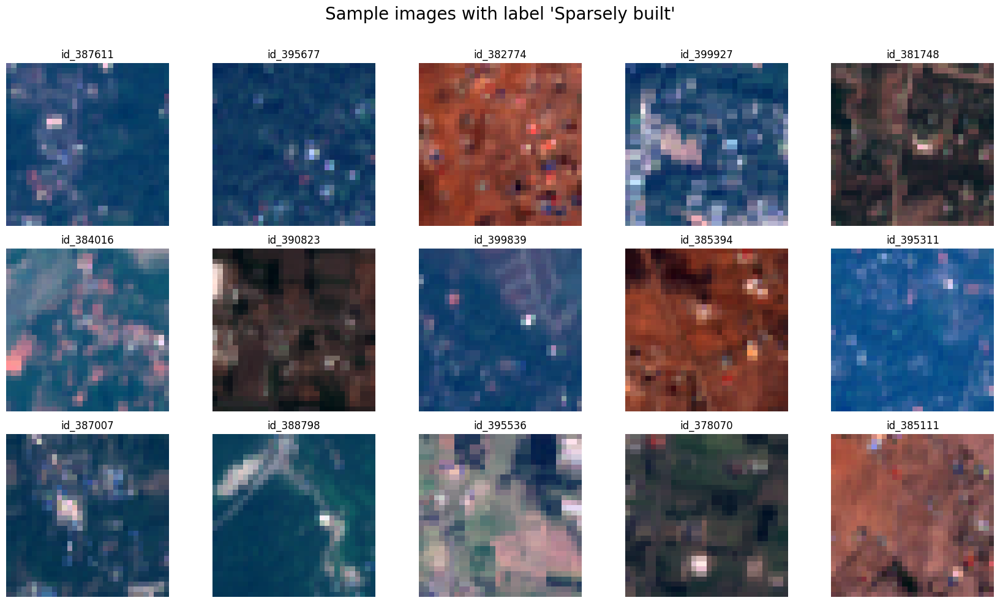

In [ ]:
# Plot sample images from a specific class
plot_images_of_one_label(test_df_so2sat, 'Sparsely built')

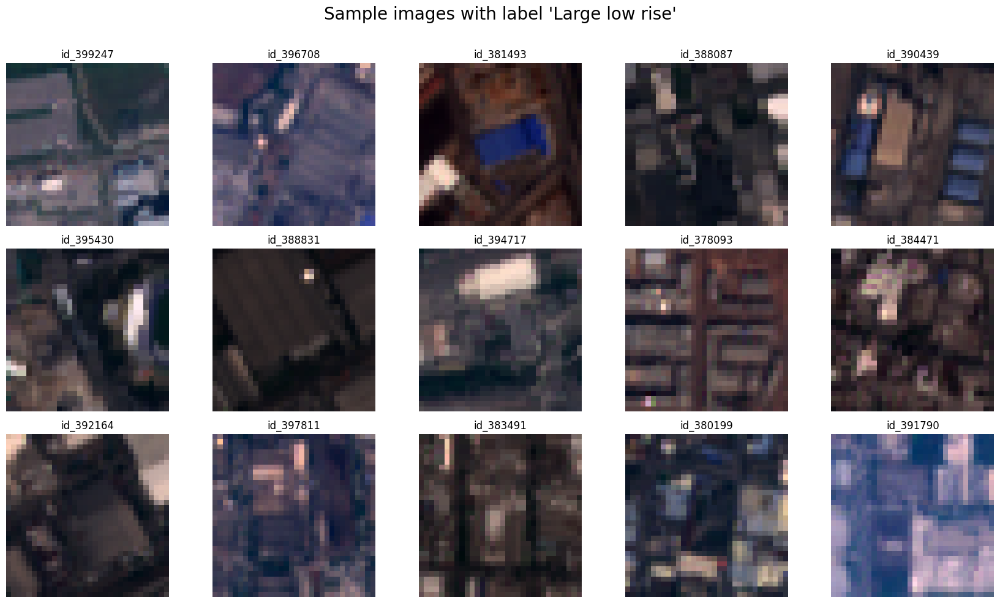

In [ ]:
# Plot sample images from a specific class
plot_images_of_one_label(test_df_so2sat, 'Large low rise')

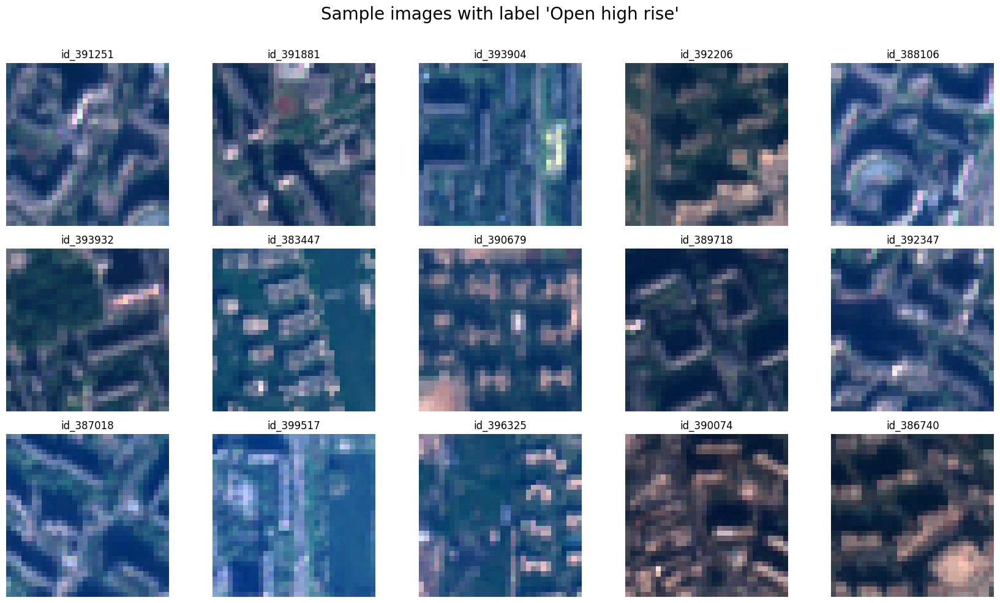

In [ ]:
# Plot sample images from a specific class
plot_images_of_one_label(test_df_so2sat, 'Open high rise')

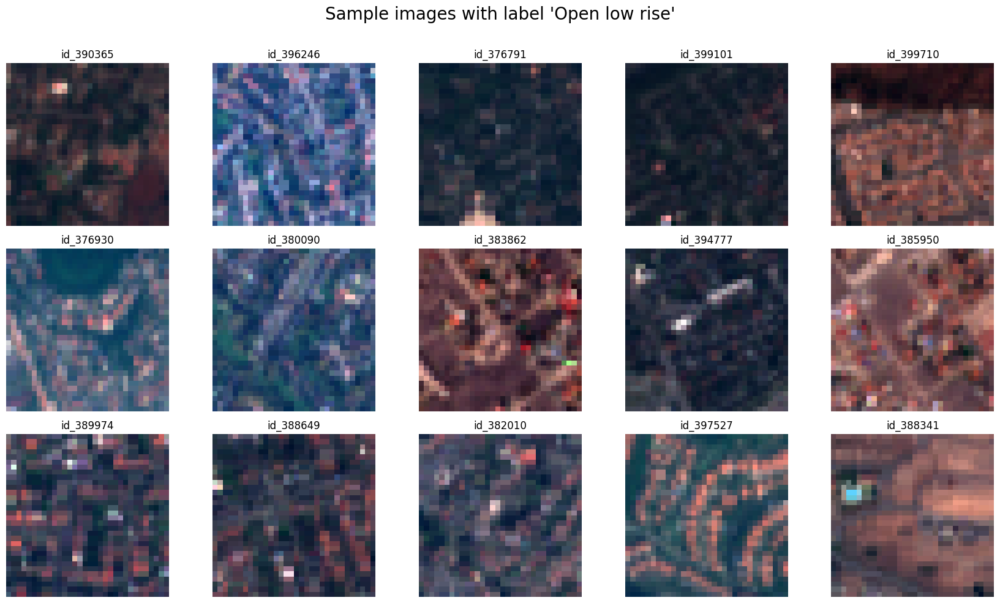

In [ ]:
# Plot sample images from a specific class
plot_images_of_one_label(test_df_so2sat, 'Open low rise')

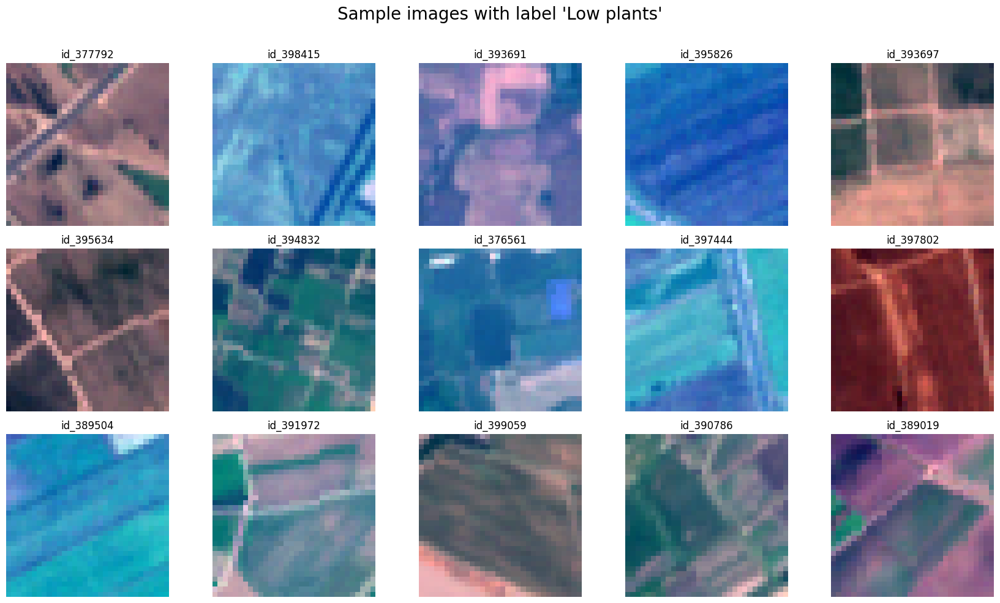

In [ ]:
# Plot sample images from a specific class
plot_images_of_one_label(test_df_so2sat, 'Low plants')

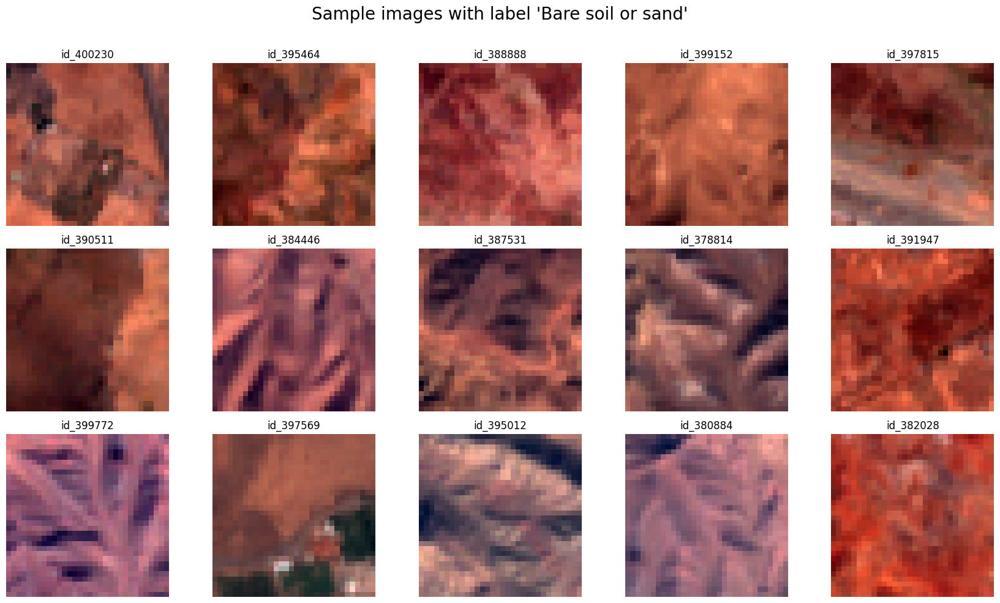

In [ ]:
# Plot sample images from a specific class
plot_images_of_one_label(test_df_so2sat, 'Bare soil or sand')

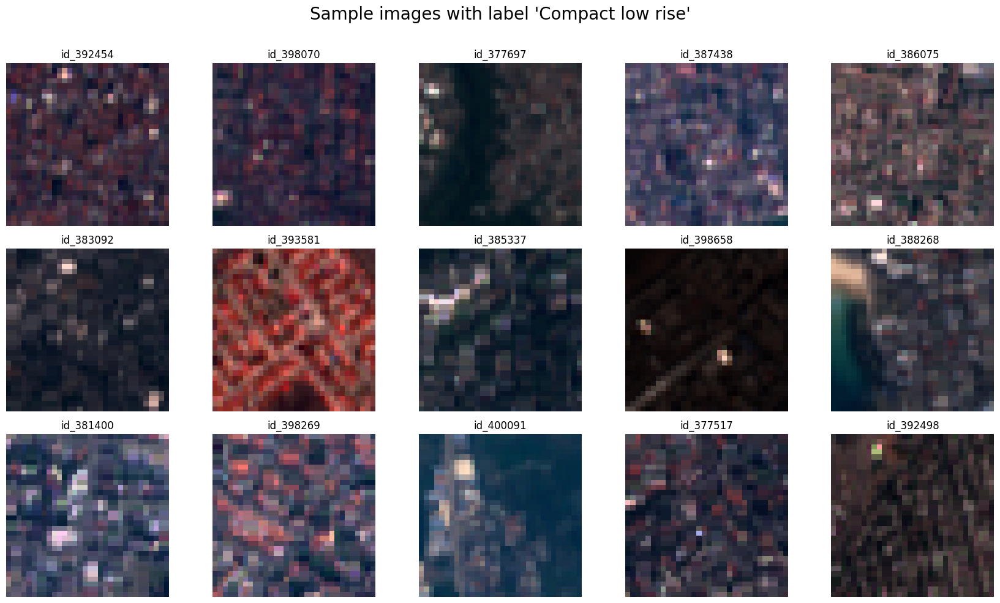

In [ ]:
# Plot sample images from a specific class
plot_images_of_one_label(test_df_so2sat, 'Compact low rise')

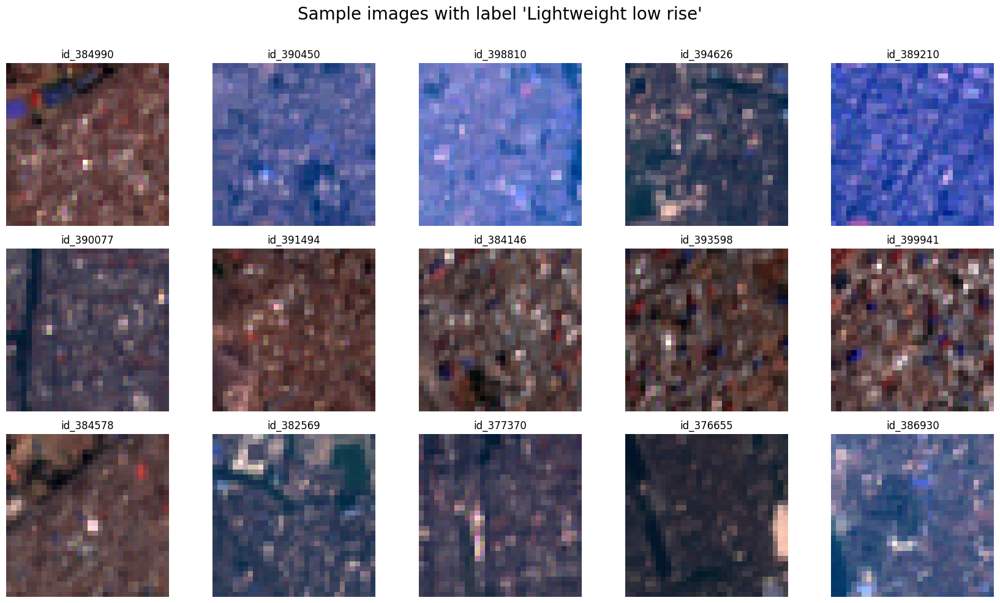

In [ ]:
# Plot sample images from a specific class
plot_images_of_one_label(test_df_so2sat, 'Lightweight low rise')

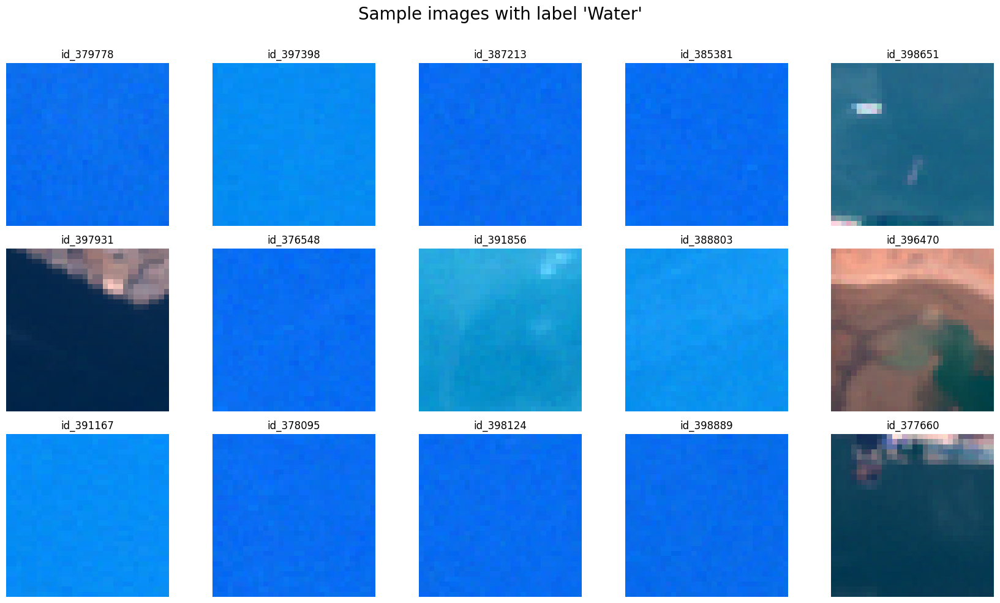

In [ ]:
# Plot sample images from a specific class
plot_images_of_one_label(test_df_so2sat, 'Water')

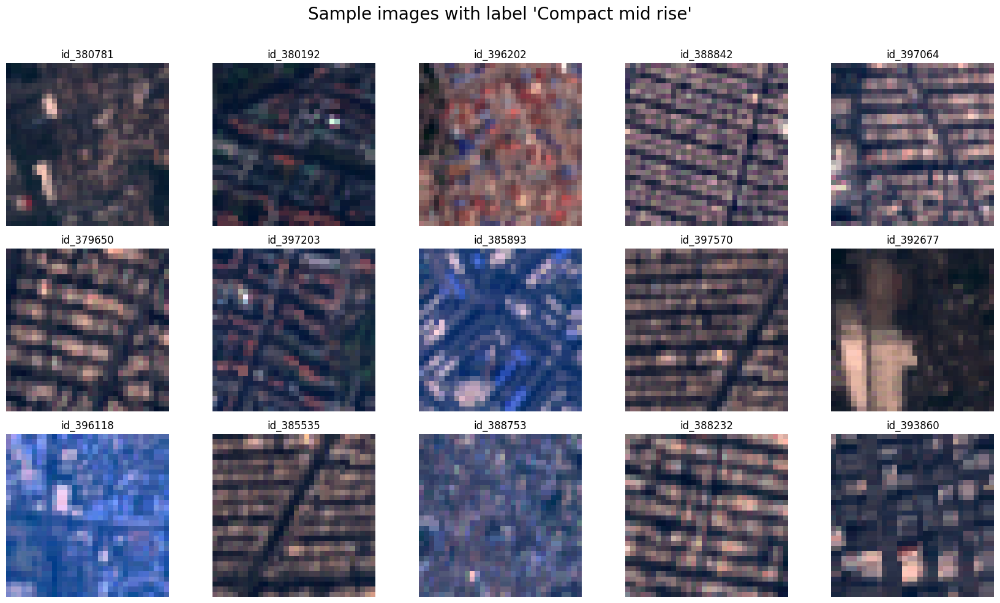

In [ ]:
# Plot sample images from a specific class
plot_images_of_one_label(test_df_so2sat, 'Compact mid rise')

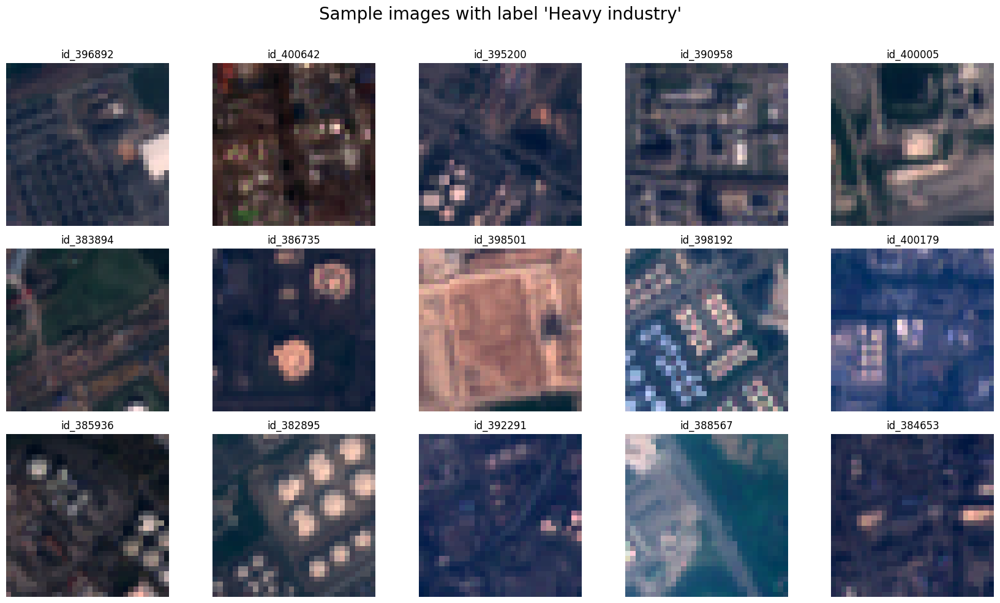

In [ ]:
# Plot sample images from a specific class
plot_images_of_one_label(test_df_so2sat, 'Heavy industry')

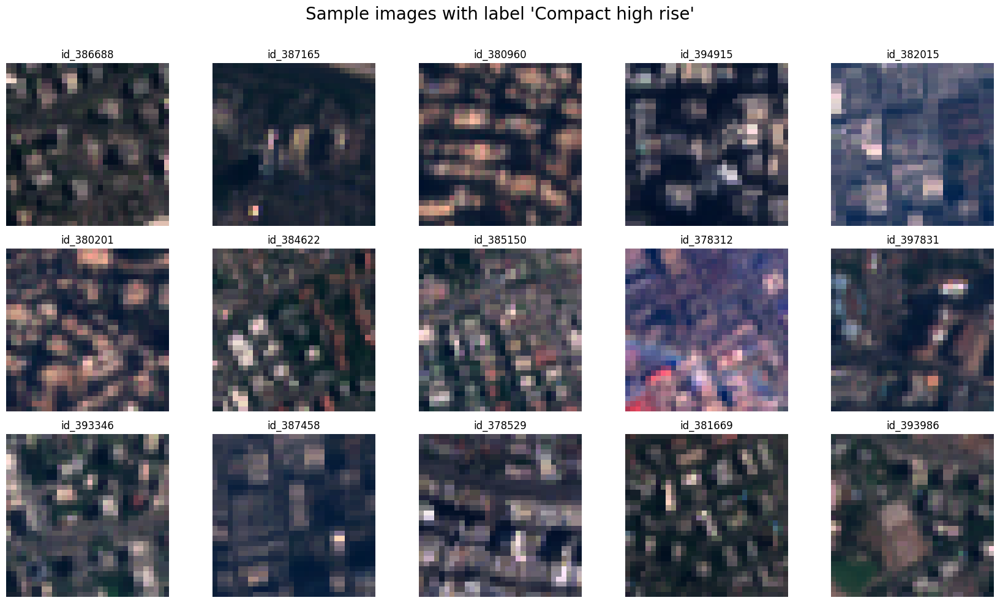

In [ ]:
# Plot sample images from a specific class
plot_images_of_one_label(test_df_so2sat, 'Compact high rise')

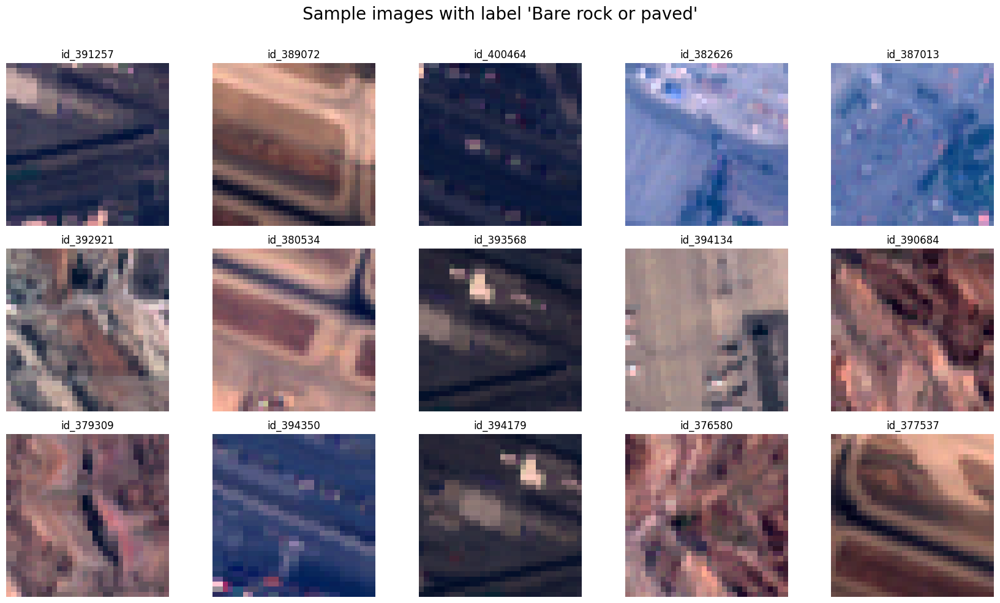

In [ ]:
# Plot sample images from a specific class
plot_images_of_one_label(test_df_so2sat, 'Bare rock or paved')

### 6) m-bigearthnet

In [ ]:
# Set images path and select sample image
images_folder = 'm-bigearthnet'
images_path = os.path.join(data_path, images_folder)
image_id = os.listdir(images_path)[0] # .hdf5 file
filename = os.path.join(images_path, image_id) # path to .hdf5 file
print(image_id)

# Check the content of a .hdf5 file
f = h5py.File(filename, 'r')
print(type(f))
print(len(f.keys()), 'bands available')
list(f.keys())

id_46052.hdf5
<class 'h5py._hl.files.File'>
12 bands available


['01 - Coastal aerosol',
 '02 - Blue',
 '03 - Green',
 '04 - Red',
 '05 - Vegetation Red Edge',
 '06 - Vegetation Red Edge',
 '07 - Vegetation Red Edge',
 '08 - NIR',
 '08A - Vegetation Red Edge',
 '09 - Water vapour',
 '11 - SWIR',
 '12 - SWIR']

In [ ]:
# A h5py dataset is very similar to NumPy arrays, but allows for optimized storage
print(f['09 - Water vapour'])
# A h5py dataset has the following attributes
print('shape:', f['09 - Water vapour'].shape)
print('size:', f['09 - Water vapour'].size)
print('ndim:', f['09 - Water vapour'].ndim)
print('dtype:', f['09 - Water vapour'].dtype)
print('nbytes:', f['09 - Water vapour'].nbytes)
f['09 - Water vapour'][0]

<HDF5 dataset "09 - Water vapour": shape (120, 120), type "<f4">
shape: (120, 120)
size: 14400
ndim: 2
dtype: float32
nbytes: 57600


array([2462., 2462., 2462., 2448., 2420., 2392., 2364., 2336., 2308.,
       2329., 2399., 2469., 2540., 2610., 2680., 2731., 2763., 2795.,
       2828., 2860., 2892., 2917., 2935., 2953., 2972., 2990., 3008.,
       2994., 2947., 2900., 2853., 2806., 2759., 2752., 2785., 2818.,
       2851., 2884., 2917., 2892., 2808., 2724., 2639., 2555., 2471.,
       2378., 2276., 2174., 2072., 1970., 1868., 1793., 1746., 1699.,
       1652., 1605., 1558., 1546., 1571., 1596., 1621., 1646., 1671.,
       1691., 1707., 1723., 1739., 1755., 1771., 1775., 1766., 1758.,
       1749., 1741., 1732., 1746., 1783., 1819., 1856., 1892., 1929.,
       2021., 2170., 2319., 2467., 2616., 2765., 2861., 2905., 2949.,
       2994., 3038., 3082., 3049., 2939., 2829., 2718., 2608., 2498.,
       2471., 2528., 2585., 2641., 2698., 2755., 2779., 2771., 2763.,
       2754., 2746., 2738., 2684., 2583., 2482., 2381., 2280., 2179.,
       2129., 2129., 2129.], dtype=float32)

- Loading splits and labels information

In [ ]:
# Read default partition
with open(os.path.join(data_path, images_folder, 'default_partition.json'), 'r') as file:
    def_partition = json.load(file)
    print("Splits:")
    print(list(def_partition.keys()))
    print(len(def_partition['train']), len(def_partition['valid']), len(def_partition['test']))

# Read labels
with open(os.path.join(images_path, 'task_specs.pkl'), 'rb') as f:
    task_data = pickle.load(f)
    print("\nLabels:\n")
    bigearthnet_labels = task_data.label_type.class_name #43 labels
    print('-', task_data.label_type.n_classes, "labels -")
    for l in bigearthnet_labels:
        print(l)

# Read label map
with open(os.path.join(images_path, 'label_stats.json'), 'r') as file:
    label_map = json.load(file)
    # labels == {'id_87161': [0, 0, 1, ..., 0], 'id_87164': [1, 0, 0, ..., 1]}

Splits:
['train', 'valid', 'test']
20000 1000 1000

Labels:

- 43 labels -
Agro-forestry areas
Airports
Annual crops associated with permanent crops
Bare rock
Beaches, dunes, sands
Broad-leaved forest
Burnt areas
Coastal lagoons
Complex cultivation patterns
Coniferous forest
Construction sites
Continuous urban fabric
Discontinuous urban fabric
Dump sites
Estuaries
Fruit trees and berry plantations
Green urban areas
Industrial or commercial units
Inland marshes
Intertidal flats
Land principally occupied by agriculture, with significant areas of natural vegetation
Mineral extraction sites
Mixed forest
Moors and heathland
Natural grassland
Non-irrigated arable land
Olive groves
Pastures
Peatbogs
Permanently irrigated land
Port areas
Rice fields
Road and rail networks and associated land
Salines
Salt marshes
Sclerophyllous vegetation
Sea and ocean
Sparsely vegetated areas
Sport and leisure facilities
Transitional woodland/shrub
Vineyards
Water bodies
Water courses


- Build the TEST dataframe collecting all the information we need for inference

In [ ]:
# Build dataFrame for TEST images
data = []
split = 'test'
for img_id in def_partition[split]:
    vector = label_map.get(img_id, None)  # None in case any image is missing in label_map
    labels_idx = [i for i, x in enumerate(label_map[img_id]) if x == 1]
    labels = [bigearthnet_labels[i] for i in labels_idx]
    data.append({
        'image_id': img_id,
        'filename': os.path.join(images_path, img_id + '.hdf5'),
        'bands': len(h5py.File(filename, 'r').keys()),
        'split': split,
        'labels': labels,
        'ground_truth_binary_vector': vector
    })

test_df_bigearthnet = pd.DataFrame(data)
test_df_bigearthnet.head()

,image_id,filename,bands,split,labels,ground_truth_binary_vector
0,id_427032,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,12,test,"[Complex cultivation patterns, Discontinuous u...","[0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, ..."
1,id_493029,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,12,test,"[Coniferous forest, Permanently irrigated land...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, ..."
2,id_513633,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,12,test,"[Burnt areas, Complex cultivation patterns, La...","[0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, ..."
3,id_441746,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,12,test,"[Airports, Broad-leaved forest, Discontinuous ...","[0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, ..."
4,id_510900,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,12,test,"[Annual crops associated with permanent crops,...","[0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, ..."


In [ ]:
# Save TESt dataframe to file
# test_df_bigearthnet.to_csv('/content/drive/MyDrive/Thesis CLIP4EO/GEO-Bench classification data/test_df_m-bigearthnet.csv',
#                        mode = 'w', index = False, header = True)

In [ ]:
# Load TESt dataframe from file
test_df_bigearthnet = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/GEO-Bench classification data/test_df_m-bigearthnet.csv')
test_df_bigearthnet.head()

,image_id,filename,bands,split,labels,ground_truth_binary_vector
0,id_427032,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,12,test,"['Complex cultivation patterns', 'Discontinuou...","[0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, ..."
1,id_493029,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,12,test,"['Coniferous forest', 'Permanently irrigated l...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, ..."
2,id_513633,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,12,test,"['Burnt areas', 'Complex cultivation patterns'...","[0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, ..."
3,id_441746,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,12,test,"['Airports', 'Broad-leaved forest', 'Discontin...","[0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, ..."
4,id_510900,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,12,test,['Annual crops associated with permanent crops...,"[0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, ..."


In [ ]:
test_df_bigearthnet.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 6 columns):
 #   Column                      Non-Null Count  Dtype 
---  ------                      --------------  ----- 
 0   image_id                    1000 non-null   object
 1   filename                    1000 non-null   object
 2   bands                       1000 non-null   int64 
 3   split                       1000 non-null   object
 4   labels                      1000 non-null   object
 5   ground_truth_binary_vector  1000 non-null   object
dtypes: int64(1), object(5)
memory usage: 47.0+ KB


In [ ]:
test_df_bigearthnet.ground_truth_binary_vector.value_counts()

,ground_truth_binary_vector
"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]",21
"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0]",16
"[0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]",14
"[0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0]",9
"[0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0]",8
...,...
"[0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]",1
"[0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]",1
"[0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0]",1
"[1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0]",1


In [ ]:
test_df_bigearthnet.labels.value_counts()

,labels
['Continuous urban fabric'],21
['Sea and ocean'],16
['Coastal lagoons'],14
"['Bare rock', 'Sea and ocean']",9
"['Coniferous forest', 'Mixed forest', 'Transitional woodland/shrub']",8
...,...
"['Complex cultivation patterns', 'Land principally occupied by agriculture, with significant areas of natural vegetation']",1
"['Complex cultivation patterns', 'Land principally occupied by agriculture, with significant areas of natural vegetation', 'Mixed forest', 'Non-irrigated arable land', 'Pastures']",1
"['Complex cultivation patterns', 'Mineral extraction sites', 'Sclerophyllous vegetation', 'Sparsely vegetated areas', 'Transitional woodland/shrub']",1
"['Agro-forestry areas', 'Dump sites', 'Pastures', 'Transitional woodland/shrub']",1


In [ ]:
# How to recover the actual list of predictions for a sample image
# aux_list = test_df_bigearthnet.iloc[0].labels.strip("[]").split(',')
# labels_list = [label.strip("' ") for label in aux_list]

In [ ]:
# Visualize sample images
plot_random_images(images_path, 123, ["04 - Red", "03 - Green", "02 - Blue"], bigearthnet_labels)

Output hidden; open in https://colab.research.google.com to view.

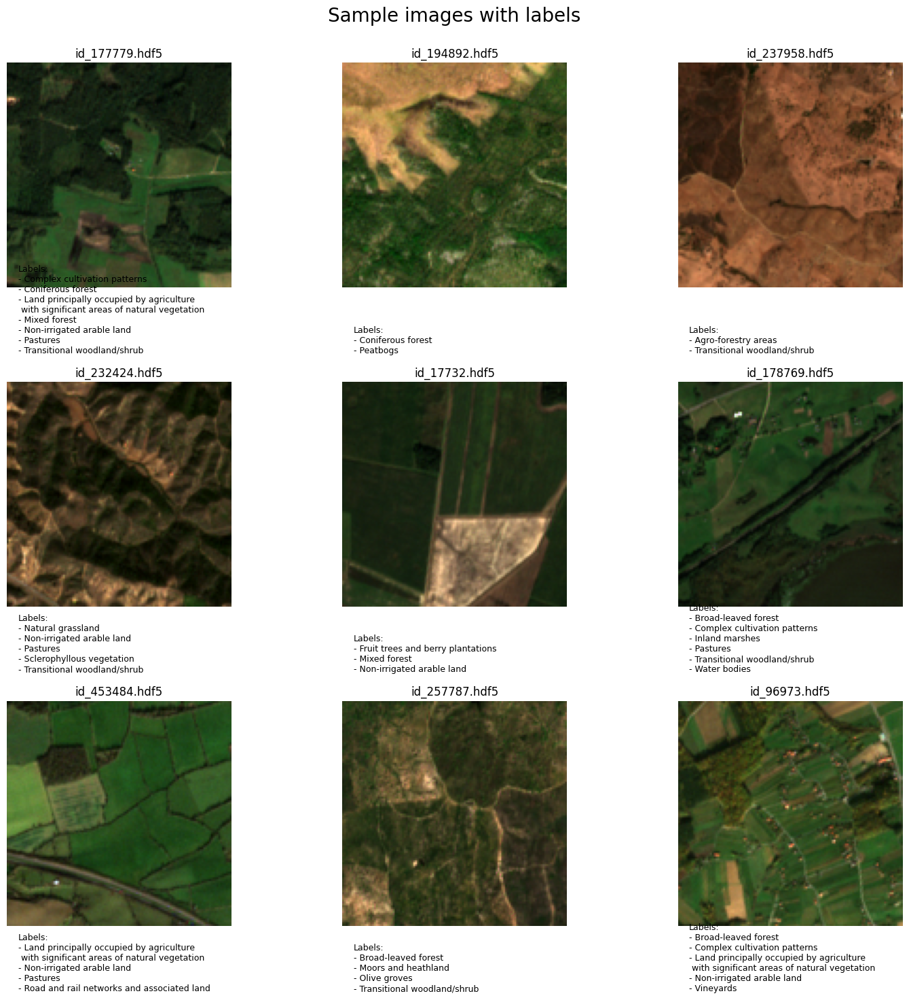

In [ ]:
# Visualize sample images with associated labels
plot_images_multilabel(images_path, 1, label_map, bigearthnet_labels)

## Loading CLIP

In [ ]:
%%capture
#! conda install --yes -c pytorch pytorch=1.7.1 torchvision cpuonly #cudatoolkit=11.0
! pip install ftfy regex tqdm
! pip install git+https://github.com/openai/CLIP.git

In [ ]:
import random
import clip
import torch
from PIL import Image
import matplotlib.pyplot as plt

# Load the CLIP model
device = "cuda" if torch.cuda.is_available() else "cpu"
print("device =", device)
CLIP_model, CLIP_preprocess = clip.load("ViT-B/32", device=device)

device = cpu


100%|███████████████████████████████████████| 338M/338M [00:04<00:00, 84.4MiB/s]


### 1) m-brick-kiln  

- Example of CLIP prediction of a single image.

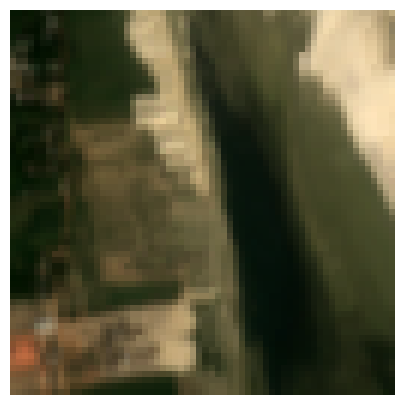


True label:

brick kiln

Top predictions:

brick kiln: 54.54%
not brick kiln: 45.46%


In [ ]:
# Example with single image using only RGB bands

idx = 0
image_id = test_df_brickkiln.iloc[idx].image_id
f = h5py.File(test_df_brickkiln.iloc[idx].filename)


r = f['04 - Red'][:]    # shape (120, 120)
g = f['03 - Green'][:]  # shape (120, 120)
b = f['02 - Blue'][:]   # shape (120, 120)
rgb_image = np.stack([r, g, b], axis = -1) # shape (120, 120, 3)
true_color = normalize(rgb_image)

plt.figure(figsize = (5, 5))
plt.imshow(true_color)
plt.axis('off')
plt.show()


print("\nTrue label:\n")
print(test_df_brickkiln.iloc[idx].label)

image = CLIP_preprocess(Image.fromarray(true_color.astype(np.uint8))).unsqueeze(0).to(device)
text = clip.tokenize(['a satellite image of ' + l for l in brickkiln_labels]).to(device)


with torch.no_grad():
    image_features = CLIP_model.encode_image(image)
    text_features = CLIP_model.encode_text(text)

image_features /= image_features.norm(dim=-1, keepdim=True)
text_features /= text_features.norm(dim=-1, keepdim=True)
similarity = (100.0 * image_features @ text_features.T).softmax(dim=-1)

# Print the result
print("\nTop predictions:\n")
for label, prob in sorted(zip(brickkiln_labels, similarity[0]), key = lambda x: x[1], reverse = True):
    print(f"{label}: {100 * prob:.2f}%")

#### Computing predictions

Now, let's apply CLIP to the dataset and retain its top label prediction as the image class.

In [ ]:
add_top_predictions_with_batches_standard(
    test_df_brickkiln,
    CLIP_model,
    CLIP_preprocess,
    device,
    brickkiln_labels, # original labels
    ['04 - Red', '03 - Green', '02 - Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-brick-kiln_predictions_CLIP_RGB.csv')

100%|██████████| 4/4 [16:20<00:00, 245.13s/it]


In [ ]:
output_df_clip = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/output/m-brick-kiln_predictions_CLIP_RGB.csv')
output_df_clip.head()

,image_id,filename,bands,split,label,not_brick_kiln_dotprod,brick_kiln_dotprod,not_brick_kiln_softmax,brick_kiln_softmax,not_brick_kiln_sigmoid,brick_kiln_sigmoid,pred
0,examples_36_950,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.301796,0.302230,0.489163,0.510837,0.574882,0.574987,brick kiln
1,examples_79_331,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,not brick kiln,0.303719,0.297164,0.658236,0.341764,0.575351,0.573749,not brick kiln
2,examples_29_266,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.332777,0.330677,0.552309,0.447691,0.582435,0.581924,not brick kiln
3,examples_20_682,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,not brick kiln,0.321119,0.317757,0.583268,0.416732,0.579597,0.578778,not brick kiln
4,examples_63_819,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.330641,0.329654,0.524662,0.475338,0.581915,0.581675,not brick kiln


In [ ]:
output_df_clip.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 999 entries, 0 to 998
Data columns (total 12 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   image_id                999 non-null    object 
 1   filename                999 non-null    object 
 2   bands                   999 non-null    int64  
 3   split                   999 non-null    object 
 4   label                   999 non-null    object 
 5   not_brick_kiln_dotprod  999 non-null    float64
 6   brick_kiln_dotprod      999 non-null    float64
 7   not_brick_kiln_softmax  999 non-null    float64
 8   brick_kiln_softmax      999 non-null    float64
 9   not_brick_kiln_sigmoid  999 non-null    float64
 10  brick_kiln_sigmoid      999 non-null    float64
 11  pred                    999 non-null    object 
dtypes: float64(6), int64(1), object(5)
memory usage: 93.8+ KB


In [ ]:
output_df_clip.pred.value_counts()

,pred
not brick kiln,936
brick kiln,63


In [ ]:
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
import plotly.express as px

labels = output_df_clip['label'].unique()
y_true = output_df_clip["label"]
y_pred = output_df_clip["pred"]

classification_report_and_cm(y_true, y_pred, labels)


Classification Report:

                precision    recall  f1-score   support

    brick kiln     0.8095    0.1518    0.2556       336
not brick kiln     0.6955    0.9819    0.8143       663

      accuracy                         0.7027       999
     macro avg     0.7525    0.5668    0.5349       999
  weighted avg     0.7339    0.7027    0.6264       999


Accuracy: 0.7027

Confusion matrix:

[[ 51 285]
 [ 12 651]]



In [ ]:
pd.crosstab(y_true, y_pred, rownames = ["Truth"], colnames = ["Prediction"])

Prediction,brick kiln,not brick kiln
Truth,,
brick kiln,51,285
not brick kiln,12,651


In [ ]:
import plotly.express as px
import pandas as pd

# select the softmax columns
softmax_cols = [col for col in output_df_clip.columns if col.endswith("_softmax")]
# create dataframe with selected columns in long format
softmax_melted = output_df_clip[softmax_cols].melt(var_name="label", value_name="softmax_score")
# remove '_softmax' from label to plot
softmax_melted["label"] = softmax_melted["label"].str.replace("_softmax", "").str.replace("_", " ")

# plot histogram
fig = px.histogram(
    softmax_melted,
    x="softmax_score",
    color="label",
    nbins=50,
    barmode="overlay",
    opacity=0.6,
    title="Distribution of Softmax Scores by Label"
)
fig.update_layout(xaxis_title="Softmax Score", yaxis_title="Count")
fig.show()

In [ ]:
# Histogram of the distribution of softmax scores of single label
import plotly.express as px

fig = px.histogram(output_df_clip, x="brick_kiln_softmax", nbins=50, title="Histogram of Brick Kiln Softmax Scores")
fig.update_layout(xaxis_title="Softmax Score", yaxis_title="Count")
fig.show()

In [ ]:
# Boxplots of labels distribution
fig = px.box(
    softmax_melted,
    x="label",
    y="softmax_score",
    title="Boxplot of Softmax Scores by Label"
)
fig.update_layout(xaxis_title = "Label", yaxis_title = "Softmax value")
fig.show()

In [ ]:
# ROC curve and AUC
# Binary: convert true_label to 0/1
output_df_clip["true_binary"] = output_df_clip["label"].map({"not brick kiln": 0, "brick kiln": 1})
y_true = output_df_clip["true_binary"]
y_scores = output_df_clip["brick_kiln_softmax"]

plot_auc(y_true, y_scores)

#### Computing predictions with alt labels 1 - "other landscape"

Trying to refine the textual prompts for CLIP to better match what the image features represent semantically. Two approaches are tested:
1. Binary captions, but instead of having a positive class and its negation we keep the positive class together with an "other" class.

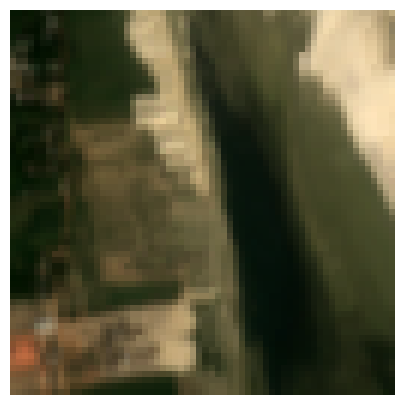


Image: examples_36_950 


True label:

brick kiln

Top predictions:

a brick kiln construction: 26.95%
an agricultural area: 26.21%
rural landscape: 20.93%
barren terrain: 14.10%
a green forested area: 11.82%


In [ ]:
# TESTING DIFFERENT SETS OF LABELS
idx = 0
image_id = test_df_brickkiln.iloc[idx].image_id
f = h5py.File(test_df_brickkiln.iloc[idx].filename)


r = f['04 - Red'][:]    # shape (120, 120)
g = f['03 - Green'][:]  # shape (120, 120)
b = f['02 - Blue'][:]   # shape (120, 120)
rgb_image = np.stack([r, g, b], axis = -1) # shape (120, 120, 3)
true_color = normalize(rgb_image)

plt.figure(figsize = (5, 5))
plt.imshow(true_color)
plt.axis('off')
plt.show()

print("\nImage:", image_id, '\n')
print("\nTrue label:\n")
print(test_df_brickkiln.iloc[idx].label)

test_labels = ['barren terrain',
               'a green forested area',
               'rural landscape', # remove this one
               'an agricultural area',
               'a brick kiln construction']


image = CLIP_preprocess(Image.fromarray(true_color.astype(np.uint8))).unsqueeze(0).to(device)
text = clip.tokenize(['a satellite image of ' + l for l in test_labels]).to(device)


with torch.no_grad():
    image_features = CLIP_model.encode_image(image)
    text_features = CLIP_model.encode_text(text)

image_features /= image_features.norm(dim=-1, keepdim=True)
text_features /= text_features.norm(dim=-1, keepdim=True)
similarity = (100.0 * image_features @ text_features.T).softmax(dim=-1)

# Print the result
print("\nTop predictions:\n")
for label, prob in sorted(zip(test_labels, similarity[0]), key = lambda x: x[1], reverse = True):
    print(f"{label}: {100 * prob:.2f}%")

> **Note:** this takes about ~15mins to run on CPU

In [ ]:
# 1st set of alternative labels

custom_labels = ['other landscape',               # negative class
                 'a brick kiln construction']     # positive class

add_top_predictions_with_batches_standard(
    test_df_brickkiln,
    CLIP_model,
    CLIP_preprocess,
    device,
    custom_labels,
    ['04 - Red', '03 - Green', '02 - Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-brick-kiln_predictions_CLIP_RGB_alt1.csv')

100%|██████████| 4/4 [10:37<00:00, 159.45s/it]


In [ ]:
output_df_clip1 = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/output/m-brick-kiln_predictions_CLIP_RGB_alt1.csv')
output_df_clip1.head()

,image_id,filename,bands,split,label,other_landscape_dotprod,a_brick_kiln_construction_dotprod,other_landscape_softmax,a_brick_kiln_construction_softmax,other_landscape_sigmoid,a_brick_kiln_construction_sigmoid,pred
0,examples_36_950,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.289568,0.297767,0.305785,0.694215,0.571890,0.573896,a brick kiln construction
1,examples_79_331,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,not brick kiln,0.307981,0.291606,0.837198,0.162802,0.576392,0.572389,other landscape
2,examples_29_266,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.307694,0.325210,0.147844,0.852156,0.576322,0.580593,a brick kiln construction
3,examples_20_682,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,not brick kiln,0.307450,0.312755,0.370401,0.629599,0.576263,0.577558,a brick kiln construction
4,examples_63_819,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.313227,0.329620,0.162553,0.837447,0.577673,0.581667,a brick kiln construction


In [ ]:
output_df_clip1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 999 entries, 0 to 998
Data columns (total 12 columns):
 #   Column                             Non-Null Count  Dtype  
---  ------                             --------------  -----  
 0   image_id                           999 non-null    object 
 1   filename                           999 non-null    object 
 2   bands                              999 non-null    int64  
 3   split                              999 non-null    object 
 4   label                              999 non-null    object 
 5   other_landscape_dotprod            999 non-null    float64
 6   a_brick_kiln_construction_dotprod  999 non-null    float64
 7   other_landscape_softmax            999 non-null    float64
 8   a_brick_kiln_construction_softmax  999 non-null    float64
 9   other_landscape_sigmoid            999 non-null    float64
 10  a_brick_kiln_construction_sigmoid  999 non-null    float64
 11  pred                               999 non-null    object 

In [ ]:
output_df_clip1.pred.value_counts()

,pred
other landscape,513
a brick kiln construction,486


In [ ]:
# Classification report and confusion matrix
labels = output_df_clip1['label'].unique()
y_true = output_df_clip1["label"]
y_pred = output_df_clip1["pred"].map({"other landscape": "not brick kiln",
                                      "a brick kiln construction": "brick kiln"})

classification_report_and_cm(y_true, y_pred, labels)


Classification Report:

                precision    recall  f1-score   support

    brick kiln     0.6049    0.8750    0.7153       336
not brick kiln     0.9181    0.7104    0.8010       663

      accuracy                         0.7658       999
     macro avg     0.7615    0.7927    0.7582       999
  weighted avg     0.8128    0.7658    0.7722       999


Accuracy: 0.7658

Confusion matrix:

[[294  42]
 [192 471]]



In [ ]:
# ROC curve and AUC
# Binary: convert true_label to 0/1
output_df_clip1["true_binary"] = output_df_clip1["label"].map({"not brick kiln": 0, "brick kiln": 1})
y_true = output_df_clip1["true_binary"]
y_scores = output_df_clip1["a_brick_kiln_construction_softmax"]

plot_auc(y_true, y_scores)

#### Computing predictions with alt labels 2 - "some landscape"


In [ ]:
# 2nd set of alternative labels

custom_labels = ['some landscape',                # negative class
                 'a brick kiln construction']     # positive class

add_top_predictions_with_batches_standard(
    test_df_brickkiln,
    CLIP_model,
    CLIP_preprocess,
    device,
    custom_labels,
    ['04 - Red', '03 - Green', '02 - Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-brick-kiln_predictions_CLIP_RGB_alt2.csv')

100%|██████████| 4/4 [08:58<00:00, 134.65s/it]


In [ ]:
output_df_clip11 = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/output/m-brick-kiln_predictions_CLIP_RGB_alt2.csv')
output_df_clip11.head()

,image_id,filename,bands,split,label,some_landscape_dotprod,a_brick_kiln_construction_dotprod,some_landscape_softmax,a_brick_kiln_construction_softmax,some_landscape_sigmoid,a_brick_kiln_construction_sigmoid,pred
0,examples_36_950,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.290095,0.297767,0.317095,0.682905,0.572019,0.573896,a brick kiln construction
1,examples_79_331,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,not brick kiln,0.313054,0.291606,0.895184,0.104816,0.577630,0.572389,some landscape
2,examples_29_266,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.309867,0.325210,0.177363,0.822637,0.576853,0.580593,a brick kiln construction
3,examples_20_682,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,not brick kiln,0.309121,0.312755,0.410138,0.589862,0.576671,0.577558,a brick kiln construction
4,examples_63_819,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.316660,0.329620,0.214834,0.785166,0.578510,0.581667,a brick kiln construction


In [ ]:
output_df_clip11.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 999 entries, 0 to 998
Data columns (total 12 columns):
 #   Column                             Non-Null Count  Dtype  
---  ------                             --------------  -----  
 0   image_id                           999 non-null    object 
 1   filename                           999 non-null    object 
 2   bands                              999 non-null    int64  
 3   split                              999 non-null    object 
 4   label                              999 non-null    object 
 5   some_landscape_dotprod             999 non-null    float64
 6   a_brick_kiln_construction_dotprod  999 non-null    float64
 7   some_landscape_softmax             999 non-null    float64
 8   a_brick_kiln_construction_softmax  999 non-null    float64
 9   some_landscape_sigmoid             999 non-null    float64
 10  a_brick_kiln_construction_sigmoid  999 non-null    float64
 11  pred                               999 non-null    object 

In [ ]:
output_df_clip11.pred.value_counts()

,pred
some landscape,563
a brick kiln construction,436


In [ ]:
# Classification report and confusion matrix
labels = output_df_clip11['label'].unique()
y_true = output_df_clip11["label"]
y_pred = output_df_clip11["pred"].map({"some landscape": "not brick kiln",
                                      "a brick kiln construction": "brick kiln"})

classification_report_and_cm(y_true, y_pred, labels)


Classification Report:

                precision    recall  f1-score   support

    brick kiln     0.6606    0.8571    0.7461       336
not brick kiln     0.9147    0.7768    0.8401       663

      accuracy                         0.8038       999
     macro avg     0.7876    0.8170    0.7931       999
  weighted avg     0.8292    0.8038    0.8085       999


Accuracy: 0.8038

Confusion matrix:

[[288  48]
 [148 515]]



In [ ]:
# ROC curve and AUC
# Binary: convert true_label to 0/1
output_df_clip11["true_binary"] = output_df_clip11["label"].map({"not brick kiln": 0, "brick kiln": 1})
y_true = output_df_clip11["true_binary"]
y_scores = output_df_clip11["a_brick_kiln_construction_softmax"]

plot_auc(y_true, y_scores)

#### Computing predictions with alt labels 3 - "some other landscape"


In [ ]:
# 3rd set of alternative labels

custom_labels = ['some other landscape',          # negative class
                 'a brick kiln construction']     # positive class

add_top_predictions_with_batches_standard(
    test_df_brickkiln,
    CLIP_model,
    CLIP_preprocess,
    device,
    custom_labels,
    ['04 - Red', '03 - Green', '02 - Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-brick-kiln_predictions_CLIP_RGB_al3.csv')

100%|██████████| 4/4 [04:12<00:00, 63.06s/it]


In [ ]:
output_df_clip12 = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/output/m-brick-kiln_predictions_CLIP_RGB_alt3.csv')
output_df_clip12.head()

,image_id,filename,bands,split,label,some_other_landscape_dotprod,a_brick_kiln_construction_dotprod,some_other_landscape_softmax,a_brick_kiln_construction_softmax,some_other_landscape_sigmoid,a_brick_kiln_construction_sigmoid,pred
0,examples_36_950,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.292982,0.297767,0.382617,0.617383,0.572726,0.573896,a brick kiln construction
1,examples_79_331,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,not brick kiln,0.309128,0.291606,0.852232,0.147768,0.576672,0.572389,some other landscape
2,examples_29_266,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.310715,0.325210,0.190077,0.809923,0.577060,0.580593,a brick kiln construction
3,examples_20_682,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,not brick kiln,0.310951,0.312755,0.455022,0.544978,0.577117,0.577558,a brick kiln construction
4,examples_63_819,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.316913,0.329620,0.219129,0.780871,0.578572,0.581667,a brick kiln construction


In [ ]:
output_df_clip12.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 999 entries, 0 to 998
Data columns (total 12 columns):
 #   Column                             Non-Null Count  Dtype  
---  ------                             --------------  -----  
 0   image_id                           999 non-null    object 
 1   filename                           999 non-null    object 
 2   bands                              999 non-null    int64  
 3   split                              999 non-null    object 
 4   label                              999 non-null    object 
 5   some_other_landscape_dotprod       999 non-null    float64
 6   a_brick_kiln_construction_dotprod  999 non-null    float64
 7   some_other_landscape_softmax       999 non-null    float64
 8   a_brick_kiln_construction_softmax  999 non-null    float64
 9   some_other_landscape_sigmoid       999 non-null    float64
 10  a_brick_kiln_construction_sigmoid  999 non-null    float64
 11  pred                               999 non-null    object 

In [ ]:
output_df_clip12.pred.value_counts()

,pred
some other landscape,563
a brick kiln construction,436


In [ ]:
# Classification report and confusion matrix
labels = output_df_clip12['label'].unique()
y_true = output_df_clip12["label"]
y_pred = output_df_clip12["pred"].map({"some other landscape": "not brick kiln",
                                      "a brick kiln construction": "brick kiln"})

classification_report_and_cm(y_true, y_pred, labels)


Classification Report:

                precision    recall  f1-score   support

    brick kiln     0.6537    0.8482    0.7383       336
not brick kiln     0.9094    0.7722    0.8352       663

      accuracy                         0.7978       999
     macro avg     0.7815    0.8102    0.7868       999
  weighted avg     0.8234    0.7978    0.8026       999


Accuracy: 0.7978

Confusion matrix:

[[285  51]
 [151 512]]



In [ ]:
# ROC curve and AUC
# Binary: convert true_label to 0/1
output_df_clip12["true_binary"] = output_df_clip12["label"].map({"not brick kiln": 0, "brick kiln": 1})
y_true = output_df_clip12["true_binary"]
y_scores = output_df_clip12["a_brick_kiln_construction_softmax"]

plot_auc(y_true, y_scores)

#### Computing predictions with multi alt labels

2. Multi-prompt strategy for the negative class: instead of considering just one alternative to the positive class, diversify the descriptions for the negative samples and still consider them as 0

In [ ]:
# Multi-prompts for the negative class

custom_labels = ['barren terrain',                # negative class(es)
                 'a green forested area',
                 'an agricultural area',
                 'a brick kiln construction']     # positive class

add_top_predictions_with_batches_standard(
    test_df_brickkiln,
    CLIP_model,
    CLIP_preprocess,
    device,
    custom_labels,
    ['04 - Red', '03 - Green', '02 - Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-brick-kiln_predictions_CLIP_RGB_alt_multi.csv')

100%|██████████| 4/4 [10:52<00:00, 163.05s/it]


In [ ]:
output_df_clip2 = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/output/m-brick-kiln_predictions_CLIP_RGB_alt_multi.csv')
output_df_clip2

,image_id,filename,bands,split,label,barren_terrain_dotprod,a_green_forested_area_dotprod,an_agricultural_area_dotprod,a_brick_kiln_construction_dotprod,barren_terrain_softmax,a_green_forested_area_softmax,an_agricultural_area_softmax,a_brick_kiln_construction_softmax,barren_terrain_sigmoid,a_green_forested_area_sigmoid,an_agricultural_area_sigmoid,a_brick_kiln_construction_sigmoid,pred
0,examples_36_950,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.270416,0.270024,0.283458,0.297767,0.047489,0.045664,0.174982,0.731866,0.567195,0.567099,0.570394,0.573896,a brick kiln construction
1,examples_79_331,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,not brick kiln,0.321679,0.320664,0.314135,0.291605,0.412694,0.372837,0.194074,0.020396,0.579733,0.579486,0.577894,0.572389,barren terrain
2,examples_29_266,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.298505,0.309606,0.313190,0.325210,0.043814,0.132950,0.190272,0.632964,0.574077,0.576789,0.577664,0.580593,a brick kiln construction
3,examples_20_682,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,not brick kiln,0.292874,0.299410,0.312294,0.312755,0.058150,0.111790,0.405476,0.424584,0.572700,0.574298,0.577445,0.577558,a brick kiln construction
4,examples_63_819,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.301418,0.307499,0.335431,0.329620,0.020153,0.037020,0.604645,0.338183,0.574789,0.576275,0.583080,0.581667,an agricultural area
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
994,examples_11_359,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,not brick kiln,0.320325,0.313778,0.313069,0.302070,0.461930,0.240034,0.223602,0.074434,0.579403,0.577807,0.577634,0.574948,barren terrain
995,examples_55_132,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,not brick kiln,0.315650,0.330618,0.331488,0.316342,0.087628,0.391438,0.427034,0.093900,0.578264,0.581910,0.582121,0.578432,an agricultural area
996,examples_18_777,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,not brick kiln,0.281004,0.300300,0.309031,0.291276,0.036807,0.253464,0.606921,0.102808,0.569793,0.574516,0.576649,0.572308,an agricultural area
997,examples_31_289,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.286798,0.299446,0.314530,0.315673,0.025974,0.092010,0.415823,0.466193,0.571212,0.574307,0.577991,0.578269,a brick kiln construction


In [ ]:
output_df_clip2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 999 entries, 0 to 998
Data columns (total 18 columns):
 #   Column                             Non-Null Count  Dtype  
---  ------                             --------------  -----  
 0   image_id                           999 non-null    object 
 1   filename                           999 non-null    object 
 2   bands                              999 non-null    int64  
 3   split                              999 non-null    object 
 4   label                              999 non-null    object 
 5   barren_terrain_dotprod             999 non-null    float64
 6   a_green_forested_area_dotprod      999 non-null    float64
 7   an_agricultural_area_dotprod       999 non-null    float64
 8   a_brick_kiln_construction_dotprod  999 non-null    float64
 9   barren_terrain_softmax             999 non-null    float64
 10  a_green_forested_area_softmax      999 non-null    float64
 11  an_agricultural_area_softmax       999 non-null    float64

In [ ]:
output_df_clip2.pred.value_counts()

,pred
an agricultural area,371
a green forested area,296
a brick kiln construction,244
barren terrain,88


In [ ]:
# Classification report and confusion matrix
labels = output_df_clip2['label'].unique()
y_true = output_df_clip2["label"]
y_pred = output_df_clip2["pred"].map({'barren terrain': 'not brick kiln',           # negative class(es)
                                      'a green forested area': 'not brick kiln',
                                      #'rural landscape': 'not brick kiln',
                                      'an agricultural area': 'not brick kiln',
                                      'a brick kiln construction': 'brick kiln'})   # positive class

classification_report_and_cm(y_true, y_pred, labels)


Classification Report:

                precision    recall  f1-score   support

    brick kiln     0.8525    0.6190    0.7172       336
not brick kiln     0.8305    0.9457    0.8843       663

      accuracy                         0.8358       999
     macro avg     0.8415    0.7824    0.8008       999
  weighted avg     0.8379    0.8358    0.8281       999


Accuracy: 0.8358

Confusion matrix:

[[208 128]
 [ 36 627]]



In [ ]:
# ROC curve and AUC
# Binary: convert true_label to 0/1
output_df_clip2["true_binary"] = output_df_clip2["label"].map({"not brick kiln": 0, "brick kiln": 1})
y_true = output_df_clip2["true_binary"]
y_scores = output_df_clip2["a_brick_kiln_construction_softmax"]

plot_auc(y_true, y_scores)

### 2) m-pv4ger

- Example of CLIP prediction of a single image.

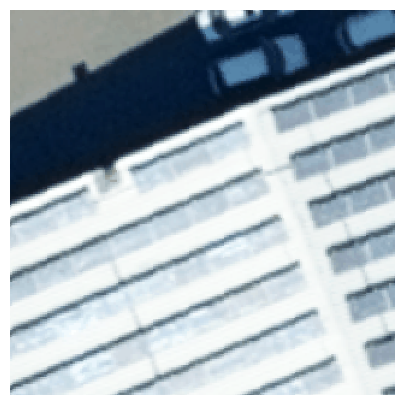


True label:

solar pv

Top predictions:

solar pv: 55.81%
no solar pv: 44.19%


In [ ]:
# Example with single image using only RGB bands

def normalize(img):
    '''Normalize images pushing all values in [0, 1]'''
    return (img - np.min(img)) / (np.max(img) - np.min(img))

idx = 993
image_id = test_df_pv4ger.iloc[idx].image_id
f = h5py.File(test_df_pv4ger.iloc[idx].filename)


r = f['Red'][:]    # shape (320, 320)
g = f['Green'][:]  # shape (320, 320)
b = f['Blue'][:]   # shape (320, 320)
rgb_image = np.stack([r, g, b], axis = -1) # shape (320, 320, 3)
true_color = normalize(rgb_image)

plt.figure(figsize = (5, 5))
plt.imshow(true_color)
plt.axis('off')
plt.show()

print("\nTrue label:\n")
print(test_df_pv4ger.iloc[idx].label)

image = CLIP_preprocess(Image.fromarray((true_color * 255).astype(np.uint8))).unsqueeze(0).to(device)
text = clip.tokenize(['a satellite image of ' + l for l in pv4ger_labels]).to(device)

with torch.no_grad():
    image_features = CLIP_model.encode_image(image)
    text_features = CLIP_model.encode_text(text)

image_features /= image_features.norm(dim=-1, keepdim=True)
text_features /= text_features.norm(dim=-1, keepdim=True)
similarity = (100.0 * image_features @ text_features.T).softmax(dim=-1)

# Print the result
print("\nTop predictions:\n")
for label, prob in sorted(zip(pv4ger_labels, similarity[0]), key = lambda x: x[1], reverse = True):
    print(f"{label}: {100 * prob:.2f}%")

#### Computing predictions

> **Note**: the following takes around 12 mins to run

In [ ]:
add_top_predictions_with_batches_standard(
    test_df_pv4ger,
    CLIP_model,
    CLIP_preprocess,
    device,
    pv4ger_labels,
    ['Red', 'Green', 'Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-pv4ger_predictions_CLIP_rgb.csv')

100%|██████████| 4/4 [05:15<00:00, 78.77s/it]


In [ ]:
output_df_clip = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/output/m-pv4ger_predictions_CLIP_rgb.csv')
output_df_clip.head()

,image_id,filename,bands,split,label,no_solar_pv_dotprod,solar_pv_dotprod,no_solar_pv_softmax,solar_pv_softmax,no_solar_pv_sigmoid,solar_pv_sigmoid,pred
0,"7.222180076676272, 50.698836440699615",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.284859,0.283982,0.521920,0.478080,0.570737,0.570522,no solar pv
1,"6.669612320016594, 51.73787665131514",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.298054,0.294103,0.597512,0.402488,0.573967,0.573000,no solar pv
2,"6.339084510786531, 51.22087464650394",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.249394,0.251077,0.458006,0.541994,0.562027,0.562442,solar pv
3,"8.724089525367726, 51.77399340700887",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.283555,0.281590,0.548978,0.451022,0.570418,0.569936,no solar pv
4,"7.8016608434245205, 52.243655122484405",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.273156,0.272297,0.521484,0.478516,0.567868,0.567657,no solar pv


In [ ]:
output_df_clip.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 999 entries, 0 to 998
Data columns (total 12 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   image_id             999 non-null    object 
 1   filename             999 non-null    object 
 2   bands                999 non-null    int64  
 3   split                999 non-null    object 
 4   label                999 non-null    object 
 5   no_solar_pv_dotprod  999 non-null    float64
 6   solar_pv_dotprod     999 non-null    float64
 7   no_solar_pv_softmax  999 non-null    float64
 8   solar_pv_softmax     999 non-null    float64
 9   no_solar_pv_sigmoid  999 non-null    float64
 10  solar_pv_sigmoid     999 non-null    float64
 11  pred                 999 non-null    object 
dtypes: float64(6), int64(1), object(5)
memory usage: 93.8+ KB


In [ ]:
output_df_clip.pred.value_counts()

,pred
no solar pv,719
solar pv,280


In [ ]:
# Classification report and confusion matrixs
labels = output_df_clip['label'].unique()
y_true = output_df_clip["label"]
y_pred = output_df_clip["pred"]

classification_report_and_cm(y_true, y_pred, labels)


Classification Report:

              precision    recall  f1-score   support

 no solar pv     0.9068    0.7707    0.8332       846
    solar pv     0.3071    0.5621    0.3972       153

    accuracy                         0.7387       999
   macro avg     0.6070    0.6664    0.6152       999
weighted avg     0.8150    0.7387    0.7665       999


Accuracy: 0.7387

Confusion matrix:

[[652 194]
 [ 67  86]]



In [ ]:
pd.crosstab(y_true, y_pred, rownames = ["Truth"], colnames = ["Prediction"])

Prediction,no solar pv,solar pv
Truth,,
no solar pv,652,194
solar pv,67,86


In [ ]:
import plotly.express as px
import pandas as pd

# select the softmax columns
softmax_cols = [col for col in output_df_clip.columns if col.endswith("_softmax")]
# create dataframe with selected columns in long format
softmax_melted = output_df_clip[softmax_cols].melt(var_name="label", value_name="softmax_score")
# remove '_softmax' from label to plot
softmax_melted["label"] = softmax_melted["label"].str.replace("_softmax", "").str.replace("_", " ")

# plot histogram
fig = px.histogram(
    softmax_melted,
    x="softmax_score",
    color="label",
    nbins=50,
    barmode="overlay",
    opacity=0.6,
    title="Distribution of Softmax Scores by Label"
)
fig.update_layout(xaxis_title="Softmax Score", yaxis_title="Count")
fig.show()

In [ ]:
# Boxplots of labels distribution
fig = px.box(
    softmax_melted,
    x="label",
    y="softmax_score",
    title="Boxplot of Softmax Scores by Label"
)
fig.update_layout(xaxis_title = "Label", yaxis_title = "Softmax value")
fig.show()

In [ ]:
output_df_clip.columns

Index(['image_id', 'filename', 'bands', 'split', 'label',
       'no_solar_pv_dotprod', 'solar_pv_dotprod', 'no_solar_pv_softmax',
       'solar_pv_softmax', 'no_solar_pv_sigmoid', 'solar_pv_sigmoid', 'pred',
       'true_binary'],
      dtype='object')

In [ ]:
# ROC curve and AUC
# Binary: convert true_label to 0/1
output_df_clip["true_binary"] = output_df_clip["label"].map({"no solar pv": 0, "solar pv": 1})
y_true = output_df_clip["true_binary"]
y_scores = output_df_clip["solar_pv_softmax"]

plot_auc(y_true, y_scores)

#### Computing predictions with alt labels 1 - "other scenery"


In [ ]:
# 1st set of alternative labels

custom_labels = ['other scenery',                  # negative class  # "other" si riferisce a che? -> prova prompt senza
                 'a solar photovoltaic system']    # positive class

add_top_predictions_with_batches_standard(
    test_df_pv4ger,
    CLIP_model,
    CLIP_preprocess,
    device,
    custom_labels,
    ['Red', 'Green', 'Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-pv4ger_predictions_CLIP_rgb_alt1.csv')

100%|██████████| 4/4 [12:24<00:00, 186.09s/it]


In [ ]:
output_df_clip1 = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/output/m-pv4ger_predictions_CLIP_rgb_alt1.csv')
output_df_clip1.head()

,image_id,filename,bands,split,label,other_scenery_dotprod,a_solar_photovoltaic_system_dotprod,other_scenery_softmax,a_solar_photovoltaic_system_softmax,other_scenery_sigmoid,a_solar_photovoltaic_system_sigmoid,pred
0,"7.222180076676272, 50.698836440699615",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.300207,0.273602,0.934650,0.065350,0.574493,0.567977,other scenery
1,"6.669612320016594, 51.73787665131514",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.316786,0.289213,0.940328,0.059672,0.578541,0.571803,other scenery
2,"6.339084510786531, 51.22087464650394",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.249459,0.241459,0.689982,0.310018,0.562043,0.560073,other scenery
3,"8.724089525367726, 51.77399340700887",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.276484,0.258483,0.858159,0.141841,0.568684,0.564263,other scenery
4,"7.8016608434245205, 52.243655122484405",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.287210,0.272717,0.809885,0.190115,0.571313,0.567760,other scenery


In [ ]:
output_df_clip1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 999 entries, 0 to 998
Data columns (total 12 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   image_id                             999 non-null    object 
 1   filename                             999 non-null    object 
 2   bands                                999 non-null    int64  
 3   split                                999 non-null    object 
 4   label                                999 non-null    object 
 5   other_scenery_dotprod                999 non-null    float64
 6   a_solar_photovoltaic_system_dotprod  999 non-null    float64
 7   other_scenery_softmax                999 non-null    float64
 8   a_solar_photovoltaic_system_softmax  999 non-null    float64
 9   other_scenery_sigmoid                999 non-null    float64
 10  a_solar_photovoltaic_system_sigmoid  999 non-null    float64
 11  pred                            

In [ ]:
output_df_clip1.pred.value_counts()

,pred
other scenery,566
a solar photovoltaic system,433


In [ ]:
# Classification report and confusion matrix
labels = output_df_clip1['label'].unique()
y_true = output_df_clip1["label"]
y_pred = output_df_clip1["pred"].map({"other scenery": "no solar pv",
                                      "a solar photovoltaic system": "solar pv"})

classification_report_and_cm(y_true, y_pred, labels)


Classification Report:

              precision    recall  f1-score   support

 no solar pv     0.9965    0.6667    0.7989       846
    solar pv     0.3487    0.9869    0.5154       153

    accuracy                         0.7157       999
   macro avg     0.6726    0.8268    0.6571       999
weighted avg     0.8973    0.7157    0.7554       999


Accuracy: 0.7157

Confusion matrix:

[[564 282]
 [  2 151]]



In [ ]:
# ROC curve and AUC
# Binary: convert true_label to 0/1
output_df_clip1["true_binary"] = output_df_clip1["label"].map({"no solar pv": 0, "solar pv": 1})
y_true = output_df_clip1["true_binary"]
y_scores = output_df_clip1["a_solar_photovoltaic_system_softmax"]

plot_auc(y_true, y_scores)

#### Computing predictions with alt labels 2 - "some scenery"

In [ ]:
# 2nd set of alternative labels

custom_labels = ['some scenery',                   # negative class
                 'a solar photovoltaic system']    # positive class

add_top_predictions_with_batches_standard(
    test_df_pv4ger,
    CLIP_model,
    CLIP_preprocess,
    device,
    custom_labels,
    ['Red', 'Green', 'Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-pv4ger_predictions_CLIP_rgb_alt2.csv')

100%|██████████| 4/4 [04:08<00:00, 62.07s/it]


In [ ]:
output_df_clip11 = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/output/m-pv4ger_predictions_CLIP_rgb_alt2.csv')
output_df_clip11.head()

,image_id,filename,bands,split,label,some_scenery_dotprod,a_solar_photovoltaic_system_dotprod,some_scenery_softmax,a_solar_photovoltaic_system_softmax,some_scenery_sigmoid,a_solar_photovoltaic_system_sigmoid,pred
0,"7.222180076676272, 50.698836440699615",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.308913,0.273602,0.971558,0.028442,0.576620,0.567977,some scenery
1,"6.669612320016594, 51.73787665131514",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.324716,0.289213,0.972087,0.027913,0.580473,0.571803,some scenery
2,"6.339084510786531, 51.22087464650394",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.250712,0.241459,0.716125,0.283875,0.562352,0.560073,some scenery
3,"8.724089525367726, 51.77399340700887",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.280191,0.258483,0.897602,0.102398,0.569593,0.564263,some scenery
4,"7.8016608434245205, 52.243655122484405",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.287598,0.272717,0.815787,0.184213,0.571408,0.567760,some scenery


In [ ]:
output_df_clip11.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 999 entries, 0 to 998
Data columns (total 12 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   image_id                             999 non-null    object 
 1   filename                             999 non-null    object 
 2   bands                                999 non-null    int64  
 3   split                                999 non-null    object 
 4   label                                999 non-null    object 
 5   some_scenery_dotprod                 999 non-null    float64
 6   a_solar_photovoltaic_system_dotprod  999 non-null    float64
 7   some_scenery_softmax                 999 non-null    float64
 8   a_solar_photovoltaic_system_softmax  999 non-null    float64
 9   some_scenery_sigmoid                 999 non-null    float64
 10  a_solar_photovoltaic_system_sigmoid  999 non-null    float64
 11  pred                            

In [ ]:
output_df_clip11.pred.value_counts()

,pred
some scenery,643
a solar photovoltaic system,356


In [ ]:
# Classification report and confusion matrix
labels = output_df_clip11['label'].unique()
y_true = output_df_clip11["label"]
y_pred = output_df_clip11["pred"].map({"some scenery": "no solar pv",
                                      "a solar photovoltaic system": "solar pv"})

classification_report_and_cm(y_true, y_pred, labels)


Classification Report:

              precision    recall  f1-score   support

 no solar pv     0.9969    0.7577    0.8610       846
    solar pv     0.4242    0.9869    0.5933       153

    accuracy                         0.7928       999
   macro avg     0.7105    0.8723    0.7272       999
weighted avg     0.9092    0.7928    0.8200       999


Accuracy: 0.7928

Confusion matrix:

[[641 205]
 [  2 151]]



In [ ]:
# ROC curve and AUC
# Binary: convert true_label to 0/1
output_df_clip11["true_binary"] = output_df_clip11["label"].map({"no solar pv": 0, "solar pv": 1})
y_true = output_df_clip11["true_binary"]
y_scores = output_df_clip11["a_solar_photovoltaic_system_softmax"]

plot_auc(y_true, y_scores)

#### Computing predictions with alt labels 3 - "some other scenery"

Trying to refine the textual prompts for CLIP to better match what the image features represent semantically. Two approaches are tested:
1. Binary captions, but instead of having a positive class and its negation we keep the positive class together with an "other" class.

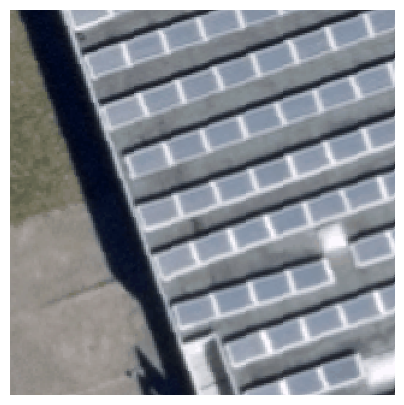


True label:

solar pv

Top predictions:

a solar photovoltaic system: 99.69%
an urban setting: 0.29%
an agricultural area: 0.02%
a green forested area: 0.00%


In [ ]:
# Example with single image using only RGB bands

def normalize(img):
    '''Normalize images pushing all values in [0, 1]'''
    return (img - np.min(img)) / (np.max(img) - np.min(img))

idx = 234 #993
image_id = test_df_pv4ger.iloc[idx].image_id
f = h5py.File(test_df_pv4ger.iloc[idx].filename)


r = f['Red'][:]    # shape (320, 320)
g = f['Green'][:]  # shape (320, 320)
b = f['Blue'][:]   # shape (320, 320)
rgb_image = np.stack([r, g, b], axis = -1) # shape (320, 320, 3)
true_color = normalize(rgb_image)

plt.figure(figsize = (5, 5))
plt.imshow(true_color)
plt.axis('off')
plt.show()

print("\nTrue label:\n")
print(test_df_pv4ger.iloc[idx].label)

test_labels = ['an urban setting',                # negative class(es)
               'a green forested area',
               'an agricultural area',
               'a solar photovoltaic system']

image = CLIP_preprocess(Image.fromarray((true_color * 255).astype(np.uint8))).unsqueeze(0).to(device)
text = clip.tokenize(['a satellite image of ' + l for l in test_labels]).to(device)

with torch.no_grad():
    image_features = CLIP_model.encode_image(image)
    text_features = CLIP_model.encode_text(text)

image_features /= image_features.norm(dim=-1, keepdim=True)
text_features /= text_features.norm(dim=-1, keepdim=True)
similarity = (100.0 * image_features @ text_features.T).softmax(dim=-1)

# Print the result
print("\nTop predictions:\n")
for label, prob in sorted(zip(test_labels, similarity[0]), key = lambda x: x[1], reverse = True):
    print(f"{label}: {100 * prob:.2f}%")

In [ ]:
# 3rd set of alternative labels

custom_labels = ['some other scenery',            # negative class
                 'a solar photovoltaic system']   # positive class

add_top_predictions_with_batches_standard(
    test_df_pv4ger,
    CLIP_model,
    CLIP_preprocess,
    device,
    custom_labels,
    ['Red', 'Green', 'Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-pv4ger_predictions_CLIP_rgb_alt3.csv')

100%|██████████| 4/4 [04:56<00:00, 74.13s/it]


In [ ]:
output_df_clip12 = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/output/m-pv4ger_predictions_CLIP_rgb_alt3.csv')
output_df_clip12.head()

,image_id,filename,bands,split,label,some_other_scenery_dotprod,a_solar_photovoltaic_system_dotprod,some_other_scenery_softmax,a_solar_photovoltaic_system_softmax,some_other_scenery_sigmoid,a_solar_photovoltaic_system_sigmoid,pred
0,"7.222180076676272, 50.698836440699615",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.306380,0.273602,0.963659,0.036341,0.576001,0.567977,some other scenery
1,"6.669612320016594, 51.73787665131514",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.320085,0.289213,0.956363,0.043637,0.579345,0.571803,some other scenery
2,"6.339084510786531, 51.22087464650394",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.252583,0.241459,0.752588,0.247412,0.562812,0.560073,some other scenery
3,"8.724089525367726, 51.77399340700887",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.280886,0.258483,0.903814,0.096186,0.569763,0.564263,some other scenery
4,"7.8016608434245205, 52.243655122484405",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.289249,0.272717,0.839315,0.160685,0.571812,0.567760,some other scenery


In [ ]:
output_df_clip12.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 999 entries, 0 to 998
Data columns (total 12 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   image_id                             999 non-null    object 
 1   filename                             999 non-null    object 
 2   bands                                999 non-null    int64  
 3   split                                999 non-null    object 
 4   label                                999 non-null    object 
 5   some_other_scenery_dotprod           999 non-null    float64
 6   a_solar_photovoltaic_system_dotprod  999 non-null    float64
 7   some_other_scenery_softmax           999 non-null    float64
 8   a_solar_photovoltaic_system_softmax  999 non-null    float64
 9   some_other_scenery_sigmoid           999 non-null    float64
 10  a_solar_photovoltaic_system_sigmoid  999 non-null    float64
 11  pred                            

In [ ]:
output_df_clip12.pred.value_counts()

,pred
some other scenery,620
a solar photovoltaic system,379


In [ ]:
# Classification report and confusion matrix
labels = output_df_clip12['label'].unique()
y_true = output_df_clip12["label"]
y_pred = output_df_clip12["pred"].map({"some other scenery": "no solar pv",
                                       "a solar photovoltaic system": "solar pv"})

classification_report_and_cm(y_true, y_pred, labels)


Classification Report:

              precision    recall  f1-score   support

 no solar pv     0.9952    0.7293    0.8417       846
    solar pv     0.3958    0.9804    0.5639       153

    accuracy                         0.7678       999
   macro avg     0.6955    0.8549    0.7028       999
weighted avg     0.9034    0.7678    0.7992       999


Accuracy: 0.7678

Confusion matrix:

[[617 229]
 [  3 150]]



In [ ]:
# ROC curve and AUC
# Binary: convert true_label to 0/1
output_df_clip12["true_binary"] = output_df_clip12["label"].map({"no solar pv": 0, "solar pv": 1})
y_true = output_df_clip12["true_binary"]
y_scores = output_df_clip12["a_solar_photovoltaic_system_softmax"]

plot_auc(y_true, y_scores)

#### Computing predictions with multi alt labels

2. Multi-prompt strategy for the negative class: instead of considering just one alternative to the positive class, diversify the descriptions for the negative samples and still consider them as 0

In [ ]:
# Multi-prompts for the negative class

custom_labels = ['an urban setting',                # negative class(es)
                 'a green forested area',
                 'an agricultural area',
                 'a solar photovoltaic system']     # positive class

add_top_predictions_with_batches_standard(
    test_df_pv4ger,
    CLIP_model,
    CLIP_preprocess,
    device,
    custom_labels,
    ['Red', 'Green', 'Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-pv4ger_predictions_CLIP_RGB_alt_multi.csv')

100%|██████████| 4/4 [05:50<00:00, 87.52s/it]


In [ ]:
output_df_clip2 = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/output/m-pv4ger_predictions_CLIP_RGB_alt_multi.csv')
output_df_clip2.head()

,image_id,filename,bands,split,label,an_urban_setting_dotprod,a_green_forested_area_dotprod,an_agricultural_area_dotprod,a_solar_photovoltaic_system_dotprod,an_urban_setting_softmax,a_green_forested_area_softmax,an_agricultural_area_softmax,a_solar_photovoltaic_system_softmax,an_urban_setting_sigmoid,a_green_forested_area_sigmoid,an_agricultural_area_sigmoid,a_solar_photovoltaic_system_sigmoid,pred
0,"7.222180076676272, 50.698836440699615",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.300025,0.314297,0.305239,0.273602,0.144454,0.601946,0.243315,0.010286,0.574449,0.577934,0.575723,0.567977,a green forested area
1,"6.669612320016594, 51.73787665131514",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.308119,0.347706,0.320139,0.289213,0.017585,0.921263,0.058498,0.002655,0.576426,0.586061,0.579358,0.571803,a green forested area
2,"6.339084510786531, 51.22087464650394",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.244050,0.243438,0.252232,0.241459,0.200859,0.188926,0.455213,0.155002,0.560712,0.560561,0.562726,0.560073,an agricultural area
3,"8.724089525367726, 51.77399340700887",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.267985,0.283156,0.263058,0.258483,0.152523,0.695324,0.093182,0.058972,0.566598,0.570320,0.565388,0.564263,a green forested area
4,"7.8016608434245205, 52.243655122484405",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.269216,0.263409,0.266952,0.272717,0.264818,0.148166,0.211169,0.375847,0.566900,0.565474,0.566345,0.567760,a solar photovoltaic system


In [ ]:
output_df_clip2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 999 entries, 0 to 998
Data columns (total 18 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   image_id                             999 non-null    object 
 1   filename                             999 non-null    object 
 2   bands                                999 non-null    int64  
 3   split                                999 non-null    object 
 4   label                                999 non-null    object 
 5   an_urban_setting_dotprod             999 non-null    float64
 6   a_green_forested_area_dotprod        999 non-null    float64
 7   an_agricultural_area_dotprod         999 non-null    float64
 8   a_solar_photovoltaic_system_dotprod  999 non-null    float64
 9   an_urban_setting_softmax             999 non-null    float64
 10  a_green_forested_area_softmax        999 non-null    float64
 11  an_agricultural_area_softmax    

In [ ]:
output_df_clip2.pred.value_counts()

,pred
a green forested area,383
a solar photovoltaic system,298
an agricultural area,217
an urban setting,101


In [ ]:
# Classification report and confusion matrix
labels = output_df_clip2['label'].unique()
y_true = output_df_clip2["label"]
y_pred = output_df_clip2["pred"].map({"an urban setting": "no solar pv",
                                      "a green forested area": "no solar pv",
                                      "an agricultural area": "no solar pv",
                                      "a solar photovoltaic system": "solar pv"})

classification_report_and_cm(y_true, y_pred, labels)


Classification Report:

              precision    recall  f1-score   support

 no solar pv     0.9815    0.8132    0.8895       846
    solar pv     0.4698    0.9150    0.6208       153

    accuracy                         0.8288       999
   macro avg     0.7256    0.8641    0.7552       999
weighted avg     0.9031    0.8288    0.8483       999


Accuracy: 0.8288

Confusion matrix:

[[688 158]
 [ 13 140]]



In [ ]:
# ROC curve and AUC
# Binary: convert true_label to 0/1
output_df_clip2["true_binary"] = output_df_clip2["label"].map({"no solar pv": 0, "solar pv": 1})
y_true = output_df_clip2["true_binary"]
y_scores = output_df_clip2["a_solar_photovoltaic_system_softmax"]

plot_auc(y_true, y_scores)

### 3) m-forestnet

- Example of CLIP prediction of a single image.

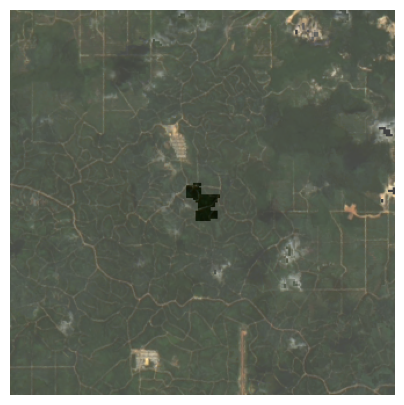


True label:

Oil palm plantation

Top predictions:

Logging: 62.16%
Timber plantation: 11.15%
Secondary forest: 9.09%
Small-scale oil palm plantation: 7.31%
Oil palm plantation: 3.79%
Other large-scale plantations: 2.06%
Small-scale mixed plantation: 1.27%
Other: 1.25%
Mining: 0.89%
Small-scale agriculture: 0.71%
Grassland shrubland: 0.17%
Fish pond: 0.14%


In [ ]:
# Example with single image using only RGB bands

def normalize(img):
    '''Normalize images pushing all values in [0, 1]'''
    return (img - np.min(img)) / (np.max(img) - np.min(img))

idx = 0
image_id = test_df_forestnet.iloc[idx].image_id
f = h5py.File(test_df_forestnet.iloc[idx].filename)


r = f[[i for i in f.keys() if '04 - Red' in i][0]][:]      # Red channel, shape (332, 332)
g = f[[i for i in f.keys() if '03 - Green' in i][0]][:]    # Green channel, shape (332, 332)
b = f[[i for i in f.keys() if '02 - Blue' in i][0]][:]     # Blue channel, shape (332, 332)
rgb_image = np.stack([r, g, b], axis = -1) # shape (332, 332, 3)
true_color = normalize(rgb_image)

plt.figure(figsize = (5, 5))
plt.imshow(true_color)
plt.axis('off')
plt.show()

print("\nTrue label:\n")
print(test_df_forestnet.iloc[idx].label)

image = CLIP_preprocess(Image.fromarray((true_color * 255).astype(np.uint8))).unsqueeze(0).to(device)
text = clip.tokenize(['a satellite image of ' + l for l in forestnet_labels]).to(device)

with torch.no_grad():
    image_features = CLIP_model.encode_image(image)
    text_features = CLIP_model.encode_text(text)

image_features /= image_features.norm(dim=-1, keepdim=True)
text_features /= text_features.norm(dim=-1, keepdim=True)
similarity = (100.0 * image_features @ text_features.T).softmax(dim=-1)

# Print the result
print("\nTop predictions:\n")
for label, prob in sorted(zip(forestnet_labels, similarity[0]), key = lambda x: x[1], reverse = True):
    print(f"{label}: {100 * prob:.2f}%")

#### Computing predictions

In [ ]:
#from datetime import datetime
#timestamp = datetime.now().strftime("%Y%m%d_%H%M%S")
#output_path = f'/content/drive/MyDrive/Thesis CLIP4EO/output/m-forestnet_predictions_CLIP_rgb_{timestamp}.csv'

add_top_predictions_with_batches_forestnet(
    test_df_forestnet,
    CLIP_model,
    CLIP_preprocess,
    device,
    forestnet_labels,
    ['04 - Red', '03 - Green', '02 - Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-forestnet_predictions_CLIP_RGB.csv')

100%|██████████| 4/4 [10:42<00:00, 160.56s/it]


In [ ]:
output_df_clip = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/output/m-forestnet_predictions_CLIP_RGB.csv')
output_df_clip.head()

,image_id,filename,bands,split,label,Oil_palm_plantation_dotprod,Timber_plantation_dotprod,Other_large-scale_plantations_dotprod,Grassland_shrubland_dotprod,Small-scale_agriculture_dotprod,...,Grassland_shrubland_sigmoid,Small-scale_agriculture_sigmoid,Small-scale_mixed_plantation_sigmoid,Small-scale_oil_palm_plantation_sigmoid,Mining_sigmoid,Fish_pond_sigmoid,Logging_sigmoid,Secondary_forest_sigmoid,Other_sigmoid,pred
0,-1.358752546215941_113.47632662109709_2014_01_01,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,6,test,Oil palm plantation,0.309988,0.320645,0.303815,0.278882,0.292956,...,0.569272,0.572720,0.574224,0.578464,0.573312,0.568698,0.583668,0.579051,0.574188,Logging
1,-0.3909200308691534_116.02049649124226_2015_01_01,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,6,test,Oil palm plantation,0.331428,0.344980,0.353727,0.343443,0.358653,...,0.585027,0.588714,0.589415,0.583441,0.579150,0.580312,0.584506,0.587429,0.579916,Small-scale mixed plantation
2,-1.8806664692642177_111.7221681696664_2013_10_30,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,6,test,Oil palm plantation,0.332733,0.331924,0.324589,0.315598,0.323959,...,0.578251,0.580289,0.580583,0.583359,0.576038,0.575915,0.586297,0.584485,0.580167,Logging
3,0.3935898654105616_99.19789981112714_2013_01_01,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,6,test,Oil palm plantation,0.292003,0.283517,0.287095,0.263781,0.299793,...,0.565565,0.574392,0.569794,0.572447,0.571589,0.570612,0.575737,0.571257,0.568511,Logging
4,-2.0832762463589005_104.28473205885147_2018_08_05,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,6,test,Grassland shrubland,0.317621,0.317551,0.317510,0.318329,0.312104,...,0.578917,0.577399,0.579164,0.578308,0.575768,0.580424,0.579645,0.582689,0.575678,Secondary forest


In [ ]:
output_df_clip.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 993 entries, 0 to 992
Data columns (total 42 columns):
 #   Column                                   Non-Null Count  Dtype  
---  ------                                   --------------  -----  
 0   image_id                                 993 non-null    object 
 1   filename                                 993 non-null    object 
 2   bands                                    993 non-null    int64  
 3   split                                    993 non-null    object 
 4   label                                    993 non-null    object 
 5   Oil_palm_plantation_dotprod              993 non-null    float64
 6   Timber_plantation_dotprod                993 non-null    float64
 7   Other_large-scale_plantations_dotprod    993 non-null    float64
 8   Grassland_shrubland_dotprod              993 non-null    float64
 9   Small-scale_agriculture_dotprod          993 non-null    float64
 10  Small-scale_mixed_plantation_dotprod     993 non-n

In [ ]:
output_df_clip.pred.value_counts()

,pred
Logging,497
Secondary forest,172
Small-scale agriculture,97
Small-scale mixed plantation,62
Fish pond,48
Small-scale oil palm plantation,34
Grassland shrubland,31
Oil palm plantation,21
Timber plantation,18
Mining,5


In [ ]:
# Classification report and confusion matrix
labels = output_df_clip['label'].unique()
y_true = output_df_clip["label"]
y_pred = output_df_clip["pred"]

classification_report_and_cm_multiclass(y_true, y_pred, labels)


Classification Report:

                                 precision    recall  f1-score   support

                      Fish pond     0.0833    0.2857    0.1290        14
            Grassland shrubland     0.2258    0.0795    0.1176        88
                        Logging     0.0362    0.7500    0.0691        24
                         Mining     0.6000    0.1034    0.1765        29
            Oil palm plantation     0.4286    0.0433    0.0786       208
                          Other     0.0000    0.0000    0.0000        30
  Other large-scale plantations     0.0000    0.0000    0.0000        73
               Secondary forest     0.0756    0.3023    0.1209        43
        Small-scale agriculture     0.0206    0.0091    0.0127       219
   Small-scale mixed plantation     0.2258    0.1918    0.2074        73
Small-scale oil palm plantation     0.0000    0.0000    0.0000        50
              Timber plantation     0.3333    0.0423    0.0750       142

                       a

In [ ]:
import pandas as pd
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# select the softmax columns
softmax_cols = [col for col in output_df_clip.columns if col.endswith("_softmax")]

# melt into long format
softmax_melted = output_df_clip[softmax_cols].melt(
    var_name="label", value_name="softmax_score"
)

# clean label names
softmax_melted["label"] = (
    softmax_melted["label"]
    .str.replace("_softmax", "", regex=False)
    .str.replace("_", " ")
)

# get unique labels
labels = sorted(softmax_melted["label"].unique())

# create subplots: 6 rows, 2 columns
fig = make_subplots(
    rows = 6, cols = 2,
    subplot_titles = labels,
    shared_xaxes = True,
    shared_yaxes = False,
    vertical_spacing = 0.08,
    horizontal_spacing = 0.08
)

# add a histogram for each label
for i, label in enumerate(labels):
    row = (i // 2) + 1
    col = (i % 2) + 1

    data = softmax_melted[softmax_melted["label"] == label]
    fig.add_trace(
        go.Histogram(
            x=data["softmax_score"],
            nbinsx = 50,
            name = label,
            opacity = 0.7,
            marker = dict(color='steelblue')
        ),
        row = row, col = col
    )

# layout
fig.update_layout(
    height=1800,  # adjust based on how tall you want it
    width=1000,
    title_text="Softmax Score Distribution per Label",
    showlegend=False
)

# update axes titles
for i in range(1, 13):
    fig['layout'][f'xaxis{i}']['title'] = 'Softmax score'
    fig['layout'][f'yaxis{i}']['title'] = 'count'

fig.show()

In [ ]:
import plotly.express as px
import plotly.colors as pc

# Melt the softmax columns to long format again (if not done already)
softmax_cols = [col for col in output_df_clip.columns if col.endswith("_softmax")]

softmax_melted = output_df_clip[softmax_cols].melt(
    var_name="label", value_name="softmax_score"
)

# Clean label names for display
softmax_melted["label"] = (
    softmax_melted["label"]
    .str.replace("_softmax", "", regex=False)
    .str.replace("_", " ")
)

# generate custom color palette
custom_palette = pc.sample_colorscale("Viridis", [i/11 for i in range(12)], colortype="rgb")

# Create the boxplot
fig = px.box(
    softmax_melted,
    x="label",
    y="softmax_score",
    #points="all",  # "outliers" to only show outliers, "all" for jittered points
    color="label",  # color by label
    color_discrete_sequence = custom_palette,
    title="Softmax boxplots by label",
)

fig.update_layout(
    xaxis_title="label",
    yaxis_title="Softmax score",
    showlegend=False,
    xaxis_tickangle=45,
    height=600,
    width=1000
)

fig.show()


In [ ]:
# ROC curves and AUC scores
# Binarize the labels for multi-class classification
labels = output_df_clip["label"].unique()
y_true = label_binarize(output_df_clip["label"], classes=labels)

softmax_cols = [col for col in output_df_clip.columns if col.endswith("_softmax")]
y_scores = output_df_clip[softmax_cols].values


plot_auc_multiclass(y_true, y_scores, labels)

### 4) m-eurosat

- Example of CLIP prediction of a single image.


Image: id_26164 



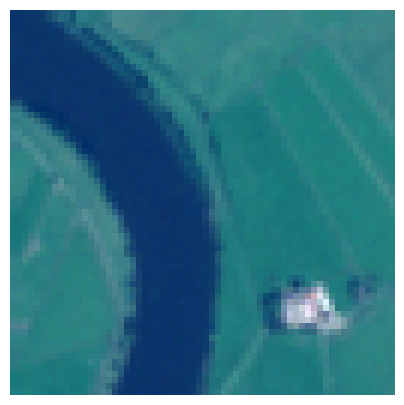


True label:

River

Top predictions:

Permanent Crop: 29.56%
Annual Crop: 27.30%
Pasture: 17.30%
River: 11.82%
Industrial Buildings: 6.92%
Residential Buildings: 2.05%
Sea and Lake: 1.77%
Highway: 1.45%
Herbaceous Vegetation: 1.21%
Forest: 0.63%


In [ ]:
# Example with single image using only RGB bands

id = 'id_26164'
f = h5py.File(test_df_eurosat[test_df_eurosat.image_id == id].filename.item())

r = f['04 - Red'][:]    # shape (64, 64)
g = f['03 - Green'][:]  # shape (64, 64)
b = f['02 - Blue'][:]   # shape (64, 64)
rgb_image = np.stack([r, g, b], axis = -1) # shape (64, 64, 3)
true_color = normalize(rgb_image)

print("\nImage:", id, '\n')
plt.figure(figsize = (5, 5))
plt.imshow(true_color)
plt.axis('off')
plt.show()

print("\nTrue label:\n")
print(test_df_eurosat[test_df_eurosat.image_id == id].label.item())

image = CLIP_preprocess(Image.fromarray((true_color * 255).astype(np.uint8))).unsqueeze(0).to(device)
text = clip.tokenize(['a satellite image of ' + l for l in eurosat_labels]).to(device)

with torch.no_grad():
    image_features = CLIP_model.encode_image(image)
    text_features = CLIP_model.encode_text(text)

    # logits_per_image, logits_per_text = CLIP_model(image, text)
    # probs = logits_per_image.softmax(dim=-1).cpu().numpy()

image_features /= image_features.norm(dim=-1, keepdim=True)
text_features /= text_features.norm(dim=-1, keepdim=True)
similarity = (100.0 * image_features @ text_features.T).softmax(dim=-1)

# Print the result
print("\nTop predictions:\n")
for label, prob in sorted(zip(eurosat_labels, similarity[0]), key = lambda x: x[1], reverse = True):
    print(f"{label}: {100 * prob:.2f}%")

#### Computing predictions

In [ ]:
add_top_predictions_with_batches_standard(
    test_df_eurosat,
    CLIP_model,
    CLIP_preprocess,
    device,
    sorted(eurosat_labels),
    ['04 - Red', '03 - Green', '02 - Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-eurosat_predictions_CLIP_RGB.csv')

100%|██████████| 4/4 [00:46<00:00, 11.60s/it]


In [ ]:
output_df_clip = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/output/m-eurosat_predictions_CLIP_RGB.csv')
output_df_clip.head()

,image_id,filename,bands,split,label_idx,label,Annual_Crop_dotprod,Forest_dotprod,Herbaceous_Vegetation_dotprod,Highway_dotprod,...,Forest_sigmoid,Herbaceous_Vegetation_sigmoid,Highway_sigmoid,Industrial_Buildings_sigmoid,Pasture_sigmoid,Permanent_Crop_sigmoid,Residential_Buildings_sigmoid,River_sigmoid,Sea_and_Lake_sigmoid,pred
0,id_22869,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,2,Herbaceous Vegetation,0.286133,0.296631,0.285889,0.279541,...,0.573730,0.570801,0.569336,0.566895,0.570801,0.571289,0.568359,0.567871,0.564941,Forest
1,id_26790,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,9,Sea and Lake,0.298096,0.298584,0.287354,0.293457,...,0.574219,0.571289,0.572754,0.570801,0.573730,0.572754,0.570801,0.571289,0.576172,Sea and Lake
2,id_24810,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,6,Permanent Crop,0.282715,0.283691,0.273193,0.287109,...,0.570312,0.567871,0.571289,0.572754,0.569336,0.569824,0.573242,0.567383,0.564941,Residential Buildings
3,id_23442,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,3,Highway,0.283447,0.280518,0.280762,0.311279,...,0.569824,0.569824,0.577148,0.576172,0.573730,0.570312,0.573242,0.568359,0.561523,Highway
4,id_26899,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,9,Sea and Lake,0.275146,0.276611,0.269043,0.274414,...,0.568848,0.566895,0.568359,0.564453,0.569824,0.567871,0.563965,0.565918,0.564941,Pasture


In [ ]:
output_df_clip.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 37 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   image_id                       1000 non-null   object 
 1   filename                       1000 non-null   object 
 2   bands                          1000 non-null   int64  
 3   split                          1000 non-null   object 
 4   label_idx                      1000 non-null   int64  
 5   label                          1000 non-null   object 
 6   Annual_Crop_dotprod            1000 non-null   float64
 7   Forest_dotprod                 1000 non-null   float64
 8   Herbaceous_Vegetation_dotprod  1000 non-null   float64
 9   Highway_dotprod                1000 non-null   float64
 10  Industrial_Buildings_dotprod   1000 non-null   float64
 11  Pasture_dotprod                1000 non-null   float64
 12  Permanent_Crop_dotprod         1000 non-null   fl

In [ ]:
output_df_clip.pred.value_counts()

,pred
Industrial Buildings,207
Highway,154
Residential Buildings,142
Pasture,119
Annual Crop,113
Forest,97
River,84
Permanent Crop,48
Sea and Lake,36


$\color{red}{\text{alert:}}$ the class 'Herbaceous Vegetation' is never predicted

In [ ]:
# Classification report and confusion matrix
labels = output_df_clip['label'].unique()
y_true = output_df_clip["label"]
y_pred = output_df_clip["pred"]

classification_report_and_cm_multiclass(y_true, y_pred, labels)


Classification Report:

                       precision    recall  f1-score   support

          Annual Crop     0.3805    0.4300    0.4038       100
               Forest     0.3711    0.3600    0.3655       100
Herbaceous Vegetation     0.0000    0.0000    0.0000       100
              Highway     0.3896    0.6000    0.4724       100
 Industrial Buildings     0.3865    0.8000    0.5212       100
              Pasture     0.4034    0.4800    0.4384       100
       Permanent Crop     0.3542    0.1700    0.2297       100
Residential Buildings     0.5775    0.8200    0.6777       100
                River     0.4405    0.3700    0.4022       100
         Sea and Lake     0.4444    0.1600    0.2353       100

             accuracy                         0.4190      1000
            macro avg     0.3748    0.4190    0.3746      1000
         weighted avg     0.3748    0.4190    0.3746      1000


Accuracy: 0.4190

Confusion matrix:

[[ 0  2  1 13 29  4  0  3 46  2]
 [ 0 16  0 43  5  1

In [ ]:
import pandas as pd
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# select the softmax columns
softmax_cols = [col for col in output_df_clip.columns if col.endswith("_softmax")]

# melt into long format
softmax_melted = output_df_clip[softmax_cols].melt(
    var_name="label", value_name="softmax_score"
)

# clean label names
softmax_melted["label"] = (
    softmax_melted["label"]
    .str.replace("_softmax", "", regex=False)
    .str.replace("_", " ")
)

# get unique labels
labels = sorted(softmax_melted["label"].unique())

# create subplots: 6 rows, 2 columns
fig = make_subplots(
    rows = 5, cols = 2,
    subplot_titles = labels,
    shared_xaxes = True,
    shared_yaxes = False,
    vertical_spacing = 0.08,
    horizontal_spacing = 0.08
)

# add a histogram for each label
for i, label in enumerate(labels):
    row = (i // 2) + 1
    col = (i % 2) + 1

    data = softmax_melted[softmax_melted["label"] == label]
    fig.add_trace(
        go.Histogram(
            x=data["softmax_score"],
            nbinsx = 50,
            name = label,
            opacity = 0.7,
            marker = dict(color='steelblue')
        ),
        row = row, col = col
    )

# layout
fig.update_layout(
    height=1800,  # adjust based on how tall you want it
    width=1000,
    title_text="Softmax score distribution per label",
    showlegend=False
)

# update axes titles
for i in range(1, 11):
    fig['layout'][f'xaxis{i}']['title'] = 'Softmax score'
    fig['layout'][f'yaxis{i}']['title'] = 'count'

fig.show()

In [ ]:
import plotly.express as px
import plotly.colors as pc

# Melt the softmax columns to long format again (if not done already)
softmax_cols = [col for col in output_df_clip.columns if col.endswith("_softmax")]

softmax_melted = output_df_clip[softmax_cols].melt(
    var_name="label", value_name="softmax_score"
)

# Clean label names for display
softmax_melted["label"] = (
    softmax_melted["label"]
    .str.replace("_softmax", "", regex=False)
    .str.replace("_", " ")
)

# generate custom color palette
custom_palette = pc.sample_colorscale("Viridis", [i/11 for i in range(12)], colortype="rgb")

# Create the boxplot
fig = px.box(
    softmax_melted,
    x="label",
    y="softmax_score",
    #points="all",  # "outliers" to only show outliers, "all" for jittered points
    color="label",  # color by label
    color_discrete_sequence = custom_palette,
    title="Softmax boxplots by label",
)

fig.update_layout(
    xaxis_title="label",
    yaxis_title="Softmax score",
    showlegend=False,
    xaxis_tickangle=45,
    height=600,
    width=1000
)

fig.show()

In [ ]:
# ROC curves and AUC scores
# Binarize the labels for multi-class classification
labels = output_df_clip["label"].unique()
y_true = label_binarize(output_df_clip["label"], classes=labels)

softmax_cols = [col for col in output_df_clip.columns if col.endswith("_softmax")]
y_scores = output_df_clip[softmax_cols].values

plot_auc_multiclass(y_true, y_scores, labels)

### 5) m-so2sat

- Example of CLIP prediction of a single image.

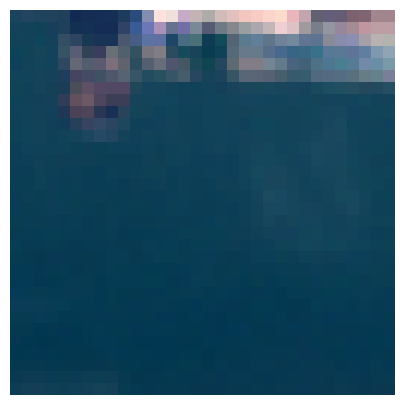


True label:

Water

Top predictions:

Open high rise: 13.01%
Lightweight low rise: 10.84%
Sparsely built: 9.32%
Compact high rise: 7.00%
Compact mid rise: 6.88%
Bush, scrub: 6.51%
Open mid rise: 6.45%
Low plants: 6.22%
Heavy industry: 6.18%
Open low rise: 6.06%
Water: 4.06%
Bare soil or sand: 4.05%
Large low rise: 3.82%
Compact low rise: 3.81%
Scattered trees: 2.96%
Dense trees: 1.99%
Bare rock or paved: 0.85%


In [ ]:
# Example with single image using only RGB bands

idx = test_df_so2sat[test_df_so2sat['image_id'] == 'id_377660'].index.item()
image_id =  test_df_so2sat.iloc[idx].image_id
f = h5py.File(test_df_so2sat.iloc[idx].filename)

r = f['04 - Red'][:]    # shape (64, 64)
g = f['03 - Green'][:]  # shape (64, 64)
b = f['02 - Blue'][:]   # shape (64, 64)
rgb_image = np.stack([r, g, b], axis = -1) # shape (64, 64, 3)
true_color = normalize(rgb_image)

plt.figure(figsize = (5, 5))
plt.imshow(true_color)
plt.axis('off')
plt.show()

print("\nTrue label:\n")
print(test_df_so2sat.iloc[idx].label)


image = CLIP_preprocess(Image.fromarray((true_color * 255).astype(np.uint8))).unsqueeze(0).to(device)
text = clip.tokenize(['a satellite image of ' + l.lower() for l in so2sat_labels]).to(device)


with torch.no_grad():
    image_features = CLIP_model.encode_image(image)
    text_features = CLIP_model.encode_text(text)


image_features /= image_features.norm(dim=-1, keepdim=True)
text_features /= text_features.norm(dim=-1, keepdim=True)
similarity = (100.0 * image_features @ text_features.T).softmax(dim=-1)

# Print the result
print("\nTop predictions:\n")
for label, prob in sorted(zip(so2sat_labels, similarity[0]), key = lambda x: x[1], reverse = True):
    print(f"{label}: {100 * prob:.2f}%")

#### Computing predictions

In [ ]:
add_top_predictions_with_batches_standard(
    test_df_so2sat,
    CLIP_model,
    CLIP_preprocess,
    device,
    so2sat_labels,
    ['04 - Red', '03 - Green', '02 - Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-so2sat_predictions_CLIP_RGB.csv')

100%|██████████| 4/4 [05:47<00:00, 86.85s/it]


In [ ]:
output_df_clip = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/output/m-so2sat_predictions_CLIP_RGB.csv')
output_df_clip.head()

,image_id,filename,bands,split,label,Compact_high_rise_dotprod,Compact_mid_rise_dotprod,Compact_low_rise_dotprod,Open_high_rise_dotprod,Open_mid_rise_dotprod,...,Sparsely_built_sigmoid,Heavy_industry_sigmoid,Dense_trees_sigmoid,Scattered_trees_sigmoid,"Bush,_scrub_sigmoid",Low_plants_sigmoid,Bare_rock_or_paved_sigmoid,Bare_soil_or_sand_sigmoid,Water_sigmoid,pred
0,id_388372,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,18,test,Open mid rise,0.293850,0.288344,0.273966,0.295063,0.282805,...,0.572438,0.577038,0.568537,0.569401,0.567529,0.569470,0.569769,0.571169,0.566987,Heavy industry
1,id_394258,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,18,test,Dense trees,0.276896,0.277714,0.275773,0.279077,0.273287,...,0.570787,0.568994,0.569749,0.575132,0.569392,0.571396,0.567355,0.568927,0.570293,Scattered trees
2,id_388689,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,18,test,"Bush, scrub",0.276513,0.283390,0.280822,0.270684,0.269318,...,0.571970,0.567447,0.564924,0.566419,0.571063,0.567241,0.570743,0.576624,0.568855,Bare soil or sand
3,id_400562,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,18,test,Scattered trees,0.280711,0.276815,0.275945,0.281085,0.271790,...,0.569890,0.565104,0.571997,0.574018,0.572317,0.571946,0.573552,0.571346,0.570678,Scattered trees
4,id_390823,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,18,test,Sparsely built,0.240971,0.238431,0.222671,0.246526,0.237854,...,0.560369,0.565153,0.559161,0.559055,0.558236,0.559351,0.555848,0.557459,0.558219,Heavy industry


In [ ]:
output_df_clip.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 986 entries, 0 to 985
Data columns (total 57 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   image_id                      986 non-null    object 
 1   filename                      986 non-null    object 
 2   bands                         986 non-null    int64  
 3   split                         986 non-null    object 
 4   label                         986 non-null    object 
 5   Compact_high_rise_dotprod     986 non-null    float64
 6   Compact_mid_rise_dotprod      986 non-null    float64
 7   Compact_low_rise_dotprod      986 non-null    float64
 8   Open_high_rise_dotprod        986 non-null    float64
 9   Open_mid_rise_dotprod         986 non-null    float64
 10  Open_low_rise_dotprod         986 non-null    float64
 11  Lightweight_low_rise_dotprod  986 non-null    float64
 12  Large_low_rise_dotprod        986 non-null    float64
 13  Spars

In [ ]:
output_df_clip.pred.value_counts()

,pred
Heavy industry,207
Bare soil or sand,190
Scattered trees,182
Open high rise,163
Water,99
Sparsely built,84
Compact high rise,22
Low plants,10
Bare rock or paved,10
Dense trees,8


In [ ]:
# Classification report and confusion matrix
labels = output_df_clip['label'].unique()
y_true = output_df_clip["label"]
y_pred = output_df_clip["pred"]

classification_report_and_cm_multiclass(y_true, y_pred, labels)


Classification Report:

                      precision    recall  f1-score   support

  Bare rock or paved     0.5000    0.0862    0.1471        58
   Bare soil or sand     0.2474    0.8103    0.3790        58
         Bush, scrub     0.0000    0.0000    0.0000        58
   Compact high rise     0.0000    0.0000    0.0000        58
    Compact low rise     0.0000    0.0000    0.0000        58
    Compact mid rise     0.0000    0.0000    0.0000        58
         Dense trees     0.0000    0.0000    0.0000        58
      Heavy industry     0.1256    0.4483    0.1962        58
      Large low rise     0.0000    0.0000    0.0000        58
Lightweight low rise     0.0000    0.0000    0.0000        58
          Low plants     0.3000    0.0517    0.0882        58
      Open high rise     0.1104    0.3103    0.1629        58
       Open low rise     0.0000    0.0000    0.0000        58
       Open mid rise     0.0000    0.0000    0.0000        58
     Scattered trees     0.1154    0.3621   

In [ ]:
# ROC curves and AUC scores
# Binarize the labels for multi-class classification
labels = output_df_clip["label"].unique()
y_true = label_binarize(output_df_clip["label"], classes=labels)

softmax_cols = [col for col in output_df_clip.columns if col.endswith("_softmax")]
y_scores = output_df_clip[softmax_cols].values

plot_auc_multiclass(y_true, y_scores, labels)

In [ ]:
import pandas as pd
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# select the softmax columns
softmax_cols = [col for col in output_df_clip.columns if col.endswith("_softmax")]

# melt into long format
softmax_melted = output_df_clip[softmax_cols].melt(
    var_name="label", value_name="softmax_score"
)

# clean label names
softmax_melted["label"] = (
    softmax_melted["label"]
    .str.replace("_softmax", "", regex=False)
    .str.replace("_", " ")
)

# get unique labels
labels = sorted(softmax_melted["label"].unique())

# create subplots: 6 rows, 2 columns
fig = make_subplots(
    rows = 9, cols = 2,
    subplot_titles = labels,
    shared_xaxes = True,
    shared_yaxes = False,
    vertical_spacing = 0.04,
    horizontal_spacing = 0.08
)

# add a histogram for each label
for i, label in enumerate(labels):
    row = (i // 2) + 1
    col = (i % 2) + 1

    data = softmax_melted[softmax_melted["label"] == label]
    fig.add_trace(
        go.Histogram(
            x=data["softmax_score"],
            nbinsx = 50,
            name = label,
            opacity = 0.7,
            marker = dict(color='steelblue')
        ),
        row = row, col = col
    )

# layout
fig.update_layout(
    height=1800,  # adjust based on how tall you want it
    width=1000,
    title_text="Softmax score distribution per label",
    showlegend=False
)

# update axes titles
for i in range(1, 18):
    fig['layout'][f'xaxis{i}']['title'] = 'Softmax score'
    fig['layout'][f'yaxis{i}']['title'] = 'count'

fig.show()

In [ ]:
import plotly.express as px
import plotly.colors as pc

# Melt the softmax columns to long format again (if not done already)
softmax_cols = [col for col in output_df_clip.columns if col.endswith("_softmax")]

softmax_melted = output_df_clip[softmax_cols].melt(
    var_name="label", value_name="softmax_score"
)

# Clean label names for display
softmax_melted["label"] = (
    softmax_melted["label"]
    .str.replace("_softmax", "", regex=False)
    .str.replace("_", " ")
)

# generate custom color palette
custom_palette = pc.sample_colorscale("Viridis", [i/11 for i in range(12)], colortype="rgb")

# Create the boxplot
fig = px.box(
    softmax_melted,
    x="label",
    y="softmax_score",
    #points="all",  # "outliers" to only show outliers, "all" for jittered points
    color="label",  # color by label
    color_discrete_sequence = custom_palette,
    title="Softmax boxplots by label",
)

fig.update_layout(
    xaxis_title="label",
    yaxis_title="Softmax score",
    showlegend=False,
    xaxis_tickangle=45,
    height=600,
    width=1000
)

fig.show()

#### Computing predictions with refined labels

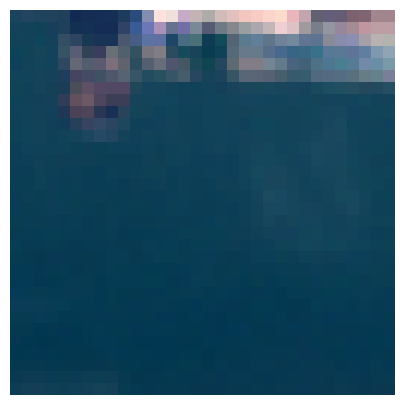


True label:

Water

Top predictions:

Lightweight low rise: 19.82%
Open high rise: 11.32%
Sparsely built: 10.15%
Heavy industry: 7.98%
Compact low rise: 7.90%
Compact high rise: 7.80%
Large low rise: 6.54%
Open low rise: 6.07%
Water: 4.76%
Compact mid rise: 4.60%
Open mid rise: 3.93%
Bare soil or sand: 3.46%
Bush, scrub: 2.45%
Scattered trees: 1.01%
Bare rock or paved: 0.81%
Low plants: 0.79%
Dense trees: 0.61%


In [ ]:
# Example with single image using only RGB bands

idx = test_df_so2sat[test_df_so2sat['image_id'] == 'id_377660'].index.item()
image_id =  test_df_so2sat.iloc[idx].image_id
f = h5py.File(test_df_so2sat.iloc[idx].filename)

r = f['04 - Red'][:]    # shape (64, 64)
g = f['03 - Green'][:]  # shape (64, 64)
b = f['02 - Blue'][:]   # shape (64, 64)
rgb_image = np.stack([r, g, b], axis = -1) # shape (64, 64, 3)
true_color = normalize(rgb_image)

plt.figure(figsize = (5, 5))
plt.imshow(true_color)
plt.axis('off')
plt.show()

print("\nTrue label:\n")
print(test_df_so2sat.iloc[idx].label)

custom_so2sat_labels = {'compact high rise constructions':'Compact high rise',
                        'compact mid rise constructions':'Compact mid rise',
                        'compact low rise constructions':'Compact low rise',
                        'open high rise constructions':'Open high rise',
                        'open mid rise constructions':'Open mid rise',
                        'open low rise constructions':'Open low rise',
                        'lightweight low rise constructions':'Lightweight low rise',
                        'large low rise constructions':'Large low rise',
                        'sparsely built constructions':'Sparsely built',
                        'heavy industry constructions':'Heavy industry',
                        'a green area with dense trees':'Dense trees',
                        'a green area with scattered trees':'Scattered trees',
                        'a green area with low plants and fields':'Low plants',
                        'barren terrain with bush or scrub':'Bush, scrub',
                        'barren terrain area with bare rock or paved soil':'Bare rock or paved',
                        'an area of dry soil or sand':'Bare soil or sand',
                        'water, sea or lake':"Water"}


image = CLIP_preprocess(Image.fromarray((true_color * 255).astype(np.uint8))).unsqueeze(0).to(device)
text = clip.tokenize(['a satellite image of ' + l.lower() for l in custom_so2sat_labels.keys()]).to(device)


with torch.no_grad():
    image_features = CLIP_model.encode_image(image)
    text_features = CLIP_model.encode_text(text)


image_features /= image_features.norm(dim=-1, keepdim=True)
text_features /= text_features.norm(dim=-1, keepdim=True)
similarity = (100.0 * image_features @ text_features.T).softmax(dim=-1)

# Print the result
print("\nTop predictions:\n")
for label, prob in sorted(zip(custom_so2sat_labels.values(), similarity[0]), key = lambda x: x[1], reverse = True):
    print(f"{label}: {100 * prob:.2f}%")

In [ ]:
add_top_predictions_with_batches_standard(
    test_df_so2sat,
    CLIP_model,
    CLIP_preprocess,
    device,
    list(custom_so2sat_labels.keys()),
    ['04 - Red', '03 - Green', '02 - Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-so2sat_predictions_CLIP_RGB_alt_labels.csv')

100%|██████████| 4/4 [12:50<00:00, 192.60s/it]


In [ ]:
output_df_clipalt = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/output/m-so2sat_predictions_CLIP_RGB_alt_labels.csv')
output_df_clipalt.head()

,image_id,filename,bands,split,label,compact_high_rise_constructions_dotprod,compact_mid_rise_constructions_dotprod,compact_low_rise_constructions_dotprod,open_high_rise_constructions_dotprod,open_mid_rise_constructions_dotprod,...,sparsely_built_constructions_sigmoid,heavy_industry_constructions_sigmoid,a_green_area_with_dense_trees_sigmoid,a_green_area_with_scattered_trees_sigmoid,a_green_area_with_low_plants_and_fields_sigmoid,barren_terrain_with_bush_or_scrub_sigmoid,barren_terrain_area_with_bare_rock_or_paved_soil_sigmoid,an_area_of_dry_soil_or_sand_sigmoid,"water,_sea_or_lake_sigmoid",pred
0,id_388372,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,18,test,Open mid rise,0.307072,0.302600,0.299691,0.307574,0.294008,...,0.575916,0.577957,0.563009,0.563517,0.562253,0.566648,0.567559,0.568555,0.565495,heavy industry constructions
1,id_394258,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,18,test,Dense trees,0.279532,0.273459,0.285753,0.280647,0.266941,...,0.570894,0.568995,0.567747,0.571082,0.566494,0.566391,0.565494,0.566399,0.569068,lightweight low rise constructions
2,id_388689,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,18,test,"Bush, scrub",0.270746,0.269878,0.279455,0.269261,0.260987,...,0.569115,0.567616,0.560290,0.561553,0.559762,0.572198,0.572108,0.573748,0.567540,an area of dry soil or sand
3,id_400562,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,18,test,Scattered trees,0.277324,0.268724,0.277753,0.276224,0.261783,...,0.569610,0.565524,0.567203,0.569009,0.564529,0.571017,0.570161,0.570818,0.569815,barren terrain with bush or scrub
4,id_390823,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,18,test,Sparsely built,0.248474,0.246862,0.241478,0.250182,0.241994,...,0.562953,0.564974,0.551863,0.552231,0.549668,0.553986,0.553474,0.556175,0.557372,heavy industry constructions


In [ ]:
# Classification report and confusion matrix
labels = output_df_clipalt['label'].unique()
y_true = output_df_clipalt["label"]
y_pred = output_df_clipalt["pred"].map(lambda x: custom_so2sat_labels[x])

classification_report_and_cm_multiclass(y_true, y_pred, labels)


Classification Report:

                      precision    recall  f1-score   support

  Bare rock or paved     0.2121    0.1207    0.1538        58
   Bare soil or sand     0.3231    0.3621    0.3415        58
         Bush, scrub     0.3824    0.2241    0.2826        58
   Compact high rise     0.0763    0.1552    0.1023        58
    Compact low rise     0.0000    0.0000    0.0000        58
    Compact mid rise     0.0000    0.0000    0.0000        58
         Dense trees     0.0000    0.0000    0.0000        58
      Heavy industry     0.0980    0.1724    0.1250        58
      Large low rise     0.0000    0.0000    0.0000        58
Lightweight low rise     0.0439    0.2241    0.0734        58
          Low plants     1.0000    0.0172    0.0339        58
      Open high rise     0.0963    0.2241    0.1347        58
       Open low rise     0.0000    0.0000    0.0000        58
       Open mid rise     0.0000    0.0000    0.0000        58
     Scattered trees     0.4000    0.0345   

In [ ]:
# ROC curves and AUC scores
# Binarize the labels for multi-class classification
classes = output_df_clipalt["label"].unique()
y_true = label_binarize(output_df_clipalt["label"], classes=classes)

softmax_cols = [col for col in output_df_clipalt.columns if col.endswith("_softmax")]
y_scores = output_df_clipalt[softmax_cols].values

plot_auc_multiclass(y_true, y_scores, classes)

### 6) m-bigearthnet (IN PROGRESS)

- Test with a single image


Image: id_441746 



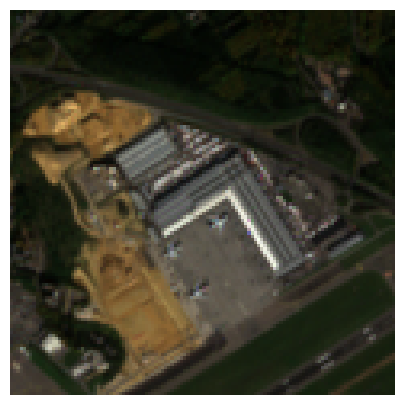


Labels:

- Airports
- Broad-leaved forest
- Discontinuous urban fabric
- Industrial or commercial units

Predictions:

Industrial or commercial units: 33.89%
Sport and leisure facilities: 31.84%
Airports: 31.74%
Construction sites: 31.68%
Dump sites: 30.61%
Mineral extraction sites: 29.59%
Transitional woodland/shrub: 27.98%
Peatbogs: 27.48%
Continuous urban fabric: 27.45%
Complex cultivation patterns: 27.09%
Pastures: 26.89%
Non-irrigated arable land: 26.76%
Discontinuous urban fabric: 26.68%
Vineyards: 26.62%
Port areas: 26.54%
Moors and heathland: 26.52%
Agro-forestry areas: 26.10%
Fruit trees and berry plantations: 26.08%
Salines: 25.99%
Land principally occupied by agriculture, with significant areas of natural vegetation: 25.94%
Salt marshes: 25.73%
Mixed forest: 25.56%
Road and rail networks and associated land: 25.38%
Inland marshes: 25.28%
Annual crops associated with permanent crops: 25.27%
Green urban areas: 25.18%
Bare rock: 25.09%
Rice fields: 24.95%
Burnt areas: 24.90%
P

In [ ]:
# Example with single image

#idx = 0
#image_id = test_df_bigearthnet.iloc[idx].image_id
#f = h5py.File(test_df_bigearthnet.iloc[idx].filename)

image_id = 	'id_441746'
f = h5py.File(test_df_bigearthnet[test_df_bigearthnet.image_id == image_id].filename.item())

print("\nImage:", image_id, "\n")
r = f['04 - Red'][:]    # shape (n, n)
g = f['03 - Green'][:]  # shape (n, n)
b = f['02 - Blue'][:]   # shape (n, n)
rgb_image = np.stack([r, g, b], axis = -1) # shape (n, n, 3)
true_color = normalize(rgb_image)

plt.figure(figsize = (5, 5))
plt.imshow(true_color)
plt.axis('off')
plt.show()

print("\nLabels:\n")
#for l in test_df_bigearthnet.iloc[idx].labels.strip("[]").split(','):
for l in test_df_bigearthnet[test_df_bigearthnet.image_id == image_id].labels.item().strip("[]").split(','):
    print('-', l.strip(" '"))

image = CLIP_preprocess(Image.fromarray((true_color * 255).astype(np.uint8))).unsqueeze(0).to(device)
text = clip.tokenize(['a satellite image of ' + l.lower() for l in bigearthnet_labels]).to(device)


with torch.no_grad():
    image_features = CLIP_model.encode_image(image)
    text_features = CLIP_model.encode_text(text)

image_features /= image_features.norm(dim=-1, keepdim=True)
text_features /= text_features.norm(dim=-1, keepdim=True)
similarity = image_features @ text_features.T
sigmoid = similarity[0].sigmoid()
#softmax = (100.0 * image_features @ text_features.T).softmax(dim=-1)

# Print the result
print("\nPredictions:\n")
for label, prob in sorted(zip(bigearthnet_labels, similarity[0]), key = lambda x: x[1], reverse = True):
    print(f"{label}: {100 * prob:.2f}%")

#### Computing predictions

In [ ]:
add_top_predictions_with_batches_multilabel(
    test_df_bigearthnet,
    CLIP_model,
    CLIP_preprocess,
    device,
    bigearthnet_labels,
    ['04 - Red', '03 - Green', '02 - Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-bigearthnet_predictions_CLIP_RGB.csv')

100%|██████████| 4/4 [02:07<00:00, 31.98s/it]


In [ ]:
output_df_clip_bigearthnet = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/output/m-bigearthnet_predictions_CLIP_RGB.csv')
output_df_clip_bigearthnet.head()

,image_id,filename,bands,split,labels,ground_truth_binary_vector,Agro-forestry_areas_dotprod,Airports_dotprod,Annual_crops_associated_with_permanent_crops_dotprod,Bare_rock_dotprod,...,Sclerophyllous_vegetation_sigmoid,Sea_and_ocean_sigmoid,Sparsely_vegetated_areas_sigmoid,Sport_and_leisure_facilities_sigmoid,Transitional_woodland/shrub_sigmoid,Vineyards_sigmoid,Water_bodies_sigmoid,Water_courses_sigmoid,preds,pred_binary_vector
0,id_427032,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,12,test,"['Complex cultivation patterns', 'Discontinuou...","[0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, ...",0.306396,0.303223,0.284668,0.278320,...,0.570312,0.564453,0.573242,0.569824,0.571289,0.576172,0.569824,0.568359,"['Agro-forestry areas', 'Airports', 'Annual cr...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ..."
1,id_493029,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,12,test,"['Coniferous forest', 'Permanently irrigated l...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, ...",0.326904,0.300781,0.299561,0.314453,...,0.576172,0.566895,0.577637,0.572266,0.579590,0.581543,0.573730,0.573730,"['Agro-forestry areas', 'Airports', 'Annual cr...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ..."
2,id_513633,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,12,test,"['Burnt areas', 'Complex cultivation patterns'...","[0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, ...",0.337402,0.293457,0.303467,0.319824,...,0.578613,0.567871,0.579590,0.573242,0.584473,0.582520,0.575684,0.572266,"['Agro-forestry areas', 'Airports', 'Annual cr...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ..."
3,id_441746,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,12,test,"['Airports', 'Broad-leaved forest', 'Discontin...","[0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, ...",0.260986,0.317627,0.252930,0.250977,...,0.557617,0.554688,0.560547,0.579102,0.569336,0.565918,0.556641,0.559570,"['Agro-forestry areas', 'Airports', 'Annual cr...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ..."
4,id_510900,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,12,test,['Annual crops associated with permanent crops...,"[0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, ...",0.295410,0.278320,0.255859,0.275879,...,0.569336,0.561523,0.569336,0.564941,0.572266,0.571289,0.567383,0.565430,"['Agro-forestry areas', 'Airports', 'Annual cr...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ..."


#### EVALUATION

- View and cite "A Review on Multi-Label Learning Algorithms": https://ieeexplore.ieee.org/document/6471714 capitolo 2.2 Evaluation Metrics:

  2.2.1 Brief Taxonomy
In traditional supervised learning, generalization performance of the learning system is evaluated with conventional metrics such as accuracy, F-measure, area under the ROC curve (AUC), etc. However, performance evaluation in multi-label learning is much complicated than traditional single-label setting, as each example can be associated with multiple labels simultaneously. Therefore, a number of evaluation metrics specific to multi-label learning are proposed, which can be generally categorized into two groups, i.e. example-based metrics [33], [34], [75] and label-based metrics [94].

  CITATION \\

  @ARTICLE{6471714,
    author={Zhang, Min-Ling and Zhou, Zhi-Hua},
    journal={IEEE Transactions on Knowledge and Data Engineering},
    title={A Review on Multi-Label Learning Algorithms},
    year={2014},
    volume={26},
    number={8},
    pages={1819-1837},
    keywords={Training;Correlation;Supervised learning;Semantics;Machine learning algorithms;Algorithm design and analysis;Vectors;Computing Methodologies;Artificial Intelligence;Learning;Information Technology and Systems;Database Management;Database Applications;Data mining;Multi-label learning;label correlations;problem transformation;algorithm adaptation},
    doi={10.1109/TKDE.2013.39}}

  Selected metrics:
  - EXAMPLE-BASED metrics: Recall@k, Precision@k, Hamming Loss (The hamming loss evaluates the fraction of misclassified instance-label pairs, i.e. a relevant label is missed or an irrelevant is predicted)
  - LABEL-BASED metrics: Macro/Micro Averaging a metric (accuracy, precision, recall)


- Precision, Recall, Accuracy, and F1 Score for Multi-Label Classification https://medium.com/synthesio-engineering/precision-accuracy-and-f1-score-for-multi-label-classification-34ac6bdfb404
- Overview of evaluating multi-label classifiers https://towardsdatascience.com/evaluating-multi-label-classifiers-a31be83da6ea/
- Multilabel classification generalities https://medium.com/data-science-in-your-pocket/multi-label-classification-for-beginners-with-codes-6b098cc76f99

In [ ]:
output_df_clip_bigearthnet.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Columns: 137 entries, image_id to pred_binary_vector
dtypes: float64(129), int64(1), object(7)
memory usage: 1.0+ MB


In [ ]:
output_df_clip_bigearthnet.pred_binary_vector.value_counts()

,pred_binary_vector
"[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]",1000


##### $-$ Simple thresholding of sigmoid value at 0.5 $\to$ no good

Not a good metric to use for CLIP in the multilabel case

In [ ]:
# Standard accuracy between whole binary vectors of predictions
from sklearn.metrics import accuracy_score

y_true = output_df_clip_bigearthnet["ground_truth_binary_vector"]
y_pred = output_df_clip_bigearthnet["pred_binary_vector"]

accuracy_score(y_true, y_pred)

0.0

##### $-$ Min-Max Normalization on the Validation Set  $\to$ no good

Min-Max Scaling (or Min-Max Normalization) is one of the simplest methods where the values are scaled to a fixed range — usually 0 to 1. The formula for calculating the Min-Max Scaling is:

$$
X_{norm} = \frac{X - X_{min}}{X_{max} - X_{min}}
$$

NORMALIZATION

- Take min and max of every 'sigmoid' column series in the VALIDATION dataset
- Save those values
- Perform normalization vertically on TEST dataset
- Take sigmoid probs > 0.5 as positive predictions
- Compute accuracy

For more on normalization/scaling techniques:
- [LINK](https://medium.com/@weidagang/demystifying-machine-learning-normalization-0cdb8b281234#:~:text=Min%2DMax%20Scaling%20(or%20Min,values%20in%20the%20feature%2C%20respectively.)

In [ ]:
# Build input dataFrame for VALID images
data = []
split = 'valid'
for img_id in def_partition[split]:
    vector = label_map.get(img_id, None)  # None in case any image is missing in label_map
    labels_idx = [i for i, x in enumerate(label_map[img_id]) if x == 1]
    labels = [bigearthnet_labels[i] for i in labels_idx]
    data.append({
        'image_id': img_id,
        'filename': os.path.join(images_path, img_id + '.hdf5'),
        'bands': len(h5py.File(filename, 'r').keys()),
        'split': split,
        'labels': labels,
        'ground_truth_binary_vector': vector
    })

input_valid_df_bigearthnet = pd.DataFrame(data)
input_valid_df_bigearthnet.head()

,image_id,filename,bands,split,labels,ground_truth_binary_vector
0,id_292562,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,12,valid,"[Coniferous forest, Peatbogs, Transitional woo...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, ..."
1,id_370652,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,12,valid,"[Fruit trees and berry plantations, Industrial...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
2,id_387462,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,12,valid,"[Complex cultivation patterns, Coniferous fore...","[0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, ..."
3,id_362968,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,12,valid,"[Beaches, dunes, sands, Sea and ocean]","[0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
4,id_373535,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,12,valid,"[Continuous urban fabric, Discontinuous urban ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, ..."


In [ ]:
# Save input VALID dataframe to file
input_valid_df_bigearthnet.to_csv('/content/drive/MyDrive/Thesis CLIP4EO/GEO-Bench classification data/valid_df_m-bigearthnet.csv',
                       mode = 'w', index = False, header = True)

In [ ]:
# Load input VALID dataframe from file
input_valid_df_bigearthnet = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/GEO-Bench classification data/valid_df_m-bigearthnet.csv')
input_valid_df_bigearthnet.head()

,image_id,filename,bands,split,labels,ground_truth_binary_vector
0,id_292562,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,12,valid,"['Coniferous forest', 'Peatbogs', 'Transitiona...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, ..."
1,id_370652,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,12,valid,"['Fruit trees and berry plantations', 'Industr...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
2,id_387462,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,12,valid,"['Complex cultivation patterns', 'Coniferous f...","[0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, ..."
3,id_362968,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,12,valid,"['Beaches, dunes, sands', 'Sea and ocean']","[0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
4,id_373535,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,12,valid,"['Continuous urban fabric', 'Discontinuous urb...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, ..."


In [ ]:
# Compute predictions for VALID dataset (needed to get sigmoid min and max)
add_top_predictions_with_batches_multilabel(
    input_valid_df_bigearthnet,
    CLIP_model,
    CLIP_preprocess,
    device,
    bigearthnet_labels,
    ['04 - Red', '03 - Green', '02 - Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-bigearthnet_valid_predictions_CLIP_RGB.csv')

100%|██████████| 4/4 [28:18<00:00, 424.67s/it]


In [ ]:
# Load VALID dataframe from file
output_valid_df = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/output/m-bigearthnet_valid_predictions_CLIP_RGB.csv')
output_valid_df.head()

,image_id,filename,bands,split,labels,ground_truth_binary_vector,Agro-forestry_areas_dotprod,Airports_dotprod,Annual_crops_associated_with_permanent_crops_dotprod,Bare_rock_dotprod,...,Sclerophyllous_vegetation_sigmoid,Sea_and_ocean_sigmoid,Sparsely_vegetated_areas_sigmoid,Sport_and_leisure_facilities_sigmoid,Transitional_woodland/shrub_sigmoid,Vineyards_sigmoid,Water_bodies_sigmoid,Water_courses_sigmoid,preds,pred_binary_vector
0,id_292562,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,12,valid,"['Coniferous forest', 'Peatbogs', 'Transitiona...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, ...",0.329816,0.274368,0.289491,0.310061,...,0.572531,0.559378,0.575541,0.569248,0.583639,0.576333,0.569777,0.569571,"['Agro-forestry areas', 'Airports', 'Annual cr...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ..."
1,id_370652,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,12,valid,"['Fruit trees and berry plantations', 'Industr...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",0.272318,0.280565,0.254881,0.277227,...,0.563469,0.556834,0.565022,0.569586,0.567966,0.571179,0.564683,0.566678,"['Agro-forestry areas', 'Airports', 'Annual cr...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ..."
2,id_387462,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,12,valid,"['Complex cultivation patterns', 'Coniferous f...","[0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, ...",0.324962,0.298684,0.311199,0.314393,...,0.575075,0.568738,0.577889,0.573308,0.578788,0.586014,0.574308,0.572734,"['Agro-forestry areas', 'Airports', 'Annual cr...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ..."
3,id_362968,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,12,valid,"['Beaches, dunes, sands', 'Sea and ocean']","[0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",0.225363,0.225774,0.214664,0.216403,...,0.554333,0.555465,0.551922,0.553708,0.554155,0.554988,0.554990,0.552811,"['Agro-forestry areas', 'Airports', 'Annual cr...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ..."
4,id_373535,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,12,valid,"['Continuous urban fabric', 'Discontinuous urb...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, ...",0.281186,0.300647,0.255240,0.296400,...,0.567996,0.572071,0.570750,0.575633,0.573293,0.571390,0.568999,0.569963,"['Agro-forestry areas', 'Airports', 'Annual cr...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ..."


In [ ]:
def minmax_series_normalization(series):
    return (series - series.min()) / (series.max() - series.min())

cols_to_normalize = [c for c in output_valid_df.columns if 'sigmoid' in c]

#output_valid_df[cols_to_normalize] = output_valid_df[cols_to_normalize].apply(minmax_series_normalization, axis = 0)

In [ ]:
output_valid_df['Airports_sigmoid']

,Airports_sigmoid
0,0.568165
1,0.569685
2,0.574121
3,0.556205
4,0.574601
...,...
995,0.572924
996,0.574269
997,0.571529
998,0.579584


In [ ]:
output_valid_df['Airports_sigmoid'].min(), output_valid_df['Airports_sigmoid'].max()

(0.5507285594940186, 0.5835720896720886)

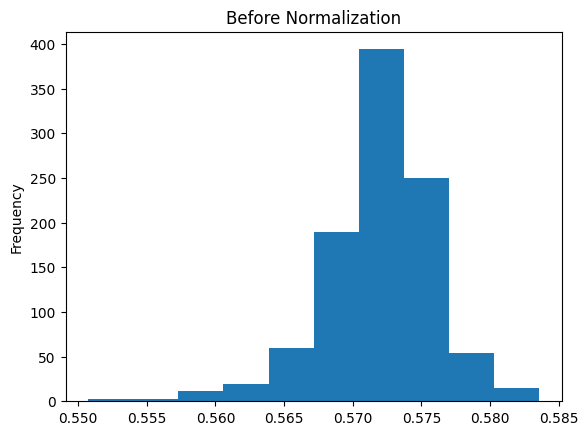

In [ ]:
output_valid_df['Airports_sigmoid'].plot(kind='hist', title="Before Normalization")
plt.show()

In [ ]:
col_normalized = minmax_series_normalization(output_valid_df['Airports_sigmoid'])
#(output_valid_df['Airports_sigmoid'] - output_valid_df['Airports_sigmoid'].min()) / (output_valid_df['Airports_sigmoid'].max() - output_valid_df['Airports_sigmoid'].min())
col_normalized

,Airports_sigmoid
0,0.530889
1,0.577165
2,0.712235
3,0.166743
4,0.726841
...,...
995,0.675781
996,0.716745
997,0.633333
998,0.878566


In [ ]:
# Percentage of rows which are > 0.5 after normalization
(col_normalized[col_normalized > 0.5].count() / col_normalized.shape[0]).item()

0.903

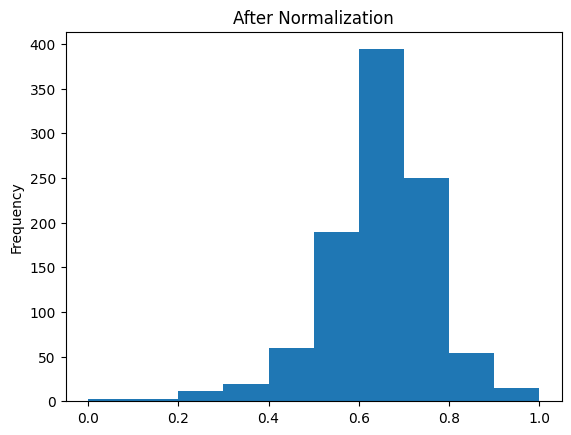

In [ ]:
col_normalized.plot(kind='hist', title="After Normalization")
plt.show()

In [ ]:
# Saving min and max of each column from validation set
valid_minmax_dict = {c : (output_valid_df[c].min(), output_valid_df[c].max()) for c in cols_to_normalize}
valid_minmax_dict

{'Agro-forestry_areas_sigmoid': (0.5524829030036926, 0.5923202037811279),
 'Airports_sigmoid': (0.5507285594940186, 0.5835720896720886),
 'Annual_crops_associated_with_permanent_crops_sigmoid': (0.5470424890518188,
  0.5846953988075256),
 'Bare_rock_sigmoid': (0.549254298210144, 0.5859715938568115),
 'Beaches,_dunes,_sands_sigmoid': (0.5449276566505432, 0.5855874419212341),
 'Broad-leaved_forest_sigmoid': (0.5493900179862976, 0.5896456837654114),
 'Burnt_areas_sigmoid': (0.5426188707351685, 0.5836857557296753),
 'Coastal_lagoons_sigmoid': (0.5455604195594788, 0.5851953029632568),
 'Complex_cultivation_patterns_sigmoid': (0.5490568280220032,
  0.5873116254806519),
 'Coniferous_forest_sigmoid': (0.5485029816627502, 0.5919470191001892),
 'Construction_sites_sigmoid': (0.5494691729545593, 0.5837090611457825),
 'Continuous_urban_fabric_sigmoid': (0.553856372833252, 0.5849589705467224),
 'Discontinuous_urban_fabric_sigmoid': (0.5555701851844788,
  0.5827062129974365),
 'Dump_sites_sigmoid': 

In [ ]:
output_df_clip_bigearthnet[cols_to_normalize]

,Agro-forestry_areas_sigmoid,Airports_sigmoid,Annual_crops_associated_with_permanent_crops_sigmoid,Bare_rock_sigmoid,"Beaches,_dunes,_sands_sigmoid",Broad-leaved_forest_sigmoid,Burnt_areas_sigmoid,Coastal_lagoons_sigmoid,Complex_cultivation_patterns_sigmoid,Coniferous_forest_sigmoid,...,Salines_sigmoid,Salt_marshes_sigmoid,Sclerophyllous_vegetation_sigmoid,Sea_and_ocean_sigmoid,Sparsely_vegetated_areas_sigmoid,Sport_and_leisure_facilities_sigmoid,Transitional_woodland/shrub_sigmoid,Vineyards_sigmoid,Water_bodies_sigmoid,Water_courses_sigmoid
0,0.576172,0.575195,0.570801,0.569336,0.566895,0.568359,0.572266,0.566895,0.571289,0.569824,...,0.572266,0.574219,0.570312,0.564453,0.573242,0.569824,0.571289,0.576172,0.569824,0.568359
1,0.581055,0.574707,0.574219,0.578125,0.573242,0.575684,0.579590,0.571777,0.577148,0.573730,...,0.578613,0.577148,0.576172,0.566895,0.577637,0.572266,0.579590,0.581543,0.573730,0.573730
2,0.583496,0.572754,0.575195,0.579102,0.571289,0.582520,0.575195,0.576660,0.577637,0.581543,...,0.581055,0.582520,0.578613,0.567871,0.579590,0.573242,0.584473,0.582520,0.575684,0.572266
3,0.564941,0.578613,0.562988,0.562500,0.554688,0.561523,0.562012,0.560547,0.567383,0.560059,...,0.564453,0.563965,0.557617,0.554688,0.560547,0.579102,0.569336,0.565918,0.556641,0.559570
4,0.573242,0.569336,0.563477,0.568359,0.562988,0.568359,0.570801,0.564453,0.564453,0.571289,...,0.566895,0.570801,0.569336,0.561523,0.569336,0.564941,0.572266,0.571289,0.567383,0.565430
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,0.575195,0.575195,0.573730,0.567383,0.562500,0.566895,0.568359,0.563965,0.571777,0.566406,...,0.572266,0.571777,0.567871,0.562012,0.571289,0.573242,0.571777,0.578125,0.566895,0.568359
996,0.578613,0.576660,0.569824,0.576172,0.573730,0.574219,0.575195,0.580078,0.572754,0.574707,...,0.581543,0.583984,0.573730,0.571777,0.576172,0.571777,0.578125,0.577637,0.576172,0.575684
997,0.564941,0.568848,0.565918,0.567383,0.561523,0.565430,0.559082,0.565430,0.562012,0.568848,...,0.568359,0.567383,0.568359,0.570312,0.563965,0.565918,0.568848,0.566406,0.566406,0.562012
998,0.573242,0.570801,0.569824,0.564453,0.556641,0.561035,0.565430,0.563965,0.568848,0.560059,...,0.570312,0.570312,0.560547,0.557617,0.566406,0.569824,0.567871,0.571289,0.566406,0.565918


In [ ]:
def plot_sigmoid_distributions(df, sigmoid_columns, output_path = None):

    rows = 7
    cols = 7
    fig, axes = plt.subplots(rows, cols, figsize = (20, 15))
    axes = axes.flatten()

    for i, col in enumerate(sigmoid_columns):
        ax = axes[i]
        df[col].plot(kind = 'hist', ax = ax, title = (' '.join(col.split('_')[:-1])).replace(',', '\n'), fontsize = 8)
        ax.set_xlabel("")
        ax.set_ylabel("")

    # hide remaining empty subplots
    for j in range(i + 1, len(axes)):
        axes[j].axis('off')

    plt.tight_layout()
    if output_path:
        plt.savefig(output_path)
    plt.show()

    return

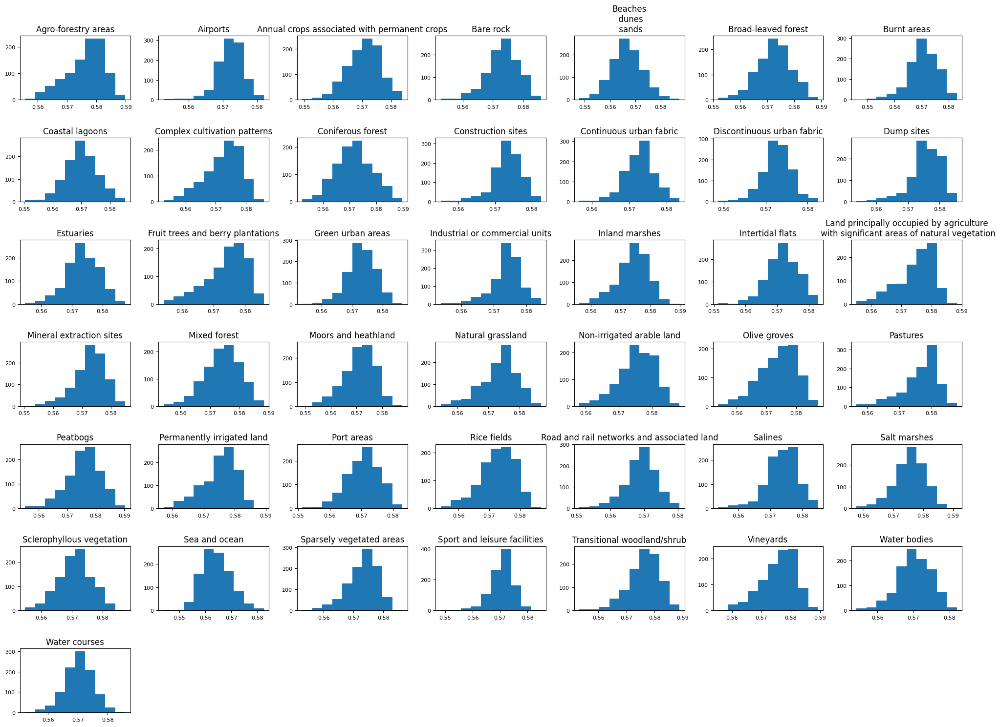

In [ ]:
plot_sigmoid_distributions(output_df_clip_bigearthnet,
                           cols_to_normalize,
                           '/content/drive/MyDrive/Thesis CLIP4EO/GEO-Bench classification data/m-bigearthnet_sigmoid_actual.png')

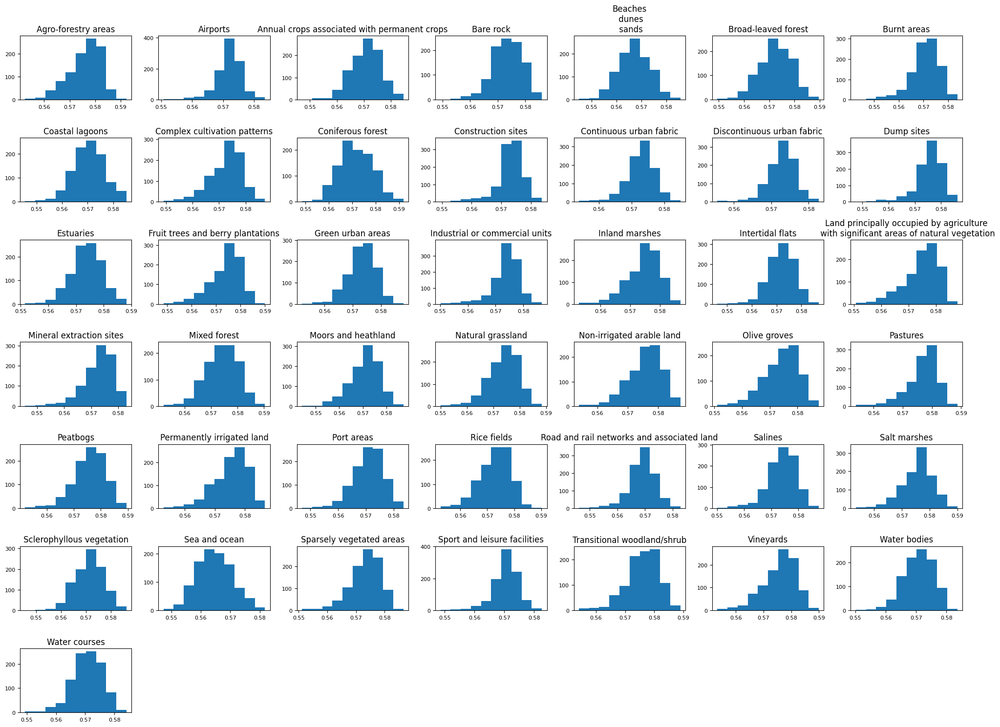

In [ ]:
# See if validation sigmoids have the same distribution more or less
plot_sigmoid_distributions(output_valid_df,
                           cols_to_normalize)

In [ ]:
def normalize_df_cols(df, cols, mm_dict):

    for c in df[cols]:
        min = mm_dict[c][0]
        max = mm_dict[c][1]
        df[c] = (df[c] - min) / (max - min)

    return

In [ ]:
# Normalize output TEST dataset with VALID mins/maxes
normalize_df_cols(output_df_clip_bigearthnet, cols_to_normalize, valid_minmax_dict)

In [ ]:
output_df_clip_bigearthnet[cols_to_normalize].head()

,Agro-forestry_areas_sigmoid,Airports_sigmoid,Annual_crops_associated_with_permanent_crops_sigmoid,Bare_rock_sigmoid,"Beaches,_dunes,_sands_sigmoid",Broad-leaved_forest_sigmoid,Burnt_areas_sigmoid,Coastal_lagoons_sigmoid,Complex_cultivation_patterns_sigmoid,Coniferous_forest_sigmoid,...,Salines_sigmoid,Salt_marshes_sigmoid,Sclerophyllous_vegetation_sigmoid,Sea_and_ocean_sigmoid,Sparsely_vegetated_areas_sigmoid,Sport_and_leisure_facilities_sigmoid,Transitional_woodland/shrub_sigmoid,Vineyards_sigmoid,Water_bodies_sigmoid,Water_courses_sigmoid
0,0.594643,0.744949,0.630982,0.546926,0.540260,0.471222,0.721914,0.538266,0.581162,0.490775,...,0.591711,0.569415,0.607174,0.496438,0.623522,0.624664,0.492694,0.623471,0.588970,0.545770
1,0.717212,0.730082,0.721757,0.786297,0.696377,0.653165,0.900262,0.661461,0.734329,0.580689,...,0.761465,0.649375,0.750750,0.567299,0.747719,0.696267,0.731380,0.769831,0.705714,0.700569
2,0.778496,0.670614,0.747693,0.812894,0.648341,0.822978,0.793253,0.784656,0.747093,0.760518,...,0.826755,0.795967,0.810574,0.595643,0.802917,0.724908,0.871784,0.796442,0.764086,0.658351
3,0.312735,0.849017,0.423494,0.360748,0.240037,0.301409,0.472226,0.378113,0.479051,0.265988,...,0.382783,0.289558,0.296091,0.212995,0.264732,0.896755,0.436532,0.344056,0.194959,0.292463
4,0.521102,0.566546,0.436462,0.520329,0.444189,0.471222,0.686244,0.476669,0.402467,0.524493,...,0.448073,0.476130,0.583244,0.411405,0.513125,0.481459,0.520774,0.490416,0.516005,0.461335


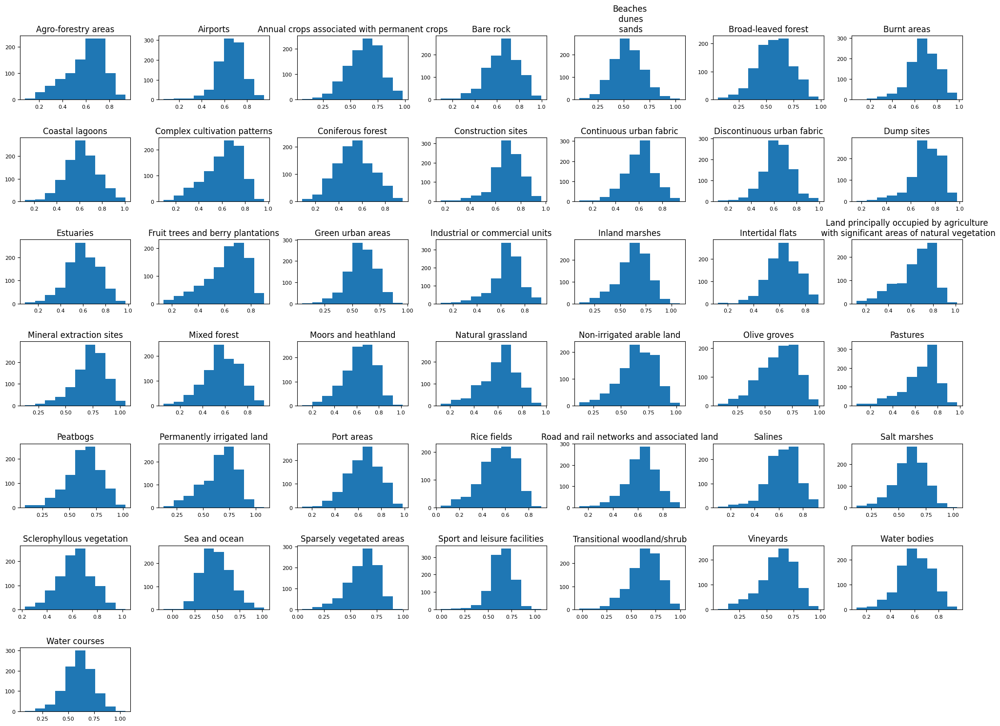

In [ ]:
plot_sigmoid_distributions(output_df_clip_bigearthnet,
                           cols_to_normalize,
                           '/content/drive/MyDrive/Thesis CLIP4EO/GEO-Bench classification data/m-bigearthnet_sigmoid_normalized.png')

In [ ]:
output_df_clip_bigearthnet.head()

,image_id,filename,bands,split,labels,ground_truth_binary_vector,Agro-forestry_areas_dotprod,Airports_dotprod,Annual_crops_associated_with_permanent_crops_dotprod,Bare_rock_dotprod,...,Sclerophyllous_vegetation_sigmoid,Sea_and_ocean_sigmoid,Sparsely_vegetated_areas_sigmoid,Sport_and_leisure_facilities_sigmoid,Transitional_woodland/shrub_sigmoid,Vineyards_sigmoid,Water_bodies_sigmoid,Water_courses_sigmoid,preds,pred_binary_vector
0,id_427032,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,12,test,"['Complex cultivation patterns', 'Discontinuou...","[0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, ...",0.306396,0.303223,0.284668,0.278320,...,0.607174,0.496438,0.623522,0.624664,0.492694,0.623471,0.588970,0.545770,"['Agro-forestry areas', 'Airports', 'Annual cr...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ..."
1,id_493029,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,12,test,"['Coniferous forest', 'Permanently irrigated l...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, ...",0.326904,0.300781,0.299561,0.314453,...,0.750750,0.567299,0.747719,0.696267,0.731380,0.769831,0.705714,0.700569,"['Agro-forestry areas', 'Airports', 'Annual cr...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ..."
2,id_513633,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,12,test,"['Burnt areas', 'Complex cultivation patterns'...","[0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, ...",0.337402,0.293457,0.303467,0.319824,...,0.810574,0.595643,0.802917,0.724908,0.871784,0.796442,0.764086,0.658351,"['Agro-forestry areas', 'Airports', 'Annual cr...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ..."
3,id_441746,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,12,test,"['Airports', 'Broad-leaved forest', 'Discontin...","[0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, ...",0.260986,0.317627,0.252930,0.250977,...,0.296091,0.212995,0.264732,0.896755,0.436532,0.344056,0.194959,0.292463,"['Agro-forestry areas', 'Airports', 'Annual cr...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ..."
4,id_510900,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,12,test,['Annual crops associated with permanent crops...,"[0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, ...",0.295410,0.278320,0.255859,0.275879,...,0.583244,0.411405,0.513125,0.481459,0.520774,0.490416,0.516005,0.461335,"['Agro-forestry areas', 'Airports', 'Annual cr...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ..."


In [ ]:
# Apply threshold > 0.5 to create binary vectors
output_df_clip_bigearthnet['minmaxval_binary_vector'] = output_df_clip_bigearthnet[cols_to_normalize].gt(0.5).astype(int).values.tolist()

In [ ]:
output_df_clip_bigearthnet['minmaxval_binary_vector'].value_counts()

,minmaxval_binary_vector
"[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]",251
"[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]",93
"[1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]",56
"[1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]",25
"[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]",19
...,...
"[1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]",1
"[0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]",1
"[0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]",1
"[0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]",1


In [ ]:
# Save and read from temporary file
output_df_clip_bigearthnet.to_csv('/content/m-bigearthnet_minmaxval_predictions_CLIP_RGB.csv', mode = 'w', index = False, header = True)
output_df_clip_bigearthnet = pd.read_csv('/content/m-bigearthnet_minmaxval_predictions_CLIP_RGB.csv')

In [ ]:
y_true = output_df_clip_bigearthnet["ground_truth_binary_vector"]
y_pred = output_df_clip_bigearthnet["minmaxval_binary_vector"]

accuracy_score(y_true, y_pred)

0.003

Again, this method doesn't prove good enough to assess performance

##### $-$ Hamming Loss $\to$ based on sigmoid thresholds, no good by itself

**Hamming Loss**: the fraction of incorrect labels (either wrongly predicted as present or wrongly missed) over the total number of labels of a data sample. In multilabel classification, it penalizes both false positives and false negatives.

In [ ]:
# Compute Hamming Loss
from sklearn.metrics import hamming_loss

y_true = output_df_clip_bigearthnet["ground_truth_binary_vector"]
y_pred = output_df_clip_bigearthnet["pred_binary_vector"]

hloss = hamming_loss(y_true, y_pred)
print(f"Hamming Loss: {hloss:.4f}")

Hamming Loss: 1.0000


##### $-$ Tresholding with average similarity value (MS-CLIP approach)  $\to$ TODO

Idea taken from the paper introducing MS-CLIP, [Beyond the Visible: Multispectral Vision-Language Learning for Earth Observation](https://arxiv.org/pdf/2503.15969). Evaluation paragraph, page 8:

- For the multi-label dataset **BigEarthNet**, we transform each class into a binary classification task. For each class, <u>we calculate the similarity between the image embedding and the respective text embedding of that class and compare it to the mean similarity between the image and the all other classes</u>, as formulated in Equation 2. Here, $\hat{y_i}$ is the predicted label for class $i$, $x$ is the image
embedding, $c_i$ is the class embedding, $sim(\cdot, \cdot)$ is the dot-product similarity, and $K$ is the total number of classes. We also compare this method to a negative class approach (e.g., "other features"), which boosts accuracy but substantially lowers recall and the F1 score (results in the supplementary material).

- In BigEarthNet's multi-label scenario, our approach tends to produce numerous false positives. However, these misclassifications are usually semantically correlated (e.g., inland waters or beaches predictions for marine waters). Introducing an extra negative class (other features) mitigates false positives but leads to much more false negatives. This results in higher accuracy overall, but the F1 score drops for six of the seven models. Since F1 reflects both precision and recall, we report the original method here and the alternative strategy in the
supplementary material. In both cases, MS-CLIP achieves the highest F1 and significantly outperforms five other models in accuracy.


##### $-$ Better metrics: Recall@k, Precision@k, Average Precision, Ranking Loss, Micro/Macro F1

Precision, Recall and F1-score at $k$ are key metrics that help in understanding how well a recommender or information retrieval system is performing. Specifically, these metrics provide insights into the quality of the top $k$ recommendations. In the case of CLIP, the ranking is done according to the output similarity.

- **Recall@k**: measures the ability to identify all relevant items within the top K recommendations. It focuses on retrieving relevant labels within the given k, i.e. the comprehensiveness of predictions.

  $$
  \text{Recall@k} = \frac{\text{Number of correct predictions in top-k}}{\text{Number of ground truth labels}}
  $$

- **Precision@k**: proportion of correct predictions among the top k. It focuses on the quality of the top k predictions.

  $$
  \text{Precision@k} = \frac{\text{Number of correct predictions in top-k}}{\text{k}}
  $$

- **mAP (Mean Average Precision)**: average precision (AP) measures the area under the Precision-Recall curve for a single sample. mAP simply is the mean of APs across all samples. Higher AP = better label ranking per image, so it focuses on retrieving correct labels earlier in the ranked list. The higher this metric, the better. The average precision evaluates the average fraction of relevant labels ranked higher than a particular label $y \in Y_i$

(insert formula from https://scikit-learn.org/stable/modules/generated/sklearn.metrics.average_precision_score.html)

- **Ranking Loss**: evaluates the fraction of reversely ordered label pairs, i.e. an irrelevant label is ranked higher than a relevant label. Lower is better. Specifically:
  - A value of 0 means perfect ranking (all relevant labels ranked higher than irrelevant ones).
  - A value of 0.5 suggests random ranking.
  - A value > 0.5 is worse than random (unlikely in practice with a trained model).

- **Micro/Macro F1**: given the standard definition for F1 score, Macro F1 averages F1 across all labels (treats each label equally) while Micro F1 computes global TP, FP, FN across all labels before computing F1 (treats each instance equally). This is in fact different: macro focuses on the performance on single labels, while micro looks at the overall performance. They are also sensitive metrics, respectively to rare labels and label imbalance / dominant labels. So:
  - Use Macro if we care about performance across all labels, regardless of how often they occur.
  - Use Micro if we care about overall prediction accuracy, especially with many examples or dominant labels.

In [ ]:
# Computing mAP
def unpack_binary_vector(str_vec):
    return [int(x.strip("' ")) for x in str_vec.strip("[]").split(",")]

def prepare_predictions_and_targets(df, columns):
    gt_vectors = list(map(unpack_binary_vector, df['ground_truth_binary_vector'].tolist()))
    y_true = np.array(gt_vectors)
    y_scores = np.array([
        [row[col] for col in columns]
        for _, row in df.iterrows()
    ])
    return y_true, y_scores

def compute_mAP(df):
    similarity_cols = [c for c in df.columns if 'dotprod' in c]
    y_true, y_scores = prepare_predictions_and_targets(df, similarity_cols)
    mAP_score = average_precision_score(y_true, y_scores, average = 'samples')
    return mAP_score

# Computing Ranking Loss
def compute_ranking_loss(df):
    gt_vectors = list(map(unpack_binary_vector, df['ground_truth_binary_vector'].tolist()))
    y_true = np.array(gt_vectors)
    similarity_cols = [c for c in df.columns if 'dotprod' in c]
    y_scores = df[similarity_cols].to_numpy()
    return label_ranking_loss(y_true, y_scores)

# Computing micro/macro F1 - sigmoid scores with fixed threshold at 0.5
def compute_f1_scores(df, threshold=0.5):
    gt_vectors = list(map(unpack_binary_vector, df['ground_truth_binary_vector'].tolist()))
    y_true = np.array(gt_vectors)
    sigmoid_cols = [c for c in df.columns if 'sigmoid' in c]
    y_scores = df[sigmoid_cols].to_numpy()
    y_pred = (y_scores >= threshold).astype(int) # these are all 1s!

    macro_f1 = f1_score(y_true, y_pred, average='macro')
    micro_f1 = f1_score(y_true, y_pred, average='micro')
    return macro_f1, micro_f1


# Computing micro/macro F1 - sigmoid scores with adaptive thresholds
def compute_f1_scores_adaptive(df):
    gt_vectors = list(map(unpack_binary_vector, df['ground_truth_binary_vector'].tolist()))
    y_true = np.array(gt_vectors)
    similarity_cols = [c for c in df.columns if 'dotprod' in c]
    y_scores = df[similarity_cols].to_numpy()
    thresholds = np.median(y_scores, axis = 0)  # or np.mean (slightly different from the 5th decimal digit)
    y_pred = (y_scores >= thresholds).astype(int)

    macro_f1 = f1_score(y_true, y_pred, average='macro')
    micro_f1 = f1_score(y_true, y_pred, average='micro')

    return macro_f1, micro_f1

In [ ]:
# Computing Recall@K
recall_at_3 = compute_recall_at_k(output_df_clip_bigearthnet, k=3)
recall_at_5 = compute_recall_at_k(output_df_clip_bigearthnet, k=5)
recall_at_10 = compute_recall_at_k(output_df_clip_bigearthnet, k=10)

print(f"Recall@3: {recall_at_3:.4f}")
print(f"Recall@5: {recall_at_5:.4f}")
print(f"Recall@10: {recall_at_10:.4f}")

# Computing Precision@k
precision_at_3 = compute_precision_at_k(output_df_clip_bigearthnet, k=3)
precision_at_5 = compute_precision_at_k(output_df_clip_bigearthnet, k=5)
precision_at_10 = compute_precision_at_k(output_df_clip_bigearthnet, k=10)

print(f"Precision@3: {precision_at_3:.4f}")
print(f"Precision@5: {precision_at_5:.4f}")
print(f"Precision@10: {precision_at_10:.4f}")
print()
print(f"Mean Average Precision (mAP): {compute_mAP(output_df_clip_bigearthnet):.4f}")
print()
rloss = compute_ranking_loss(output_df_clip_bigearthnet)
print(f"Ranking Loss: {rloss:.4f}")

Recall@3: 0.2142
Recall@5: 0.3170
Recall@10: 0.5139


In [ ]:
macro_f1, micro_f1 = compute_f1_scores(output_df_clip_bigearthnet)

print(f"Macro F1 Score: {macro_f1:.4f}")
print(f"Micro F1 Score: {micro_f1:.4f}")

Macro F1 Score: 0.1562
Micro F1 Score: 0.1665


In [ ]:
macro_f1, micro_f1 = compute_f1_scores_adaptive(output_df_clip_bigearthnet)

print(f"Macro F1 Score: {macro_f1:.4f}")
print(f"Micro F1 Score: {micro_f1:.4f}")

Macro F1 Score: 0.1851
Micro F1 Score: 0.2039


In [ ]:
rloss = compute_ranking_loss(output_df_clip_bigearthnet)
print(f"Ranking Loss: {rloss:.4f}")

Ranking Loss: 0.2871


## Loading RemoteCLIP

A CLIP-based foundation model for Remote Sensing (presented in 2023, revised in 2024).

- Loading the model

In [ ]:
%%capture
!pip install open-clip-torch

In [ ]:
import random
import torch, open_clip
from PIL import Image
import matplotlib.pyplot as plt
from huggingface_hub import hf_hub_download

# Selecting device
device = "cuda" if torch.cuda.is_available() else "cpu"
print("device:", device)

# Download model checkpoint
model_name = 'ViT-B-32' # or 'RN50' or 'ViT-L-14'
checkpoint_path = hf_hub_download("chendelong/RemoteCLIP", f"RemoteCLIP-{model_name}.pt", cache_dir = 'checkpoints')
print(f'RemoteCLIP-{model_name} is downloaded to {checkpoint_path}.')

# Loading the RemoteCLIP model
RemoteCLIP_model, _, RemoteCLIP_preprocess = open_clip.create_model_and_transforms(model_name)
tokenizer = open_clip.get_tokenizer(model_name)

ckpt = torch.load(f"checkpoints/models--chendelong--RemoteCLIP/snapshots/bf1d8a3ccf2ddbf7c875705e46373bfe542bce38/RemoteCLIP-ViT-B-32.pt", map_location = "cpu")
message = RemoteCLIP_model.load_state_dict(ckpt)
print(message)

RemoteCLIP_model = RemoteCLIP_model.to(device).eval()

device: cpu


RemoteCLIP-ViT-B-32.pt:   0%|          | 0.00/605M [00:00<?, ?B/s]

RemoteCLIP-ViT-B-32 is downloaded to checkpoints/models--chendelong--RemoteCLIP/snapshots/bf1d8a3ccf2ddbf7c875705e46373bfe542bce38/RemoteCLIP-ViT-B-32.pt.
<All keys matched successfully>


### 1) m-brick-kiln

In [ ]:
add_top_predictions_with_batches_RemoteCLIP(
    test_df_brickkiln,
    RemoteCLIP_model,
    RemoteCLIP_preprocess,
    device,
    brickkiln_labels,  # original labels
    ['04 - Red', '03 - Green', '02 - Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-brick-kiln_predictions_RemoteCLIP_RGB.csv',
    tokenizer)

100%|██████████| 4/4 [09:45<00:00, 146.33s/it]


In [ ]:
output_df_remoteclip = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/output/m-brick-kiln_predictions_RemoteCLIP_RGB.csv')
output_df_remoteclip.head()

,image_id,filename,bands,split,label,not_brick_kiln_dotprod,brick_kiln_dotprod,not_brick_kiln_softmax,brick_kiln_softmax,not_brick_kiln_sigmoid,brick_kiln_sigmoid,pred
0,examples_36_950,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.224720,0.222654,0.551465,0.448535,0.555945,0.555435,not brick kiln
1,examples_79_331,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,not brick kiln,0.197819,0.189543,0.695834,0.304166,0.549294,0.547244,not brick kiln
2,examples_29_266,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.238752,0.236057,0.566964,0.433036,0.559406,0.558742,not brick kiln
3,examples_20_682,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,not brick kiln,0.218228,0.216190,0.550779,0.449221,0.554342,0.553838,not brick kiln
4,examples_63_819,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.213778,0.202791,0.750018,0.249982,0.553242,0.550525,not brick kiln


In [ ]:
output_df_remoteclip.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 999 entries, 0 to 998
Data columns (total 12 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   image_id                999 non-null    object 
 1   filename                999 non-null    object 
 2   bands                   999 non-null    int64  
 3   split                   999 non-null    object 
 4   label                   999 non-null    object 
 5   not_brick_kiln_dotprod  999 non-null    float64
 6   brick_kiln_dotprod      999 non-null    float64
 7   not_brick_kiln_softmax  999 non-null    float64
 8   brick_kiln_softmax      999 non-null    float64
 9   not_brick_kiln_sigmoid  999 non-null    float64
 10  brick_kiln_sigmoid      999 non-null    float64
 11  pred                    999 non-null    object 
dtypes: float64(6), int64(1), object(5)
memory usage: 93.8+ KB


In [ ]:
output_df_remoteclip.pred.value_counts()

,pred
not brick kiln,993
brick kiln,6


In [ ]:
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
import plotly.express as px

labels = output_df_remoteclip['label'].unique()
y_true = output_df_remoteclip["label"]
y_pred = output_df_remoteclip["pred"]

classification_report_and_cm(y_true, y_pred, labels)


Classification Report:

                precision    recall  f1-score   support

    brick kiln     1.0000    0.0179    0.0351       336
not brick kiln     0.6677    1.0000    0.8007       663

      accuracy                         0.6697       999
     macro avg     0.8338    0.5089    0.4179       999
  weighted avg     0.7794    0.6697    0.5432       999


Accuracy: 0.6697

Confusion matrix:

[[  6 330]
 [  0 663]]



In [ ]:
# AUC
# Binary: convert true_label to 0/1
output_df_remoteclip["true_binary"] = output_df_remoteclip["label"].map({"not brick kiln": 0, "brick kiln": 1})
y_true = output_df_remoteclip["true_binary"]
y_scores = output_df_remoteclip["brick_kiln_softmax"]

plot_auc(y_true, y_scores)

### m-brick-kiln (alt labels 1)

In [ ]:
# 1st set of alternative labels

custom_labels = ['other landscape',               # negative class
                 'a brick kiln construction']     # positive class

add_top_predictions_with_batches_RemoteCLIP(
    test_df_brickkiln,
    RemoteCLIP_model,
    RemoteCLIP_preprocess,
    device,
    custom_labels,
    ['04 - Red', '03 - Green', '02 - Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-brick-kiln_predictions_RemoteCLIP_RGB_alt1.csv',
    tokenizer)

100%|██████████| 4/4 [09:13<00:00, 138.41s/it]


In [ ]:
output_df_remoteclip1 = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/output/m-brick-kiln_predictions_RemoteCLIP_RGB_alt1.csv')
output_df_remoteclip1.head()

,image_id,filename,bands,split,label,other_landscape_dotprod,a_brick_kiln_construction_dotprod,other_landscape_softmax,a_brick_kiln_construction_softmax,other_landscape_sigmoid,a_brick_kiln_construction_sigmoid,pred
0,examples_36_950,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.246563,0.214071,0.962643,0.037357,0.561330,0.553314,other landscape
1,examples_79_331,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,not brick kiln,0.236575,0.179116,0.996814,0.003186,0.558869,0.544660,other landscape
2,examples_29_266,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.249282,0.232693,0.840087,0.159913,0.562000,0.557912,other landscape
3,examples_20_682,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,not brick kiln,0.226045,0.207538,0.864207,0.135793,0.556272,0.551699,other landscape
4,examples_63_819,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.224602,0.204573,0.881100,0.118900,0.555916,0.550966,other landscape


In [ ]:
output_df_remoteclip1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 999 entries, 0 to 998
Data columns (total 12 columns):
 #   Column                             Non-Null Count  Dtype  
---  ------                             --------------  -----  
 0   image_id                           999 non-null    object 
 1   filename                           999 non-null    object 
 2   bands                              999 non-null    int64  
 3   split                              999 non-null    object 
 4   label                              999 non-null    object 
 5   other_landscape_dotprod            999 non-null    float64
 6   a_brick_kiln_construction_dotprod  999 non-null    float64
 7   other_landscape_softmax            999 non-null    float64
 8   a_brick_kiln_construction_softmax  999 non-null    float64
 9   other_landscape_sigmoid            999 non-null    float64
 10  a_brick_kiln_construction_sigmoid  999 non-null    float64
 11  pred                               999 non-null    object 

In [ ]:
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
import plotly.express as px

labels = output_df_remoteclip1['label'].unique()
y_true = output_df_remoteclip1["label"]
y_pred = output_df_remoteclip1["pred"].map({"other landscape": "not brick kiln",
                                            "a brick kiln construction": "brick kiln"})

classification_report_and_cm(y_true, y_pred, labels)


Classification Report:

                precision    recall  f1-score   support

    brick kiln     1.0000    0.0119    0.0235       336
not brick kiln     0.6663    1.0000    0.7998       663

      accuracy                         0.6677       999
     macro avg     0.8332    0.5060    0.4116       999
  weighted avg     0.7786    0.6677    0.5387       999


Accuracy: 0.6677

Confusion matrix:

[[  4 332]
 [  0 663]]



In [ ]:
# AUC
# Binary: convert true_label to 0/1
output_df_remoteclip1["true_binary"] = output_df_remoteclip1["label"].map({"not brick kiln": 0, "brick kiln": 1})
y_true = output_df_remoteclip1["true_binary"]
y_scores = output_df_remoteclip1["a_brick_kiln_construction_softmax"]

plot_auc(y_true, y_scores)

### m-brick-kiln (alt labels 2)



In [ ]:
# Use best-performing prompts based on CLIP experiments
custom_labels = ['some landscape',                # negative class
                 'a brick kiln construction']     # positive class

add_top_predictions_with_batches_RemoteCLIP(
    test_df_brickkiln,
    RemoteCLIP_model,
    RemoteCLIP_preprocess,
    device,
    custom_labels,
    ['04 - Red', '03 - Green', '02 - Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-brick-kiln_predictions_RemoteCLIP_RGB_alt2.csv',
    tokenizer)

100%|██████████| 4/4 [08:30<00:00, 127.55s/it]


In [ ]:
output_df_remoteclip2 = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/output/m-brick-kiln_predictions_RemoteCLIP_RGB_alt2.csv')
output_df_remoteclip2.head()

,image_id,filename,bands,split,label,some_landscape_dotprod,a_brick_kiln_construction_dotprod,some_landscape_softmax,a_brick_kiln_construction_softmax,some_landscape_sigmoid,a_brick_kiln_construction_sigmoid,pred
0,examples_36_950,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.243132,0.214071,0.948145,0.051855,0.560485,0.553314,some landscape
1,examples_79_331,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,not brick kiln,0.227819,0.179116,0.992387,0.007613,0.556710,0.544660,some landscape
2,examples_29_266,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.251225,0.232693,0.864500,0.135500,0.562478,0.557912,some landscape
3,examples_20_682,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,not brick kiln,0.227616,0.207538,0.881621,0.118379,0.556660,0.551699,some landscape
4,examples_63_819,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.224105,0.204573,0.875794,0.124206,0.555793,0.550966,some landscape


In [ ]:
output_df_remoteclip2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 999 entries, 0 to 998
Data columns (total 12 columns):
 #   Column                             Non-Null Count  Dtype  
---  ------                             --------------  -----  
 0   image_id                           999 non-null    object 
 1   filename                           999 non-null    object 
 2   bands                              999 non-null    int64  
 3   split                              999 non-null    object 
 4   label                              999 non-null    object 
 5   some_landscape_dotprod             999 non-null    float64
 6   a_brick_kiln_construction_dotprod  999 non-null    float64
 7   some_landscape_softmax             999 non-null    float64
 8   a_brick_kiln_construction_softmax  999 non-null    float64
 9   some_landscape_sigmoid             999 non-null    float64
 10  a_brick_kiln_construction_sigmoid  999 non-null    float64
 11  pred                               999 non-null    object 

In [ ]:
output_df_remoteclip2.pred.value_counts()

,pred
some landscape,991
a brick kiln construction,8


In [ ]:
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
import plotly.express as px

labels = output_df_remoteclip2['label'].unique()
y_true = output_df_remoteclip2["label"]
y_pred = output_df_remoteclip2["pred"].map({"some landscape": "not brick kiln",
                                            "a brick kiln construction": "brick kiln"})

classification_report_and_cm(y_true, y_pred, labels)


Classification Report:

                precision    recall  f1-score   support

    brick kiln     0.7500    0.0179    0.0349       336
not brick kiln     0.6670    0.9970    0.7993       663

      accuracy                         0.6677       999
     macro avg     0.7085    0.5074    0.4171       999
  weighted avg     0.6949    0.6677    0.5422       999


Accuracy: 0.6677

Confusion matrix:

[[  6 330]
 [  2 661]]



In [ ]:
# AUC
# Binary: convert true_label to 0/1
output_df_remoteclip2["true_binary"] = output_df_remoteclip2["label"].map({"not brick kiln": 0, "brick kiln": 1})
y_true = output_df_remoteclip2["true_binary"]
y_scores = output_df_remoteclip2["a_brick_kiln_construction_softmax"]

plot_auc(y_true, y_scores)

### m-brick-kiln (alt labels 3)

In [ ]:
# 3rd set of alternative labels

custom_labels = ['some other landscape',          # negative class
                 'a brick kiln construction']     # positive class

add_top_predictions_with_batches_RemoteCLIP(
    test_df_brickkiln,
    RemoteCLIP_model,
    RemoteCLIP_preprocess,
    device,
    custom_labels,
    ['04 - Red', '03 - Green', '02 - Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-brick-kiln_predictions_RemoteCLIP_RGB_alt3.csv',
    tokenizer)

100%|██████████| 4/4 [08:35<00:00, 128.94s/it]


In [ ]:
output_df_remoteclip3 = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/output/m-brick-kiln_predictions_RemoteCLIP_RGB_alt3.csv')
output_df_remoteclip3.head()

,image_id,filename,bands,split,label,some_other_landscape_dotprod,a_brick_kiln_construction_dotprod,some_other_landscape_softmax,a_brick_kiln_construction_softmax,some_other_landscape_sigmoid,a_brick_kiln_construction_sigmoid,pred
0,examples_36_950,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.242290,0.214071,0.943844,0.056156,0.560278,0.553314,some other landscape
1,examples_79_331,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,not brick kiln,0.227154,0.179116,0.991868,0.008132,0.556546,0.544660,some other landscape
2,examples_29_266,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.247305,0.232693,0.811716,0.188284,0.561513,0.557912,some other landscape
3,examples_20_682,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,not brick kiln,0.222432,0.207538,0.815989,0.184011,0.555380,0.551699,some other landscape
4,examples_63_819,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.223798,0.204573,0.872411,0.127589,0.555717,0.550966,some other landscape


In [ ]:
output_df_remoteclip3.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 999 entries, 0 to 998
Data columns (total 12 columns):
 #   Column                             Non-Null Count  Dtype  
---  ------                             --------------  -----  
 0   image_id                           999 non-null    object 
 1   filename                           999 non-null    object 
 2   bands                              999 non-null    int64  
 3   split                              999 non-null    object 
 4   label                              999 non-null    object 
 5   some_other_landscape_dotprod       999 non-null    float64
 6   a_brick_kiln_construction_dotprod  999 non-null    float64
 7   some_other_landscape_softmax       999 non-null    float64
 8   a_brick_kiln_construction_softmax  999 non-null    float64
 9   some_other_landscape_sigmoid       999 non-null    float64
 10  a_brick_kiln_construction_sigmoid  999 non-null    float64
 11  pred                               999 non-null    object 

In [ ]:
output_df_remoteclip3.pred.value_counts()

,pred
some other landscape,986
a brick kiln construction,13


In [ ]:
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
import plotly.express as px

labels = output_df_remoteclip3['label'].unique()
y_true = output_df_remoteclip3["label"]
y_pred = output_df_remoteclip3["pred"].map({"some other landscape": "not brick kiln",
                                            "a brick kiln construction": "brick kiln"})

classification_report_and_cm(y_true, y_pred, labels)


Classification Report:

                precision    recall  f1-score   support

    brick kiln     0.9231    0.0357    0.0688       336
not brick kiln     0.6714    0.9985    0.8029       663

      accuracy                         0.6747       999
     macro avg     0.7972    0.5171    0.4358       999
  weighted avg     0.7560    0.6747    0.5560       999


Accuracy: 0.6747

Confusion matrix:

[[ 12 324]
 [  1 662]]



In [ ]:
# AUC
# Binary: convert true_label to 0/1
output_df_remoteclip3["true_binary"] = output_df_remoteclip3["label"].map({"not brick kiln": 0, "brick kiln": 1})
y_true = output_df_remoteclip3["true_binary"]
y_scores = output_df_remoteclip3["a_brick_kiln_construction_softmax"]

plot_auc(y_true, y_scores)

### m-brick-kiln (multi alt)

In [ ]:
# Multi-prompts for the negative class

custom_labels = ['barren terrain',                # negative class(es)
                 'a green forested area',
                 'an agricultural area',
                 'a brick kiln construction']     # positive class

add_top_predictions_with_batches_RemoteCLIP(
    test_df_brickkiln,
    RemoteCLIP_model,
    RemoteCLIP_preprocess,
    device,
    custom_labels,
    ['04 - Red', '03 - Green', '02 - Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-brick-kiln_predictions_RemoteCLIP_RGB_alt_multi.csv',
    tokenizer)

100%|██████████| 4/4 [09:29<00:00, 142.33s/it]


In [ ]:
output_df_remoteclip = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/output//m-brick-kiln_predictions_RemoteCLIP_RGB_alt_multi.csv')
output_df_remoteclip.head()

,image_id,filename,bands,split,label,barren_terrain_dotprod,a_green_forested_area_dotprod,an_agricultural_area_dotprod,a_brick_kiln_construction_dotprod,barren_terrain_softmax,a_green_forested_area_softmax,an_agricultural_area_softmax,a_brick_kiln_construction_softmax,barren_terrain_sigmoid,a_green_forested_area_sigmoid,an_agricultural_area_sigmoid,a_brick_kiln_construction_sigmoid,pred
0,examples_36_950,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.221198,0.238472,0.217124,0.214071,0.128506,0.722971,0.085508,0.063014,0.555075,0.559337,0.554069,0.553314,a green forested area
1,examples_79_331,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,not brick kiln,0.250890,0.234411,0.239453,0.179116,0.661434,0.127301,0.210760,0.000505,0.562396,0.558336,0.559579,0.544660,barren terrain
2,examples_29_266,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.234299,0.256166,0.226273,0.232693,0.089236,0.794773,0.039992,0.075998,0.558308,0.563694,0.556328,0.557912,a green forested area
3,examples_20_682,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,not brick kiln,0.212530,0.232129,0.211072,0.207538,0.104492,0.741755,0.090324,0.063430,0.552933,0.557773,0.552573,0.551699,a green forested area
4,examples_63_819,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.208068,0.221934,0.244527,0.204573,0.022715,0.090890,0.870378,0.016016,0.551830,0.555257,0.560829,0.550966,an agricultural area


In [ ]:
output_df_remoteclip.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 999 entries, 0 to 998
Data columns (total 18 columns):
 #   Column                             Non-Null Count  Dtype  
---  ------                             --------------  -----  
 0   image_id                           999 non-null    object 
 1   filename                           999 non-null    object 
 2   bands                              999 non-null    int64  
 3   split                              999 non-null    object 
 4   label                              999 non-null    object 
 5   barren_terrain_dotprod             999 non-null    float64
 6   a_green_forested_area_dotprod      999 non-null    float64
 7   an_agricultural_area_dotprod       999 non-null    float64
 8   a_brick_kiln_construction_dotprod  999 non-null    float64
 9   barren_terrain_softmax             999 non-null    float64
 10  a_green_forested_area_softmax      999 non-null    float64
 11  an_agricultural_area_softmax       999 non-null    float64

In [ ]:
output_df_remoteclip.pred.value_counts()

,pred
a green forested area,586
barren terrain,239
an agricultural area,162
a brick kiln construction,12


In [ ]:
# Classification report and confusion matrix
labels = output_df_remoteclip['label'].unique()
y_true = output_df_remoteclip["label"]
y_pred = output_df_remoteclip["pred"].map({'barren terrain': 'not brick kiln',           # negative class(es)
                                           'a green forested area': 'not brick kiln',
                                           'an agricultural area': 'not brick kiln',
                                           'a brick kiln construction': 'brick kiln'})   # positive class

classification_report_and_cm(y_true, y_pred, labels)


Classification Report:

                precision    recall  f1-score   support

    brick kiln     0.6667    0.0238    0.0460       336
not brick kiln     0.6677    0.9940    0.7988       663

      accuracy                         0.6677       999
     macro avg     0.6672    0.5089    0.4224       999
  weighted avg     0.6673    0.6677    0.5456       999


Accuracy: 0.6677

Confusion matrix:

[[  8 328]
 [  4 659]]



In [ ]:
# ROC curve and AUC
# Binary: convert true_label to 0/1
output_df_remoteclip["true_binary"] = output_df_remoteclip["label"].map({"not brick kiln": 0, "brick kiln": 1})
y_true = output_df_remoteclip["true_binary"]
y_scores = output_df_remoteclip["a_brick_kiln_construction_softmax"]

plot_auc(y_true, y_scores)

### 2) m-pv4ger

In [ ]:
add_top_predictions_with_batches_RemoteCLIP(
    test_df_pv4ger,
    RemoteCLIP_model,
    RemoteCLIP_preprocess,
    device,
    pv4ger_labels,
    ['Red', 'Green', 'Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-pv4ger_predictions_RemoteCLIP_RGB.csv',
    tokenizer)

100%|██████████| 4/4 [09:17<00:00, 139.31s/it]


In [ ]:
output_df_remoteclip = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/output/m-pv4ger_predictions_RemoteCLIP_RGB.csv')
output_df_remoteclip.head()

,image_id,filename,bands,split,label,no_solar_pv_dotprod,solar_pv_dotprod,no_solar_pv_softmax,solar_pv_softmax,no_solar_pv_sigmoid,solar_pv_sigmoid,pred
0,"7.222180076676272, 50.698836440699615",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.259614,0.253747,0.642609,0.357391,0.564541,0.563098,no solar pv
1,"6.669612320016594, 51.73787665131514",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.214016,0.208569,0.632895,0.367105,0.553301,0.551954,no solar pv
2,"6.339084510786531, 51.22087464650394",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.215386,0.212742,0.565719,0.434281,0.553639,0.552986,no solar pv
3,"8.724089525367726, 51.77399340700887",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.238848,0.233356,0.633946,0.366054,0.559430,0.558076,no solar pv
4,"7.8016608434245205, 52.243655122484405",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.227753,0.222701,0.623690,0.376310,0.556693,0.555446,no solar pv


In [ ]:
output_df_remoteclip.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 999 entries, 0 to 998
Data columns (total 12 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   image_id             999 non-null    object 
 1   filename             999 non-null    object 
 2   bands                999 non-null    int64  
 3   split                999 non-null    object 
 4   label                999 non-null    object 
 5   no_solar_pv_dotprod  999 non-null    float64
 6   solar_pv_dotprod     999 non-null    float64
 7   no_solar_pv_softmax  999 non-null    float64
 8   solar_pv_softmax     999 non-null    float64
 9   no_solar_pv_sigmoid  999 non-null    float64
 10  solar_pv_sigmoid     999 non-null    float64
 11  pred                 999 non-null    object 
dtypes: float64(6), int64(1), object(5)
memory usage: 93.8+ KB


In [ ]:
output_df_remoteclip.pred.value_counts()

,pred
no solar pv,660
solar pv,339


In [ ]:
# Classification report and confusion matrix
labels = output_df_remoteclip['label'].unique()
y_true = output_df_remoteclip["label"]
y_pred = output_df_remoteclip["pred"]

classification_report_and_cm(y_true, y_pred, labels)


Classification Report:

              precision    recall  f1-score   support

 no solar pv     0.8833    0.6891    0.7742       846
    solar pv     0.2242    0.4967    0.3089       153

    accuracy                         0.6597       999
   macro avg     0.5538    0.5929    0.5416       999
weighted avg     0.7824    0.6597    0.7030       999


Accuracy: 0.6597

Confusion matrix:

[[583 263]
 [ 77  76]]



In [ ]:
# ROC curve and AUC
# Binary: convert true_label to 0/1
output_df_remoteclip["true_binary"] = output_df_remoteclip["label"].map({'no solar pv' : 0, 'solar pv': 1})
y_true = output_df_remoteclip["true_binary"]
y_scores = output_df_remoteclip["solar_pv_softmax"]

plot_auc(y_true, y_scores)

### m-pv4ger (alt labels 1)

In [ ]:
# 1st set of alternative labels

custom_labels = ['other scenery',                  # negative class  # "other" si riferisce a che? -> prova prompt senza
                 'a solar photovoltaic system']    # positive class

add_top_predictions_with_batches_RemoteCLIP(
    test_df_pv4ger,
    RemoteCLIP_model,
    RemoteCLIP_preprocess,
    device,
    custom_labels,
    ['Red', 'Green', 'Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-pv4ger_predictions_RemoteCLIP_RGB_alt1.csv',
    tokenizer)

100%|██████████| 4/4 [16:22<00:00, 245.66s/it]


In [ ]:
output_df_remoteclip1 = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/output/m-pv4ger_predictions_RemoteCLIP_RGB_alt1.csv')
output_df_remoteclip1.head()

,image_id,filename,bands,split,label,other_scenery_dotprod,a_solar_photovoltaic_system_dotprod,other_scenery_softmax,a_solar_photovoltaic_system_softmax,other_scenery_sigmoid,a_solar_photovoltaic_system_sigmoid,pred
0,"7.222180076676272, 50.698836440699615",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.240739,0.236182,0.611983,0.388017,0.559896,0.558773,other scenery
1,"6.669612320016594, 51.73787665131514",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.216704,0.208115,0.702432,0.297568,0.553965,0.551842,other scenery
2,"6.339084510786531, 51.22087464650394",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.219042,0.198514,0.886226,0.113774,0.554543,0.549466,other scenery
3,"8.724089525367726, 51.77399340700887",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.224044,0.231698,0.317477,0.682523,0.555778,0.557667,a solar photovoltaic system
4,"7.8016608434245205, 52.243655122484405",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.230998,0.213770,0.848481,0.151519,0.557494,0.553240,other scenery


In [ ]:
output_df_remoteclip1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 999 entries, 0 to 998
Data columns (total 12 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   image_id                             999 non-null    object 
 1   filename                             999 non-null    object 
 2   bands                                999 non-null    int64  
 3   split                                999 non-null    object 
 4   label                                999 non-null    object 
 5   other_scenery_dotprod                999 non-null    float64
 6   a_solar_photovoltaic_system_dotprod  999 non-null    float64
 7   other_scenery_softmax                999 non-null    float64
 8   a_solar_photovoltaic_system_softmax  999 non-null    float64
 9   other_scenery_sigmoid                999 non-null    float64
 10  a_solar_photovoltaic_system_sigmoid  999 non-null    float64
 11  pred                            

In [ ]:
output_df_remoteclip1.pred.value_counts()

,pred
a solar photovoltaic system,666
other scenery,333


In [ ]:
# Classification report and confusion matrix
labels = output_df_remoteclip1['label'].unique()
y_true = output_df_remoteclip1["label"]
y_pred = output_df_remoteclip1["pred"].map({"other scenery": "no solar pv",
                                            "a solar photovoltaic system": "solar pv"})

classification_report_and_cm(y_true, y_pred, labels)


Classification Report:

              precision    recall  f1-score   support

 no solar pv     0.9580    0.3771    0.5411       846
    solar pv     0.2087    0.9085    0.3394       153

    accuracy                         0.4585       999
   macro avg     0.5833    0.6428    0.4403       999
weighted avg     0.8432    0.4585    0.5102       999


Accuracy: 0.4585

Confusion matrix:

[[319 527]
 [ 14 139]]



In [ ]:
# ROC curve and AUC
# Binary: convert true_label to 0/1
output_df_remoteclip1["true_binary"] = output_df_remoteclip1["label"].map({"no solar pv": 0, "solar pv": 1})
y_true = output_df_remoteclip1["true_binary"]
y_scores = output_df_remoteclip1["a_solar_photovoltaic_system_softmax"]

plot_auc(y_true, y_scores)

### m-pv4ger (alt labels 2)

In [ ]:
# 2nd set of alternative labels

custom_labels = ['some scenery',                   # negative class
                 'a solar photovoltaic system']    # positive class

add_top_predictions_with_batches_RemoteCLIP(
    test_df_pv4ger,
    RemoteCLIP_model,
    RemoteCLIP_preprocess,
    device,
    custom_labels,
    ['Red', 'Green', 'Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-pv4ger_predictions_RemoteCLIP_RGB_alt2.csv',
    tokenizer)

100%|██████████| 4/4 [05:27<00:00, 81.94s/it]


In [ ]:
output_df_remoteclip1 = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/output/m-pv4ger_predictions_RemoteCLIP_RGB_alt2.csv')
output_df_remoteclip1.head()

,image_id,filename,bands,split,label,some_scenery_dotprod,a_solar_photovoltaic_system_dotprod,some_scenery_softmax,a_solar_photovoltaic_system_softmax,some_scenery_sigmoid,a_solar_photovoltaic_system_sigmoid,pred
0,"7.222180076676272, 50.698836440699615",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.236407,0.236182,0.505629,0.494371,0.558828,0.558773,some scenery
1,"6.669612320016594, 51.73787665131514",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.223214,0.208115,0.819052,0.180948,0.555573,0.551842,some scenery
2,"6.339084510786531, 51.22087464650394",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.213448,0.198514,0.816582,0.183418,0.553160,0.549466,some scenery
3,"8.724089525367726, 51.77399340700887",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.223866,0.231698,0.313640,0.686360,0.555734,0.557667,a solar photovoltaic system
4,"7.8016608434245205, 52.243655122484405",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.232930,0.213770,0.871695,0.128305,0.557971,0.553240,some scenery


In [ ]:
output_df_remoteclip1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 999 entries, 0 to 998
Data columns (total 12 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   image_id                             999 non-null    object 
 1   filename                             999 non-null    object 
 2   bands                                999 non-null    int64  
 3   split                                999 non-null    object 
 4   label                                999 non-null    object 
 5   some_scenery_dotprod                 999 non-null    float64
 6   a_solar_photovoltaic_system_dotprod  999 non-null    float64
 7   some_scenery_softmax                 999 non-null    float64
 8   a_solar_photovoltaic_system_softmax  999 non-null    float64
 9   some_scenery_sigmoid                 999 non-null    float64
 10  a_solar_photovoltaic_system_sigmoid  999 non-null    float64
 11  pred                            

In [ ]:
output_df_remoteclip1.pred.value_counts()

,pred
a solar photovoltaic system,649
some scenery,350


In [ ]:
# Classification report and confusion matrix
labels = output_df_remoteclip1['label'].unique()
y_true = output_df_remoteclip1["label"]
y_pred = output_df_remoteclip1["pred"].map({"some scenery": "no solar pv",
                                            "a solar photovoltaic system": "solar pv"})

classification_report_and_cm(y_true, y_pred, labels)


Classification Report:

              precision    recall  f1-score   support

 no solar pv     0.9686    0.4007    0.5669       846
    solar pv     0.2188    0.9281    0.3541       153

    accuracy                         0.4815       999
   macro avg     0.5937    0.6644    0.4605       999
weighted avg     0.8537    0.4815    0.5343       999


Accuracy: 0.4815

Confusion matrix:

[[339 507]
 [ 11 142]]



In [ ]:
# ROC curve and AUC
# Binary: convert true_label to 0/1
output_df_remoteclip1["true_binary"] = output_df_remoteclip1["label"].map({"no solar pv": 0, "solar pv": 1})
y_true = output_df_remoteclip1["true_binary"]
y_scores = output_df_remoteclip1["a_solar_photovoltaic_system_softmax"]

plot_auc(y_true, y_scores)

### m-pv4ger (alt labels 3)

In [ ]:
# 3rd set of alternative labels

custom_labels = ['some other scenery',            # negative class
                 'a solar photovoltaic system']   # positive class

add_top_predictions_with_batches_RemoteCLIP(
    test_df_pv4ger,
    RemoteCLIP_model,
    RemoteCLIP_preprocess,
    device,
    custom_labels,
    ['Red', 'Green', 'Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-pv4ger_predictions_RemoteCLIP_RGB_alt3.csv',
    tokenizer)

100%|██████████| 4/4 [09:26<00:00, 141.53s/it]


In [ ]:
output_df_remoteclip3 = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/output/m-pv4ger_predictions_RemoteCLIP_RGB_alt3.csv')
output_df_remoteclip3.head()

,image_id,filename,bands,split,label,some_other_scenery_dotprod,a_solar_photovoltaic_system_dotprod,some_other_scenery_softmax,a_solar_photovoltaic_system_softmax,some_other_scenery_sigmoid,a_solar_photovoltaic_system_sigmoid,pred
0,"7.222180076676272, 50.698836440699615",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.231005,0.236182,0.373386,0.626614,0.557496,0.558773,a solar photovoltaic system
1,"6.669612320016594, 51.73787665131514",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.208816,0.208115,0.517527,0.482473,0.552015,0.551842,some other scenery
2,"6.339084510786531, 51.22087464650394",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.210468,0.198514,0.767697,0.232303,0.552424,0.549466,some other scenery
3,"8.724089525367726, 51.77399340700887",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.211754,0.231698,0.119798,0.880202,0.552742,0.557667,a solar photovoltaic system
4,"7.8016608434245205, 52.243655122484405",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.224238,0.213770,0.740159,0.259841,0.555826,0.553240,some other scenery


In [ ]:
output_df_remoteclip3.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 999 entries, 0 to 998
Data columns (total 12 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   image_id                             999 non-null    object 
 1   filename                             999 non-null    object 
 2   bands                                999 non-null    int64  
 3   split                                999 non-null    object 
 4   label                                999 non-null    object 
 5   some_other_scenery_dotprod           999 non-null    float64
 6   a_solar_photovoltaic_system_dotprod  999 non-null    float64
 7   some_other_scenery_softmax           999 non-null    float64
 8   a_solar_photovoltaic_system_softmax  999 non-null    float64
 9   some_other_scenery_sigmoid           999 non-null    float64
 10  a_solar_photovoltaic_system_sigmoid  999 non-null    float64
 11  pred                            

In [ ]:
output_df_remoteclip3.pred.value_counts()

,pred
a solar photovoltaic system,810
some other scenery,189


In [ ]:
# Classification report and confusion matrix
labels = output_df_remoteclip3['label'].unique()
y_true = output_df_remoteclip3["label"]
y_pred = output_df_remoteclip3["pred"].map({"some other scenery": "no solar pv",
                                            "a solar photovoltaic system": "solar pv"})

classification_report_and_cm(y_true, y_pred, labels)


Classification Report:

              precision    recall  f1-score   support

 no solar pv     0.9418    0.2104    0.3440       846
    solar pv     0.1753    0.9281    0.2949       153

    accuracy                         0.3203       999
   macro avg     0.5586    0.5693    0.3194       999
weighted avg     0.8244    0.3203    0.3364       999


Accuracy: 0.3203

Confusion matrix:

[[178 668]
 [ 11 142]]



In [ ]:
# ROC curve and AUC
# Binary: convert true_label to 0/1
output_df_remoteclip3["true_binary"] = output_df_remoteclip3["label"].map({"no solar pv": 0, "solar pv": 1})
y_true = output_df_remoteclip3["true_binary"]
y_scores = output_df_remoteclip3["a_solar_photovoltaic_system_softmax"]

plot_auc(y_true, y_scores)

### m-pv4ger (alt multi)

In [ ]:
del output_df_remoteclip3

In [ ]:
# Multi-prompts for the negative class

custom_labels = ['an urban setting',                # negative class(es)
                 'a green forested area',
                 'an agricultural area',
                 'a solar photovoltaic system']     # positive class

add_top_predictions_with_batches_RemoteCLIP(
    test_df_pv4ger,
    RemoteCLIP_model,
    RemoteCLIP_preprocess,
    device,
    custom_labels,
    ['Red', 'Green', 'Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-pv4ger_predictions_RemoteCLIP_RGB_alt_multi.csv',
    tokenizer)

100%|██████████| 4/4 [04:43<00:00, 70.91s/it]


In [ ]:
output_df_remoteclip = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/output//m-pv4ger_predictions_RemoteCLIP_RGB_alt_multi.csv')
output_df_remoteclip.head()

,image_id,filename,bands,split,label,an_urban_setting_dotprod,a_green_forested_area_dotprod,an_agricultural_area_dotprod,a_solar_photovoltaic_system_dotprod,an_urban_setting_softmax,a_green_forested_area_softmax,an_agricultural_area_softmax,a_solar_photovoltaic_system_softmax,an_urban_setting_sigmoid,a_green_forested_area_sigmoid,an_agricultural_area_sigmoid,a_solar_photovoltaic_system_sigmoid,pred
0,"7.222180076676272, 50.698836440699615",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.221462,0.246828,0.226550,0.236182,0.050867,0.642835,0.084609,0.221689,0.555140,0.561396,0.556396,0.558773,a green forested area
1,"6.669612320016594, 51.73787665131514",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.199241,0.242133,0.200829,0.208115,0.012902,0.940640,0.015123,0.031336,0.549646,0.560239,0.550039,0.551842,a green forested area
2,"6.339084510786531, 51.22087464650394",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.186963,0.174498,0.242387,0.198514,0.003850,0.001107,0.982822,0.012221,0.546605,0.543514,0.560302,0.549466,an agricultural area
3,"8.724089525367726, 51.77399340700887",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.207279,0.260477,0.216211,0.231698,0.004561,0.931879,0.011141,0.052420,0.551635,0.564754,0.553843,0.557667,a green forested area
4,"7.8016608434245205, 52.243655122484405",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.201618,0.227773,0.206173,0.213770,0.050961,0.696881,0.080363,0.171794,0.550234,0.556698,0.551361,0.553240,a green forested area


In [ ]:
output_df_remoteclip.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 999 entries, 0 to 998
Data columns (total 18 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   image_id                             999 non-null    object 
 1   filename                             999 non-null    object 
 2   bands                                999 non-null    int64  
 3   split                                999 non-null    object 
 4   label                                999 non-null    object 
 5   an_urban_setting_dotprod             999 non-null    float64
 6   a_green_forested_area_dotprod        999 non-null    float64
 7   an_agricultural_area_dotprod         999 non-null    float64
 8   a_solar_photovoltaic_system_dotprod  999 non-null    float64
 9   an_urban_setting_softmax             999 non-null    float64
 10  a_green_forested_area_softmax        999 non-null    float64
 11  an_agricultural_area_softmax    

In [ ]:
output_df_remoteclip.pred.value_counts()

,pred
a solar photovoltaic system,392
a green forested area,375
an agricultural area,196
an urban setting,36


In [ ]:
# Classification report and confusion matrix
labels = output_df_remoteclip['label'].unique()
y_true = output_df_remoteclip["label"]
y_pred = output_df_remoteclip["pred"].map({"an urban setting": "no solar pv",
                                           "a green forested area": "no solar pv",
                                           "an agricultural area": "no solar pv",
                                           "a solar photovoltaic system": "solar pv"})

classification_report_and_cm(y_true, y_pred, labels)


Classification Report:

              precision    recall  f1-score   support

 no solar pv     0.9868    0.7080    0.8245       846
    solar pv     0.3699    0.9477    0.5321       153

    accuracy                         0.7447       999
   macro avg     0.6784    0.8279    0.6783       999
weighted avg     0.8923    0.7447    0.7797       999


Accuracy: 0.7447

Confusion matrix:

[[599 247]
 [  8 145]]



In [ ]:
# ROC curve and AUC
# Binary: convert true_label to 0/1
output_df_remoteclip["true_binary"] = output_df_remoteclip["label"].map({"no solar pv": 0, "solar pv": 1})
y_true = output_df_remoteclip["true_binary"]
y_scores = output_df_remoteclip["a_solar_photovoltaic_system_softmax"]

plot_auc(y_true, y_scores)

### 3) m-forestnet

In [ ]:
add_top_predictions_with_batches_forestnet_RemoteCLIP(
    test_df_forestnet,
    RemoteCLIP_model,
    RemoteCLIP_preprocess,
    device,
    forestnet_labels,
    ['04 - Red', '03 - Green', '02 - Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-forestnet_predictions_RemoteCLIP_RGB.csv',
    tokenizer)

100%|██████████| 4/4 [08:25<00:00, 126.49s/it]


In [ ]:
output_df_remoteclip = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/output/m-forestnet_predictions_RemoteCLIP_RGB.csv')
output_df_remoteclip.head()

,image_id,filename,bands,split,label,Oil_palm_plantation_dotprod,Timber_plantation_dotprod,Other_large-scale_plantations_dotprod,Grassland_shrubland_dotprod,Small-scale_agriculture_dotprod,...,Grassland_shrubland_sigmoid,Small-scale_agriculture_sigmoid,Small-scale_mixed_plantation_sigmoid,Small-scale_oil_palm_plantation_sigmoid,Mining_sigmoid,Fish_pond_sigmoid,Logging_sigmoid,Secondary_forest_sigmoid,Other_sigmoid,pred
0,-1.358752546215941_113.47632662109709_2014_01_01,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,6,test,Oil palm plantation,0.286377,0.293388,0.287080,0.261610,0.262000,...,0.565032,0.565128,0.568177,0.568458,0.571747,0.564549,0.571505,0.567293,0.568434,Timber plantation
1,-0.3909200308691534_116.02049649124226_2015_01_01,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,6,test,Oil palm plantation,0.277948,0.288386,0.272581,0.286395,0.269722,...,0.571113,0.567025,0.571320,0.567193,0.567487,0.568767,0.566000,0.565486,0.572273,Other
2,-1.8806664692642177_111.7221681696664_2013_10_30,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,6,test,Oil palm plantation,0.255179,0.268607,0.251501,0.256395,0.249783,...,0.563750,0.562123,0.563531,0.562363,0.560486,0.555134,0.566693,0.563205,0.562697,Timber plantation
3,0.3935898654105616_99.19789981112714_2013_01_01,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,6,test,Oil palm plantation,0.286905,0.268144,0.268277,0.261442,0.287207,...,0.564991,0.571312,0.574530,0.569592,0.567274,0.569146,0.564183,0.562500,0.564922,Small-scale mixed plantation
4,-2.0832762463589005_104.28473205885147_2018_08_05,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,6,test,Grassland shrubland,0.249301,0.239419,0.231896,0.236796,0.237751,...,0.558924,0.559159,0.558600,0.562510,0.556615,0.565510,0.558070,0.556960,0.558942,Fish pond


In [ ]:
# Classification report and confusion matrix
labels = output_df_remoteclip['label'].unique()
y_true = output_df_remoteclip["label"]
y_pred = output_df_remoteclip["pred"]

classification_report_and_cm_multiclass(y_true, y_pred, labels)


Classification Report:

                                 precision    recall  f1-score   support

                      Fish pond     0.0067    0.0714    0.0123        14
            Grassland shrubland     0.0556    0.0227    0.0323        88
                        Logging     0.0000    0.0000    0.0000        24
                         Mining     0.0936    0.5517    0.1600        29
            Oil palm plantation     0.3023    0.1250    0.1769       208
                          Other     0.0429    0.2000    0.0706        30
  Other large-scale plantations     0.0000    0.0000    0.0000        73
               Secondary forest     0.0000    0.0000    0.0000        43
        Small-scale agriculture     0.0588    0.0274    0.0374       219
   Small-scale mixed plantation     0.0786    0.1507    0.1033        73
Small-scale oil palm plantation     0.0189    0.0200    0.0194        50
              Timber plantation     0.1319    0.0845    0.1030       142

                       a

In [ ]:
# ROC curves and AUC scores
# Binarize the labels for multi-class classification
labels = output_df_remoteclip["label"].unique()
y_true = label_binarize(output_df_remoteclip["label"], classes=labels)

softmax_cols = [col for col in output_df_remoteclip.columns if col.endswith("_softmax")]
y_scores = output_df_remoteclip[softmax_cols].values

plot_auc_multiclass(y_true, y_scores, labels)

### 4) m-eurosat

In [ ]:
add_top_predictions_with_batches_RemoteCLIP(
    test_df_eurosat,
    RemoteCLIP_model,
    RemoteCLIP_preprocess,
    device,
    eurosat_labels,
    ['04 - Red', '03 - Green', '02 - Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-eurosat_predictions_RemoteCLIP_RGB.csv',
    tokenizer)

100%|██████████| 4/4 [09:39<00:00, 144.87s/it]


In [ ]:
output_df_remoteclip = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/output/m-eurosat_predictions_RemoteCLIP_RGB.csv')
output_df_remoteclip.head()

,image_id,filename,bands,split,label_idx,label,Annual_Crop_dotprod,Forest_dotprod,Herbaceous_Vegetation_dotprod,Highway_dotprod,...,Forest_sigmoid,Herbaceous_Vegetation_sigmoid,Highway_sigmoid,Industrial_Buildings_sigmoid,Pasture_sigmoid,Permanent_Crop_sigmoid,Residential_Buildings_sigmoid,River_sigmoid,Sea_and_Lake_sigmoid,pred
0,id_22869,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,2,Herbaceous Vegetation,0.233682,0.248916,0.240381,0.236509,...,0.561910,0.559808,0.558853,0.545267,0.557560,0.556348,0.549511,0.560576,0.551544,Forest
1,id_26790,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,9,Sea and Lake,0.200142,0.203516,0.210005,0.206390,...,0.550704,0.552309,0.551415,0.541562,0.541914,0.546543,0.543900,0.551731,0.554994,Sea and Lake
2,id_24810,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,6,Permanent Crop,0.234122,0.240914,0.244036,0.237616,...,0.559939,0.560708,0.559126,0.545285,0.555456,0.556780,0.557324,0.558790,0.550697,Herbaceous Vegetation
3,id_23442,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,3,Highway,0.226476,0.238822,0.242368,0.271535,...,0.559423,0.560297,0.567470,0.548123,0.548870,0.556479,0.563991,0.566426,0.548880,Highway
4,id_26899,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,9,Sea and Lake,0.279939,0.267377,0.284516,0.246423,...,0.566449,0.570653,0.561296,0.545875,0.563932,0.568563,0.553497,0.560038,0.551940,Herbaceous Vegetation


In [ ]:
output_df_remoteclip.pred.value_counts()

,pred
Herbaceous Vegetation,355
River,170
Annual Crop,128
Residential Buildings,126
Forest,105
Highway,56
Permanent Crop,31
Sea and Lake,13
Industrial Buildings,13
Pasture,3


Differently from CLIP, here the class 'Herbaceous Vegetation' is predicted a lot

In [ ]:
# Classification report and confusion matrix
labels = output_df_remoteclip['label'].unique()
y_true = output_df_remoteclip["label"]
y_pred = output_df_remoteclip["pred"]

classification_report_and_cm_multiclass(y_true, y_pred, labels)


Classification Report:

                       precision    recall  f1-score   support

          Annual Crop     0.2656    0.3400    0.2982       100
               Forest     0.0762    0.0800    0.0780       100
Herbaceous Vegetation     0.1268    0.4500    0.1978       100
              Highway     0.6607    0.3700    0.4744       100
 Industrial Buildings     0.8462    0.1100    0.1947       100
              Pasture     0.6667    0.0200    0.0388       100
       Permanent Crop     0.5484    0.1700    0.2595       100
Residential Buildings     0.3333    0.4200    0.3717       100
                River     0.4647    0.7900    0.5852       100
         Sea and Lake     0.9231    0.1200    0.2124       100

             accuracy                         0.2870      1000
            macro avg     0.4912    0.2870    0.2711      1000
         weighted avg     0.4912    0.2870    0.2711      1000


Accuracy: 0.2870

Confusion matrix:

[[45  0  0  1  0  1  1 12 40  0]
 [50 12  0  0  0  0

In [ ]:
# ROC curves and AUC scores
# Binarize the labels for multi-class classification
labels = output_df_remoteclip["label"].unique()
y_true = label_binarize(output_df_remoteclip["label"], classes=labels)

softmax_cols = [col for col in output_df_remoteclip.columns if col.endswith("_softmax")]
y_scores = output_df_remoteclip[softmax_cols].values

plot_auc_multiclass(y_true, y_scores, labels)

### 5) m-so2sat

In [ ]:
add_top_predictions_with_batches_RemoteCLIP(
    test_df_so2sat,
    RemoteCLIP_model,
    RemoteCLIP_preprocess,
    device,
    so2sat_labels,
    ['04 - Red', '03 - Green', '02 - Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-so2sat_predictions_RemoteCLIP_RGB.csv',
    tokenizer)

100%|██████████| 4/4 [13:25<00:00, 201.42s/it]


In [ ]:
output_df_remoteclip = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/output/m-so2sat_predictions_RemoteCLIP_RGB.csv')
output_df_remoteclip.head()

,image_id,filename,bands,split,label,Compact_high_rise_dotprod,Compact_mid_rise_dotprod,Compact_low_rise_dotprod,Open_high_rise_dotprod,Open_mid_rise_dotprod,...,Sparsely_built_sigmoid,Heavy_industry_sigmoid,Dense_trees_sigmoid,Scattered_trees_sigmoid,"Bush,_scrub_sigmoid",Low_plants_sigmoid,Bare_rock_or_paved_sigmoid,Bare_soil_or_sand_sigmoid,Water_sigmoid,pred
0,id_388372,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,18,test,Open mid rise,0.230998,0.245573,0.245747,0.231330,0.257076,...,0.562146,0.557136,0.571276,0.567997,0.568382,0.572517,0.559362,0.562678,0.555587,Low plants
1,id_394258,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,18,test,Dense trees,0.210848,0.209808,0.227692,0.213660,0.217652,...,0.559942,0.555189,0.564331,0.565631,0.564456,0.568761,0.548874,0.558337,0.564221,Low plants
2,id_388689,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,18,test,"Bush, scrub",0.246580,0.246447,0.260602,0.248245,0.259386,...,0.566188,0.558549,0.566015,0.567387,0.573011,0.573732,0.565764,0.579083,0.564803,Bare soil or sand
3,id_400562,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,18,test,Scattered trees,0.240061,0.246078,0.255600,0.234529,0.245946,...,0.560470,0.553655,0.571674,0.570479,0.575003,0.574776,0.557424,0.568961,0.567655,"Bush, scrub"
4,id_390823,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,18,test,Sparsely built,0.227522,0.250567,0.250899,0.225194,0.250537,...,0.563092,0.559856,0.571170,0.569471,0.567542,0.571645,0.558793,0.561764,0.557992,Low plants


In [ ]:
output_df_remoteclip.pred.value_counts()

,pred
Low plants,610
Dense trees,197
Water,64
Bare soil or sand,60
Scattered trees,37
"Bush, scrub",13
Sparsely built,2
Compact mid rise,1
Large low rise,1
Open mid rise,1


In [ ]:
# Classification report and confusion matrix
labels = output_df_remoteclip['label'].unique()
y_true = output_df_remoteclip["label"]
y_pred = output_df_remoteclip["pred"]

classification_report_and_cm_multiclass(y_true, y_pred, labels)


Classification Report:

                      precision    recall  f1-score   support

  Bare rock or paved     0.0000    0.0000    0.0000        58
   Bare soil or sand     0.5167    0.5345    0.5254        58
         Bush, scrub     0.0769    0.0172    0.0282        58
   Compact high rise     0.0000    0.0000    0.0000        58
    Compact low rise     0.0000    0.0000    0.0000        58
    Compact mid rise     1.0000    0.0172    0.0339        58
         Dense trees     0.0152    0.0517    0.0235        58
      Heavy industry     0.0000    0.0000    0.0000        58
      Large low rise     0.0000    0.0000    0.0000        58
Lightweight low rise     0.0000    0.0000    0.0000        58
          Low plants     0.0770    0.8103    0.1407        58
      Open high rise     0.0000    0.0000    0.0000        58
       Open low rise     0.0000    0.0000    0.0000        58
       Open mid rise     0.0000    0.0000    0.0000        58
     Scattered trees     0.0541    0.0345   

$\color{red}{\text{Alert:}}$ there are 7 classes which are never predicted

In [ ]:
# ROC curves and AUC scores
# Binarize the labels for multi-class classification
labels = output_df_remoteclip["label"].unique()
y_true = label_binarize(output_df_remoteclip["label"], classes=labels)

softmax_cols = [col for col in output_df_remoteclip.columns if col.endswith("_softmax")]
y_scores = output_df_remoteclip[softmax_cols].values

plot_auc_multiclass(y_true, y_scores, labels)

### 6) m-bigearthnet (TO EVALUATE!!!)

- Test with a single image


Image: id_441746 



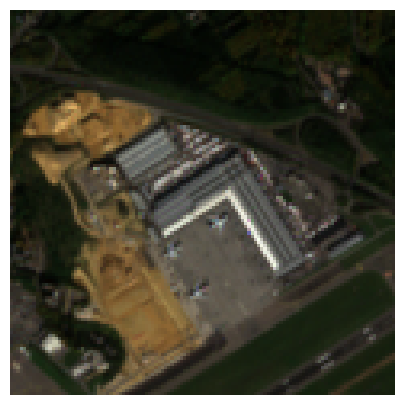


Labels:

- Airports
- Broad-leaved forest
- Discontinuous urban fabric
- Industrial or commercial units

Predictions:

Construction sites: 25.33%
Dump sites: 25.32%
Industrial or commercial units: 23.98%
Airports: 23.90%
Mineral extraction sites: 23.76%
Sclerophyllous vegetation: 23.34%
Discontinuous urban fabric: 23.25%
Peatbogs: 23.20%
Road and rail networks and associated land: 23.02%
Sport and leisure facilities: 22.96%
Salines: 22.93%
Continuous urban fabric: 22.85%
Fruit trees and berry plantations: 22.69%
Mixed forest: 22.66%
Natural grassland: 22.47%
Coastal lagoons: 22.37%
Rice fields: 22.23%
Estuaries: 22.05%
Bare rock: 21.90%
Non-irrigated arable land: 21.88%
Vineyards: 21.68%
Moors and heathland: 21.60%
Pastures: 21.58%
Water bodies: 21.38%
Sparsely vegetated areas: 21.34%
Green urban areas: 21.15%
Inland marshes: 21.01%
Coniferous forest: 20.98%
Intertidal flats: 20.92%
Water courses: 20.90%
Broad-leaved forest: 20.89%
Permanently irrigated land: 20.68%
Olive groves: 20.6

In [ ]:
# Example with single image

image_id = 	'id_441746'
f = h5py.File(test_df_bigearthnet[test_df_bigearthnet.image_id == image_id].filename.item())

print("\nImage:", image_id, "\n")
r = f['04 - Red'][:]    # shape (n, n)
g = f['03 - Green'][:]  # shape (n, n)
b = f['02 - Blue'][:]   # shape (n, n)
rgb_image = np.stack([r, g, b], axis = -1) # shape (n, n, 3)
true_color = normalize(rgb_image)

plt.figure(figsize = (5, 5))
plt.imshow(true_color)
plt.axis('off')
plt.show()

print("\nLabels:\n")
for l in test_df_bigearthnet[test_df_bigearthnet.image_id == image_id].labels.item().strip("[]").split(','):
    print('-', l.strip(" '"))

image = RemoteCLIP_preprocess(Image.fromarray((true_color * 255).astype(np.uint8))).unsqueeze(0).to(device)
text = tokenizer(['a satellite image of ' + l.lower() for l in bigearthnet_labels]).to(device)


with torch.no_grad():
    image_features = RemoteCLIP_model.encode_image(image)
    text_features = RemoteCLIP_model.encode_text(text)

image_features /= image_features.norm(dim=-1, keepdim=True)
text_features /= text_features.norm(dim=-1, keepdim=True)
similarity = image_features @ text_features.T
sigmoid = similarity[0].sigmoid()
#softmax = (100.0 * image_features @ text_features.T).softmax(dim=-1)

# Print the result
print("\nPredictions:\n")
for label, prob in sorted(zip(bigearthnet_labels, similarity[0]), key = lambda x: x[1], reverse = True):
    print(f"{label}: {100 * prob:.2f}%")

- Computing predictions

In [ ]:
add_top_predictions_with_batches_multilabel(
    test_df_bigearthnet,
    RemoteCLIP_model,
    RemoteCLIP_preprocess,
    device,
    bigearthnet_labels,
    ['04 - Red', '03 - Green', '02 - Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-bigearthnet_predictions_RemoteCLIP_RGB.csv',
    tokenizer)

100%|██████████| 4/4 [23:14<00:00, 348.60s/it]


In [ ]:
output_df_remoteclip_bigearthnet = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/output/m-bigearthnet_predictions_RemoteCLIP_RGB.csv')
output_df_remoteclip_bigearthnet.head()

,image_id,filename,bands,split,labels,ground_truth_binary_vector,Agro-forestry_areas_dotprod,Airports_dotprod,Annual_crops_associated_with_permanent_crops_dotprod,Bare_rock_dotprod,...,Sclerophyllous_vegetation_sigmoid,Sea_and_ocean_sigmoid,Sparsely_vegetated_areas_sigmoid,Sport_and_leisure_facilities_sigmoid,Transitional_woodland/shrub_sigmoid,Vineyards_sigmoid,Water_bodies_sigmoid,Water_courses_sigmoid,preds,pred_binary_vector
0,id_427032,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,12,test,"['Complex cultivation patterns', 'Discontinuou...","[0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, ...",0.177121,0.147007,0.169360,0.185412,...,0.551279,0.539801,0.538374,0.550904,0.544269,0.548430,0.546220,0.547832,"['Agro-forestry areas', 'Airports', 'Annual cr...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ..."
1,id_493029,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,12,test,"['Coniferous forest', 'Permanently irrigated l...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, ...",0.230466,0.203634,0.196990,0.302687,...,0.567835,0.547853,0.563298,0.547374,0.567152,0.558683,0.555066,0.545294,"['Agro-forestry areas', 'Airports', 'Annual cr...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ..."
2,id_513633,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,12,test,"['Burnt areas', 'Complex cultivation patterns'...","[0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, ...",0.273151,0.207258,0.243851,0.247037,...,0.569275,0.556612,0.562795,0.562951,0.567884,0.560859,0.557358,0.556742,"['Agro-forestry areas', 'Airports', 'Annual cr...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ..."
3,id_441746,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,12,test,"['Airports', 'Broad-leaved forest', 'Discontin...","[0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, ...",0.197436,0.239024,0.191875,0.219003,...,0.558089,0.549169,0.553150,0.557137,0.551212,0.553984,0.553255,0.552060,"['Agro-forestry areas', 'Airports', 'Annual cr...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ..."
4,id_510900,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,12,test,['Annual crops associated with permanent crops...,"[0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, ...",0.207142,0.174076,0.191279,0.232543,...,0.563002,0.556060,0.551186,0.556880,0.561132,0.552862,0.553607,0.549370,"['Agro-forestry areas', 'Airports', 'Annual cr...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ..."


In [ ]:
output_df_remoteclip_bigearthnet.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Columns: 137 entries, image_id to pred_binary_vector
dtypes: float64(129), int64(1), object(7)
memory usage: 1.0+ MB


In [ ]:
output_df_remoteclip_bigearthnet.pred_binary_vector.value_counts()

,count
pred_binary_vector,
"[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]",1000


In [ ]:
print("\nRemoteCLIP Evaluation:\n")
# Computing mAP
print(f"Mean Average Precision (mAP): {compute_mAP(output_df_remoteclip_bigearthnet):.4f}")
# Computing R@k
print(f"Recall@3: {compute_recall_at_k(output_df_remoteclip_bigearthnet, k=3):.4f}")
print(f"Recall@5: {compute_recall_at_k(output_df_remoteclip_bigearthnet, k=5):.4f}")
print(f"Recall@10: {compute_recall_at_k(output_df_remoteclip_bigearthnet, k=10):.4f}")
# Computing P@k
print(f"Precision@3: {compute_precision_at_k(output_df_remoteclip_bigearthnet, k=3):.4f}")
print(f"Precision@5: {compute_precision_at_k(output_df_remoteclip_bigearthnet, k=5):.4f}")
print(f"Precision@10: {compute_precision_at_k(output_df_remoteclip_bigearthnet, k=10):.4f}")
# Computin rloss
print(f"Ranking Loss: {compute_ranking_loss(output_df_remoteclip_bigearthnet):.4f}")
# computing F1 scores
macro_f1, micro_f1 = compute_f1_scores_adaptive(output_df_remoteclip_bigearthnet)
print(f"Macro F1 Score: {macro_f1:.4f}")
print(f"Micro F1 Score: {micro_f1:.4f}")


RemoteCLIP Evaluation:

Mean Average Precision (mAP): 0.2763
Recall@3: 0.1557
Recall@5: 0.2624
Recall@10: 0.4547
Precision@3: 0.1953
Precision@5: 0.1982
Precision@10: 0.1732
Ranking Loss: 0.3089
Macro F1 Score: 0.1849
Micro F1 Score: 0.2030


## Loading GeoRSCLIP

A state-of-the-art model for zero shot classification and cross-modal retrieval in Remote Sensing, improving on previous results (presented in 2023, revised in 2024).

- Loading the model

In [ ]:
%%capture
!pip install torch torchvision torchaudio --index-url https://download.pytorch.org/whl/cu118
!pip install pillow pandas scikit-learn ftfy tqdm matplotlib transformers adapter-transformers open_clip_torch pycocotools timm clip-benchmark torch-rs

In [ ]:
# Takes around 10 mins
!git clone https://huggingface.co/Zilun/GeoRSCLIP
!cd GeoRSCLIP

Cloning into 'GeoRSCLIP'...
remote: Enumerating objects: 75, done.
remote: Total 75 (delta 0), reused 0 (delta 0), pack-reused 75 (from 1)
Unpacking objects: 100% (75/75), 21.13 KiB | 212.00 KiB/s, done.
Filtering content: 100% (8/8), 9.69 GiB | 11.52 MiB/s, done.
Encountered 1 file(s) that may not have been copied correctly on Windows:
	data/rs5m_test_data.zip

See: `git lfs help smudge` for more details.


In [ ]:
# Add inference folder to environment variable
import sys
sys.path.append("/content/GeoRSCLIP/codebase/inference")

In [ ]:
import os
import torch
import open_clip
import inference_tool
from inference_tool import get_preprocess
from PIL import Image
from torchvision.transforms import Compose, ToTensor, Normalize, Resize

# Selecting device
device = "cuda" if torch.cuda.is_available() else "cpu"
print("device:", device)

# Loading the GeoRSCLIP model from checkpoint
ckpt_path = "/content/GeoRSCLIP/ckpt/RS5M_ViT-B-32.pt"
GeoRSCLIP_model, _, _ = open_clip.create_model_and_transforms("ViT-B/32", pretrained = "openai")
tokenizer = open_clip.get_tokenizer('ViT-B-32')

checkpoint = torch.load(ckpt_path, map_location = "cpu")
message = GeoRSCLIP_model.load_state_dict(checkpoint, strict = False)
print(message)

GeoRSCLIP_model = GeoRSCLIP_model.to(device).eval()
GeoRSCLIP_preprocess = get_preprocess(
      image_resolution = 224,
)

device: cpu


open_clip_model.safetensors:   0%|          | 0.00/605M [00:00<?, ?B/s]

<All keys matched successfully>


### 1) m-brick-kiln

In [ ]:
add_top_predictions_with_batches_standard(
    test_df_brickkiln,
    GeoRSCLIP_model,
    GeoRSCLIP_preprocess,
    device,
    brickkiln_labels, # original labels
    ['04 - Red', '03 - Green', '02 - Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-brick-kiln_predictions_GeoRSCLIP_RGB.csv',
    tokenizer)

100%|██████████| 4/4 [13:31<00:00, 202.82s/it]


In [ ]:
output_df_georsclip = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/output/m-brick-kiln_predictions_GeoRSCLIP_RGB.csv')
output_df_georsclip.head()

,image_id,filename,bands,split,label,not_brick_kiln_dotprod,brick_kiln_dotprod,not_brick_kiln_softmax,brick_kiln_softmax,not_brick_kiln_sigmoid,brick_kiln_sigmoid,pred
0,examples_36_950,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.217857,0.216274,0.539506,0.460494,0.554250,0.553859,not brick kiln
1,examples_79_331,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,not brick kiln,0.210356,0.207982,0.559054,0.440946,0.552396,0.551809,not brick kiln
2,examples_29_266,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.231030,0.228523,0.562368,0.437632,0.557502,0.556883,not brick kiln
3,examples_20_682,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,not brick kiln,0.231082,0.228296,0.569200,0.430800,0.557515,0.556827,not brick kiln
4,examples_63_819,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.230039,0.228700,0.533430,0.466570,0.557258,0.556927,not brick kiln


In [ ]:
output_df_georsclip.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 999 entries, 0 to 998
Data columns (total 12 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   image_id                999 non-null    object 
 1   filename                999 non-null    object 
 2   bands                   999 non-null    int64  
 3   split                   999 non-null    object 
 4   label                   999 non-null    object 
 5   not_brick_kiln_dotprod  999 non-null    float64
 6   brick_kiln_dotprod      999 non-null    float64
 7   not_brick_kiln_softmax  999 non-null    float64
 8   brick_kiln_softmax      999 non-null    float64
 9   not_brick_kiln_sigmoid  999 non-null    float64
 10  brick_kiln_sigmoid      999 non-null    float64
 11  pred                    999 non-null    object 
dtypes: float64(6), int64(1), object(5)
memory usage: 93.8+ KB


In [ ]:
output_df_georsclip.pred.value_counts()

,pred
not brick kiln,964
brick kiln,35


In [ ]:
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
import plotly.express as px

labels = output_df_georsclip['label'].unique()
y_true = output_df_georsclip["label"]
y_pred = output_df_georsclip["pred"]

classification_report_and_cm(y_true, y_pred, labels)


Classification Report:

                precision    recall  f1-score   support

    brick kiln     0.8286    0.0863    0.1563       336
not brick kiln     0.6815    0.9910    0.8076       663

      accuracy                         0.6867       999
     macro avg     0.7551    0.5386    0.4820       999
  weighted avg     0.7310    0.6867    0.5886       999


Accuracy: 0.6867

Confusion matrix:

[[ 29 307]
 [  6 657]]



In [ ]:
# ROC curve and AUC
# Binary: convert true_label to 0/1
output_df_georsclip["true_binary"] = output_df_georsclip["label"].map({"not brick kiln": 0, "brick kiln": 1})
y_true = output_df_georsclip["true_binary"]
y_scores = output_df_georsclip["brick_kiln_softmax"]

plot_auc(y_true, y_scores)

### m-brick-kiln (alt labels 1)

In [ ]:
import clip

In [ ]:
# 1st set of alternative labels

custom_labels = ['other landscape',               # negative class
                 'a brick kiln construction']     # positive class

add_top_predictions_with_batches_standard(
    test_df_brickkiln,
    GeoRSCLIP_model,
    GeoRSCLIP_preprocess,
    device,
    custom_labels,
    ['04 - Red', '03 - Green', '02 - Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-brick-kiln_predictions_GeoRSCLIP_RGB_alt1.csv')

100%|██████████| 4/4 [05:51<00:00, 87.94s/it]


In [ ]:
output_df_georsclip1 = pd.read_csv( '/content/drive/MyDrive/Thesis CLIP4EO/output/m-brick-kiln_predictions_GeoRSCLIP_RGB_alt1.csv')
output_df_georsclip1.head()

,image_id,filename,bands,split,label,other_landscape_dotprod,a_brick_kiln_construction_dotprod,other_landscape_softmax,a_brick_kiln_construction_softmax,other_landscape_sigmoid,a_brick_kiln_construction_sigmoid,pred
0,examples_36_950,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.210358,0.212454,0.447783,0.552217,0.552396,0.552915,a brick kiln construction
1,examples_79_331,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,not brick kiln,0.237405,0.190197,0.991171,0.008829,0.559074,0.547406,other landscape
2,examples_29_266,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.227893,0.215124,0.781927,0.218073,0.556728,0.553575,other landscape
3,examples_20_682,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,not brick kiln,0.228364,0.217627,0.745311,0.254689,0.556844,0.554193,other landscape
4,examples_63_819,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.221436,0.213232,0.694318,0.305682,0.555134,0.553107,other landscape


In [ ]:
output_df_georsclip1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 999 entries, 0 to 998
Data columns (total 12 columns):
 #   Column                             Non-Null Count  Dtype  
---  ------                             --------------  -----  
 0   image_id                           999 non-null    object 
 1   filename                           999 non-null    object 
 2   bands                              999 non-null    int64  
 3   split                              999 non-null    object 
 4   label                              999 non-null    object 
 5   other_landscape_dotprod            999 non-null    float64
 6   a_brick_kiln_construction_dotprod  999 non-null    float64
 7   other_landscape_softmax            999 non-null    float64
 8   a_brick_kiln_construction_softmax  999 non-null    float64
 9   other_landscape_sigmoid            999 non-null    float64
 10  a_brick_kiln_construction_sigmoid  999 non-null    float64
 11  pred                               999 non-null    object 

In [ ]:
output_df_georsclip1.pred.value_counts()

,pred
other landscape,866
a brick kiln construction,133


In [ ]:
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
import plotly.express as px

labels = output_df_georsclip1['label'].unique()
y_true = output_df_georsclip1["label"]
y_pred = output_df_georsclip1["pred"].map({"other landscape": "not brick kiln",
                                           "a brick kiln construction": "brick kiln"})

classification_report_and_cm(y_true, y_pred, labels)


Classification Report:

                precision    recall  f1-score   support

    brick kiln     0.7068    0.2798    0.4009       336
not brick kiln     0.7206    0.9412    0.8162       663

      accuracy                         0.7187       999
     macro avg     0.7137    0.6105    0.6085       999
  weighted avg     0.7159    0.7187    0.6765       999


Accuracy: 0.7187

Confusion matrix:

[[ 94 242]
 [ 39 624]]



In [ ]:
# ROC curve and AUC
# Binary: convert true_label to 0/1
output_df_georsclip1["true_binary"] = output_df_georsclip1["label"].map({"not brick kiln": 0, "brick kiln": 1})
y_true = output_df_georsclip1["true_binary"]
y_scores = output_df_georsclip1["a_brick_kiln_construction_softmax"]

plot_auc(y_true, y_scores)

### m-brick-kiln (alt labels 2)

In [ ]:
# Use best-performing prompts based on CLIP experiments
custom_labels = ['some landscape',                # negative class
                 'a brick kiln construction']     # positive class

add_top_predictions_with_batches_standard(
    test_df_brickkiln,
    GeoRSCLIP_model,
    GeoRSCLIP_preprocess,
    device,
    custom_labels,
    ['04 - Red', '03 - Green', '02 - Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-brick-kiln_predictions_GeoRSCLIP_RGB_alt2.csv',
    tokenizer)

100%|██████████| 4/4 [06:46<00:00, 101.60s/it]


In [ ]:
output_df_georsclip2 = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/output/m-brick-kiln_predictions_GeoRSCLIP_RGB_alt2.csv')
output_df_georsclip2.head()

,image_id,filename,bands,split,label,some_landscape_dotprod,a_brick_kiln_construction_dotprod,some_landscape_softmax,a_brick_kiln_construction_softmax,some_landscape_sigmoid,a_brick_kiln_construction_sigmoid,pred
0,examples_36_950,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.208086,0.212454,0.392491,0.607509,0.551835,0.552915,a brick kiln construction
1,examples_79_331,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,not brick kiln,0.240166,0.190197,0.993286,0.006714,0.559755,0.547406,some landscape
2,examples_29_266,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.227101,0.215124,0.768108,0.231892,0.556532,0.553575,some landscape
3,examples_20_682,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,not brick kiln,0.226606,0.217627,0.710518,0.289482,0.556410,0.554193,some landscape
4,examples_63_819,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.217969,0.213232,0.616258,0.383742,0.554278,0.553107,some landscape


In [ ]:
output_df_georsclip2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 999 entries, 0 to 998
Data columns (total 12 columns):
 #   Column                             Non-Null Count  Dtype  
---  ------                             --------------  -----  
 0   image_id                           999 non-null    object 
 1   filename                           999 non-null    object 
 2   bands                              999 non-null    int64  
 3   split                              999 non-null    object 
 4   label                              999 non-null    object 
 5   some_landscape_dotprod             999 non-null    float64
 6   a_brick_kiln_construction_dotprod  999 non-null    float64
 7   some_landscape_softmax             999 non-null    float64
 8   a_brick_kiln_construction_softmax  999 non-null    float64
 9   some_landscape_sigmoid             999 non-null    float64
 10  a_brick_kiln_construction_sigmoid  999 non-null    float64
 11  pred                               999 non-null    object 

In [ ]:
output_df_georsclip2.pred.value_counts()

,pred
some landscape,831
a brick kiln construction,168


In [ ]:
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
import plotly.express as px

labels = output_df_georsclip2['label'].unique()
y_true = output_df_georsclip2["label"]
y_pred = output_df_georsclip2["pred"].map({"some landscape": "not brick kiln",
                                           "a brick kiln construction": "brick kiln"})

classification_report_and_cm(y_true, y_pred, labels)


Classification Report:

                precision    recall  f1-score   support

    brick kiln     0.6250    0.3125    0.4167       336
not brick kiln     0.7220    0.9050    0.8032       663

      accuracy                         0.7057       999
     macro avg     0.6735    0.6087    0.6099       999
  weighted avg     0.6894    0.7057    0.6732       999


Accuracy: 0.7057

Confusion matrix:

[[105 231]
 [ 63 600]]



In [ ]:
# AUC
# Binary: convert true_label to 0/1
output_df_georsclip2["true_binary"] = output_df_georsclip2["label"].map({"not brick kiln": 0, "brick kiln": 1})
y_true = output_df_georsclip2["true_binary"]
y_scores = output_df_georsclip2["a_brick_kiln_construction_softmax"]

plot_auc(y_true, y_scores)

### m-brick-kiln (alt labels 3)

In [ ]:
del output_df_georsclip1

In [ ]:
# 3rd set of alternative labels
custom_labels = ['some other landscape',          # negative class
                 'a brick kiln construction']     # positive class

add_top_predictions_with_batches_standard(
    test_df_brickkiln,
    GeoRSCLIP_model,
    GeoRSCLIP_preprocess,
    device,
    custom_labels,
    ['04 - Red', '03 - Green', '02 - Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-brick-kiln_predictions_GeoRSCLIP_RGB_alt3.csv',
    tokenizer)

100%|██████████| 4/4 [04:42<00:00, 70.67s/it]


In [ ]:
output_df_georsclip3 = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/output/m-brick-kiln_predictions_GeoRSCLIP_RGB_alt3.csv')
output_df_georsclip3.head()

,image_id,filename,bands,split,label,some_other_landscape_dotprod,a_brick_kiln_construction_dotprod,some_other_landscape_softmax,a_brick_kiln_construction_softmax,some_other_landscape_sigmoid,a_brick_kiln_construction_sigmoid,pred
0,examples_36_950,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.211317,0.212454,0.471598,0.528402,0.552634,0.552915,a brick kiln construction
1,examples_79_331,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,not brick kiln,0.239710,0.190197,0.992975,0.007025,0.559642,0.547406,some other landscape
2,examples_29_266,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.227432,0.215124,0.773966,0.226034,0.556614,0.553575,some other landscape
3,examples_20_682,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,not brick kiln,0.227711,0.217627,0.732702,0.267298,0.556683,0.554193,some other landscape
4,examples_63_819,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.217127,0.213232,0.596171,0.403829,0.554070,0.553107,some other landscape


In [ ]:
output_df_georsclip3.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 999 entries, 0 to 998
Data columns (total 12 columns):
 #   Column                             Non-Null Count  Dtype  
---  ------                             --------------  -----  
 0   image_id                           999 non-null    object 
 1   filename                           999 non-null    object 
 2   bands                              999 non-null    int64  
 3   split                              999 non-null    object 
 4   label                              999 non-null    object 
 5   some_other_landscape_dotprod       999 non-null    float64
 6   a_brick_kiln_construction_dotprod  999 non-null    float64
 7   some_other_landscape_softmax       999 non-null    float64
 8   a_brick_kiln_construction_softmax  999 non-null    float64
 9   some_other_landscape_sigmoid       999 non-null    float64
 10  a_brick_kiln_construction_sigmoid  999 non-null    float64
 11  pred                               999 non-null    object 

In [ ]:
output_df_georsclip3.pred.value_counts()

,pred
some other landscape,865
a brick kiln construction,134


In [ ]:
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
import plotly.express as px

labels = output_df_georsclip3['label'].unique()
y_true = output_df_georsclip3["label"]
y_pred = output_df_georsclip3["pred"].map({"some other landscape": "not brick kiln",
                                           "a brick kiln construction": "brick kiln"})

classification_report_and_cm(y_true, y_pred, labels)


Classification Report:

                precision    recall  f1-score   support

    brick kiln     0.7612    0.3036    0.4340       336
not brick kiln     0.7295    0.9517    0.8259       663

      accuracy                         0.7337       999
     macro avg     0.7453    0.6277    0.6300       999
  weighted avg     0.7401    0.7337    0.6941       999


Accuracy: 0.7337

Confusion matrix:

[[102 234]
 [ 32 631]]



In [ ]:
# AUC
# Binary: convert true_label to 0/1
output_df_georsclip3["true_binary"] = output_df_georsclip3["label"].map({"not brick kiln": 0, "brick kiln": 1})
y_true = output_df_georsclip3["true_binary"]
y_scores = output_df_georsclip3["a_brick_kiln_construction_softmax"]

plot_auc(y_true, y_scores)

### m-brick-kiln (alt multi)

In [ ]:
del output_df_georsclip3

In [ ]:
# Multi-prompts for the negative class
custom_labels = ['barren terrain',                # negative class(es)
                 'a green forested area',
                 'an agricultural area',
                 'a brick kiln construction']     # positive class

add_top_predictions_with_batches_standard(
    test_df_brickkiln,
    GeoRSCLIP_model,
    GeoRSCLIP_preprocess,
    device,
    custom_labels,
    ['04 - Red', '03 - Green', '02 - Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-brick-kiln_predictions_GeoRSCLIP_RGB_alt_multi.csv',
    tokenizer)

100%|██████████| 4/4 [04:56<00:00, 74.04s/it]


In [ ]:
output_df_georsclip = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/output/m-brick-kiln_predictions_GeoRSCLIP_RGB_alt_multi.csv')
output_df_georsclip.head()

,image_id,filename,bands,split,label,barren_terrain_dotprod,a_green_forested_area_dotprod,an_agricultural_area_dotprod,a_brick_kiln_construction_dotprod,barren_terrain_softmax,a_green_forested_area_softmax,an_agricultural_area_softmax,a_brick_kiln_construction_softmax,barren_terrain_sigmoid,a_green_forested_area_sigmoid,an_agricultural_area_sigmoid,a_brick_kiln_construction_sigmoid,pred
0,examples_36_950,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.180849,0.192980,0.189985,0.212454,0.032852,0.110504,0.081907,0.774736,0.545089,0.548096,0.547354,0.552915,a brick kiln construction
1,examples_79_331,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,not brick kiln,0.221967,0.273661,0.222722,0.190197,0.005620,0.988085,0.006061,0.000234,0.555265,0.567991,0.555452,0.547406,a green forested area
2,examples_29_266,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.194846,0.247589,0.229835,0.215124,0.004220,0.824103,0.139611,0.032065,0.548558,0.561583,0.557207,0.553575,a green forested area
3,examples_20_682,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,not brick kiln,0.195491,0.232142,0.223205,0.217627,0.015340,0.599179,0.245145,0.140337,0.548718,0.557776,0.555571,0.554193,a green forested area
4,examples_63_819,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.167469,0.212258,0.242926,0.213232,0.000481,0.042397,0.910386,0.046736,0.541770,0.552866,0.560435,0.553107,an agricultural area


In [ ]:
output_df_georsclip.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 999 entries, 0 to 998
Data columns (total 18 columns):
 #   Column                             Non-Null Count  Dtype  
---  ------                             --------------  -----  
 0   image_id                           999 non-null    object 
 1   filename                           999 non-null    object 
 2   bands                              999 non-null    int64  
 3   split                              999 non-null    object 
 4   label                              999 non-null    object 
 5   barren_terrain_dotprod             999 non-null    float64
 6   a_green_forested_area_dotprod      999 non-null    float64
 7   an_agricultural_area_dotprod       999 non-null    float64
 8   a_brick_kiln_construction_dotprod  999 non-null    float64
 9   barren_terrain_softmax             999 non-null    float64
 10  a_green_forested_area_softmax      999 non-null    float64
 11  an_agricultural_area_softmax       999 non-null    float64

In [ ]:
output_df_georsclip.pred.value_counts()

,pred
a green forested area,768
an agricultural area,123
a brick kiln construction,84
barren terrain,24


In [ ]:
# Classification report and confusion matrix
labels = output_df_georsclip['label'].unique()
y_true = output_df_georsclip["label"]
y_pred = output_df_georsclip["pred"].map({'barren terrain': 'not brick kiln',           # negative class(es)
                                          'a green forested area': 'not brick kiln',
                                          'an agricultural area': 'not brick kiln',
                                          'a brick kiln construction': 'brick kiln'})   # positive class

classification_report_and_cm(y_true, y_pred, labels)


Classification Report:

                precision    recall  f1-score   support

    brick kiln     0.6071    0.1518    0.2429       336
not brick kiln     0.6885    0.9502    0.7985       663

      accuracy                         0.6817       999
     macro avg     0.6478    0.5510    0.5207       999
  weighted avg     0.6612    0.6817    0.6116       999


Accuracy: 0.6817

Confusion matrix:

[[ 51 285]
 [ 33 630]]



In [ ]:
# ROC curve and AUC
# Binary: convert true_label to 0/1
output_df_georsclip["true_binary"] = output_df_georsclip["label"].map({"not brick kiln": 0, "brick kiln": 1})
y_true = output_df_georsclip["true_binary"]
y_scores = output_df_georsclip["a_brick_kiln_construction_softmax"]

plot_auc(y_true, y_scores)

### 2) m-pv4ger

In [ ]:
add_top_predictions_with_batches_standard(
    test_df_pv4ger,
    GeoRSCLIP_model,
    GeoRSCLIP_preprocess,
    device,
    pv4ger_labels, # original labels
    ['Red', 'Green', 'Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-pv4ger_predictions_GeoRSCLIP_RGB.csv',
    tokenizer)

100%|██████████| 4/4 [11:45<00:00, 176.49s/it]


In [ ]:
output_df_georsclip = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/output/m-pv4ger_predictions_GeoRSCLIP_RGB.csv')
output_df_georsclip.head()

,image_id,filename,bands,split,label,no_solar_pv_dotprod,solar_pv_dotprod,no_solar_pv_softmax,solar_pv_softmax,no_solar_pv_sigmoid,solar_pv_sigmoid,pred
0,"7.222180076676272, 50.698836440699615",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.191705,0.182894,0.707052,0.292948,0.547780,0.545597,no solar pv
1,"6.669612320016594, 51.73787665131514",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.199140,0.193633,0.634309,0.365691,0.549621,0.548258,no solar pv
2,"6.339084510786531, 51.22087464650394",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.191089,0.186249,0.618710,0.381290,0.547627,0.546428,no solar pv
3,"8.724089525367726, 51.77399340700887",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.227920,0.221411,0.657202,0.342798,0.556735,0.555128,no solar pv
4,"7.8016608434245205, 52.243655122484405",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.219215,0.215470,0.592562,0.407438,0.554585,0.553660,no solar pv


In [ ]:
output_df_georsclip.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 999 entries, 0 to 998
Data columns (total 12 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   image_id             999 non-null    object 
 1   filename             999 non-null    object 
 2   bands                999 non-null    int64  
 3   split                999 non-null    object 
 4   label                999 non-null    object 
 5   no_solar_pv_dotprod  999 non-null    float64
 6   solar_pv_dotprod     999 non-null    float64
 7   no_solar_pv_softmax  999 non-null    float64
 8   solar_pv_softmax     999 non-null    float64
 9   no_solar_pv_sigmoid  999 non-null    float64
 10  solar_pv_sigmoid     999 non-null    float64
 11  pred                 999 non-null    object 
dtypes: float64(6), int64(1), object(5)
memory usage: 93.8+ KB


In [ ]:
output_df_georsclip.pred.value_counts()

,pred
no solar pv,923
solar pv,76


In [ ]:
# Classification report and confusion matrix
labels = output_df_georsclip['label'].unique()
y_true = output_df_georsclip["label"]
y_pred = output_df_georsclip["pred"]

classification_report_and_cm(y_true, y_pred, labels)


Classification Report:

              precision    recall  f1-score   support

 no solar pv     0.8992    0.9811    0.9384       846
    solar pv     0.7895    0.3922    0.5240       153

    accuracy                         0.8909       999
   macro avg     0.8444    0.6866    0.7312       999
weighted avg     0.8824    0.8909    0.8749       999


Accuracy: 0.8909

Confusion matrix:

[[830  16]
 [ 93  60]]



In [ ]:
# ROC curve and AUC
# Binary: convert true_label to 0/1
output_df_georsclip["true_binary"] = output_df_georsclip["label"].map({'no solar pv' : 0, 'solar pv': 1})
y_true = output_df_georsclip["true_binary"]
y_scores = output_df_georsclip["solar_pv_softmax"]

plot_auc(y_true, y_scores)

### m-pv4ger (alt labels 1)

In [ ]:
# 1st set of alternative labels

custom_labels = ['other scenery',                  # negative class  # "other" si riferisce a che? -> prova prompt senza
                 'a solar photovoltaic system']    # positive class

add_top_predictions_with_batches_standard(
    test_df_pv4ger,
    GeoRSCLIP_model,
    GeoRSCLIP_preprocess,
    device,
    custom_labels,
    ['Red', 'Green', 'Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-pv4ger_predictions_GeoRSCLIP_RGB_alt1.csv',
    tokenizer)

100%|██████████| 4/4 [05:51<00:00, 87.94s/it]


In [ ]:
output_df_georsclip1 = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/output/m-pv4ger_predictions_GeoRSCLIP_RGB_alt1.csv')
output_df_georsclip1.head()

,image_id,filename,bands,split,label,other_scenery_dotprod,a_solar_photovoltaic_system_dotprod,other_scenery_softmax,a_solar_photovoltaic_system_softmax,other_scenery_sigmoid,a_solar_photovoltaic_system_sigmoid,pred
0,"7.222180076676272, 50.698836440699615",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.227088,0.163145,0.998332,0.001668,0.556529,0.540696,other scenery
1,"6.669612320016594, 51.73787665131514",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.239020,0.177231,0.997932,0.002068,0.559472,0.544192,other scenery
2,"6.339084510786531, 51.22087464650394",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.201828,0.178363,0.912658,0.087342,0.550287,0.544473,other scenery
3,"8.724089525367726, 51.77399340700887",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.254852,0.206466,0.992144,0.007856,0.563370,0.551434,other scenery
4,"7.8016608434245205, 52.243655122484405",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.239313,0.203286,0.973472,0.026528,0.559544,0.550647,other scenery


In [ ]:
output_df_georsclip1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 999 entries, 0 to 998
Data columns (total 12 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   image_id                             999 non-null    object 
 1   filename                             999 non-null    object 
 2   bands                                999 non-null    int64  
 3   split                                999 non-null    object 
 4   label                                999 non-null    object 
 5   other_scenery_dotprod                999 non-null    float64
 6   a_solar_photovoltaic_system_dotprod  999 non-null    float64
 7   other_scenery_softmax                999 non-null    float64
 8   a_solar_photovoltaic_system_softmax  999 non-null    float64
 9   other_scenery_sigmoid                999 non-null    float64
 10  a_solar_photovoltaic_system_sigmoid  999 non-null    float64
 11  pred                            

In [ ]:
output_df_georsclip1.pred.value_counts()

,pred
other scenery,838
a solar photovoltaic system,161


In [ ]:
# Classification report and confusion matrix
labels = output_df_georsclip1['label'].unique()
y_true = output_df_georsclip1["label"]
y_pred = output_df_georsclip1["pred"].map({"other scenery": "no solar pv",
                                           "a solar photovoltaic system": "solar pv"})

classification_report_and_cm(y_true, y_pred, labels)


Classification Report:

              precision    recall  f1-score   support

 no solar pv     0.9702    0.9610    0.9656       846
    solar pv     0.7950    0.8366    0.8153       153

    accuracy                         0.9419       999
   macro avg     0.8826    0.8988    0.8904       999
weighted avg     0.9433    0.9419    0.9425       999


Accuracy: 0.9419

Confusion matrix:

[[813  33]
 [ 25 128]]



In [ ]:
# ROC curve and AUC
# Binary: convert true_label to 0/1
output_df_georsclip1["true_binary"] = output_df_georsclip1["label"].map({"no solar pv": 0, "solar pv": 1})
y_true = output_df_georsclip1["true_binary"]
y_scores = output_df_georsclip1["a_solar_photovoltaic_system_softmax"]

plot_auc(y_true, y_scores)

### m-pv4ger (alt labels 2)

In [ ]:
custom_labels = ['some scenery',                   # negative class
                 'a solar photovoltaic system']    # positive class

add_top_predictions_with_batches_standard(
    test_df_pv4ger,
    GeoRSCLIP_model,
    GeoRSCLIP_preprocess,
    device,
    custom_labels,
    ['Red', 'Green', 'Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-pv4ger_predictions_GeoRSCLIP_RGB_alt2.csv',
    tokenizer)

100%|██████████| 4/4 [03:58<00:00, 59.75s/it]


In [ ]:
output_df_georsclip2 = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/output/m-pv4ger_predictions_GeoRSCLIP_RGB_alt2.csv')
output_df_georsclip2.head()

,image_id,filename,bands,split,label,some_scenery_dotprod,a_solar_photovoltaic_system_dotprod,some_scenery_softmax,a_solar_photovoltaic_system_softmax,some_scenery_sigmoid,a_solar_photovoltaic_system_sigmoid,pred
0,"7.222180076676272, 50.698836440699615",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.231933,0.163145,0.998972,0.001028,0.557725,0.540696,some scenery
1,"6.669612320016594, 51.73787665131514",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.245523,0.177231,0.998919,0.001081,0.561074,0.544192,some scenery
2,"6.339084510786531, 51.22087464650394",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.207296,0.178363,0.947515,0.052485,0.551639,0.544473,some scenery
3,"8.724089525367726, 51.77399340700887",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.259627,0.206466,0.995112,0.004888,0.564545,0.551434,some scenery
4,"7.8016608434245205, 52.243655122484405",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.236835,0.203286,0.966265,0.033735,0.558934,0.550647,some scenery


In [ ]:
output_df_georsclip2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 999 entries, 0 to 998
Data columns (total 12 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   image_id                             999 non-null    object 
 1   filename                             999 non-null    object 
 2   bands                                999 non-null    int64  
 3   split                                999 non-null    object 
 4   label                                999 non-null    object 
 5   some_scenery_dotprod                 999 non-null    float64
 6   a_solar_photovoltaic_system_dotprod  999 non-null    float64
 7   some_scenery_softmax                 999 non-null    float64
 8   a_solar_photovoltaic_system_softmax  999 non-null    float64
 9   some_scenery_sigmoid                 999 non-null    float64
 10  a_solar_photovoltaic_system_sigmoid  999 non-null    float64
 11  pred                            

In [ ]:
output_df_georsclip2.pred.value_counts()

,pred
some scenery,807
a solar photovoltaic system,192


In [ ]:
# Classification report and confusion matrix
labels = output_df_georsclip2['label'].unique()
y_true = output_df_georsclip2["label"]
y_pred = output_df_georsclip2["pred"].map({"some scenery": "no solar pv",
                                           "a solar photovoltaic system": "solar pv"})

classification_report_and_cm(y_true, y_pred, labels)


Classification Report:

              precision    recall  f1-score   support

 no solar pv     0.9827    0.9374    0.9595       846
    solar pv     0.7240    0.9085    0.8058       153

    accuracy                         0.9329       999
   macro avg     0.8533    0.9229    0.8826       999
weighted avg     0.9430    0.9329    0.9359       999


Accuracy: 0.9329

Confusion matrix:

[[793  53]
 [ 14 139]]



In [ ]:
# ROC curve and AUC
# Binary: convert true_label to 0/1
output_df_georsclip2["true_binary"] = output_df_georsclip2["label"].map({"no solar pv": 0, "solar pv": 1})
y_true = output_df_georsclip2["true_binary"]
y_scores = output_df_georsclip2["a_solar_photovoltaic_system_softmax"]

plot_auc(y_true, y_scores)

### m-pv4ger (alt labels 3)

In [ ]:
# 3rd set of alternative labels
custom_labels = ['some other scenery',            # negative class
                 'a solar photovoltaic system']   # positive class

add_top_predictions_with_batches_standard(
    test_df_pv4ger,
    GeoRSCLIP_model,
    GeoRSCLIP_preprocess,
    device,
    custom_labels,
    ['Red', 'Green', 'Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-pv4ger_predictions_GeoRSCLIP_RGB_alt3.csv',
    tokenizer)

100%|██████████| 4/4 [06:05<00:00, 91.45s/it]


In [ ]:
output_df_georsclip3 = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/output/m-pv4ger_predictions_GeoRSCLIP_RGB_alt3.csv')
output_df_georsclip3.head()

,image_id,filename,bands,split,label,some_other_scenery_dotprod,a_solar_photovoltaic_system_dotprod,some_other_scenery_softmax,a_solar_photovoltaic_system_softmax,some_other_scenery_sigmoid,a_solar_photovoltaic_system_sigmoid,pred
0,"7.222180076676272, 50.698836440699615",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.233069,0.163145,0.999082,0.000918,0.558005,0.540696,some other scenery
1,"6.669612320016594, 51.73787665131514",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.243525,0.177231,0.998681,0.001319,0.560582,0.544192,some other scenery
2,"6.339084510786531, 51.22087464650394",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.208519,0.178363,0.953272,0.046728,0.551942,0.544473,some other scenery
3,"8.724089525367726, 51.77399340700887",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.260227,0.206466,0.995396,0.004604,0.564692,0.551434,some other scenery
4,"7.8016608434245205, 52.243655122484405",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.238334,0.203286,0.970823,0.029177,0.559303,0.550647,some other scenery


In [ ]:
output_df_georsclip3.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 999 entries, 0 to 998
Data columns (total 12 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   image_id                             999 non-null    object 
 1   filename                             999 non-null    object 
 2   bands                                999 non-null    int64  
 3   split                                999 non-null    object 
 4   label                                999 non-null    object 
 5   some_other_scenery_dotprod           999 non-null    float64
 6   a_solar_photovoltaic_system_dotprod  999 non-null    float64
 7   some_other_scenery_softmax           999 non-null    float64
 8   a_solar_photovoltaic_system_softmax  999 non-null    float64
 9   some_other_scenery_sigmoid           999 non-null    float64
 10  a_solar_photovoltaic_system_sigmoid  999 non-null    float64
 11  pred                            

In [ ]:
output_df_georsclip3.pred.value_counts()

,pred
some other scenery,837
a solar photovoltaic system,162


In [ ]:
# Classification report and confusion matrix
labels = output_df_georsclip3['label'].unique()
y_true = output_df_georsclip3["label"]
y_pred = output_df_georsclip3["pred"].map({"some other scenery": "no solar pv",
                                           "a solar photovoltaic system": "solar pv"})

classification_report_and_cm(y_true, y_pred, labels)


Classification Report:

              precision    recall  f1-score   support

 no solar pv     0.9689    0.9586    0.9638       846
    solar pv     0.7840    0.8301    0.8063       153

    accuracy                         0.9389       999
   macro avg     0.8764    0.8943    0.8851       999
weighted avg     0.9406    0.9389    0.9396       999


Accuracy: 0.9389

Confusion matrix:

[[811  35]
 [ 26 127]]



In [ ]:
# ROC curve and AUC
# Binary: convert true_label to 0/1
output_df_georsclip3["true_binary"] = output_df_georsclip3["label"].map({"no solar pv": 0, "solar pv": 1})
y_true = output_df_georsclip3["true_binary"]
y_scores = output_df_georsclip3["a_solar_photovoltaic_system_softmax"]

plot_auc(y_true, y_scores)

### m-pv4ger (alt multi)

In [ ]:
# Multi-prompts for the negative class

custom_labels = ['an urban setting',                # negative class(es)
                 'a green forested area',
                 'an agricultural area',
                 'a solar photovoltaic system']     # positive class

add_top_predictions_with_batches_standard(
    test_df_pv4ger,
    GeoRSCLIP_model,
    GeoRSCLIP_preprocess,
    device,
    custom_labels,
    ['Red', 'Green', 'Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-pv4ger_predictions_GeoRSCLIP_RGB_alt_multi.csv',
    tokenizer)

100%|██████████| 4/4 [04:49<00:00, 72.49s/it]


In [ ]:
output_df_georsclip = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/output/m-pv4ger_predictions_GeoRSCLIP_RGB_alt_multi.csv')
output_df_georsclip.head()

,image_id,filename,bands,split,label,an_urban_setting_dotprod,a_green_forested_area_dotprod,an_agricultural_area_dotprod,a_solar_photovoltaic_system_dotprod,an_urban_setting_softmax,a_green_forested_area_softmax,an_agricultural_area_softmax,a_solar_photovoltaic_system_softmax,an_urban_setting_sigmoid,a_green_forested_area_sigmoid,an_agricultural_area_sigmoid,a_solar_photovoltaic_system_sigmoid,pred
0,"7.222180076676272, 50.698836440699615",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.198139,0.203184,0.183843,0.163145,0.341786,0.566058,0.081828,0.010328,0.549373,0.550622,0.545832,0.540696,a green forested area
1,"6.669612320016594, 51.73787665131514",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.215221,0.268730,0.201384,0.177231,0.004715,0.993997,0.001182,0.000106,0.553599,0.566781,0.550177,0.544192,a green forested area
2,"6.339084510786531, 51.22087464650394",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.193959,0.156540,0.203436,0.178363,0.262202,0.006217,0.676459,0.055122,0.548338,0.539055,0.550684,0.544473,an agricultural area
3,"8.724089525367726, 51.77399340700887",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.235270,0.261701,0.214611,0.206466,0.065614,0.922390,0.008314,0.003682,0.558548,0.565054,0.553448,0.551434,a green forested area
4,"7.8016608434245205, 52.243655122484405",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.212327,0.189221,0.193379,0.203286,0.604432,0.059961,0.090876,0.244731,0.552883,0.547165,0.548195,0.550647,an urban setting


In [ ]:
output_df_georsclip.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 999 entries, 0 to 998
Data columns (total 18 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   image_id                             999 non-null    object 
 1   filename                             999 non-null    object 
 2   bands                                999 non-null    int64  
 3   split                                999 non-null    object 
 4   label                                999 non-null    object 
 5   an_urban_setting_dotprod             999 non-null    float64
 6   a_green_forested_area_dotprod        999 non-null    float64
 7   an_agricultural_area_dotprod         999 non-null    float64
 8   a_solar_photovoltaic_system_dotprod  999 non-null    float64
 9   an_urban_setting_softmax             999 non-null    float64
 10  a_green_forested_area_softmax        999 non-null    float64
 11  an_agricultural_area_softmax    

In [ ]:
output_df_georsclip.pred.value_counts()

,pred
a green forested area,453
an urban setting,204
a solar photovoltaic system,178
an agricultural area,164


In [ ]:
# Classification report and confusion matrix
labels = output_df_georsclip['label'].unique()
y_true = output_df_georsclip["label"]
y_pred = output_df_georsclip["pred"].map({"an urban setting": "no solar pv",
                                          "a green forested area": "no solar pv",
                                          "an agricultural area": "no solar pv",
                                          "a solar photovoltaic system": "solar pv"})

classification_report_and_cm(y_true, y_pred, labels)


Classification Report:

              precision    recall  f1-score   support

 no solar pv     0.9671    0.9385    0.9526       846
    solar pv     0.7079    0.8235    0.7613       153

    accuracy                         0.9209       999
   macro avg     0.8375    0.8810    0.8570       999
weighted avg     0.9274    0.9209    0.9233       999


Accuracy: 0.9209

Confusion matrix:

[[794  52]
 [ 27 126]]



In [ ]:
# ROC curve and AUC
# Binary: convert true_label to 0/1
output_df_georsclip["true_binary"] = output_df_georsclip["label"].map({"no solar pv": 0, "solar pv": 1})
y_true = output_df_georsclip["true_binary"]
y_scores = output_df_georsclip["a_solar_photovoltaic_system_softmax"]

plot_auc(y_true, y_scores)

### 3) m-forestnet

In [ ]:
add_top_predictions_with_batches_forestnet(
    test_df_forestnet,
    GeoRSCLIP_model,
    GeoRSCLIP_preprocess,
    device,
    forestnet_labels,
    ['04 - Red', '03 - Green', '02 - Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-forestnet_predictions_GeoRSCLIP_RGB.csv',
    tokenizer)

100%|██████████| 4/4 [11:20<00:00, 170.18s/it]


In [ ]:
output_df_georsclip = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/output/m-forestnet_predictions_GeoRSCLIP_RGB.csv')
output_df_georsclip.head()

,image_id,filename,bands,split,label,Oil_palm_plantation_dotprod,Timber_plantation_dotprod,Other_large-scale_plantations_dotprod,Grassland_shrubland_dotprod,Small-scale_agriculture_dotprod,...,Grassland_shrubland_sigmoid,Small-scale_agriculture_sigmoid,Small-scale_mixed_plantation_sigmoid,Small-scale_oil_palm_plantation_sigmoid,Mining_sigmoid,Fish_pond_sigmoid,Logging_sigmoid,Secondary_forest_sigmoid,Other_sigmoid,pred
0,-1.358752546215941_113.47632662109709_2014_01_01,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,6,test,Oil palm plantation,0.277317,0.258459,0.246209,0.229980,0.234632,...,0.557243,0.558390,0.560968,0.568663,0.558826,0.558095,0.566819,0.563306,0.565563,Oil palm plantation
1,-0.3909200308691534_116.02049649124226_2015_01_01,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,6,test,Oil palm plantation,0.236255,0.223397,0.229883,0.245191,0.234093,...,0.560992,0.558257,0.560120,0.558299,0.548159,0.555654,0.556466,0.558843,0.559917,Grassland shrubland
2,-1.8806664692642177_111.7221681696664_2013_10_30,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,6,test,Oil palm plantation,0.258811,0.238235,0.220459,0.225131,0.213989,...,0.556046,0.553294,0.554951,0.563673,0.556146,0.556087,0.564640,0.561912,0.562525,Logging
3,0.3935898654105616_99.19789981112714_2013_01_01,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,6,test,Oil palm plantation,0.267754,0.232774,0.246584,0.237113,0.240664,...,0.559002,0.559877,0.559524,0.564461,0.560814,0.566377,0.563743,0.561871,0.564144,Oil palm plantation
4,-2.0832762463589005_104.28473205885147_2018_08_05,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,6,test,Grassland shrubland,0.259778,0.227104,0.227891,0.235153,0.233010,...,0.558519,0.557990,0.556225,0.563686,0.558587,0.564162,0.560339,0.561410,0.563358,Oil palm plantation


In [ ]:
# Classification report and confusion matrix
labels = output_df_georsclip['label'].unique()
y_true = output_df_georsclip["label"]
y_pred = output_df_georsclip["pred"]

classification_report_and_cm_multiclass(y_true, y_pred, labels)


Classification Report:

                                 precision    recall  f1-score   support

                      Fish pond     0.0275    0.2143    0.0488        14
            Grassland shrubland     0.1277    0.0682    0.0889        88
                        Logging     0.0922    0.8333    0.1660        24
                         Mining     0.4444    0.1379    0.2105        29
            Oil palm plantation     0.4532    0.4423    0.4477       208
                          Other     0.0424    0.4667    0.0778        30
  Other large-scale plantations     0.0000    0.0000    0.0000        73
               Secondary forest     0.0370    0.0233    0.0286        43
        Small-scale agriculture     0.0000    0.0000    0.0000       219
   Small-scale mixed plantation     0.0000    0.0000    0.0000        73
Small-scale oil palm plantation     0.0244    0.0200    0.0220        50
              Timber plantation     0.0000    0.0000    0.0000       142

                       a

Note that 4 categories are almost never predicted

In [ ]:
# ROC curves and AUC scores
# Binarize the labels for multi-class classification
labels = output_df_georsclip["label"].unique()
y_true = label_binarize(output_df_georsclip["label"], classes=labels)

softmax_cols = [col for col in output_df_georsclip.columns if col.endswith("_softmax")]
y_scores = output_df_georsclip[softmax_cols].values

plot_auc_multiclass(y_true, y_scores, labels)

### 4) m-eurosat

In [ ]:
add_top_predictions_with_batches_standard(
    test_df_eurosat,
    GeoRSCLIP_model,
    GeoRSCLIP_preprocess,
    device,
    eurosat_labels,
    ['04 - Red', '03 - Green', '02 - Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-eurosat_predictions_GeoRSCLIP_RGB.csv',
    tokenizer)

100%|██████████| 4/4 [09:31<00:00, 142.98s/it]


In [ ]:
output_df_georsclip = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/output/m-eurosat_predictions_GeoRSCLIP_RGB.csv')
output_df_georsclip.head()

,image_id,filename,bands,split,label_idx,label,Annual_Crop_dotprod,Forest_dotprod,Herbaceous_Vegetation_dotprod,Highway_dotprod,...,Forest_sigmoid,Herbaceous_Vegetation_sigmoid,Highway_sigmoid,Industrial_Buildings_sigmoid,Pasture_sigmoid,Permanent_Crop_sigmoid,Residential_Buildings_sigmoid,River_sigmoid,Sea_and_Lake_sigmoid,pred
0,id_22869,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,2,Herbaceous Vegetation,0.246651,0.255475,0.257459,0.234151,...,0.563524,0.564012,0.558272,0.552958,0.558741,0.560070,0.555822,0.558623,0.553655,Herbaceous Vegetation
1,id_26790,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,9,Sea and Lake,0.225947,0.215033,0.221210,0.205732,...,0.553552,0.555078,0.551252,0.545377,0.551125,0.553420,0.547807,0.552028,0.561546,Sea and Lake
2,id_24810,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,6,Permanent Crop,0.240209,0.222435,0.226418,0.231592,...,0.555381,0.556364,0.557641,0.553594,0.554076,0.557902,0.556823,0.552887,0.547190,Annual Crop
3,id_23442,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,3,Highway,0.201020,0.172804,0.195021,0.240895,...,0.543094,0.548601,0.559934,0.543845,0.546895,0.550535,0.548700,0.546193,0.540842,Highway
4,id_26899,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,9,Sea and Lake,0.211863,0.198818,0.215708,0.200637,...,0.549541,0.553719,0.549992,0.543567,0.549717,0.549115,0.545208,0.549005,0.551599,Herbaceous Vegetation


In [ ]:
output_df_georsclip.pred.value_counts()

,pred
Annual Crop,175
Residential Buildings,171
Herbaceous Vegetation,158
Sea and Lake,112
Highway,111
River,83
Permanent Crop,68
Forest,62
Industrial Buildings,33
Pasture,27


Differently from CLIP, here the class 'Herbaceous Vegetation' is predicted a lot

In [ ]:
# Classification report and confusion matrix
labels = output_df_georsclip['label'].unique()
y_true = output_df_georsclip["label"]
y_pred = output_df_georsclip["pred"]

classification_report_and_cm_multiclass(y_true, y_pred, labels)


Classification Report:

                       precision    recall  f1-score   support

          Annual Crop     0.3371    0.5900    0.4291       100
               Forest     0.3548    0.2200    0.2716       100
Herbaceous Vegetation     0.2152    0.3400    0.2636       100
              Highway     0.8198    0.9100    0.8626       100
 Industrial Buildings     1.0000    0.3300    0.4962       100
              Pasture     1.0000    0.2700    0.4252       100
       Permanent Crop     0.5147    0.3500    0.4167       100
Residential Buildings     0.5497    0.9400    0.6937       100
                River     0.7349    0.6100    0.6667       100
         Sea and Lake     0.5089    0.5700    0.5377       100

             accuracy                         0.5130      1000
            macro avg     0.6035    0.5130    0.5063      1000
         weighted avg     0.6035    0.5130    0.5063      1000


Accuracy: 0.5130

Confusion matrix:

[[34  4  0  9  0  1  5 14 33  0]
 [ 4 57  0  0  0  0

In [ ]:
# ROC curves and AUC scores
# Binarize the labels for multi-class classification
labels = output_df_georsclip["label"].unique()
y_true = label_binarize(output_df_georsclip["label"], classes=labels)

softmax_cols = [col for col in output_df_georsclip.columns if col.endswith("_softmax")]
y_scores = output_df_georsclip[softmax_cols].values

plot_auc_multiclass(y_true, y_scores, labels)

### 5) m-so2sat

In [ ]:
add_top_predictions_with_batches_standard(
    test_df_so2sat,
    GeoRSCLIP_model,
    GeoRSCLIP_preprocess,
    device,
    so2sat_labels,
    ['04 - Red', '03 - Green', '02 - Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-so2sat_predictions_GeoRSCLIP_RGB.csv',
    tokenizer)

100%|██████████| 4/4 [17:24<00:00, 261.07s/it]


In [ ]:
output_df_georsclip = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/output/m-so2sat_predictions_GeoRSCLIP_RGB.csv')
output_df_georsclip.head()

,image_id,filename,bands,split,label,Compact_high_rise_dotprod,Compact_mid_rise_dotprod,Compact_low_rise_dotprod,Open_high_rise_dotprod,Open_mid_rise_dotprod,...,Sparsely_built_sigmoid,Heavy_industry_sigmoid,Dense_trees_sigmoid,Scattered_trees_sigmoid,"Bush,_scrub_sigmoid",Low_plants_sigmoid,Bare_rock_or_paved_sigmoid,Bare_soil_or_sand_sigmoid,Water_sigmoid,pred
0,id_388372,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,18,test,Open mid rise,0.272896,0.268434,0.263463,0.274755,0.269834,...,0.567240,0.563768,0.559546,0.559067,0.557460,0.563520,0.560499,0.558806,0.560331,Open high rise
1,id_394258,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,18,test,Dense trees,0.249211,0.239984,0.245403,0.250624,0.241627,...,0.561167,0.558252,0.560140,0.560606,0.556244,0.559452,0.556518,0.554380,0.563374,Water
2,id_388689,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,18,test,"Bush, scrub",0.240427,0.242314,0.241360,0.234166,0.233644,...,0.558819,0.557206,0.555325,0.553921,0.557054,0.556492,0.558910,0.561021,0.558771,Lightweight low rise
3,id_400562,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,18,test,Scattered trees,0.251127,0.245986,0.247357,0.249611,0.241130,...,0.560745,0.556496,0.561031,0.560263,0.559331,0.560232,0.558918,0.555628,0.560748,Lightweight low rise
4,id_390823,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,18,test,Sparsely built,0.249462,0.243237,0.240053,0.256949,0.248659,...,0.560272,0.560120,0.555969,0.553474,0.549919,0.558582,0.551820,0.551151,0.555720,Open high rise


In [ ]:
output_df_georsclip.pred.value_counts()

,pred
Open high rise,441
Water,167
Lightweight low rise,136
Compact high rise,87
Bare soil or sand,64
Low plants,34
Open low rise,24
Scattered trees,12
Dense trees,10
Compact mid rise,4


In [ ]:
# Classification report and confusion matrix
labels = output_df_georsclip['label'].unique()
y_true = output_df_georsclip["label"]
y_pred = output_df_georsclip["pred"]

classification_report_and_cm_multiclass(y_true, y_pred, labels)


Classification Report:

                      precision    recall  f1-score   support

  Bare rock or paved     0.7500    0.0517    0.0968        58
   Bare soil or sand     0.5000    0.5517    0.5246        58
         Bush, scrub     1.0000    0.0172    0.0339        58
   Compact high rise     0.0805    0.1207    0.0966        58
    Compact low rise     0.0000    0.0000    0.0000        58
    Compact mid rise     0.0000    0.0000    0.0000        58
         Dense trees     0.0000    0.0000    0.0000        58
      Heavy industry     0.0000    0.0000    0.0000        58
      Large low rise     0.0000    0.0000    0.0000        58
Lightweight low rise     0.0588    0.1379    0.0825        58
          Low plants     0.2941    0.1724    0.2174        58
      Open high rise     0.0862    0.6552    0.1523        58
       Open low rise     0.0417    0.0172    0.0244        58
       Open mid rise     0.0000    0.0000    0.0000        58
     Scattered trees     0.3333    0.0690   

$\color{red}{\text{Alert:}}$ there are 8-9 classes which are almost never predicted

In [ ]:
# ROC curves and AUC scores
# Binarize the labels for multi-class classification
labels = output_df_georsclip["label"].unique()
y_true = label_binarize(output_df_georsclip["label"], classes=labels)

softmax_cols = [col for col in output_df_georsclip.columns if col.endswith("_softmax")]
y_scores = output_df_georsclip[softmax_cols].values

plot_auc_multiclass(y_true, y_scores, labels)

### 6) m-bigearthnet (TO EVALUATE!!!)

- Test with a single image


Image: id_441746 



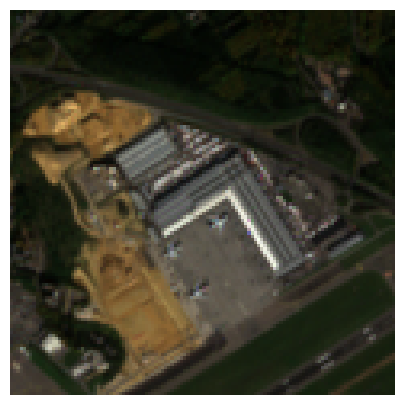


Labels:

- Airports
- Broad-leaved forest
- Discontinuous urban fabric
- Industrial or commercial units

Predictions:

Construction sites: 23.52%
Airports: 23.24%
Industrial or commercial units: 22.89%
Dump sites: 21.41%
Sport and leisure facilities: 21.01%
Continuous urban fabric: 19.90%
Discontinuous urban fabric: 19.52%
Port areas: 19.15%
Mineral extraction sites: 18.55%
Road and rail networks and associated land: 17.87%
Salines: 17.28%
Green urban areas: 17.04%
Water courses: 15.96%
Moors and heathland: 15.89%
Complex cultivation patterns: 15.69%
Intertidal flats: 14.79%
Inland marshes: 14.61%
Transitional woodland/shrub: 14.28%
Pastures: 13.92%
Salt marshes: 13.74%
Land principally occupied by agriculture, with significant areas of natural vegetation: 13.67%
Water bodies: 13.57%
Peatbogs: 13.39%
Vineyards: 13.14%
Annual crops associated with permanent crops: 13.00%
Rice fields: 12.90%
Bare rock: 12.74%
Sclerophyllous vegetation: 11.74%
Broad-leaved forest: 11.69%
Natural grasslan

In [ ]:
# Example with single image

image_id = 	'id_441746'
f = h5py.File(test_df_bigearthnet[test_df_bigearthnet.image_id == image_id].filename.item())

print("\nImage:", image_id, "\n")
r = f['04 - Red'][:]    # shape (n, n)
g = f['03 - Green'][:]  # shape (n, n)
b = f['02 - Blue'][:]   # shape (n, n)
rgb_image = np.stack([r, g, b], axis = -1) # shape (n, n, 3)
true_color = normalize(rgb_image)

plt.figure(figsize = (5, 5))
plt.imshow(true_color)
plt.axis('off')
plt.show()

print("\nLabels:\n")
for l in test_df_bigearthnet[test_df_bigearthnet.image_id == image_id].labels.item().strip("[]").split(','):
    print('-', l.strip(" '"))

image = GeoRSCLIP_preprocess(Image.fromarray((true_color * 255).astype(np.uint8))).unsqueeze(0).to(device)
text = tokenizer(['a satellite image of ' + l.lower() for l in bigearthnet_labels]).to(device)


with torch.no_grad():
    image_features = GeoRSCLIP_model.encode_image(image)
    text_features = GeoRSCLIP_model.encode_text(text)

image_features /= image_features.norm(dim=-1, keepdim=True)
text_features /= text_features.norm(dim=-1, keepdim=True)
similarity = image_features @ text_features.T
sigmoid = similarity[0].sigmoid()
#softmax = (100.0 * image_features @ text_features.T).softmax(dim=-1)

# Print the result
print("\nPredictions:\n")
for label, prob in sorted(zip(bigearthnet_labels, similarity[0]), key = lambda x: x[1], reverse = True):
    print(f"{label}: {100 * prob:.2f}%")

- Computing predictions

In [ ]:
add_top_predictions_with_batches_multilabel(
    test_df_bigearthnet,
    GeoRSCLIP_model,
    GeoRSCLIP_preprocess,
    device,
    bigearthnet_labels,
    ['04 - Red', '03 - Green', '02 - Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-bigearthnet_predictions_GeoRSCLIP_RGB.csv',
    tokenizer)

100%|██████████| 4/4 [16:04<00:00, 241.18s/it]


In [ ]:
output_df_georsclip_bigearthnet = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/output/m-bigearthnet_predictions_GeoRSCLIP_RGB.csv')
output_df_georsclip_bigearthnet.head()

,image_id,filename,bands,split,labels,ground_truth_binary_vector,Agro-forestry_areas_dotprod,Airports_dotprod,Annual_crops_associated_with_permanent_crops_dotprod,Bare_rock_dotprod,...,Sclerophyllous_vegetation_sigmoid,Sea_and_ocean_sigmoid,Sparsely_vegetated_areas_sigmoid,Sport_and_leisure_facilities_sigmoid,Transitional_woodland/shrub_sigmoid,Vineyards_sigmoid,Water_bodies_sigmoid,Water_courses_sigmoid,preds,pred_binary_vector
0,id_427032,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,12,test,"['Complex cultivation patterns', 'Discontinuou...","[0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, ...",0.104613,0.164443,0.194269,0.134242,...,0.540114,0.530442,0.535887,0.537891,0.537771,0.548796,0.539171,0.537569,"['Agro-forestry areas', 'Airports', 'Annual cr...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ..."
1,id_493029,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,12,test,"['Coniferous forest', 'Permanently irrigated l...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, ...",0.253518,0.230747,0.234773,0.244110,...,0.560936,0.546846,0.558426,0.551770,0.560405,0.555381,0.552531,0.551603,"['Agro-forestry areas', 'Airports', 'Annual cr...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ..."
2,id_513633,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,12,test,"['Burnt areas', 'Complex cultivation patterns'...","[0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, ...",0.169673,0.144192,0.202334,0.200318,...,0.554961,0.534972,0.547203,0.545912,0.550114,0.547695,0.542805,0.540102,"['Agro-forestry areas', 'Airports', 'Annual cr...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ..."
3,id_441746,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,12,test,"['Airports', 'Broad-leaved forest', 'Discontin...","[0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, ...",0.049279,0.232415,0.129964,0.127387,...,0.529320,0.526281,0.527188,0.552335,0.535633,0.532813,0.533882,0.539818,"['Agro-forestry areas', 'Airports', 'Annual cr...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ..."
4,id_510900,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,12,test,['Annual crops associated with permanent crops...,"[0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, ...",0.142383,0.167723,0.154142,0.193096,...,0.549745,0.534227,0.545677,0.547842,0.547324,0.543541,0.538784,0.540837,"['Agro-forestry areas', 'Airports', 'Annual cr...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ..."


In [ ]:
output_df_georsclip_bigearthnet.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Columns: 137 entries, image_id to pred_binary_vector
dtypes: float64(129), int64(1), object(7)
memory usage: 1.0+ MB


In [ ]:
output_df_georsclip_bigearthnet.pred_binary_vector.value_counts()

,count
pred_binary_vector,
"[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]",1000


In [ ]:
print("\nGeoRSCLIP Evaluation:\n")
# Computing mAP
print(f"Mean Average Precision (mAP): {compute_mAP(output_df_georsclip_bigearthnet):.4f}")
# Computing R@k
print(f"Recall@3: {compute_recall_at_k(output_df_georsclip_bigearthnet, k=3):.4f}")
print(f"Recall@5: {compute_recall_at_k(output_df_georsclip_bigearthnet, k=5):.4f}")
print(f"Recall@10: {compute_recall_at_k(output_df_georsclip_bigearthnet, k=10):.4f}")
# Computing P@k
print(f"Precision@3: {compute_precision_at_k(output_df_georsclip_bigearthnet, k=3):.4f}")
print(f"Precision@5: {compute_precision_at_k(output_df_georsclip_bigearthnet, k=5):.4f}")
print(f"Precision@10: {compute_precision_at_k(output_df_georsclip_bigearthnet, k=10):.4f}")
# Computin rloss
print(f"Ranking Loss: {compute_ranking_loss(output_df_georsclip_bigearthnet):.4f}")
# computing F1 scores
macro_f1, micro_f1 = compute_f1_scores_adaptive(output_df_georsclip_bigearthnet)
print(f"Macro F1 Score: {macro_f1:.4f}")
print(f"Micro F1 Score: {micro_f1:.4f}")


GeoRSCLIP Evaluation:

Mean Average Precision (mAP): 0.3969
Recall@3: 0.2699
Recall@5: 0.3889
Recall@10: 0.6036
Precision@3: 0.3243
Precision@5: 0.2860
Precision@10: 0.2268
Ranking Loss: 0.2319
Macro F1 Score: 0.2018
Micro F1 Score: 0.2215


## Loading SkyCLIP

- Downloading the model checkpoints:

In [ ]:
!curl -O https://opendatasharing.s3.us-west-2.amazonaws.com/SkyScript/ckpt/SkyCLIP_ViT_B32_top50pct.zip #{MODEL_NAME}

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 1445M  100 1445M    0     0  26.5M      0  0:00:54  0:00:54 --:--:-- 25.3M


In [ ]:
!unzip /content/SkyCLIP_ViT_B32_top50pct.zip

Archive:  /content/SkyCLIP_ViT_B32_top50pct.zip
   creating: SkyCLIP_ViT_B32_top50pct/
  inflating: SkyCLIP_ViT_B32_top50pct/epoch_20.pt  


In [ ]:
!git clone https://github.com/wangzhecheng/SkyScript.git

Cloning into 'SkyScript'...
remote: Enumerating objects: 192, done.
remote: Counting objects: 100% (192/192), done.
remote: Compressing objects: 100% (101/101), done.
remote: Total 192 (delta 102), reused 165 (delta 88), pack-reused 0 (from 0)
Receiving objects: 100% (192/192), 1.46 MiB | 27.63 MiB/s, done.
Resolving deltas: 100% (102/102), done.


In [ ]:
!pip install ftfy

In [ ]:
# List all installed packages and their version
#!pip list

# Check for single package version
import tqdm
print(tqdm.__version__)

4.67.1


In [ ]:
import torch
print(torch.__version__)

2.6.0+cu124


In [ ]:
import sys
sys.path.append('/content/SkyScript')

In [ ]:
import torch
from src.open_clip.factory import create_model_and_transforms, get_tokenizer
from torch.utils.data import Dataset, DataLoader
from src.training.precision import get_autocast

In [ ]:
model_arch_name = 'ViT-B-32' # or 'ViT-L-14'
ckpt_name = '/content/SkyCLIP_ViT_B32_top50pct/epoch_20.pt' # '/THE/PATH/TO/MODEL/CHECKPOINT' # replace this with the path to the .pt file (get from above)

device = "cuda" if torch.cuda.is_available() else "cpu"
print('device:', device)

device: cpu


> **NOTE**: to make it work, go into SkyScript > src > open_clip > factory.py and do the following:
  1. Add `import numpy` among imports
  2. Add `torch.serialization.add_safe_globals([numpy.core.multiarray.scalar])` after imports, just before functions definition
  3. In the function `load_state_dict` at line 93, in the `torch.load` function, set `weights_only = False`

In [ ]:
# torch.serialization.add_safe_globals([np.core.multiarray.scalar])
# torch.serialization.add_safe_globals([np.dtype])

def random_seed(seed=42, rank=0):
    torch.manual_seed(seed + rank)
    np.random.seed(seed + rank)
    random.seed(seed + rank)

#force_quick_gelu = True

random_seed(42, 0)
precision = 'amp'
autocast = get_autocast(precision)

#if 'ViT-B-32' in model_arch_name: # -> YES, it's our case

SkyCLIP_model, _, SkyCLIP_preprocess_val = create_model_and_transforms(
        model_arch_name,
        ckpt_name,
        precision=precision,
        device=device,
        output_dict=True,
    )

# else:
#     model, _, preprocess_val = create_model_and_transforms(
#             model_arch_name,
#             ckpt_name,
#             precision=precision,
#             device=device,
#             output_dict=True,
#             force_quick_gelu=force_quick_gelu,
#         )

tokenizer = get_tokenizer(model_arch_name)

In [ ]:
torch.serialization.get_unsafe_globals_in_checkpoint(ckpt_name)

['numpy.core.multiarray.scalar', 'numpy.dtype']

In [ ]:
SkyCLIP_model = SkyCLIP_model.eval()

### 1) m-brick-kiln

In [ ]:
brickkiln_labels = ['not brick kiln', 'brick kiln'] # original labels

add_top_predictions_with_batches_standard(
    test_df_brickkiln,
    SkyCLIP_model,
    SkyCLIP_preprocess_val,
    device,
    brickkiln_labels,
    ['04 - Red', '03 - Green', '02 - Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-brick-kiln_predictions_SkyCLIP_RGB.csv',
    tokenizer)

100%|██████████| 4/4 [10:41<00:00, 160.26s/it]


In [ ]:
output_df_skyclip = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/output/m-brick-kiln_predictions_SkyCLIP_RGB.csv')
output_df_skyclip.head()

,image_id,filename,bands,split,label,not_brick_kiln_dotprod,brick_kiln_dotprod,not_brick_kiln_softmax,brick_kiln_softmax,not_brick_kiln_sigmoid,brick_kiln_sigmoid,pred
0,examples_36_950,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.317185,0.315554,0.540701,0.459299,0.578638,0.578240,not brick kiln
1,examples_79_331,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,not brick kiln,0.288763,0.290476,0.457288,0.542712,0.571693,0.572113,brick kiln
2,examples_29_266,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.310381,0.309193,0.529654,0.470346,0.576978,0.576688,not brick kiln
3,examples_20_682,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,not brick kiln,0.325621,0.323447,0.554151,0.445849,0.580694,0.580164,not brick kiln
4,examples_63_819,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.326230,0.328449,0.444749,0.555251,0.580842,0.581382,brick kiln


In [ ]:
output_df_skyclip.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 999 entries, 0 to 998
Data columns (total 12 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   image_id                999 non-null    object 
 1   filename                999 non-null    object 
 2   bands                   999 non-null    int64  
 3   split                   999 non-null    object 
 4   label                   999 non-null    object 
 5   not_brick_kiln_dotprod  999 non-null    float64
 6   brick_kiln_dotprod      999 non-null    float64
 7   not_brick_kiln_softmax  999 non-null    float64
 8   brick_kiln_softmax      999 non-null    float64
 9   not_brick_kiln_sigmoid  999 non-null    float64
 10  brick_kiln_sigmoid      999 non-null    float64
 11  pred                    999 non-null    object 
dtypes: float64(6), int64(1), object(5)
memory usage: 93.8+ KB


In [ ]:
output_df_skyclip.pred.value_counts()

,pred
not brick kiln,577
brick kiln,422


In [ ]:
# Classification report and confusion matrix
labels = output_df_skyclip['label'].unique()
y_true = output_df_skyclip["label"]
y_pred = output_df_skyclip["pred"]

classification_report_and_cm(y_true, y_pred, labels)


Classification Report:

                precision    recall  f1-score   support

    brick kiln     0.4171    0.5238    0.4644       336
not brick kiln     0.7227    0.6290    0.6726       663

      accuracy                         0.5936       999
     macro avg     0.5699    0.5764    0.5685       999
  weighted avg     0.6199    0.5936    0.6026       999


Accuracy: 0.5936

Confusion matrix:

[[176 160]
 [246 417]]



In [ ]:
# ROC curves and AUC scores
# Binary: convert true_label to 0/1
output_df_skyclip["true_binary"] = output_df_skyclip["label"].map({"not brick kiln": 0, "brick kiln": 1})
y_true = output_df_skyclip["true_binary"]
y_scores = output_df_skyclip["brick_kiln_softmax"]

plot_auc(y_true, y_scores)

### m-brick-kiln (alt labels 1)

In [ ]:
# 1st set of alternative labels
custom_labels = ['other landscape',               # negative class
                 'a brick kiln construction']     # positive class

add_top_predictions_with_batches_standard(
    test_df_brickkiln,
    SkyCLIP_model,
    SkyCLIP_preprocess_val,
    device,
    custom_labels,
    ['04 - Red', '03 - Green', '02 - Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-brick-kiln_predictions_SkyCLIP_RGB_alt1.csv',
    tokenizer)

100%|██████████| 4/4 [04:03<00:00, 60.86s/it]


In [ ]:
output_df_skyclip1 = pd.read_csv( '/content/drive/MyDrive/Thesis CLIP4EO/output/m-brick-kiln_predictions_SkyCLIP_RGB_alt1.csv')
output_df_skyclip1.head()

,image_id,filename,bands,split,label,other_landscape_dotprod,a_brick_kiln_construction_dotprod,other_landscape_softmax,a_brick_kiln_construction_softmax,other_landscape_sigmoid,a_brick_kiln_construction_sigmoid,pred
0,examples_36_950,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.317497,0.310365,0.671109,0.328891,0.578714,0.576974,other landscape
1,examples_79_331,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,not brick kiln,0.334433,0.271648,0.998127,0.001873,0.582838,0.567497,other landscape
2,examples_29_266,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.321333,0.291672,0.951020,0.048980,0.579649,0.572405,other landscape
3,examples_20_682,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,not brick kiln,0.329952,0.305345,0.921344,0.078656,0.581748,0.575749,other landscape
4,examples_63_819,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.318549,0.311015,0.679923,0.320077,0.578971,0.577133,other landscape


In [ ]:
output_df_skyclip1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 999 entries, 0 to 998
Data columns (total 12 columns):
 #   Column                             Non-Null Count  Dtype  
---  ------                             --------------  -----  
 0   image_id                           999 non-null    object 
 1   filename                           999 non-null    object 
 2   bands                              999 non-null    int64  
 3   split                              999 non-null    object 
 4   label                              999 non-null    object 
 5   other_landscape_dotprod            999 non-null    float64
 6   a_brick_kiln_construction_dotprod  999 non-null    float64
 7   other_landscape_softmax            999 non-null    float64
 8   a_brick_kiln_construction_softmax  999 non-null    float64
 9   other_landscape_sigmoid            999 non-null    float64
 10  a_brick_kiln_construction_sigmoid  999 non-null    float64
 11  pred                               999 non-null    object 

In [ ]:
output_df_skyclip1.pred.value_counts()

,pred
other landscape,960
a brick kiln construction,39


In [ ]:
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
import plotly.express as px

labels = output_df_skyclip1['label'].unique()
y_true = output_df_skyclip1["label"]
y_pred = output_df_skyclip1["pred"].map({"other landscape": "not brick kiln",
                                         "a brick kiln construction": "brick kiln"})

classification_report_and_cm(y_true, y_pred, labels)


Classification Report:

                precision    recall  f1-score   support

    brick kiln     0.8462    0.0982    0.1760       336
not brick kiln     0.6844    0.9910    0.8096       663

      accuracy                         0.6907       999
     macro avg     0.7653    0.5446    0.4928       999
  weighted avg     0.7388    0.6907    0.5965       999


Accuracy: 0.6907

Confusion matrix:

[[ 33 303]
 [  6 657]]



In [ ]:
# ROC curve and AUC
# Binary: convert true_label to 0/1
output_df_skyclip1["true_binary"] = output_df_skyclip1["label"].map({"not brick kiln": 0, "brick kiln": 1})
y_true = output_df_skyclip1["true_binary"]
y_scores = output_df_skyclip1["a_brick_kiln_construction_softmax"]

plot_auc(y_true, y_scores)

### m-brick-kiln (alt labels 2)

In [ ]:
# Use best-performing prompts based on CLIP experiments
custom_labels = ['some landscape',                # negative class
                 'a brick kiln construction']     # positive class

add_top_predictions_with_batches_standard(
    test_df_brickkiln,
    SkyCLIP_model,
    SkyCLIP_preprocess_val,
    device,
    custom_labels,
    ['04 - Red', '03 - Green', '02 - Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-brick-kiln_predictions_SkyCLIP_RGB_alt2.csv',
    tokenizer)

100%|██████████| 4/4 [04:45<00:00, 71.28s/it]


In [ ]:
output_df_skyclip2 = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/output/m-brick-kiln_predictions_SkyCLIP_RGB_alt2.csv')
output_df_skyclip2.head()

,image_id,filename,bands,split,label,some_landscape_dotprod,a_brick_kiln_construction_dotprod,some_landscape_softmax,a_brick_kiln_construction_softmax,some_landscape_sigmoid,a_brick_kiln_construction_sigmoid,pred
0,examples_36_950,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.315611,0.310365,0.628214,0.371786,0.578254,0.576974,some landscape
1,examples_79_331,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,not brick kiln,0.338064,0.271648,0.998697,0.001303,0.583720,0.567497,some landscape
2,examples_29_266,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.320928,0.291672,0.949099,0.050901,0.579550,0.572405,some landscape
3,examples_20_682,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,not brick kiln,0.328950,0.305345,0.913765,0.086235,0.581504,0.575749,some landscape
4,examples_63_819,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.318064,0.311015,0.669275,0.330725,0.578852,0.577133,some landscape


In [ ]:
output_df_skyclip2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 999 entries, 0 to 998
Data columns (total 12 columns):
 #   Column                             Non-Null Count  Dtype  
---  ------                             --------------  -----  
 0   image_id                           999 non-null    object 
 1   filename                           999 non-null    object 
 2   bands                              999 non-null    int64  
 3   split                              999 non-null    object 
 4   label                              999 non-null    object 
 5   some_landscape_dotprod             999 non-null    float64
 6   a_brick_kiln_construction_dotprod  999 non-null    float64
 7   some_landscape_softmax             999 non-null    float64
 8   a_brick_kiln_construction_softmax  999 non-null    float64
 9   some_landscape_sigmoid             999 non-null    float64
 10  a_brick_kiln_construction_sigmoid  999 non-null    float64
 11  pred                               999 non-null    object 

In [ ]:
output_df_skyclip2.pred.value_counts()

,pred
some landscape,958
a brick kiln construction,41


In [ ]:
# Classification report and confusion matrix
labels = output_df_skyclip2['label'].unique()
y_true = output_df_skyclip2["label"]
y_pred = output_df_skyclip2["pred"].map({"some landscape": "not brick kiln",
                                         "a brick kiln construction": "brick kiln"})

classification_report_and_cm(y_true, y_pred, labels)


Classification Report:

                precision    recall  f1-score   support

    brick kiln     0.8537    0.1042    0.1857       336
not brick kiln     0.6858    0.9910    0.8106       663

      accuracy                         0.6927       999
     macro avg     0.7697    0.5476    0.4981       999
  weighted avg     0.7423    0.6927    0.6004       999


Accuracy: 0.6927

Confusion matrix:

[[ 35 301]
 [  6 657]]



In [ ]:
# ROC curves and AUC scores
# Binary: convert true_label to 0/1
output_df_skyclip2["true_binary"] = output_df_skyclip2["label"].map({"not brick kiln": 0, "brick kiln": 1})
y_true = output_df_skyclip2["true_binary"]
y_scores = output_df_skyclip2["a_brick_kiln_construction_softmax"]

plot_auc(y_true, y_scores)

### m-brick-kiln (alt labels 3)

In [ ]:
del output_df_skyclip1

In [ ]:
# 3rd set of alternative labels
custom_labels = ['some other landscape',          # negative class
                 'a brick kiln construction']     # positive class

add_top_predictions_with_batches_standard(
    test_df_brickkiln,
    SkyCLIP_model,
    SkyCLIP_preprocess_val,
    device,
    custom_labels,
    ['04 - Red', '03 - Green', '02 - Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-brick-kiln_predictions_SkyCLIP_RGB_alt3.csv',
    tokenizer)

100%|██████████| 4/4 [04:02<00:00, 60.68s/it]


In [ ]:
output_df_skyclip3 = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/output/m-brick-kiln_predictions_SkyCLIP_RGB_alt3.csv')
output_df_skyclip3.head()

,image_id,filename,bands,split,label,some_other_landscape_dotprod,a_brick_kiln_construction_dotprod,some_other_landscape_softmax,a_brick_kiln_construction_softmax,some_other_landscape_sigmoid,a_brick_kiln_construction_sigmoid,pred
0,examples_36_950,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.317744,0.310365,0.676539,0.323461,0.578774,0.576974,some other landscape
1,examples_79_331,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,not brick kiln,0.334443,0.271648,0.998129,0.001871,0.582840,0.567497,some other landscape
2,examples_29_266,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.321680,0.291672,0.952611,0.047389,0.579734,0.572405,some other landscape
3,examples_20_682,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,not brick kiln,0.329441,0.305345,0.917560,0.082440,0.581623,0.575749,some other landscape
4,examples_63_819,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.318100,0.311015,0.670063,0.329937,0.578861,0.577133,some other landscape


In [ ]:
output_df_skyclip3.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 999 entries, 0 to 998
Data columns (total 12 columns):
 #   Column                             Non-Null Count  Dtype  
---  ------                             --------------  -----  
 0   image_id                           999 non-null    object 
 1   filename                           999 non-null    object 
 2   bands                              999 non-null    int64  
 3   split                              999 non-null    object 
 4   label                              999 non-null    object 
 5   some_other_landscape_dotprod       999 non-null    float64
 6   a_brick_kiln_construction_dotprod  999 non-null    float64
 7   some_other_landscape_softmax       999 non-null    float64
 8   a_brick_kiln_construction_softmax  999 non-null    float64
 9   some_other_landscape_sigmoid       999 non-null    float64
 10  a_brick_kiln_construction_sigmoid  999 non-null    float64
 11  pred                               999 non-null    object 

In [ ]:
output_df_skyclip3.pred.value_counts()

,pred
some other landscape,959
a brick kiln construction,40


In [ ]:
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
import plotly.express as px

labels = output_df_skyclip3['label'].unique()
y_true = output_df_skyclip3["label"]
y_pred = output_df_skyclip3["pred"].map({"some other landscape": "not brick kiln",
                                         "a brick kiln construction": "brick kiln"})

classification_report_and_cm(y_true, y_pred, labels)


Classification Report:

                precision    recall  f1-score   support

    brick kiln     0.8500    0.1012    0.1809       336
not brick kiln     0.6851    0.9910    0.8101       663

      accuracy                         0.6917       999
     macro avg     0.7675    0.5461    0.4955       999
  weighted avg     0.7406    0.6917    0.5985       999


Accuracy: 0.6917

Confusion matrix:

[[ 34 302]
 [  6 657]]



In [ ]:
# AUC
# Binary: convert true_label to 0/1
output_df_skyclip3["true_binary"] = output_df_skyclip3["label"].map({"not brick kiln": 0, "brick kiln": 1})
y_true = output_df_skyclip3["true_binary"]
y_scores = output_df_skyclip3["a_brick_kiln_construction_softmax"]

plot_auc(y_true, y_scores)

### m-brick-kiln (alt multi)

In [ ]:
del output_df_skyclip3

In [ ]:
# Multi-prompts for the negative class
custom_labels = ['barren terrain',                # negative class(es)
                 'a green forested area',
                 'an agricultural area',
                 'a brick kiln construction']     # positive class

add_top_predictions_with_batches_standard(
    test_df_brickkiln,
    SkyCLIP_model,
    SkyCLIP_preprocess_val,
    device,
    custom_labels,
    ['04 - Red', '03 - Green', '02 - Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-brick-kiln_predictions_SkyCLIP_RGB_alt_multi.csv',
    tokenizer)

100%|██████████| 4/4 [04:22<00:00, 65.54s/it]


In [ ]:
output_df_skyclip = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/output/m-brick-kiln_predictions_SkyCLIP_RGB_alt_multi.csv')
output_df_skyclip.head()

,image_id,filename,bands,split,label,barren_terrain_dotprod,a_green_forested_area_dotprod,an_agricultural_area_dotprod,a_brick_kiln_construction_dotprod,barren_terrain_softmax,a_green_forested_area_softmax,an_agricultural_area_softmax,a_brick_kiln_construction_softmax,barren_terrain_sigmoid,a_green_forested_area_sigmoid,an_agricultural_area_sigmoid,a_brick_kiln_construction_sigmoid,pred
0,examples_36_950,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.295724,0.295073,0.308745,0.310365,0.100626,0.094285,0.370019,0.435070,0.573397,0.573238,0.576579,0.576974,a brick kiln construction
1,examples_79_331,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,not brick kiln,0.320989,0.342148,0.322433,0.271648,0.095612,0.793235,0.110465,0.000688,0.579565,0.584712,0.579917,0.567497,a green forested area
2,examples_29_266,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.296132,0.324229,0.327934,0.291672,0.023642,0.392594,0.568629,0.015135,0.573497,0.580355,0.581257,0.572405,an agricultural area
3,examples_20_682,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,not brick kiln,0.311572,0.320039,0.337871,0.305345,0.056370,0.131446,0.781944,0.030240,0.577269,0.579334,0.583673,0.575749,an agricultural area
4,examples_63_819,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,brick kiln,0.284576,0.297231,0.340594,0.311015,0.003454,0.012244,0.935712,0.048591,0.570668,0.573765,0.584335,0.577133,an agricultural area


In [ ]:
output_df_skyclip.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 999 entries, 0 to 998
Data columns (total 18 columns):
 #   Column                             Non-Null Count  Dtype  
---  ------                             --------------  -----  
 0   image_id                           999 non-null    object 
 1   filename                           999 non-null    object 
 2   bands                              999 non-null    int64  
 3   split                              999 non-null    object 
 4   label                              999 non-null    object 
 5   barren_terrain_dotprod             999 non-null    float64
 6   a_green_forested_area_dotprod      999 non-null    float64
 7   an_agricultural_area_dotprod       999 non-null    float64
 8   a_brick_kiln_construction_dotprod  999 non-null    float64
 9   barren_terrain_softmax             999 non-null    float64
 10  a_green_forested_area_softmax      999 non-null    float64
 11  an_agricultural_area_softmax       999 non-null    float64

In [ ]:
output_df_skyclip.pred.value_counts()

,pred
an agricultural area,582
a green forested area,348
barren terrain,55
a brick kiln construction,14


In [ ]:
# Classification report and confusion matrix
labels = output_df_skyclip['label'].unique()
y_true = output_df_skyclip["label"]
y_pred = output_df_skyclip["pred"].map({'barren terrain': 'not brick kiln',           # negative class(es)
                                        'a green forested area': 'not brick kiln',
                                        'an agricultural area': 'not brick kiln',
                                        'a brick kiln construction': 'brick kiln'})   # positive class

classification_report_and_cm(y_true, y_pred, labels)


Classification Report:

                precision    recall  f1-score   support

    brick kiln     0.9286    0.0387    0.0743       336
not brick kiln     0.6721    0.9985    0.8034       663

      accuracy                         0.6757       999
     macro avg     0.8003    0.5186    0.4388       999
  weighted avg     0.7583    0.6757    0.5582       999


Accuracy: 0.6757

Confusion matrix:

[[ 13 323]
 [  1 662]]



In [ ]:
# ROC curve and AUC
# Binary: convert true_label to 0/1
output_df_skyclip["true_binary"] = output_df_skyclip["label"].map({"not brick kiln": 0, "brick kiln": 1})
y_true = output_df_skyclip["true_binary"]
y_scores = output_df_skyclip["a_brick_kiln_construction_softmax"]

plot_auc(y_true, y_scores)

### 2) m-pv4ger

In [ ]:
pv4ger_labels = ['no solar pv', 'solar pv'] # original labels

add_top_predictions_with_batches_standard(
    test_df_pv4ger,
    SkyCLIP_model,
    SkyCLIP_preprocess_val,
    device,
    pv4ger_labels,
    ['Red', 'Green', 'Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-pv4ger_predictions_SkyCLIP_RGB.csv',
    tokenizer)

100%|██████████| 4/4 [11:00<00:00, 165.06s/it]


In [ ]:
output_df_skyclip = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/output/m-pv4ger_predictions_SkyCLIP_RGB.csv')
output_df_skyclip.head()

,image_id,filename,bands,split,label,no_solar_pv_dotprod,solar_pv_dotprod,no_solar_pv_softmax,solar_pv_softmax,no_solar_pv_sigmoid,solar_pv_sigmoid,pred
0,"7.222180076676272, 50.698836440699615",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.299946,0.291554,0.698292,0.301708,0.574429,0.572377,no solar pv
1,"6.669612320016594, 51.73787665131514",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.314569,0.304442,0.733545,0.266455,0.578000,0.575528,no solar pv
2,"6.339084510786531, 51.22087464650394",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.287685,0.280928,0.662760,0.337240,0.571429,0.569774,no solar pv
3,"8.724089525367726, 51.77399340700887",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.319779,0.311990,0.685452,0.314548,0.579270,0.577371,no solar pv
4,"7.8016608434245205, 52.243655122484405",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.290743,0.277192,0.794957,0.205043,0.572178,0.568858,no solar pv


In [ ]:
output_df_skyclip.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 999 entries, 0 to 998
Data columns (total 12 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   image_id             999 non-null    object 
 1   filename             999 non-null    object 
 2   bands                999 non-null    int64  
 3   split                999 non-null    object 
 4   label                999 non-null    object 
 5   no_solar_pv_dotprod  999 non-null    float64
 6   solar_pv_dotprod     999 non-null    float64
 7   no_solar_pv_softmax  999 non-null    float64
 8   solar_pv_softmax     999 non-null    float64
 9   no_solar_pv_sigmoid  999 non-null    float64
 10  solar_pv_sigmoid     999 non-null    float64
 11  pred                 999 non-null    object 
dtypes: float64(6), int64(1), object(5)
memory usage: 93.8+ KB


In [ ]:
output_df_skyclip.pred.value_counts()

,pred
no solar pv,918
solar pv,81


In [ ]:
# Classification report and confusion matrix
labels = output_df_skyclip['label'].unique()
y_true = output_df_skyclip["label"]
y_pred = output_df_skyclip["pred"]

classification_report_and_cm(y_true, y_pred, labels)


Classification Report:

              precision    recall  f1-score   support

 no solar pv     0.9096    0.9870    0.9467       846
    solar pv     0.8642    0.4575    0.5983       153

    accuracy                         0.9059       999
   macro avg     0.8869    0.7223    0.7725       999
weighted avg     0.9026    0.9059    0.8934       999


Accuracy: 0.9059

Confusion matrix:

[[835  11]
 [ 83  70]]



In [ ]:
# ROC curves and AUC scores
# Binary: convert true_label to 0/1
output_df_skyclip["true_binary"] = output_df_skyclip["label"].map({'no solar pv' : 0, 'solar pv': 1})
y_true = output_df_skyclip["true_binary"]
y_scores = output_df_skyclip["solar_pv_softmax"]

plot_auc(y_true, y_scores)

### m-pv4ger (alt labels 1)

In [ ]:
# 1st set of alternative labels
custom_labels = ['other scenery',                  # negative class  # "other" si riferisce a che? -> prova prompt senza
                 'a solar photovoltaic system']    # positive class

add_top_predictions_with_batches_standard(
    test_df_pv4ger,
    SkyCLIP_model,
    SkyCLIP_preprocess_val,
    device,
    custom_labels,
    ['Red', 'Green', 'Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-pv4ger_predictions_SkyCLIP_RGB_alt1.csv',
    tokenizer)

100%|██████████| 4/4 [03:57<00:00, 59.40s/it]


In [ ]:
output_df_skyclip1 = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/output/m-pv4ger_predictions_SkyCLIP_RGB_alt1.csv')
output_df_skyclip1.head()

,image_id,filename,bands,split,label,other_scenery_dotprod,a_solar_photovoltaic_system_dotprod,other_scenery_softmax,a_solar_photovoltaic_system_softmax,other_scenery_sigmoid,a_solar_photovoltaic_system_sigmoid,pred
0,"7.222180076676272, 50.698836440699615",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.346076,0.280195,0.998625,0.001375,0.585666,0.569594,other scenery
1,"6.669612320016594, 51.73787665131514",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.332546,0.295450,0.976097,0.023903,0.582379,0.573330,other scenery
2,"6.339084510786531, 51.22087464650394",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.290306,0.267858,0.904197,0.095803,0.572071,0.566567,other scenery
3,"8.724089525367726, 51.77399340700887",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.345464,0.303808,0.984717,0.015283,0.585517,0.575373,other scenery
4,"7.8016608434245205, 52.243655122484405",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.314119,0.265886,0.992024,0.007976,0.577890,0.566083,other scenery


In [ ]:
output_df_skyclip1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 999 entries, 0 to 998
Data columns (total 12 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   image_id                             999 non-null    object 
 1   filename                             999 non-null    object 
 2   bands                                999 non-null    int64  
 3   split                                999 non-null    object 
 4   label                                999 non-null    object 
 5   other_scenery_dotprod                999 non-null    float64
 6   a_solar_photovoltaic_system_dotprod  999 non-null    float64
 7   other_scenery_softmax                999 non-null    float64
 8   a_solar_photovoltaic_system_softmax  999 non-null    float64
 9   other_scenery_sigmoid                999 non-null    float64
 10  a_solar_photovoltaic_system_sigmoid  999 non-null    float64
 11  pred                            

In [ ]:
output_df_skyclip1.pred.value_counts()

,pred
other scenery,792
a solar photovoltaic system,207


In [ ]:
# Classification report and confusion matrix
labels = output_df_skyclip1['label'].unique()
y_true = output_df_skyclip1["label"]
y_pred = output_df_skyclip1["pred"].map({"other scenery": "no solar pv",
                                           "a solar photovoltaic system": "solar pv"})

classification_report_and_cm(y_true, y_pred, labels)


Classification Report:

              precision    recall  f1-score   support

 no solar pv     0.9836    0.9208    0.9512       846
    solar pv     0.6763    0.9150    0.7778       153

    accuracy                         0.9199       999
   macro avg     0.8300    0.9179    0.8645       999
weighted avg     0.9365    0.9199    0.9246       999


Accuracy: 0.9199

Confusion matrix:

[[779  67]
 [ 13 140]]



In [ ]:
# ROC curve and AUC
# Binary: convert true_label to 0/1
output_df_skyclip1["true_binary"] = output_df_skyclip1["label"].map({"no solar pv": 0, "solar pv": 1})
y_true = output_df_skyclip1["true_binary"]
y_scores = output_df_skyclip1["a_solar_photovoltaic_system_softmax"]

plot_auc(y_true, y_scores)

### m-pv4ger (alt labels 2)

In [ ]:
custom_labels = ['some scenery',                   # negative class
                 'a solar photovoltaic system']    # positive class

add_top_predictions_with_batches_standard(
    test_df_pv4ger,
    SkyCLIP_model,
    SkyCLIP_preprocess_val,
    device,
    custom_labels,
    ['Red', 'Green', 'Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-pv4ger_predictions_SkyCLIP_RGB_alt2.csv',
    tokenizer)

100%|██████████| 4/4 [04:45<00:00, 71.32s/it]


In [ ]:
# output_df_skyclip2.to_csv('/content/drive/MyDrive/Thesis CLIP4EO/output/m-pv4ger_predictions_SkyCLIP_RGB_alt2.csv',
#                           mode = 'w', index = False, header  = True)

In [ ]:
output_df_skyclip2 = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/output/m-pv4ger_predictions_SkyCLIP_RGB_alt2.csv')
output_df_skyclip2.head()

,image_id,filename,bands,split,label,some_scenery_dotprod,a_solar_photovoltaic_system_dotprod,some_scenery_softmax,a_solar_photovoltaic_system_softmax,some_scenery_sigmoid,a_solar_photovoltaic_system_sigmoid,pred
0,"7.222180076676272, 50.698836440699615",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.347298,0.280195,0.998783,0.001217,0.585962,0.569594,some scenery
1,"6.669612320016594, 51.73787665131514",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.332208,0.295450,0.975296,0.024704,0.582296,0.573330,some scenery
2,"6.339084510786531, 51.22087464650394",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.288432,0.267858,0.886693,0.113307,0.571612,0.566567,some scenery
3,"8.724089525367726, 51.77399340700887",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.347804,0.303808,0.987867,0.012133,0.586085,0.575373,some scenery
4,"7.8016608434245205, 52.243655122484405",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.311690,0.265886,0.989853,0.010147,0.577298,0.566083,some scenery


In [ ]:
output_df_skyclip2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 999 entries, 0 to 998
Data columns (total 12 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   image_id                             999 non-null    object 
 1   filename                             999 non-null    object 
 2   bands                                999 non-null    int64  
 3   split                                999 non-null    object 
 4   label                                999 non-null    object 
 5   some_scenery_dotprod                 999 non-null    float64
 6   a_solar_photovoltaic_system_dotprod  999 non-null    float64
 7   some_scenery_softmax                 999 non-null    float64
 8   a_solar_photovoltaic_system_softmax  999 non-null    float64
 9   some_scenery_sigmoid                 999 non-null    float64
 10  a_solar_photovoltaic_system_sigmoid  999 non-null    float64
 11  pred                            

In [ ]:
# Classification report and confusion matrix
labels = output_df_skyclip2['label'].unique()
y_true = output_df_skyclip2["label"]
y_pred = output_df_skyclip2["pred"].map({"some scenery": "no solar pv",
                                         "a solar photovoltaic system": "solar pv"})

classification_report_and_cm(y_true, y_pred, labels)


Classification Report:

              precision    recall  f1-score   support

 no solar pv     0.9871    0.9031    0.9432       846
    solar pv     0.6356    0.9346    0.7566       153

    accuracy                         0.9079       999
   macro avg     0.8113    0.9189    0.8499       999
weighted avg     0.9332    0.9079    0.9146       999


Accuracy: 0.9079

Confusion matrix:

[[764  82]
 [ 10 143]]



In [ ]:
# ROC curves and AUC scores
# Binary: convert true_label to 0/1
output_df_skyclip2["true_binary"] = output_df_skyclip2["label"].map({"no solar pv": 0, "solar pv": 1})
y_true = output_df_skyclip2["true_binary"]
y_scores = output_df_skyclip2["a_solar_photovoltaic_system_softmax"]

plot_auc(y_true, y_scores)

### m-pv4ger (alt labels 3)

In [ ]:
del output_df_skyclip2

In [ ]:
# 3rd set of alternative labels
custom_labels = ['some other scenery',            # negative class
                 'a solar photovoltaic system']   # positive class

add_top_predictions_with_batches_standard(
    test_df_pv4ger,
    SkyCLIP_model,
    SkyCLIP_preprocess_val,
    device,
    custom_labels,
    ['Red', 'Green', 'Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-pv4ger_predictions_SkyCLIP_RGB_alt3.csv',
    tokenizer)

100%|██████████| 4/4 [03:55<00:00, 58.79s/it]


In [ ]:
output_df_skyclip3 = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/output/m-pv4ger_predictions_SkyCLIP_RGB_alt3.csv')
output_df_skyclip3.head()

,image_id,filename,bands,split,label,some_other_scenery_dotprod,a_solar_photovoltaic_system_dotprod,some_other_scenery_softmax,a_solar_photovoltaic_system_softmax,some_other_scenery_sigmoid,a_solar_photovoltaic_system_sigmoid,pred
0,"7.222180076676272, 50.698836440699615",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.345011,0.280195,0.998471,0.001529,0.585407,0.569594,some other scenery
1,"6.669612320016594, 51.73787665131514",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.333159,0.295450,0.977486,0.022513,0.582528,0.573330,some other scenery
2,"6.339084510786531, 51.22087464650394",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.288443,0.267858,0.886803,0.113197,0.571615,0.566567,some other scenery
3,"8.724089525367726, 51.77399340700887",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.345293,0.303808,0.984458,0.015542,0.585476,0.575373,some other scenery
4,"7.8016608434245205, 52.243655122484405",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.314875,0.265886,0.992601,0.007399,0.578075,0.566083,some other scenery


In [ ]:
output_df_skyclip3.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 999 entries, 0 to 998
Data columns (total 12 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   image_id                             999 non-null    object 
 1   filename                             999 non-null    object 
 2   bands                                999 non-null    int64  
 3   split                                999 non-null    object 
 4   label                                999 non-null    object 
 5   some_other_scenery_dotprod           999 non-null    float64
 6   a_solar_photovoltaic_system_dotprod  999 non-null    float64
 7   some_other_scenery_softmax           999 non-null    float64
 8   a_solar_photovoltaic_system_softmax  999 non-null    float64
 9   some_other_scenery_sigmoid           999 non-null    float64
 10  a_solar_photovoltaic_system_sigmoid  999 non-null    float64
 11  pred                            

In [ ]:
output_df_skyclip3.pred.value_counts()

,pred
some other scenery,790
a solar photovoltaic system,209


In [ ]:
# Classification report and confusion matrix
labels = output_df_skyclip3['label'].unique()
y_true = output_df_skyclip3["label"]
y_pred = output_df_skyclip3["pred"].map({"some other scenery": "no solar pv",
                                         "a solar photovoltaic system": "solar pv"})

classification_report_and_cm(y_true, y_pred, labels)


Classification Report:

              precision    recall  f1-score   support

 no solar pv     0.9823    0.9173    0.9487       846
    solar pv     0.6651    0.9085    0.7680       153

    accuracy                         0.9159       999
   macro avg     0.8237    0.9129    0.8583       999
weighted avg     0.9337    0.9159    0.9210       999


Accuracy: 0.9159

Confusion matrix:

[[776  70]
 [ 14 139]]



In [ ]:
# ROC curve and AUC
# Binary: convert true_label to 0/1
output_df_skyclip3["true_binary"] = output_df_skyclip3["label"].map({"no solar pv": 0, "solar pv": 1})
y_true = output_df_skyclip3["true_binary"]
y_scores = output_df_skyclip3["a_solar_photovoltaic_system_softmax"]

plot_auc(y_true, y_scores)

### m-pv4ger (alt multi)

In [ ]:
del output_df_skyclip3

In [ ]:
# Multi-prompts for the negative class
custom_labels = ['an urban setting',                # negative class(es)
                 'a green forested area',
                 'an agricultural area',
                 'a solar photovoltaic system']     # positive class

add_top_predictions_with_batches_standard(
    test_df_pv4ger,
    SkyCLIP_model,
    SkyCLIP_preprocess_val,
    device,
    custom_labels,
    ['Red', 'Green', 'Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-pv4ger_predictions_SkyCLIP_RGB_alt_multi.csv',
    tokenizer)

100%|██████████| 4/4 [04:28<00:00, 67.14s/it]


In [ ]:
output_df_skyclip = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/output/m-pv4ger_predictions_SkyCLIP_RGB_alt_multi.csv')
output_df_skyclip.head()

,image_id,filename,bands,split,label,an_urban_setting_dotprod,a_green_forested_area_dotprod,an_agricultural_area_dotprod,a_solar_photovoltaic_system_dotprod,an_urban_setting_softmax,a_green_forested_area_softmax,an_agricultural_area_softmax,a_solar_photovoltaic_system_softmax,an_urban_setting_sigmoid,a_green_forested_area_sigmoid,an_agricultural_area_sigmoid,a_solar_photovoltaic_system_sigmoid,pred
0,"7.222180076676272, 50.698836440699615",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.302624,0.349358,0.311794,0.280195,0.009036,0.967400,0.022606,0.000959,0.575084,0.586462,0.577323,0.569594,a green forested area
1,"6.669612320016594, 51.73787665131514",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.301948,0.353980,0.316612,0.295450,0.005327,0.968804,0.023087,0.002782,0.574919,0.587582,0.578498,0.573330,a green forested area
2,"6.339084510786531, 51.22087464650394",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.260916,0.273328,0.316018,0.267858,0.003942,0.013640,0.974524,0.007893,0.564861,0.567910,0.578353,0.566567,an agricultural area
3,"8.724089525367726, 51.77399340700887",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.306781,0.356367,0.317506,0.303808,0.006800,0.968274,0.019875,0.005051,0.576099,0.588161,0.578716,0.575373,a green forested area
4,"7.8016608434245205, 52.243655122484405",/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,3,test,no solar pv,0.287621,0.276983,0.279870,0.265886,0.520935,0.179811,0.239982,0.059272,0.571414,0.568806,0.569514,0.566083,an urban setting


In [ ]:
output_df_skyclip.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 999 entries, 0 to 998
Data columns (total 18 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   image_id                             999 non-null    object 
 1   filename                             999 non-null    object 
 2   bands                                999 non-null    int64  
 3   split                                999 non-null    object 
 4   label                                999 non-null    object 
 5   an_urban_setting_dotprod             999 non-null    float64
 6   a_green_forested_area_dotprod        999 non-null    float64
 7   an_agricultural_area_dotprod         999 non-null    float64
 8   a_solar_photovoltaic_system_dotprod  999 non-null    float64
 9   an_urban_setting_softmax             999 non-null    float64
 10  a_green_forested_area_softmax        999 non-null    float64
 11  an_agricultural_area_softmax    

In [ ]:
output_df_skyclip.pred.value_counts()

,pred
a green forested area,432
an agricultural area,304
a solar photovoltaic system,198
an urban setting,65


In [ ]:
# Classification report and confusion matrix
labels = output_df_skyclip['label'].unique()
y_true = output_df_skyclip["label"]
y_pred = output_df_skyclip["pred"].map({"an urban setting": "no solar pv",
                                        "a green forested area": "no solar pv",
                                        "an agricultural area": "no solar pv",
                                        "a solar photovoltaic system": "solar pv"})

classification_report_and_cm(y_true, y_pred, labels)


Classification Report:

              precision    recall  f1-score   support

 no solar pv     0.9788    0.9267    0.9520       846
    solar pv     0.6869    0.8889    0.7749       153

    accuracy                         0.9209       999
   macro avg     0.8328    0.9078    0.8635       999
weighted avg     0.9341    0.9209    0.9249       999


Accuracy: 0.9209

Confusion matrix:

[[784  62]
 [ 17 136]]



In [ ]:
# ROC curve and AUC
# Binary: convert true_label to 0/1
output_df_skyclip["true_binary"] = output_df_skyclip["label"].map({"no solar pv": 0, "solar pv": 1})
y_true = output_df_skyclip["true_binary"]
y_scores = output_df_skyclip["a_solar_photovoltaic_system_softmax"]

plot_auc(y_true, y_scores)

### 3) m-forestnet

In [ ]:
forestnet_labels

['Oil palm plantation',
 'Timber plantation',
 'Other large-scale plantations',
 'Grassland shrubland',
 'Small-scale agriculture',
 'Small-scale mixed plantation',
 'Small-scale oil palm plantation',
 'Mining',
 'Fish pond',
 'Logging',
 'Secondary forest',
 'Other']

In [ ]:
forestnet_labels = ['Oil palm plantation',
                    'Timber plantation',
                    'Other large-scale plantations',
                    'Grassland shrubland',
                    'Small-scale agriculture',
                    'Small-scale mixed plantation',
                    'Small-scale oil palm plantation',
                    'Mining',
                    'Fish pond',
                    'Logging',
                    'Secondary forest',
                    'Other'] # original labels

add_top_predictions_with_batches_forestnet(
    test_df_forestnet,
    SkyCLIP_model,
    SkyCLIP_preprocess_val,
    device,
    forestnet_labels,
    ['04 - Red', '03 - Green', '02 - Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-forestnet_predictions_SkyCLIP_RGB.csv',
    tokenizer)

100%|██████████| 4/4 [13:57<00:00, 209.27s/it]


In [ ]:
output_df_skyclip = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/output/m-forestnet_predictions_SkyCLIP_RGB.csv')
output_df_skyclip.head()

,image_id,filename,bands,split,label,Oil_palm_plantation_dotprod,Timber_plantation_dotprod,Other_large-scale_plantations_dotprod,Grassland_shrubland_dotprod,Small-scale_agriculture_dotprod,...,Grassland_shrubland_sigmoid,Small-scale_agriculture_sigmoid,Small-scale_mixed_plantation_sigmoid,Small-scale_oil_palm_plantation_sigmoid,Mining_sigmoid,Fish_pond_sigmoid,Logging_sigmoid,Secondary_forest_sigmoid,Other_sigmoid,pred
0,-1.358752546215941_113.47632662109709_2014_01_01,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,6,test,Oil palm plantation,0.316232,0.332217,0.324156,0.312642,0.302907,...,0.577530,0.575153,0.577083,0.579416,0.574170,0.572456,0.580317,0.583207,0.575348,Secondary forest
1,-0.3909200308691534_116.02049649124226_2015_01_01,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,6,test,Oil palm plantation,0.360801,0.357915,0.362745,0.336289,0.351547,...,0.583289,0.586993,0.589101,0.589442,0.574408,0.578889,0.579396,0.585960,0.579084,Other large-scale plantations
2,-1.8806664692642177_111.7221681696664_2013_10_30,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,6,test,Oil palm plantation,0.325090,0.325789,0.335428,0.312808,0.310510,...,0.577571,0.577010,0.578734,0.580765,0.577862,0.580182,0.582211,0.583997,0.578907,Secondary forest
3,0.3935898654105616_99.19789981112714_2013_01_01,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,6,test,Oil palm plantation,0.333683,0.336393,0.341292,0.312097,0.320598,...,0.577397,0.579470,0.579091,0.581847,0.578264,0.581502,0.579093,0.581354,0.577523,Other large-scale plantations
4,-2.0832762463589005_104.28473205885147_2018_08_05,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,6,test,Grassland shrubland,0.332768,0.337803,0.341830,0.329443,0.321596,...,0.581624,0.579713,0.579939,0.582316,0.579139,0.578922,0.582828,0.584189,0.576981,Other large-scale plantations


In [ ]:
output_df_skyclip.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 993 entries, 0 to 992
Data columns (total 42 columns):
 #   Column                                   Non-Null Count  Dtype  
---  ------                                   --------------  -----  
 0   image_id                                 993 non-null    object 
 1   filename                                 993 non-null    object 
 2   bands                                    993 non-null    int64  
 3   split                                    993 non-null    object 
 4   label                                    993 non-null    object 
 5   Oil_palm_plantation_dotprod              993 non-null    float64
 6   Timber_plantation_dotprod                993 non-null    float64
 7   Other_large-scale_plantations_dotprod    993 non-null    float64
 8   Grassland_shrubland_dotprod              993 non-null    float64
 9   Small-scale_agriculture_dotprod          993 non-null    float64
 10  Small-scale_mixed_plantation_dotprod     993 non-n

In [ ]:
output_df_skyclip.pred.value_counts()

,pred
Secondary forest,282
Other large-scale plantations,190
Logging,129
Fish pond,95
Timber plantation,90
Small-scale oil palm plantation,63
Oil palm plantation,47
Grassland shrubland,34
Small-scale mixed plantation,20
Small-scale agriculture,16


In [ ]:
# Classification report and confusion matrix
labels = output_df_skyclip['label'].unique()
y_true = output_df_skyclip["label"]
y_pred = output_df_skyclip["pred"]

classification_report_and_cm_multiclass(y_true, y_pred, labels)


Classification Report:

                                 precision    recall  f1-score   support

                      Fish pond     0.0526    0.3571    0.0917        14
            Grassland shrubland     0.2941    0.1136    0.1639        88
                        Logging     0.1240    0.6667    0.2092        24
                         Mining     0.7500    0.3103    0.4390        29
            Oil palm plantation     0.1702    0.0385    0.0627       208
                          Other     0.2667    0.1333    0.1778        30
  Other large-scale plantations     0.0789    0.2055    0.1141        73
               Secondary forest     0.0213    0.1395    0.0369        43
        Small-scale agriculture     0.0625    0.0046    0.0085       219
   Small-scale mixed plantation     0.2000    0.0548    0.0860        73
Small-scale oil palm plantation     0.0476    0.0600    0.0531        50
              Timber plantation     0.2778    0.1761    0.2155       142

                       a

In [ ]:
# ROC curves and AUC scores
# Binarize the labels for multi-class classification
labels = output_df_skyclip["label"].unique()
y_true = label_binarize(output_df_skyclip["label"], classes=labels)

softmax_cols = [col for col in output_df_skyclip.columns if col.endswith("_softmax")]
y_scores = output_df_skyclip[softmax_cols].values

plot_auc_multiclass(y_true, y_scores, labels)

### 4) m-eurosat

In [ ]:
eurosat_labels = ['Annual Crop',
                  'Forest',
                  'Herbaceous Vegetation',
                  'Highway',
                  'Industrial Buildings',
                  'Pasture',
                  'Permanent Crop',
                  'Residential Buildings',
                  'River',
                  'Sea and Lake'] # original labels

add_top_predictions_with_batches_standard(
    test_df_eurosat,
    SkyCLIP_model,
    SkyCLIP_preprocess_val,
    device,
    eurosat_labels,
    ['04 - Red', '03 - Green', '02 - Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-eurosat_predictions_SkyCLIP_RGB.csv',
    tokenizer)

100%|██████████| 4/4 [08:28<00:00, 127.04s/it]


In [ ]:
output_df_skyclip = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/output/m-eurosat_predictions_SkyCLIP_RGB.csv')
output_df_skyclip.head()

,image_id,filename,bands,split,label_idx,label,Annual_Crop_dotprod,Forest_dotprod,Herbaceous_Vegetation_dotprod,Highway_dotprod,...,Forest_sigmoid,Herbaceous_Vegetation_sigmoid,Highway_sigmoid,Industrial_Buildings_sigmoid,Pasture_sigmoid,Permanent_Crop_sigmoid,Residential_Buildings_sigmoid,River_sigmoid,Sea_and_Lake_sigmoid,pred
0,id_22869,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,2,Herbaceous Vegetation,0.324341,0.347732,0.329784,0.311269,...,0.586067,0.581707,0.577195,0.572156,0.580475,0.582201,0.572085,0.581597,0.575321,Forest
1,id_26790,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,9,Sea and Lake,0.276154,0.285706,0.275824,0.258820,...,0.570945,0.568522,0.564346,0.557520,0.567211,0.572146,0.560024,0.572505,0.579385,Sea and Lake
2,id_24810,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,6,Permanent Crop,0.335793,0.336450,0.325031,0.304375,...,0.583328,0.580550,0.575512,0.576172,0.581181,0.584690,0.575331,0.575285,0.571970,Permanent Crop
3,id_23442,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,3,Highway,0.263220,0.276101,0.275617,0.312291,...,0.568590,0.568471,0.577444,0.567166,0.567098,0.569340,0.565675,0.571960,0.564157,Highway
4,id_26899,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,13,test,9,Sea and Lake,0.300887,0.289222,0.287453,0.253874,...,0.571806,0.571372,0.563130,0.556597,0.570886,0.574033,0.559170,0.569666,0.569494,Annual Crop


In [ ]:
output_df_skyclip.pred.value_counts()

,pred
Permanent Crop,273
Sea and Lake,161
River,124
Forest,123
Industrial Buildings,88
Residential Buildings,80
Highway,77
Pasture,43
Herbaceous Vegetation,16
Annual Crop,15


In [ ]:
# Classification report and confusion matrix
labels = output_df_skyclip['label'].unique()
y_true = output_df_skyclip["label"]
y_pred = output_df_skyclip["pred"]

classification_report_and_cm_multiclass(y_true, y_pred, labels)


Classification Report:

                       precision    recall  f1-score   support

          Annual Crop     0.8667    0.1300    0.2261       100
               Forest     0.1138    0.1400    0.1256       100
Herbaceous Vegetation     0.3750    0.0600    0.1034       100
              Highway     0.9870    0.7600    0.8588       100
 Industrial Buildings     0.9318    0.8200    0.8723       100
              Pasture     0.9535    0.4100    0.5734       100
       Permanent Crop     0.2857    0.7800    0.4182       100
Residential Buildings     0.8250    0.6600    0.7333       100
                River     0.4435    0.5500    0.4911       100
         Sea and Lake     0.3851    0.6200    0.4751       100

             accuracy                         0.4930      1000
            macro avg     0.6167    0.4930    0.4877      1000
         weighted avg     0.6167    0.4930    0.4877      1000


Accuracy: 0.4930

Confusion matrix:

[[ 6  7  7  0  1  0  1 17 61  0]
 [ 1 62 30  0  0  0

The classes "Highway" and "Industrial Buildings" are predicted with high acccuracy, but the class "Herbaceous Vegetation" is almost never detected.

In [ ]:
# ROC curves and AUC scores
# Binarize the labels for multi-class classification
labels = output_df_skyclip["label"].unique()
y_true = label_binarize(output_df_skyclip["label"], classes=labels)

softmax_cols = [col for col in output_df_skyclip.columns if col.endswith("_softmax")]
y_scores = output_df_skyclip[softmax_cols].values

plot_auc_multiclass(y_true, y_scores, labels)

### 5) m-so2sat

In [ ]:
so2sat_labels = ['Compact high rise',
                'Compact mid rise',
                'Compact low rise',
                'Open high rise',
                'Open mid rise',
                'Open low rise',
                'Lightweight low rise',
                'Large low rise',
                'Sparsely built',
                'Heavy industry',
                'Dense trees',
                'Scattered trees',
                'Bush, scrub',
                'Low plants',
                'Bare rock or paved',
                'Bare soil or sand',
                'Water'] # original labels

add_top_predictions_with_batches_standard(
    test_df_so2sat,
    SkyCLIP_model,
    SkyCLIP_preprocess_val,
    device,
    so2sat_labels,
    ['04 - Red', '03 - Green', '02 - Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-so2sat_predictions_SkyCLIP_RGB.csv',
    tokenizer)

100%|██████████| 4/4 [14:02<00:00, 210.75s/it]


In [ ]:
output_df_skyclip = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/output/m-so2sat_predictions_SkyCLIP_RGB.csv')
output_df_skyclip.head()

,image_id,filename,bands,split,label,Compact_high_rise_dotprod,Compact_mid_rise_dotprod,Compact_low_rise_dotprod,Open_high_rise_dotprod,Open_mid_rise_dotprod,...,Sparsely_built_sigmoid,Heavy_industry_sigmoid,Dense_trees_sigmoid,Scattered_trees_sigmoid,"Bush,_scrub_sigmoid",Low_plants_sigmoid,Bare_rock_or_paved_sigmoid,Bare_soil_or_sand_sigmoid,Water_sigmoid,pred
0,id_388372,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,18,test,Open mid rise,0.308571,0.311610,0.330560,0.304256,0.298272,...,0.578946,0.575095,0.571823,0.572410,0.575456,0.575978,0.574462,0.572954,0.572617,Lightweight low rise
1,id_394258,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,18,test,Dense trees,0.270969,0.257823,0.305105,0.266935,0.247082,...,0.573359,0.566737,0.566314,0.567997,0.568324,0.571012,0.569559,0.567671,0.576761,Lightweight low rise
2,id_388689,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,18,test,"Bush, scrub",0.290634,0.275283,0.330424,0.281655,0.253279,...,0.580998,0.573655,0.571881,0.575275,0.582932,0.579577,0.581462,0.584507,0.577115,Bare soil or sand
3,id_400562,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,18,test,Scattered trees,0.284832,0.275771,0.325852,0.282083,0.258257,...,0.579956,0.576960,0.572686,0.574749,0.580268,0.579248,0.577894,0.579886,0.583941,Water
4,id_390823,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,18,test,Sparsely built,0.305141,0.309772,0.331260,0.298643,0.291774,...,0.579300,0.576559,0.574974,0.576680,0.576318,0.578915,0.574034,0.575598,0.573977,Compact low rise


In [ ]:
output_df_skyclip.pred.value_counts()

,pred
Lightweight low rise,546
Compact low rise,236
Water,46
Bare soil or sand,45
"Bush, scrub",34
Sparsely built,19
Heavy industry,16
Low plants,13
Large low rise,12
Compact mid rise,7


In [ ]:
# Classification report and confusion matrix
labels = output_df_skyclip['label'].unique()
y_true = output_df_skyclip["label"]
y_pred = output_df_skyclip["pred"]

classification_report_and_cm_multiclass(y_true, y_pred, labels)


Classification Report:

                      precision    recall  f1-score   support

  Bare rock or paved     0.6000    0.0517    0.0952        58
   Bare soil or sand     0.5778    0.4483    0.5049        58
         Bush, scrub     0.1765    0.1034    0.1304        58
   Compact high rise     0.5000    0.0172    0.0333        58
    Compact low rise     0.1017    0.4138    0.1633        58
    Compact mid rise     0.1429    0.0172    0.0308        58
         Dense trees     0.0000    0.0000    0.0000        58
      Heavy industry     0.3750    0.1034    0.1622        58
      Large low rise     0.5000    0.1034    0.1714        58
Lightweight low rise     0.0678    0.6379    0.1225        58
          Low plants     0.2308    0.0517    0.0845        58
      Open high rise     0.0000    0.0000    0.0000        58
       Open low rise     0.0000    0.0000    0.0000        58
       Open mid rise     0.0000    0.0000    0.0000        58
     Scattered trees     0.0000    0.0000   

Things are clearly not working well

In [ ]:
# ROC curves and AUC scores
# Binarize the labels for multi-class classification
labels = output_df_skyclip["label"].unique()
y_true = label_binarize(output_df_skyclip["label"], classes=labels)

softmax_cols = [col for col in output_df_skyclip.columns if col.endswith("_softmax")]
y_scores = output_df_skyclip[softmax_cols].values

plot_auc_multiclass(y_true, y_scores, labels)

### 6) m-bigearthnet (TO EVALUATE!!!)

In [ ]:
# Load TESt dataframe from file
test_df_bigearthnet = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/GEO-Bench classification data/test_df_m-bigearthnet.csv')
test_df_bigearthnet.head()

,image_id,filename,bands,split,labels,ground_truth_binary_vector
0,id_427032,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,12,test,"['Complex cultivation patterns', 'Discontinuou...","[0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, ..."
1,id_493029,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,12,test,"['Coniferous forest', 'Permanently irrigated l...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, ..."
2,id_513633,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,12,test,"['Burnt areas', 'Complex cultivation patterns'...","[0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, ..."
3,id_441746,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,12,test,"['Airports', 'Broad-leaved forest', 'Discontin...","[0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, ..."
4,id_510900,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,12,test,['Annual crops associated with permanent crops...,"[0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, ..."


- Test with a single image


Image: id_441746 



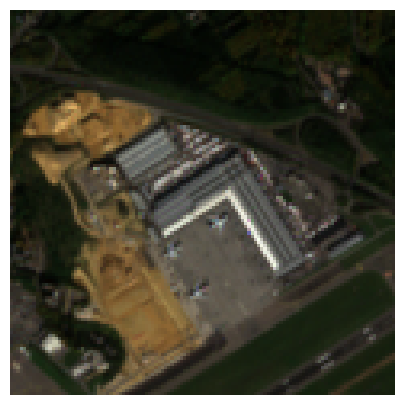


Labels:

- Airports
- Broad-leaved forest
- Discontinuous urban fabric
- Industrial or commercial units

Predictions:

Airports: 35.85%
Industrial or commercial units: 34.45%
Sport and leisure facilities: 33.87%
Construction sites: 32.66%
Dump sites: 31.01%
Port areas: 30.28%
Complex cultivation patterns: 30.28%
Continuous urban fabric: 29.90%
Road and rail networks and associated land: 29.79%
Mineral extraction sites: 29.67%
Discontinuous urban fabric: 29.63%
Green urban areas: 29.03%
Moors and heathland: 29.02%
Sparsely vegetated areas: 29.00%
Inland marshes: 28.93%
Water courses: 28.77%
Transitional woodland/shrub: 28.69%
Land principally occupied by agriculture, with significant areas of natural vegetation: 28.65%
Agro-forestry areas: 28.51%
Rice fields: 28.37%
Salt marshes: 28.20%
Pastures: 27.73%
Vineyards: 27.64%
Non-irrigated arable land: 27.64%
Bare rock: 27.57%
Fruit trees and berry plantations: 27.46%
Annual crops associated with permanent crops: 27.32%
Peatbogs: 27.22%
Scl

In [ ]:
# Example with single image

image_id = 	'id_441746'
f = h5py.File(test_df_bigearthnet[test_df_bigearthnet.image_id == image_id].filename.item())

print("\nImage:", image_id, "\n")
r = f['04 - Red'][:]    # shape (n, n)
g = f['03 - Green'][:]  # shape (n, n)
b = f['02 - Blue'][:]   # shape (n, n)
rgb_image = np.stack([r, g, b], axis = -1) # shape (n, n, 3)
true_color = normalize(rgb_image)

plt.figure(figsize = (5, 5))
plt.imshow(true_color)
plt.axis('off')
plt.show()

print("\nLabels:\n")
for l in test_df_bigearthnet[test_df_bigearthnet.image_id == image_id].labels.item().strip("[]").split(','):
    print('-', l.strip(" '"))

image = SkyCLIP_preprocess_val(Image.fromarray((true_color * 255).astype(np.uint8))).unsqueeze(0).to(device)
text = tokenizer(['a satellite image of ' + l.lower() for l in bigearthnet_labels]).to(device)


with torch.no_grad():
    image_features = SkyCLIP_model.encode_image(image)
    text_features = SkyCLIP_model.encode_text(text)

image_features /= image_features.norm(dim=-1, keepdim=True)
text_features /= text_features.norm(dim=-1, keepdim=True)
similarity = image_features @ text_features.T
sigmoid = similarity[0].sigmoid()
#softmax = (100.0 * image_features @ text_features.T).softmax(dim=-1)

# Print the result
print("\nPredictions:\n")
for label, prob in sorted(zip(bigearthnet_labels, similarity[0]), key = lambda x: x[1], reverse = True):
    print(f"{label}: {100 * prob:.2f}%")

- Computing predictions

In [ ]:
add_top_predictions_with_batches_multilabel(
    test_df_bigearthnet,
    SkyCLIP_model,
    SkyCLIP_preprocess_val,
    device,
    bigearthnet_labels,
    ['04 - Red', '03 - Green', '02 - Blue'],
    '/content/drive/MyDrive/Thesis CLIP4EO/output/m-bigearthnet_predictions_SkyCLIP_RGB.csv',
    tokenizer)

100%|██████████| 4/4 [22:07<00:00, 331.76s/it]


In [ ]:
output_df_skyclip_bigearthnet = pd.read_csv('/content/drive/MyDrive/Thesis CLIP4EO/output/m-bigearthnet_predictions_SkyCLIP_RGB.csv')
output_df_skyclip_bigearthnet.head()

,image_id,filename,bands,split,labels,ground_truth_binary_vector,Agro-forestry_areas_dotprod,Airports_dotprod,Annual_crops_associated_with_permanent_crops_dotprod,Bare_rock_dotprod,...,Sclerophyllous_vegetation_sigmoid,Sea_and_ocean_sigmoid,Sparsely_vegetated_areas_sigmoid,Sport_and_leisure_facilities_sigmoid,Transitional_woodland/shrub_sigmoid,Vineyards_sigmoid,Water_bodies_sigmoid,Water_courses_sigmoid,preds,pred_binary_vector
0,id_427032,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,12,test,"['Complex cultivation patterns', 'Discontinuou...","[0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, ...",0.344934,0.312670,0.330451,0.297813,...,0.578609,0.564868,0.583453,0.576489,0.575873,0.584659,0.575411,0.576210,"['Agro-forestry areas', 'Airports', 'Annual cr...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ..."
1,id_493029,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,12,test,"['Coniferous forest', 'Permanently irrigated l...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, ...",0.348223,0.306188,0.309141,0.327127,...,0.582261,0.563389,0.583852,0.568805,0.584851,0.578475,0.576407,0.576470,"['Agro-forestry areas', 'Airports', 'Annual cr...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ..."
2,id_513633,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,12,test,"['Burnt areas', 'Complex cultivation patterns'...","[0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, ...",0.357846,0.322136,0.309643,0.330519,...,0.580816,0.569042,0.584361,0.574381,0.581843,0.582910,0.580348,0.582257,"['Agro-forestry areas', 'Airports', 'Annual cr...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ..."
3,id_441746,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,12,test,"['Airports', 'Broad-leaved forest', 'Discontin...","[0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, ...",0.285102,0.358499,0.273175,0.275714,...,0.567526,0.556830,0.571994,0.583880,0.571239,0.568665,0.566019,0.571421,"['Agro-forestry areas', 'Airports', 'Annual cr...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ..."
4,id_510900,/content/drive/MyDrive/Thesis CLIP4EO/GEO-Benc...,12,test,['Annual crops associated with permanent crops...,"[0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, ...",0.322539,0.322874,0.289329,0.316351,...,0.574292,0.564886,0.580368,0.581291,0.577491,0.579891,0.575793,0.579677,"['Agro-forestry areas', 'Airports', 'Annual cr...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ..."


In [ ]:
output_df_skyclip_bigearthnet.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Columns: 137 entries, image_id to pred_binary_vector
dtypes: float64(129), int64(1), object(7)
memory usage: 1.0+ MB


In [ ]:
output_df_skyclip_bigearthnet.pred_binary_vector.value_counts()

,count
pred_binary_vector,
"[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]",1000


In [ ]:
print("\nSkyCLIP Evaluation:\n")
# Computing mAP
print(f"Mean Average Precision (mAP): {compute_mAP(output_df_skyclip_bigearthnet):.4f}")
# Computing R@k
print(f"Recall@3: {compute_recall_at_k(output_df_skyclip_bigearthnet, k=3):.4f}")
print(f"Recall@5: {compute_recall_at_k(output_df_skyclip_bigearthnet, k=5):.4f}")
print(f"Recall@10: {compute_recall_at_k(output_df_skyclip_bigearthnet, k=10):.4f}")
# Computing P@k
print(f"Precision@3: {compute_precision_at_k(output_df_skyclip_bigearthnet, k=3):.4f}")
print(f"Precision@5: {compute_precision_at_k(output_df_skyclip_bigearthnet, k=5):.4f}")
print(f"Precision@10: {compute_precision_at_k(output_df_skyclip_bigearthnet, k=10):.4f}")
# Computin rloss
print(f"Ranking Loss: {compute_ranking_loss(output_df_skyclip_bigearthnet):.4f}")
# computing F1 scores
macro_f1, micro_f1 = compute_f1_scores_adaptive(output_df_skyclip_bigearthnet)
print(f"Macro F1 Score: {macro_f1:.4f}")
print(f"Micro F1 Score: {micro_f1:.4f}")


SkyCLIP Evaluation:

Mean Average Precision (mAP): 0.2861
Recall@3: 0.1711
Recall@5: 0.2653
Recall@10: 0.4627
Precision@3: 0.2007
Precision@5: 0.1930
Precision@10: 0.1709
Ranking Loss: 0.3098
Macro F1 Score: 0.2034
Micro F1 Score: 0.2239


## Evaluation Summary

GEO-Bench Classification RGB Zero-Shot baselines

- Accuracy using original labels for 5/6 datasets (binary and multiclass):

| Model       | Backbone | m-brick-kiln | m-pv4ger | m-forestnet | eurosat | so2sat | m-bigearthnet |
| --------    | -------  | ------------ | -------- | ----------- | ------- | ------ | :------: |
| CLIP        | ViT-B/32 | **70.27%** | 73.87% |  7.65% | 41.90% | **16.63%** | / |
| RemoteCLIP  | ViT-B/32 | 66.97% | 65.97% |  8.25% | 28.70% | 12.78% | / |
| GeoRSCLIP   | ViT-B/32 | 68.67% | 89.09% | **14.20%** | **51.30%** | 15.82% | / |
| SkyCLIP     | ViT-B/32 | 59.36% | **90.59%** | 10.67% | 49.30% | 12.27% | / |


- Accuracy using CLIP-optimized text prompts for the binary datasets:

| Model       | Backbone | m-brick-kiln | m-pv4ger |
| --------    | -------  | ------------ | -------- |
| CLIP        | ViT-B/32 | **80.38%** | 79.28% |
| RemoteCLIP  | ViT-B/32 | 66.77% | 48.15% |
| GeoRSCLIP   | ViT-B/32 | 70.57% | **93.29%** |
| SkyCLIP     | ViT-B/32 | 69.27% | 90.79% |


- Various metrics for the multilabel dataset:

| Model       | Backbone | m-bigearthnet <br> r@5 | m-bigearthnet <br> p@5  |  m-bigearthnet <br> mAP  |  m-bigearthnet <br> macroF1  | m-bigearthnet <br> microF1  | m-bigearthnet <br> rloss |
| --------    | -------  | ------------ | -------- | -------- | -------- | -------- |  -------- |
| CLIP        | ViT-B/32 | 31.70% | 23.40% | 32.32% | 18.51% | 20.39% | 28.71% |
| RemoteCLIP  | ViT-B/32 | 26.24% | 19.82% | 27.63% | 18.49% | 20.30% | 30.89% |
| GeoRSCLIP   | ViT-B/32 | **38.89%** | **28.60%** | **39.69%** | 20.18% | 22.15% | 23.19% |
| SkyCLIP     | ViT-B/32 | 26.53% | 19.30% | 28.61% | 20.34% | 22.39% | 30.98% |

r@5 is the recall at k = 5, p@5 is the precision at k = 5



## Baseline GEO-Bench scores

In [ ]:
baseline_results = pd.read_csv("/content/drive/MyDrive/Thesis CLIP4EO/GEO-Bench classification data/baseline_classification_results (1).csv")
baseline_results.head()

,Unnamed: 0,model generator module name,loss type,backbone,desired input size,pretrained,lr backbone,lr head,optimizer,in chans,...,test metric,val metric,train metric,dataset,exp dir,csv log dir,model,weights,date str,date
0,5222,geobench exp.torch toolbox.model generators.ti...,crossentropy,ViT-T-timm,224,True,0.000044,0.004064,sgd,3,...,0.529412,0.519270,0.788144,m-so2sat,/mnt/data/experiments/nils/camera class seeds/...,/mnt/data/experiments/nils/camera class seeds/...,ViT-T-timm,NaN,10-20-2023,2023-10-20
1,5223,geobench exp.torch toolbox.model generators.ti...,crossentropy,ViT-T-timm,224,True,0.000044,0.004064,sgd,3,...,0.523327,0.507099,0.791146,m-so2sat,/mnt/data/experiments/nils/camera class seeds/...,/mnt/data/experiments/nils/camera class seeds/...,ViT-T-timm,NaN,10-20-2023,2023-10-20
2,5224,geobench exp.torch toolbox.model generators.ti...,crossentropy,ViT-T-timm,224,True,0.000044,0.004064,sgd,3,...,0.535497,0.525355,0.814657,m-so2sat,/mnt/data/experiments/nils/camera class seeds/...,/mnt/data/experiments/nils/camera class seeds/...,ViT-T-timm,NaN,10-20-2023,2023-10-20
3,5225,geobench exp.torch toolbox.model generators.ti...,crossentropy,ViT-T-timm,224,True,0.000044,0.004064,sgd,3,...,0.538540,0.522312,0.891696,m-so2sat,/mnt/data/experiments/nils/camera class seeds/...,/mnt/data/experiments/nils/camera class seeds/...,ViT-T-timm,NaN,10-20-2023,2023-10-20
4,5226,geobench exp.torch toolbox.model generators.ti...,crossentropy,ViT-T-timm,224,True,0.000044,0.004064,sgd,3,...,0.537525,0.515213,0.813157,m-so2sat,/mnt/data/experiments/nils/camera class seeds/...,/mnt/data/experiments/nils/camera class seeds/...,ViT-T-timm,NaN,10-20-2023,2023-10-20


In [ ]:
baseline_results.shape

(5040, 39)

In [ ]:
baseline_results.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5040 entries, 0 to 5039
Data columns (total 39 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   Unnamed: 0                   5040 non-null   int64  
 1   model generator module name  5040 non-null   object 
 2   loss type                    5040 non-null   object 
 3   backbone                     5040 non-null   object 
 4   desired input size           5040 non-null   int64  
 5   pretrained                   5040 non-null   bool   
 6   lr backbone                  5040 non-null   float64
 7   lr head                      5040 non-null   float64
 8   optimizer                    5040 non-null   object 
 9   in chans                     5040 non-null   int64  
 10  default input size           5040 non-null   object 
 11  n backbone features          5040 non-null   int64  
 12  batch size                   5040 non-null   int64  
 13  generate experimen

In [ ]:
baseline_results.columns

Index(['Unnamed: 0', 'model generator module name', 'loss type', 'backbone',
       'desired input size', 'pretrained', 'lr backbone', 'lr head',
       'optimizer', 'in chans', 'default input size', 'n backbone features',
       'batch size', 'generate experiment dir', 'experiment name',
       'experiment type', 'benchmark dir', 'benchmark name', 'partition name',
       'tasks', 'seed', 'log dir', 'best step', 'score', 'epoch', 'train loss',
       'convergence time', 'test loss', 'val loss', 'test metric',
       'val metric', 'train metric', 'dataset', 'exp dir', 'csv log dir',
       'model', 'weights', 'date str', 'date'],
      dtype='object')

In [ ]:
baseline_results['model generator module name'].value_counts()

,count
model generator module name,
geobench exp.torch toolbox.model generators.timm generator,5040


In [ ]:
baseline_results.iloc[0]

,0
Unnamed: 0,5222
model generator module name,geobench exp.torch toolbox.model generators.ti...
loss type,crossentropy
backbone,ViT-T-timm
desired input size,224
pretrained,True
lr backbone,0.000044
lr head,0.004064
optimizer,sgd
in chans,3


In [ ]:
baseline_results['partition name'].value_counts()

,partition name
0.20x train,720
0.10x train,720
0.05x train,720
0.02x train,720
1.00x train,720
0.01x train,720
0.50x train,720


In [ ]:
import os

os.environ["GEO_BENCH_DIR"] = "/content/drive/MyDrive/Thesis CLIP4EO/GEO-Bench classification data/"
print(os.environ.get("GEO_BENCH_DIR")) # !echo $GEO_BENCH_DIR

/content/drive/MyDrive/Thesis CLIP4EO/GEO-Bench classification data/


In [ ]:
import geobench
if geobench.config._GEO_BENCH_DIR_ENV is None:
    print("Note: GEO_BENCH_DIR is not set. If this is not intended, this might be related on how jupyter loads environment variables.")
    print(f"Using GEO_BENCH_DIR={geobench.GEO_BENCH_DIR}")

from geobench import plot_tools
from pathlib import Path
import seaborn as sns

import pandas as pd
import os

%load_ext autoreload
%autoreload 2

Note: GEO_BENCH_DIR is not set. If this is not intended, this might be related on how jupyter loads environment variables.
Using GEO_BENCH_DIR=/root/dataset/geobench


In [ ]:
csv_path = "/content/drive/MyDrive/Thesis CLIP4EO/GEO-Bench classification data/baseline_classification_results (1).csv"
#Path(os.path.abspath('')).parent / "baseline_classification_results.csv"
df_all = pd.read_csv(csv_path)
df_1x = plot_tools.extract_1x_data(df_all)

def extract_partition_data(df, partition):
    """Extract only results trained on specified partition of the data"""
    return df[
        (df["partition name"] == partition)
    ].copy()

df_default = extract_partition_data(df_all, "default")
df_05x = extract_partition_data(df_all, "0.50x train")

model_order = "ResNet18-Rnd,ResNet18-timm,ResNet18-MoCo-S2,ResNet50-MillionAID,ResNet50-MoCo-S2,ResNet50-timm,ConvNeXt-B-timm,ViT-T-timm,ViT-S-timm,SwinV2-T-timm".split(",")
model_colors = dict( zip(model_order, sns.color_palette("colorblind")[:len(model_order)]))

AttributeError: 'Legend' object has no attribute 'legendHandles'

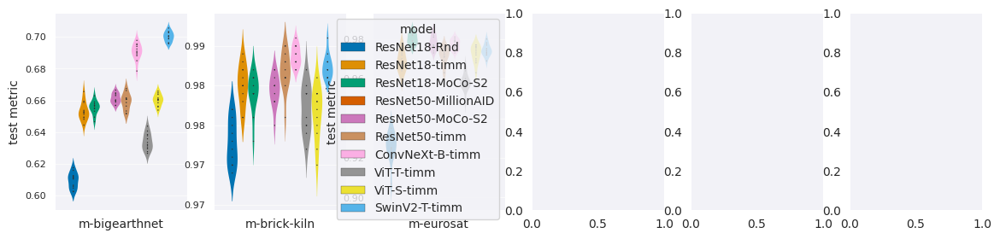

In [ ]:
plot_tools.plot_per_dataset(df_1x, model_order, model_colors=model_colors, metric="test metric", sharey=False, inner="points", fig_size=(14,3), n_legend_rows=2)

In [ ]:
plot_tools.normalize_bootstrap_and_plot(df_1x, metric="test metric",benchmark_name="classification_v1.0", model_order=model_order, model_colors=model_colors, fig_size=(12,2.3))

FileNotFoundError: [Errno 2] No such file or directory: '/root/dataset/geobench/classification_v1.0/normalizer.json'

In [ ]:
'''
def avergage_seeds(df, group_keys=("model", "dataset", "partition name"), metric="test metric"):
    """Average seeds for all model and all datasets."""
    df_avg = df.groupby(list(group_keys))[metric].mean()
    df_avg = df_avg.unstack(level="dataset")

    df_avg = df_avg.round(3)
    return df_avg
'''

def extract_partition_data(df, partition):
    """Extract only results trained on specified partition of the data"""
    return df[
        (df["partition name"] == partition)
    ].copy()

df_05x = extract_partition_data(df_all, "0.50x train")

plot_tools.avergage_seeds(df_05x)

,dataset,m-bigearthnet,m-brick-kiln,m-eurosat,m-forestnet,m-pv4ger,m-so2sat
model,partition name,,,,,,
ConvNeXt-B-timm,0.50x train,0.669,0.982,0.968,0.574,0.980,0.570
ResNet18-MoCo-S2,0.50x train,0.643,0.980,0.965,0.564,0.966,0.512
ResNet18-Rnd,0.50x train,0.597,0.972,0.879,0.483,0.958,0.462
ResNet18-timm,0.50x train,0.630,0.981,0.953,0.554,0.972,0.502
ResNet50-MoCo-S2,0.50x train,0.643,0.979,0.969,0.558,0.971,0.528
ResNet50-SECO-S2,0.50x train,0.646,0.982,0.960,0.536,0.968,0.567
ResNet50-timm,0.50x train,0.643,0.983,0.957,0.544,0.976,0.515
SwinV2-T-timm,0.50x train,0.674,0.985,0.958,0.556,0.980,0.549
ViT-S-timm,0.50x train,0.626,0.978,0.948,0.508,0.978,0.567
